<a href="https://colab.research.google.com/github/jcalandra/audiosynthesis_dl/blob/master/Pict2Audio_pitch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pict2Audio : A Neural Network that associates Pictures to Audio Descriptors

This project consists in associating a sound with one or more characteristics defined by audio descriptors with a picture drawn by a composer . The long-term goal is to allow the composer to develop his own composition language in order to associate it with sounds from some effects banks.

I will first be interested in pitch, and I will propose as input to a Convolutional Neural Network trained for classification a database of couples:
- an image drawn by the composer,
- the label of the sound extract corresponding to the associated note pitch.
After training, we want to obtain a sound for a given image at the input of the network.

Validation tests will be conducted by verifying that the sounds obtained correspond to the desired descriptors.

**You will find the multilabel version at the following link :**
[https://colab.research.google.com/drive/1_ZTdR2CG_eekUUtqAG9Bqa7RixHL8v93](https://colab.research.google.com/drive/1_ZTdR2CG_eekUUtqAG9Bqa7RixHL8v93)

## Importation of the libraries

First, we need to import all the package and libraries necessary to run the code.

The backend Tensorflow is used with the library Keras to implement the neural network.

In [1]:
from __future__ import print_function
import os
from PIL import Image

import numpy as np
import random

import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Dense, Activation, BatchNormalization,Dropout, Conv2D, MaxPooling2D, Flatten
from keras.optimizers import RMSprop
from keras.preprocessing import image
print('tensorflow:', tf.__version__)
print('keras:', keras.__version__)

tensorflow: 1.13.1
keras: 2.2.4


Using TensorFlow backend.



## Importation of the Dataset :

the dataset is imported from github, using the repository audiosynthesis_dl. In this repository, you can also find documentation about sound synthesis using Neural Networks.

In [2]:
# First, import git repository
! git clone https://github.com/jcalandra/audiosynthesis_dl.git


Cloning into 'audiosynthesis_dl'...
remote: Enumerating objects: 290, done.
remote: Counting objects: 100% (290/290), done.
remote: Compressing objects: 100% (275/275), done.
remote: Total 629 (delta 21), reused 266 (delta 10), pack-reused 339
Receiving objects: 100% (629/629), 9.72 MiB | 4.92 MiB/s, done.
Resolving deltas: 100% (92/92), done.


Then, run the following script in the same environment :

https://colab.research.google.com/drive/1lJELWVC4DmQSNOw0fat4KrzTo_GmVbpZ

To avoid downloading a heavy set of data on the computer, I chose to generate the pictures directly and load them from google colab

In [0]:
import cv2
from google.colab.patches import cv2_imshow
from google.colab import files

In [0]:
## LOADING THE BASELINE

baseline = cv2.imread('audiosynthesis_dl/data/base_quadrillage.png')
#cv2_imshow(baseline)

In [0]:
## GLOBAL VALUES

NB_PITCH = 12
NB_COLOR = 8
NB_THICK = 3
NB_CLASS = NB_PITCH
PICT_WIDTH = 400
NB_CHANNEL = 3
LINE_WIDTH = PICT_WIDTH//NB_PITCH #33

NB_CARACTERISTICS = 1

# number of versions for a same pitch
NB_VERSION_TRAIN = 2
NB_VERSION_VALIDATION = 1

# number of trained and validation pictures 
NB_TRAIN = NB_THICK*NB_COLOR*NB_PITCH*NB_VERSION_TRAIN
NB_VALIDATION = NB_THICK*NB_COLOR*NB_PITCH*NB_VERSION_VALIDATION

In [6]:
## PICTURE GENERATION
'''
def generate_pict(nb_pict, folder):
  """ creates nb_pictures of pitch-lines and saves them permanently in the folder img_'folder'.
      Folder has to be a string and nb_pict is an integer."""
  
  thickness = 12
  hueval_tab = [[(i*180)/(NB_COLOR//2), 100] for i in range(NB_COLOR//2)] + [[(i*180)/(NB_COLOR//2), 190] for i in range(NB_COLOR//2)]
  sat = 150
  for i in range (nb_pict) :
    
    # creation of the baseline : quadrilled picture
    line_image_rgb = baseline.copy()
    
    line_image_hsv = cv2.cvtColor(line_image_rgb, cv2.COLOR_RGB2HSV)
    h, s, v = cv2.split(line_image_hsv)
    

    # generation of lines :
    outline = 0
    if (i%12 == 0) :               # thickness changes every 1 notes
      if(thickness == 12 ) :
        thickness = 1
        thick_ind = 0
      elif (thickness == 1 ) : # maximum of (LINE_WIDTH - 4) to obtain in this case a bit of variation in the shape and avoid the creation of two exact same pictures
        thickness = 3
        thick_ind = 1
      elif(thickness == 3 ) :
        thickness = 5
        thick_ind = 2
      elif(thickness == 5 ) :
        thickness = 7
        thick_ind = 3
      elif(thickness == 7 ) :
        thickness = 9
        thick_ind = 4
      elif(thickness == 9 ) :
        thickness = 12
        thick_ind = 5
    delta = (LINE_WIDTH - (thickness*2))//2 + outline     # delta of allowed variation of the line
    height = (i%NB_PITCH)*LINE_WIDTH + (LINE_WIDTH + 5)//2   # actual height depending on (i%12) the pitch and the width of a pitch line

    variation = np.random.randint(0,delta - outline) # the line begin at a random point in delta
    intervalle_max = np.random.randint(2,50)
    

    color_ind = np.random.randint(NB_COLOR)
    color = hueval_tab[color_ind]
    hue = color[0]
    val = color[1]
        
    for j in  range (PICT_WIDTH):
      intervalle = np.random.randint(1,intervalle_max)              #to avoid a sharp variation, we keep the same variation height for each 'intervalle'
      if (j%intervalle == 0) :                         # if we want to change the height of the line
        tmp_var = np.random.randint(-1, 2)             # each variation is an increase or a decrease of 1 (or same height)
        if abs(variation + tmp_var) < delta :
          variation = variation + tmp_var
        else :
          variation = variation
          
      
      if( PICT_WIDTH - height - 1 + variation > 0 and PICT_WIDTH - height - 1 + variation < 400 ) :
        h[PICT_WIDTH - height - 1 + variation][PICT_WIDTH - j - 1] = hue      # creation of the line
        s[PICT_WIDTH - height - 1 + variation][PICT_WIDTH - j - 1] = sat 
        v[PICT_WIDTH - height - 1 + variation][PICT_WIDTH - j - 1] = val 


      for k in range (thickness) :
        if( PICT_WIDTH - height - 1 + variation - k > 0 and PICT_WIDTH - height - k + variation < 400 ) :
          h[PICT_WIDTH - height - 1 - k + variation][PICT_WIDTH - j - 1] = hue # and its thickness
          s[PICT_WIDTH - height - 1 - k + variation][PICT_WIDTH - j - 1] = sat
          v[PICT_WIDTH - height - 1 - k + variation][PICT_WIDTH - j - 1] = val

        if( PICT_WIDTH - height - 1 + variation + k > 0 and PICT_WIDTH - height + k + variation < 400 ) :
          h[PICT_WIDTH - height - 1 + k + variation][PICT_WIDTH - j - 1] = hue
          s[PICT_WIDTH - height - 1 + k + variation][PICT_WIDTH - j - 1] = sat
          v[PICT_WIDTH - height - 1 + k + variation][PICT_WIDTH - j - 1] = val


    line_image_hsv = cv2.merge((h,s,v))
    line_image = cv2.cvtColor(line_image_hsv, cv2.COLOR_HSV2RGB)

    
    cv2_imshow(line_image) #showing the images for tests
    print('draw'+str(69 + i%NB_PITCH)+ '_color' + str(color_ind) +'_'+str(i//NB_CLASS) + '_'+folder+'.png')

    # save the picture in google colab :
    cv2.imwrite('./audiosynthesis_dl/data/pitch_img/img_'+folder+'/draw'+str(69 + i%NB_PITCH)+ '_color' + str(color_ind) +'_'+str(i//NB_CLASS) + '_'+folder+'.png', line_image) #69 is pitch for la440
  

print('[INFO] generating training dataset...')
generate_pict(NB_TRAIN, 'train')
print('[INFO] generating validation dataset...')
generate_pict(NB_VALIDATION, 'validation')
'''

'\ndef generate_pict(nb_pict, folder):\n  """ creates nb_pictures of pitch-lines and saves them permanently in the folder img_\'folder\'.\n      Folder has to be a string and nb_pict is an integer."""\n  \n  thickness = 12\n  hueval_tab = [[(i*180)/(NB_COLOR//2), 100] for i in range(NB_COLOR//2)] + [[(i*180)/(NB_COLOR//2), 190] for i in range(NB_COLOR//2)]\n  sat = 150\n  for i in range (nb_pict) :\n    \n    # creation of the baseline : quadrilled picture\n    line_image_rgb = baseline.copy()\n    \n    line_image_hsv = cv2.cvtColor(line_image_rgb, cv2.COLOR_RGB2HSV)\n    h, s, v = cv2.split(line_image_hsv)\n    \n\n    # generation of lines :\n    outline = 0\n    if (i%12 == 0) :               # thickness changes every 1 notes\n      if(thickness == 12 ) :\n        thickness = 1\n        thick_ind = 0\n      elif (thickness == 1 ) : # maximum of (LINE_WIDTH - 4) to obtain in this case a bit of variation in the shape and avoid the creation of two exact same pictures\n        thicknes

In [0]:
## PICTURE GENERATION

# generating exactly the same path line for every color, pitch and thickness

def generate_pict(nb_version_pict, folder, outline_value, pic_type): # pic_type = [PITCH, THICK, COLOR] with 0 if no, 1 if yes
  """ creates nb_pictures of pitch-lines and saves them permanently in the folder img_'folder'.
      Folder has to be a string and nb_pict is an integer."""
  
  # default values if pitches, thicknesses and/or colors don't change
  height = (3%NB_PITCH)*LINE_WIDTH + (LINE_WIDTH + 5)//2
  thickness = 6
  sat = hue = val = 0
  # default indices
  pitch_ind = 0
  thick_ind = 0
  color_ind = 0
  
  # beginning value for thickness if there is a variation of thickness
  if (pic_type[1] == 1):
    thickness = 12
  # tab of color values if there is a variation of colors
  hueval_tab = [[(i*180)/(NB_COLOR//2), 90] for i in range(NB_COLOR//2)] + [[(i*180)/(NB_COLOR//2), 210] for i in range(NB_COLOR//2)]
  #tab of available thicknesses if there is a variotion of thicknesses
  thickness_tab = [2,7,12]
  global_line_path = np.empty((PICT_WIDTH),dtype=int)
  
  for i in range (nb_version_pict) :
    
    # generation of lines path :   
    outline = outline_value 
    delta = (LINE_WIDTH - (thickness*2))//2 + outline    
    variation = np.random.randint(0,delta - outline)   # the line begin at a random point in delta
    intervalle_max = np.random.randint(2,50)           # interval allowed to keep the same height between each variation
    
    for l in range(PICT_WIDTH):
      intervalle = np.random.randint(1,intervalle_max) # to avoid a sharp variation, we keep the same variation height for each 'intervalle'
      if (l%intervalle == 0) :                         # if we want to change the height of the line
        tmp_var = np.random.randint(-1, 2)             # each variation is an increase or a decrease of 1 (or same height)
        if abs(variation + tmp_var) < delta :
          variation = variation + tmp_var
        else :
          variation = variation             
      global_line_path[l] = PICT_WIDTH + variation
    
    # pitch affiliation :    
    for p in range(NB_PITCH):
      if (pic_type[0] == 1 ):
        pitch_ind = 69 + p #69 is pitch for la440
        height = p*LINE_WIDTH + (LINE_WIDTH + 5)//2       
      line_path = global_line_path - height - 1

      
      # generation of the pictures. There are nb_version_pict*NB_COLOR*NB_PITCH pictures :
      for m in range(NB_COLOR):  
        
        # creation of the baseline, quadrilled picture :       
        line_image_rgb = baseline.copy()

                
        # color affiliation :
        line_image_hsv = cv2.cvtColor(line_image_rgb, cv2.COLOR_RGB2HSV)
        h, s, v = cv2.split(line_image_hsv)
      
        if( pic_type[2] == 1):
          color_ind = m
          color = hueval_tab[color_ind]
          sat = 150
          hue = color[0]
          val = color[1]
          
        #thickness affiliation :
        for t in range(NB_THICK): 
          thick_ind = t
          thickness = thickness_tab[thick_ind]

          for j in range(PICT_WIDTH):

            # creation of the line :
            if( line_path[j] > 0 and line_path[j] < 400 ) :
              h[line_path[j]][PICT_WIDTH - j - 1] = hue      
              s[line_path[j]][PICT_WIDTH - j - 1] = sat 
              v[line_path[j]][PICT_WIDTH - j - 1] = val 

            # and its thickness :
            for k in range (thickness) :
              if( line_path[j] - k > 0 and line_path[j] - k < 400 ) :
                h[line_path[j] - k][PICT_WIDTH - j - 1] = hue 
                s[line_path[j] - k][PICT_WIDTH - j - 1] = sat
                v[line_path[j] - k][PICT_WIDTH - j - 1] = val

              if( line_path[j] + k > 0 and line_path[j] + k < 400 ) :
                h[line_path[j] + k][PICT_WIDTH - j - 1] = hue
                s[line_path[j] + k][PICT_WIDTH - j - 1] = sat
                v[line_path[j] + k][PICT_WIDTH - j - 1] = val

          line_image_hsv = cv2.merge((h,s,v))
          line_image = cv2.cvtColor(line_image_hsv, cv2.COLOR_HSV2RGB)


          cv2_imshow(line_image) #showing the images for tests
          name = 'pitch'+str(pitch_ind)+ '_thick' + str(thick_ind) + '_color' + str(color_ind) +'_'+str(i) + '_'+folder+'.png'
          print(name)

          # save the picture in google colab :
          cv2.imwrite('./audiosynthesis_dl/data/pitch_img/img_'+folder+'/'+ name, line_image)

[INFO] generating training dataset...


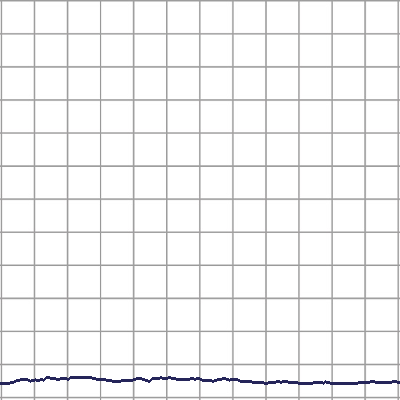

pitch69_thick0_color0_0_train.png


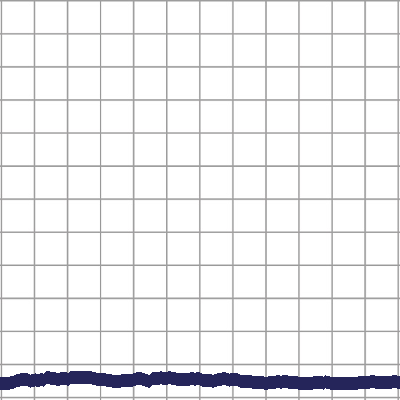

pitch69_thick1_color0_0_train.png


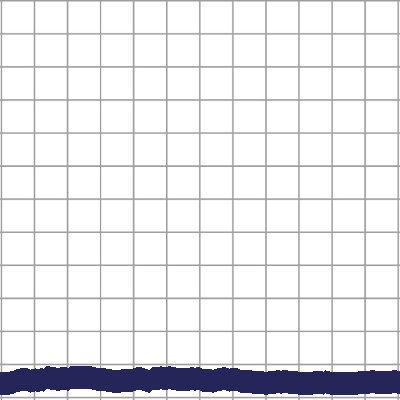

pitch69_thick2_color0_0_train.png


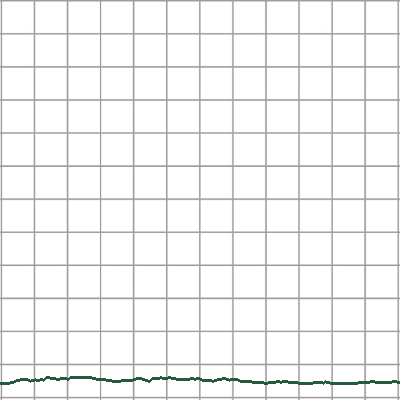

pitch69_thick0_color1_0_train.png


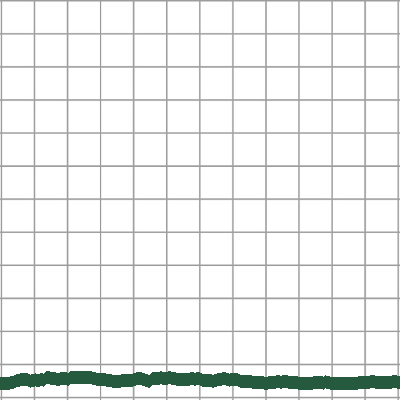

pitch69_thick1_color1_0_train.png


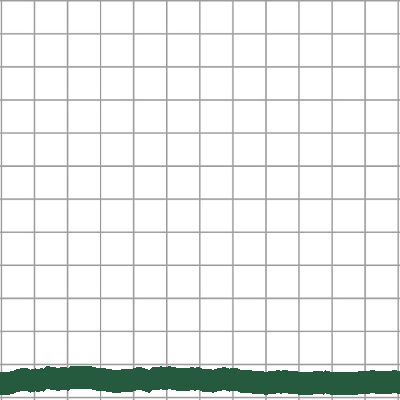

pitch69_thick2_color1_0_train.png


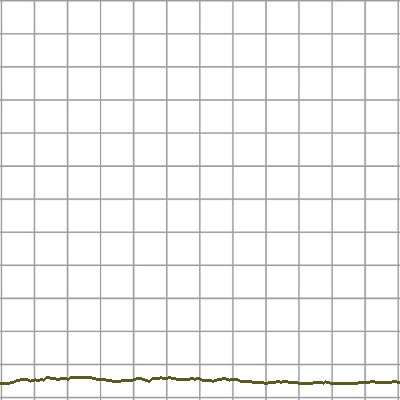

pitch69_thick0_color2_0_train.png


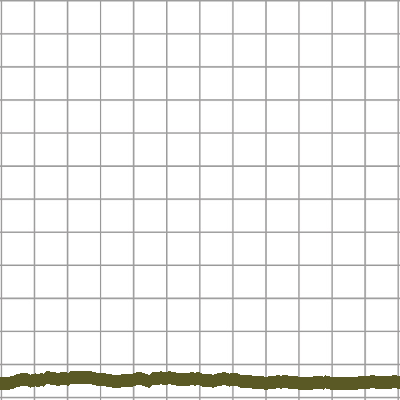

pitch69_thick1_color2_0_train.png


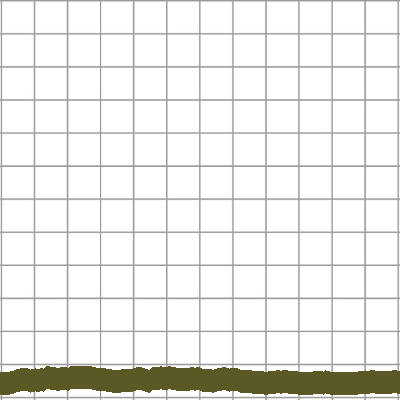

pitch69_thick2_color2_0_train.png


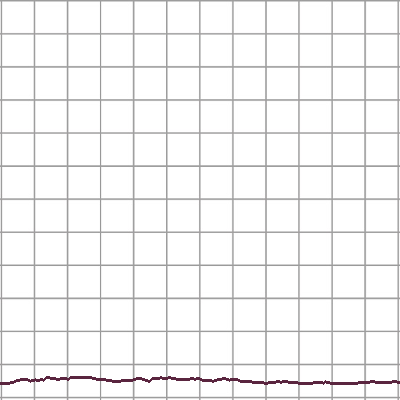

pitch69_thick0_color3_0_train.png


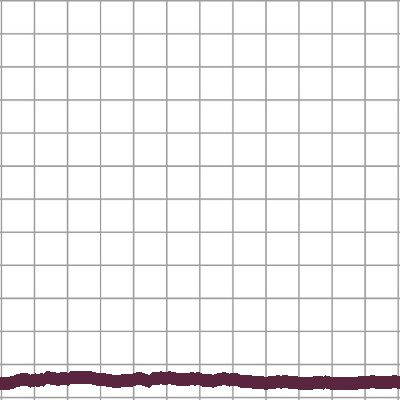

pitch69_thick1_color3_0_train.png


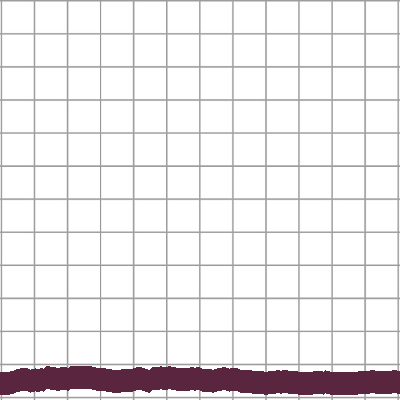

pitch69_thick2_color3_0_train.png


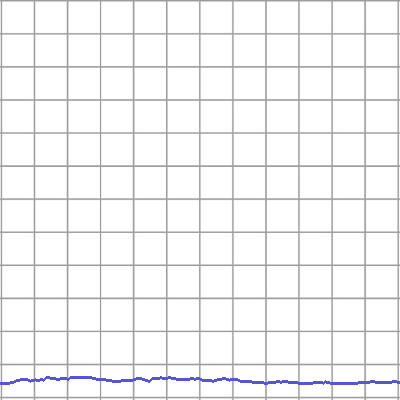

pitch69_thick0_color4_0_train.png


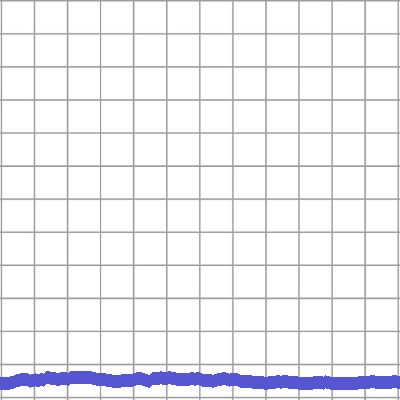

pitch69_thick1_color4_0_train.png


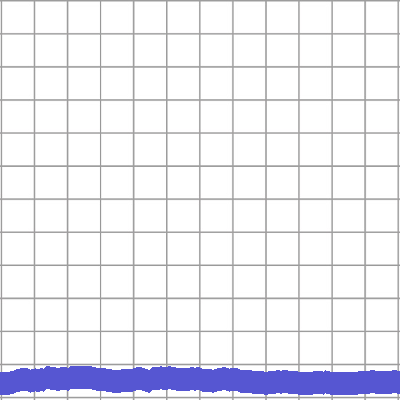

pitch69_thick2_color4_0_train.png


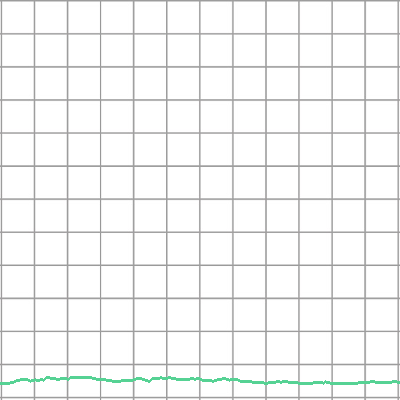

pitch69_thick0_color5_0_train.png


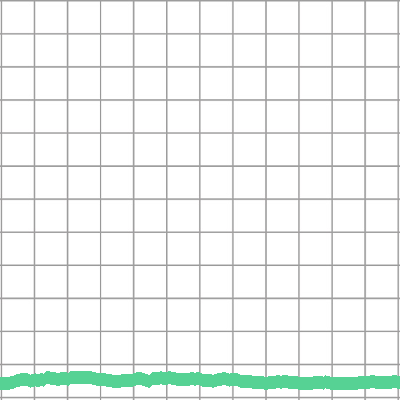

pitch69_thick1_color5_0_train.png


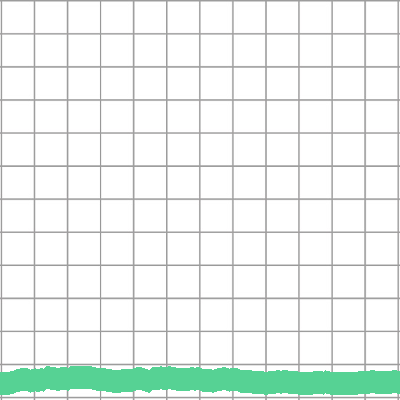

pitch69_thick2_color5_0_train.png


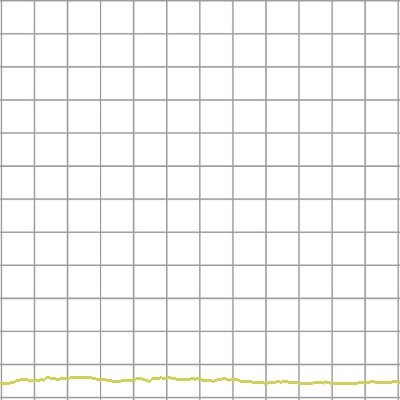

pitch69_thick0_color6_0_train.png


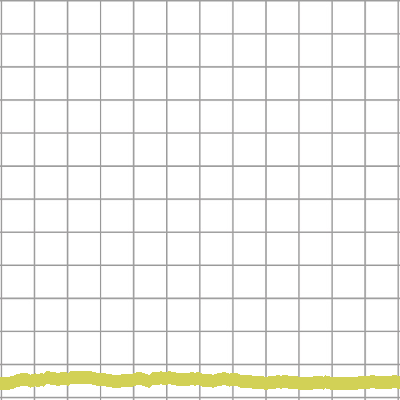

pitch69_thick1_color6_0_train.png


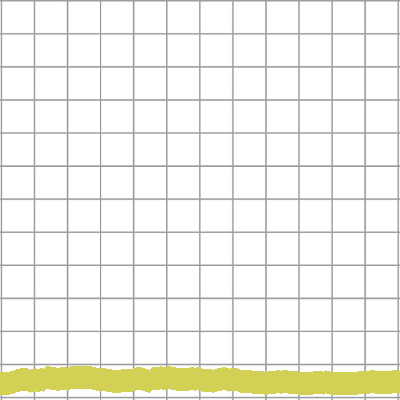

pitch69_thick2_color6_0_train.png


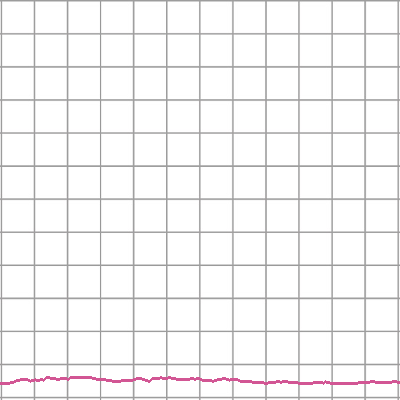

pitch69_thick0_color7_0_train.png


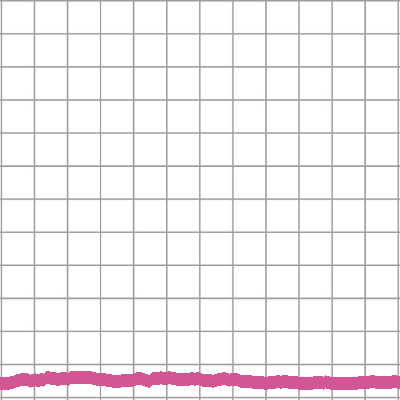

pitch69_thick1_color7_0_train.png


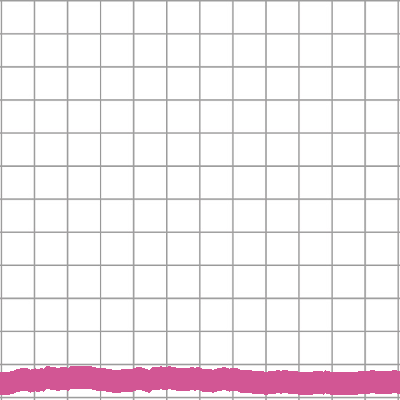

pitch69_thick2_color7_0_train.png


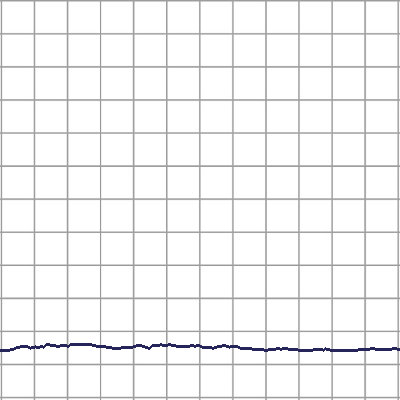

pitch70_thick0_color0_0_train.png


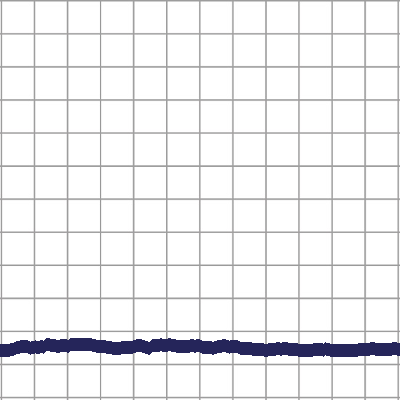

pitch70_thick1_color0_0_train.png


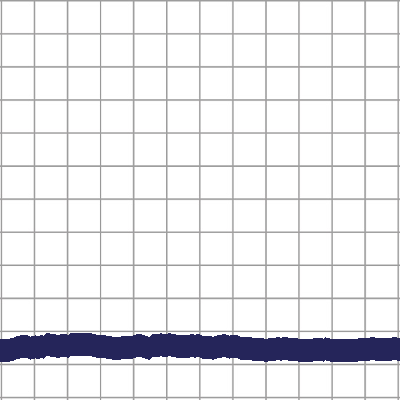

pitch70_thick2_color0_0_train.png


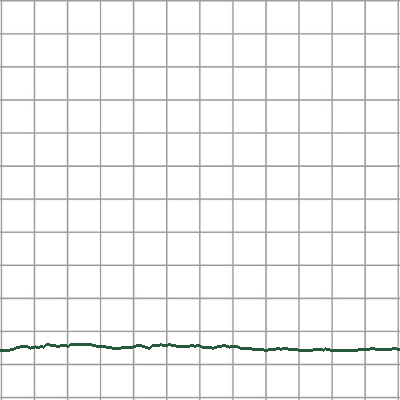

pitch70_thick0_color1_0_train.png


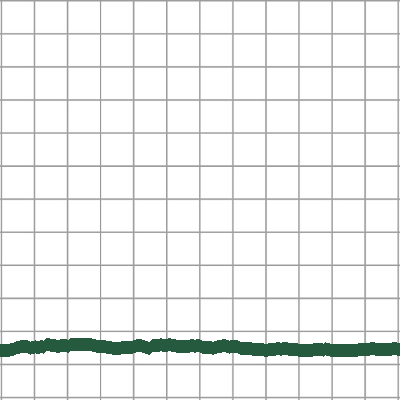

pitch70_thick1_color1_0_train.png


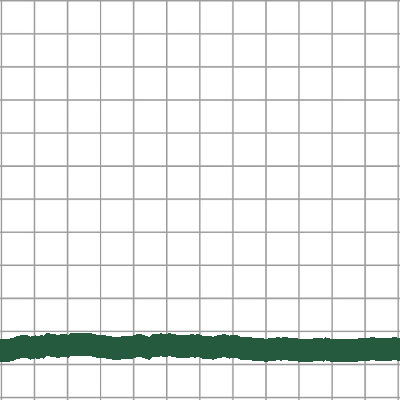

pitch70_thick2_color1_0_train.png


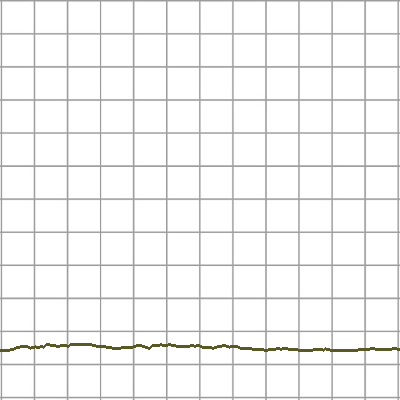

pitch70_thick0_color2_0_train.png


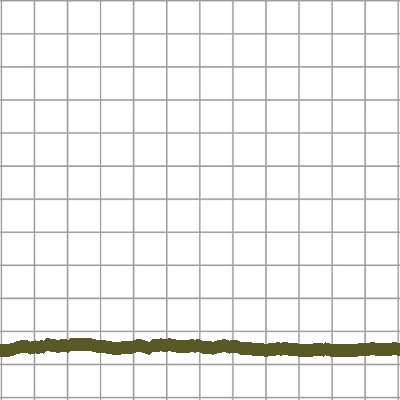

pitch70_thick1_color2_0_train.png


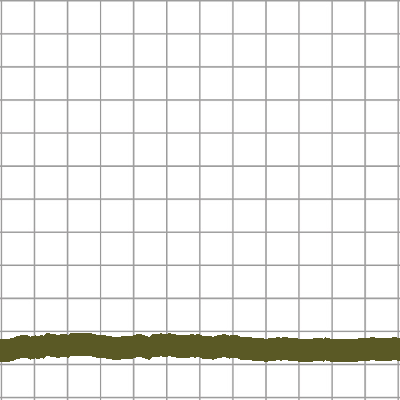

pitch70_thick2_color2_0_train.png


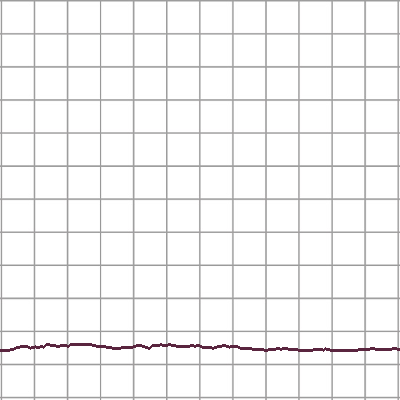

pitch70_thick0_color3_0_train.png


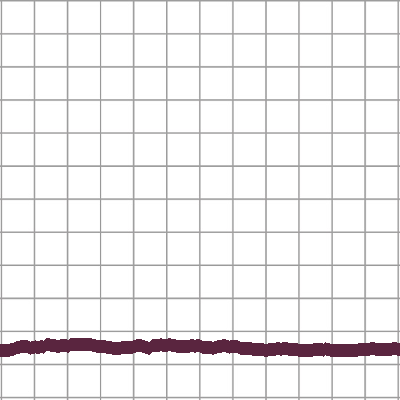

pitch70_thick1_color3_0_train.png


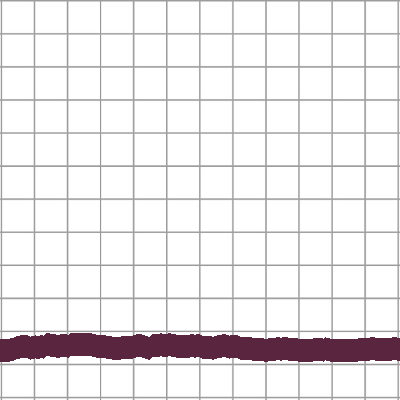

pitch70_thick2_color3_0_train.png


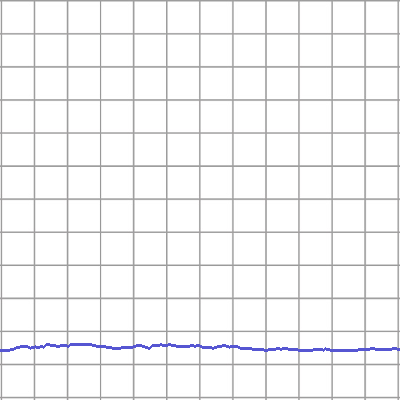

pitch70_thick0_color4_0_train.png


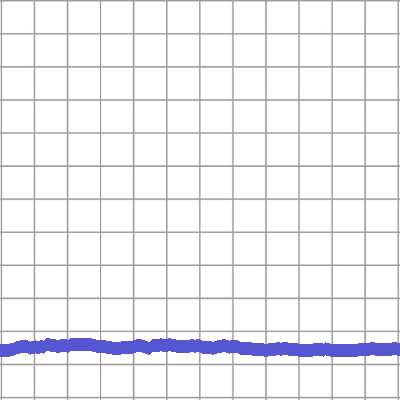

pitch70_thick1_color4_0_train.png


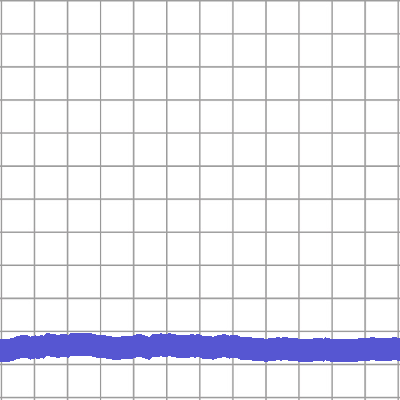

pitch70_thick2_color4_0_train.png


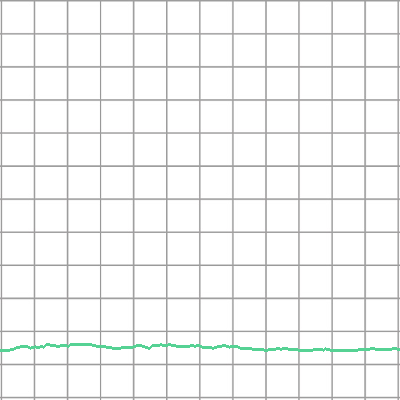

pitch70_thick0_color5_0_train.png


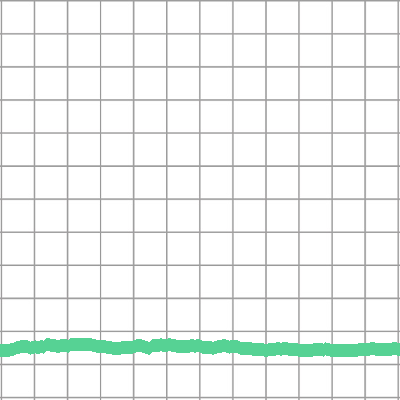

pitch70_thick1_color5_0_train.png


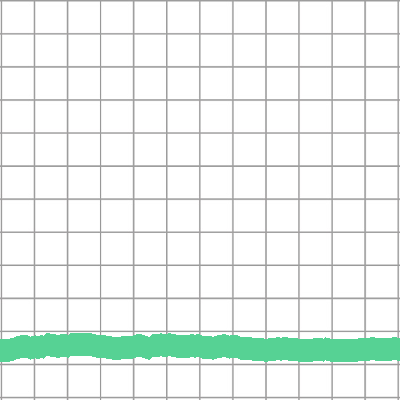

pitch70_thick2_color5_0_train.png


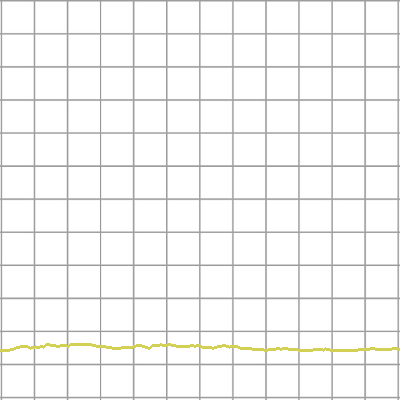

pitch70_thick0_color6_0_train.png


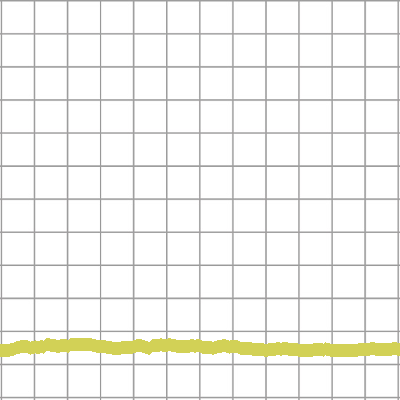

pitch70_thick1_color6_0_train.png


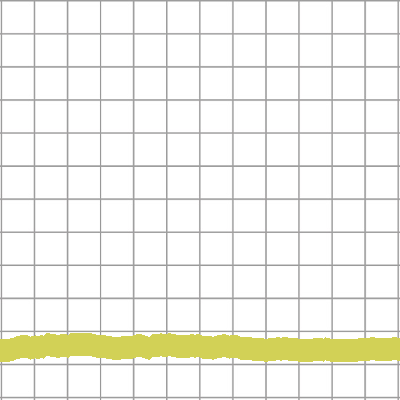

pitch70_thick2_color6_0_train.png


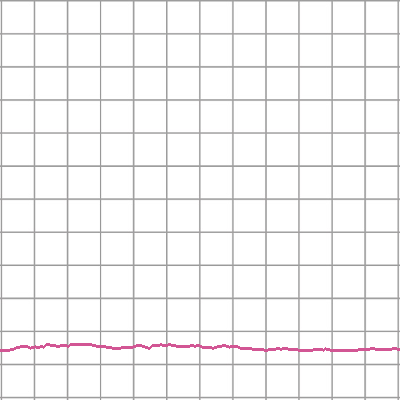

pitch70_thick0_color7_0_train.png


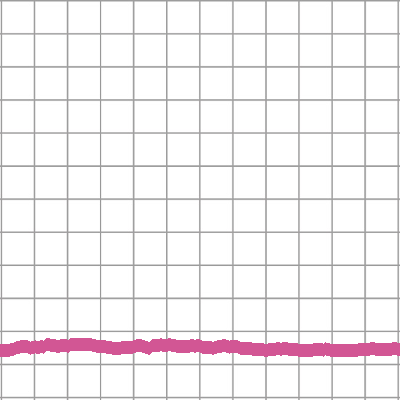

pitch70_thick1_color7_0_train.png


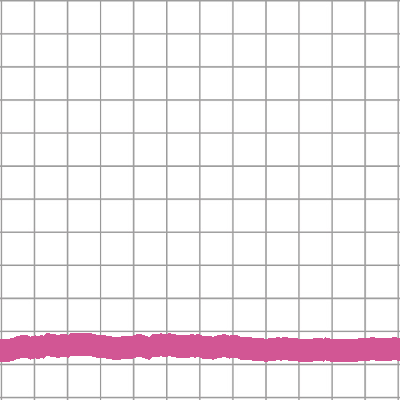

pitch70_thick2_color7_0_train.png


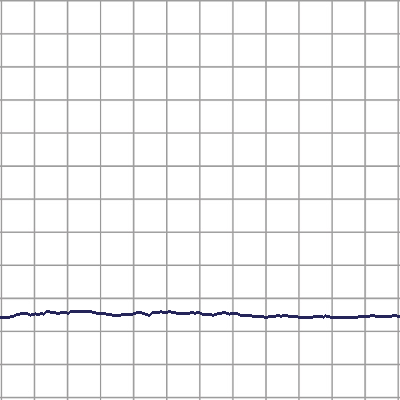

pitch71_thick0_color0_0_train.png


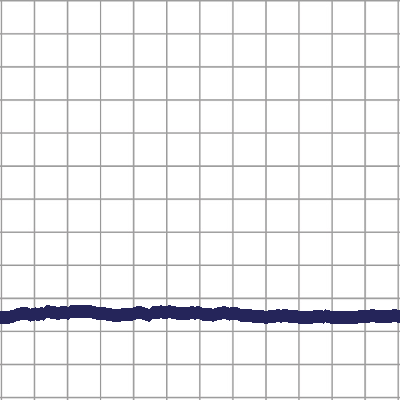

pitch71_thick1_color0_0_train.png


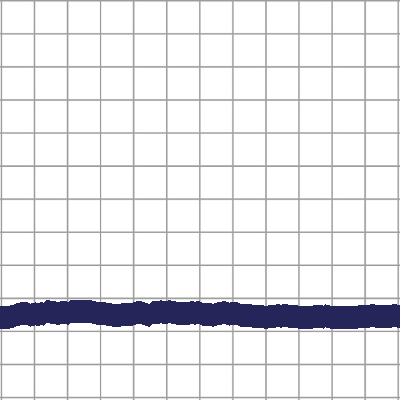

pitch71_thick2_color0_0_train.png


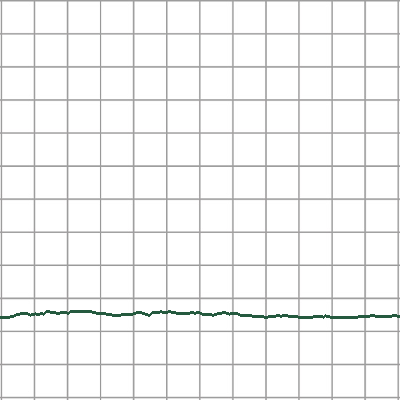

pitch71_thick0_color1_0_train.png


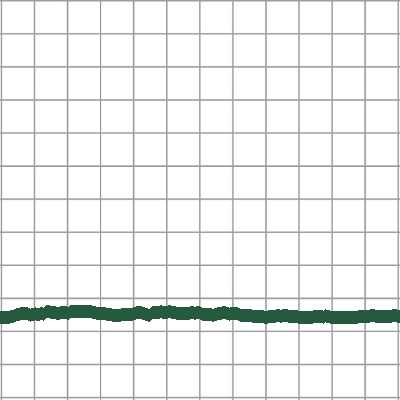

pitch71_thick1_color1_0_train.png


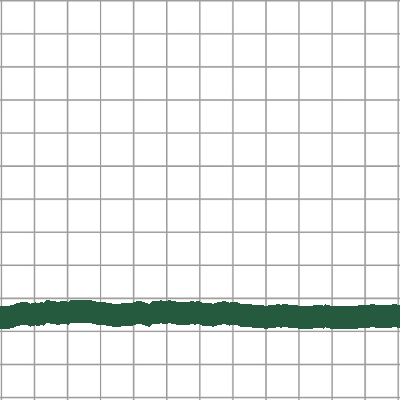

pitch71_thick2_color1_0_train.png


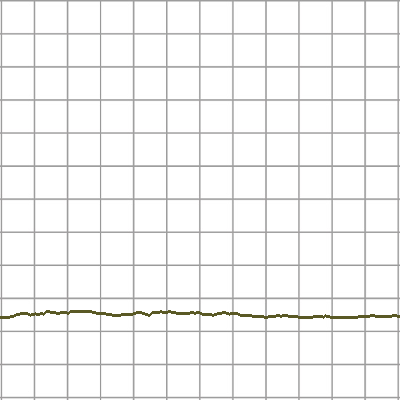

pitch71_thick0_color2_0_train.png


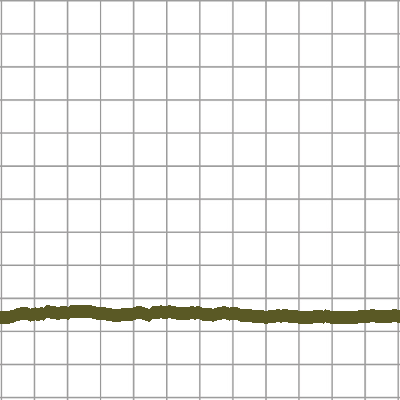

pitch71_thick1_color2_0_train.png


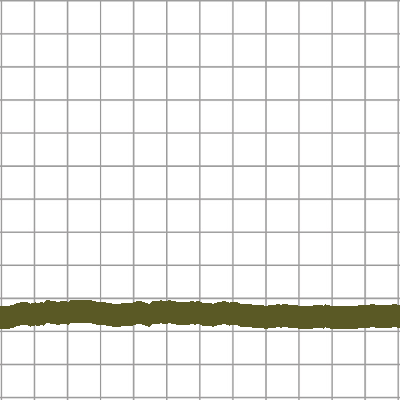

pitch71_thick2_color2_0_train.png


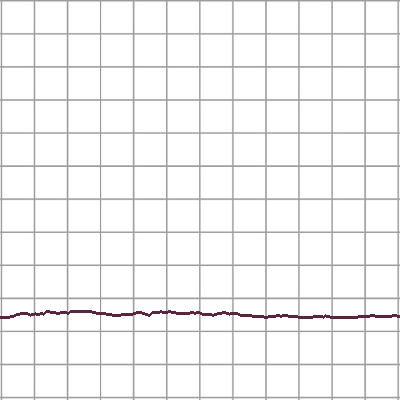

pitch71_thick0_color3_0_train.png


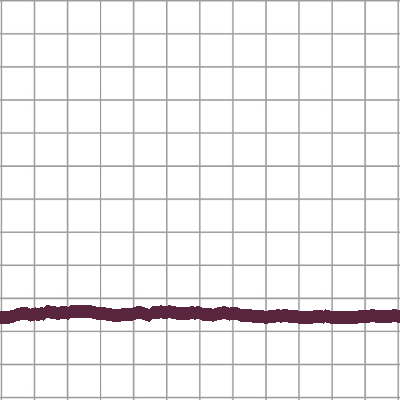

pitch71_thick1_color3_0_train.png


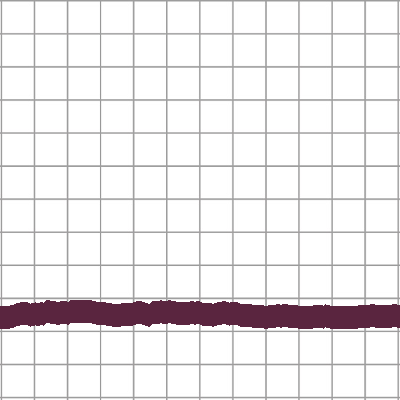

pitch71_thick2_color3_0_train.png


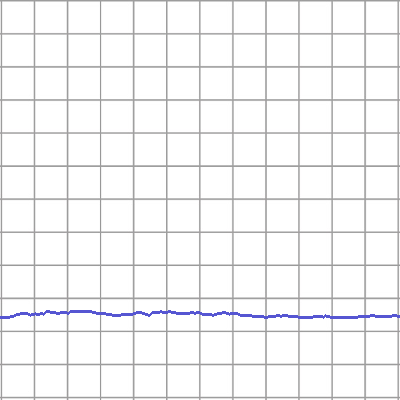

pitch71_thick0_color4_0_train.png


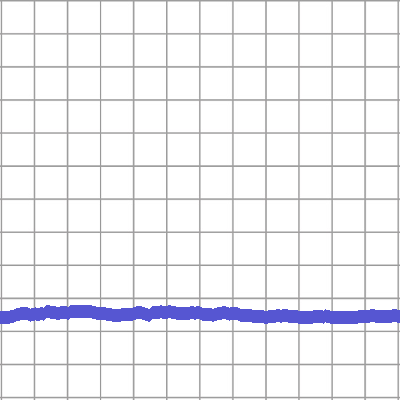

pitch71_thick1_color4_0_train.png


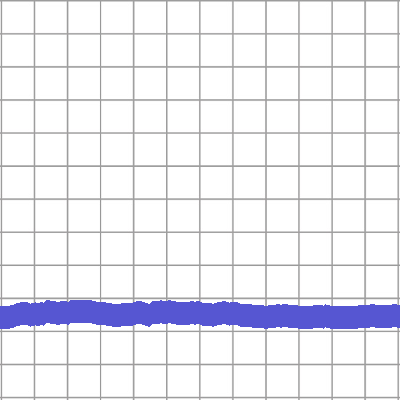

pitch71_thick2_color4_0_train.png


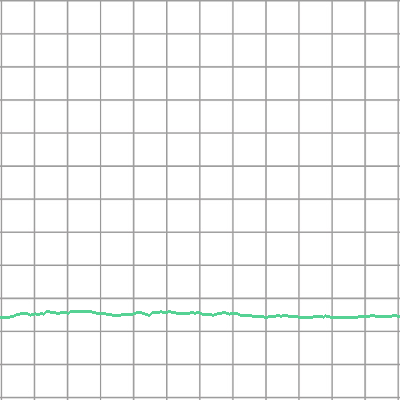

pitch71_thick0_color5_0_train.png


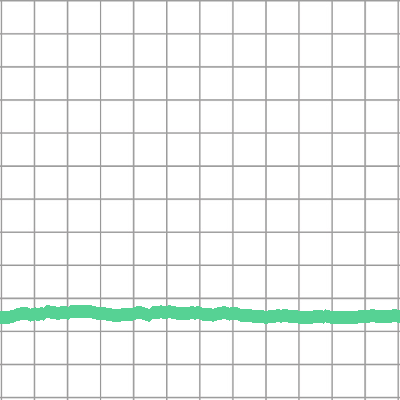

pitch71_thick1_color5_0_train.png


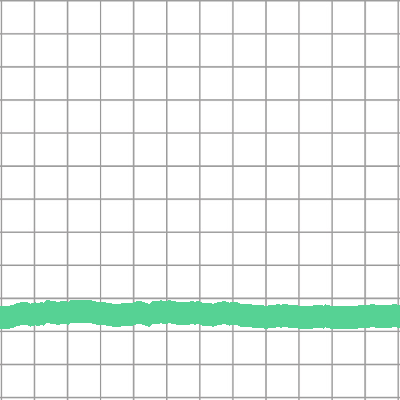

pitch71_thick2_color5_0_train.png


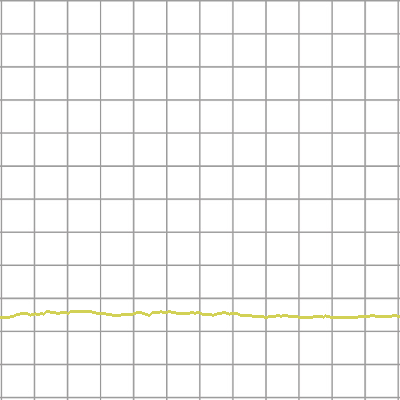

pitch71_thick0_color6_0_train.png


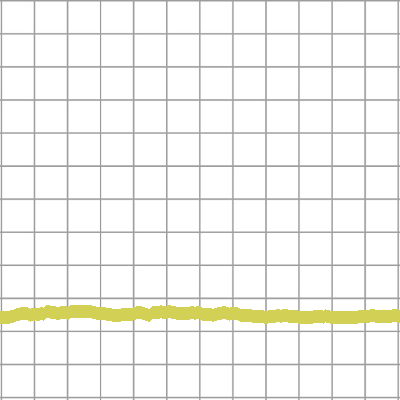

pitch71_thick1_color6_0_train.png


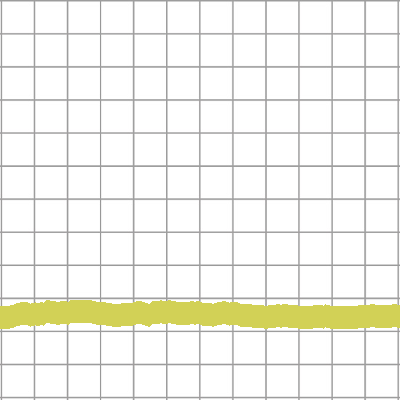

pitch71_thick2_color6_0_train.png


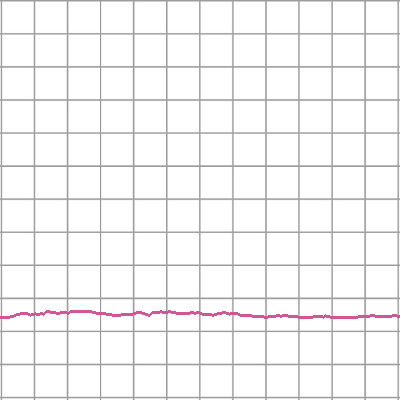

pitch71_thick0_color7_0_train.png


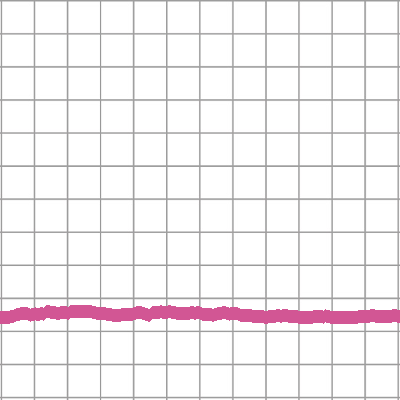

pitch71_thick1_color7_0_train.png


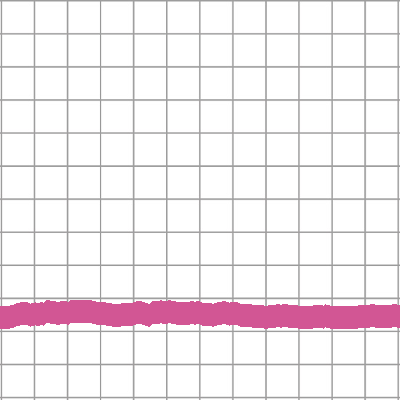

pitch71_thick2_color7_0_train.png


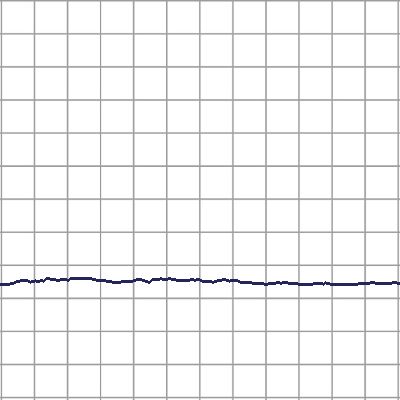

pitch72_thick0_color0_0_train.png


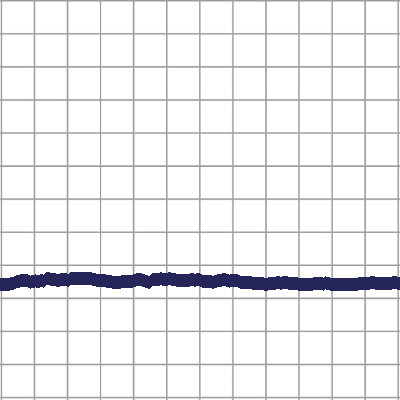

pitch72_thick1_color0_0_train.png


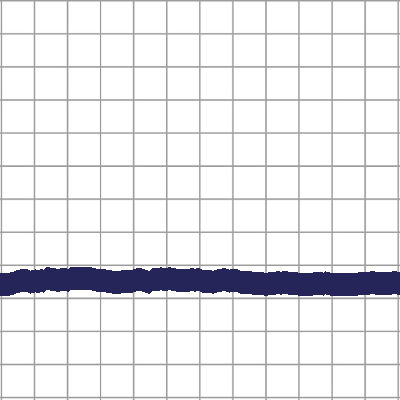

pitch72_thick2_color0_0_train.png


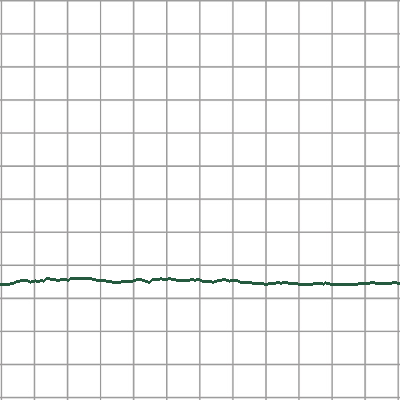

pitch72_thick0_color1_0_train.png


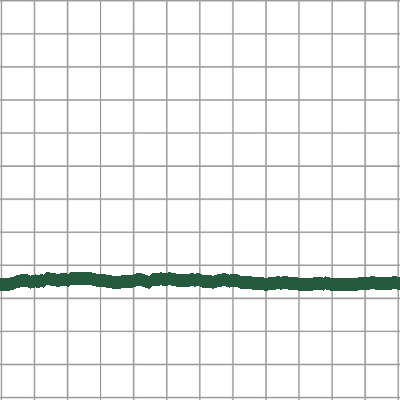

pitch72_thick1_color1_0_train.png


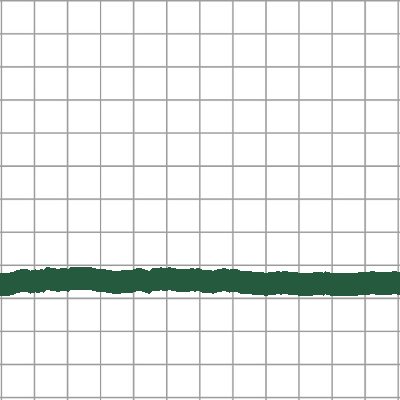

pitch72_thick2_color1_0_train.png


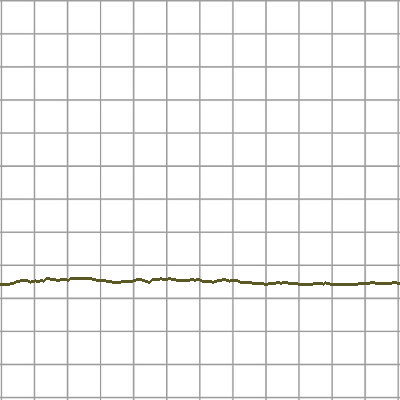

pitch72_thick0_color2_0_train.png


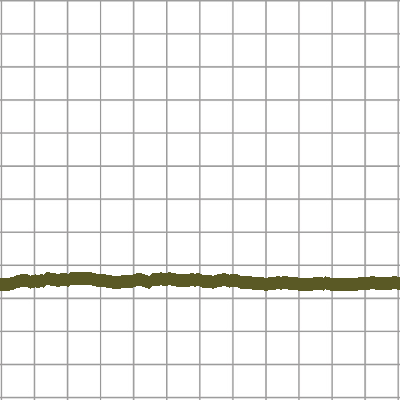

pitch72_thick1_color2_0_train.png


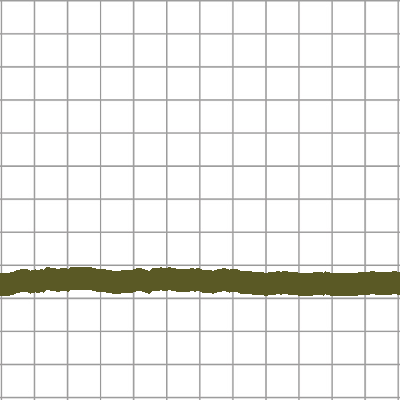

pitch72_thick2_color2_0_train.png


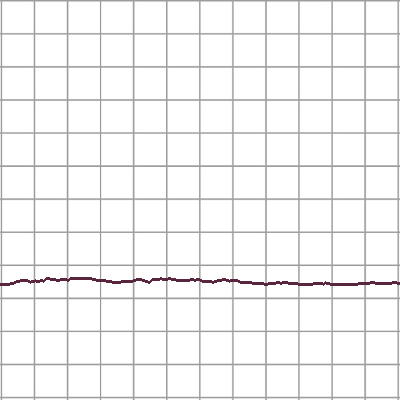

pitch72_thick0_color3_0_train.png


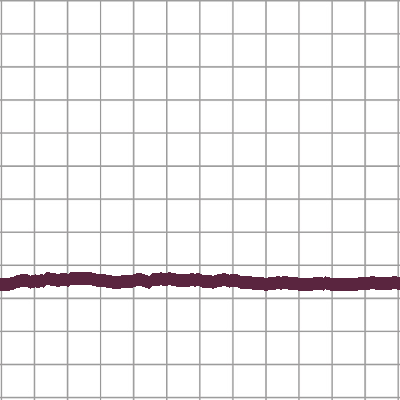

pitch72_thick1_color3_0_train.png


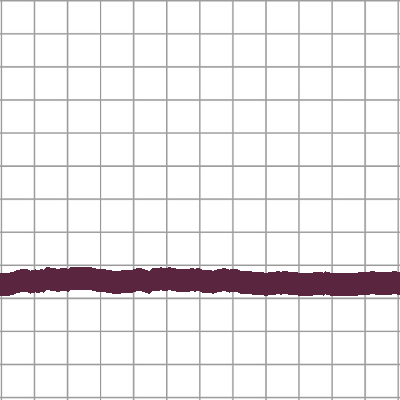

pitch72_thick2_color3_0_train.png


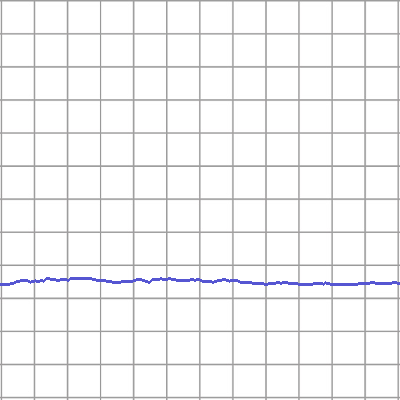

pitch72_thick0_color4_0_train.png


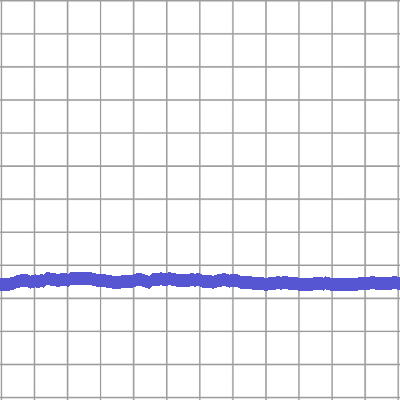

pitch72_thick1_color4_0_train.png


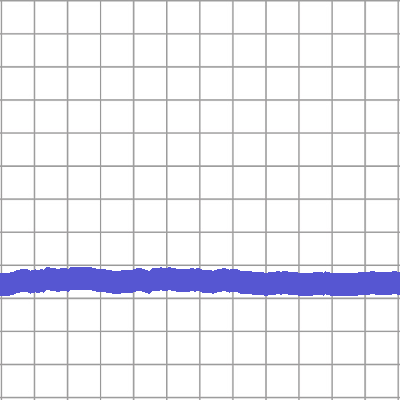

pitch72_thick2_color4_0_train.png


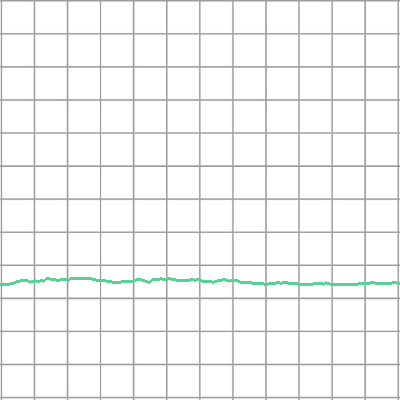

pitch72_thick0_color5_0_train.png


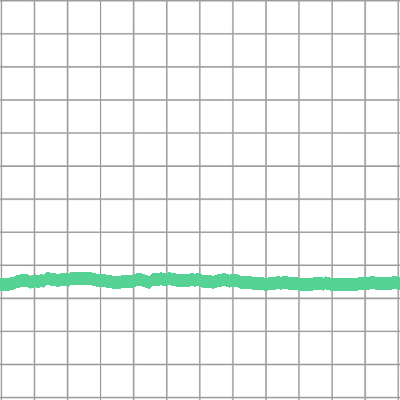

pitch72_thick1_color5_0_train.png


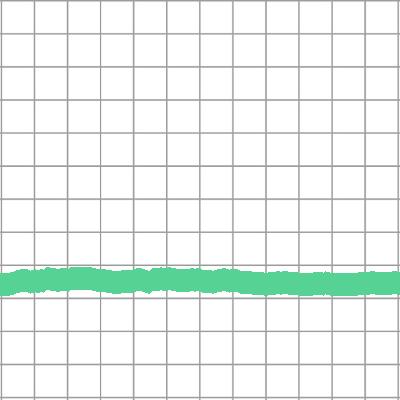

pitch72_thick2_color5_0_train.png


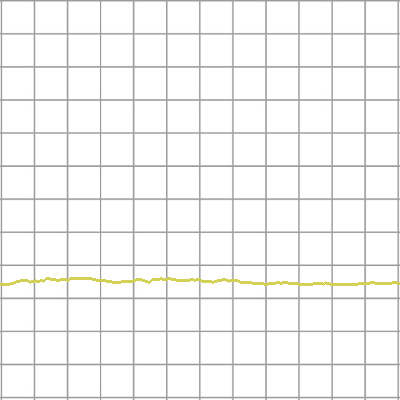

pitch72_thick0_color6_0_train.png


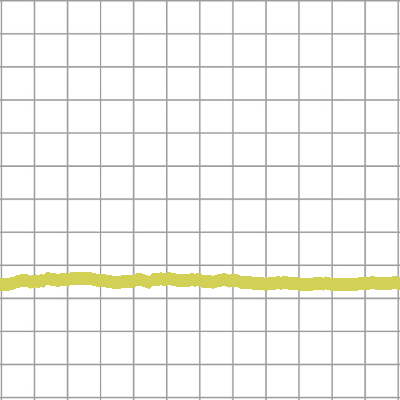

pitch72_thick1_color6_0_train.png


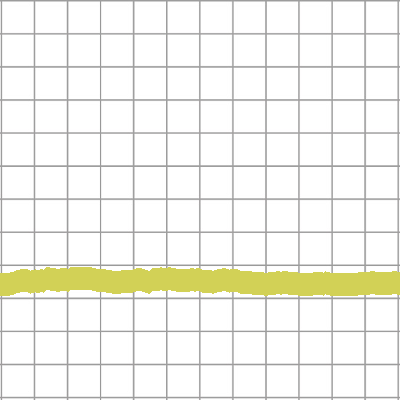

pitch72_thick2_color6_0_train.png


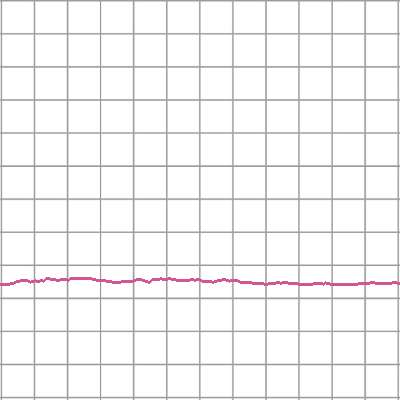

pitch72_thick0_color7_0_train.png


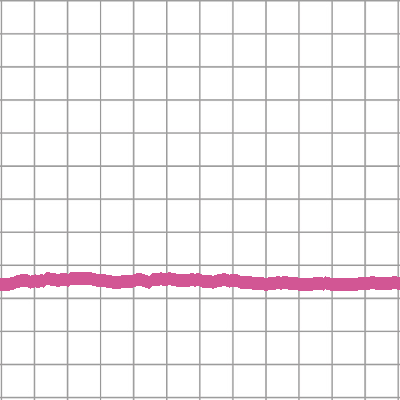

pitch72_thick1_color7_0_train.png


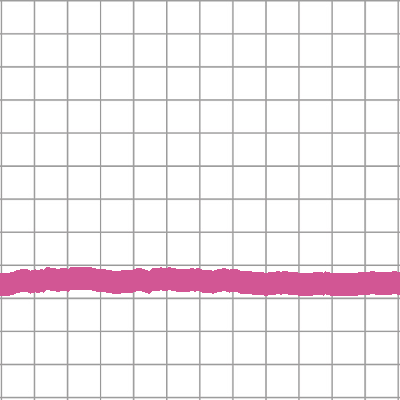

pitch72_thick2_color7_0_train.png


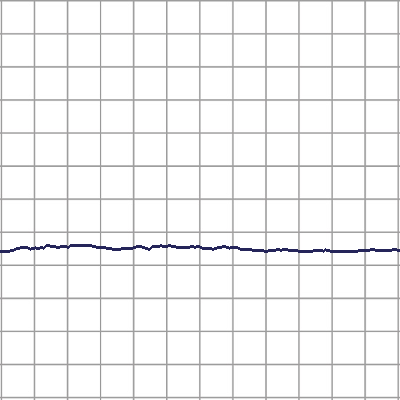

pitch73_thick0_color0_0_train.png


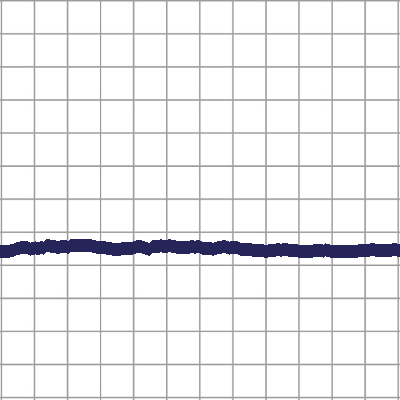

pitch73_thick1_color0_0_train.png


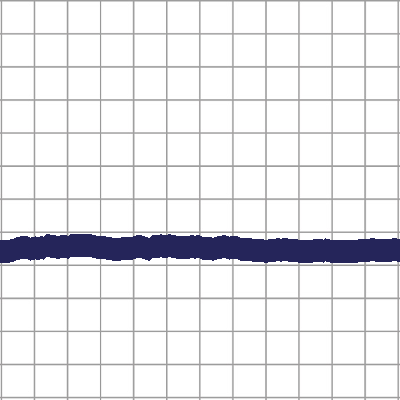

pitch73_thick2_color0_0_train.png


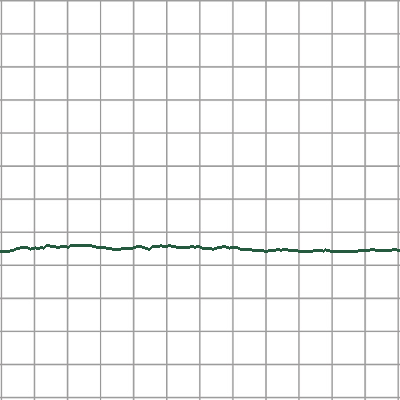

pitch73_thick0_color1_0_train.png


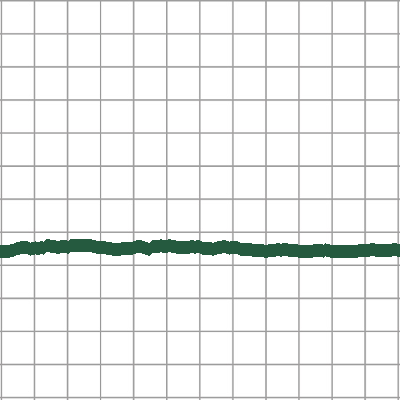

pitch73_thick1_color1_0_train.png


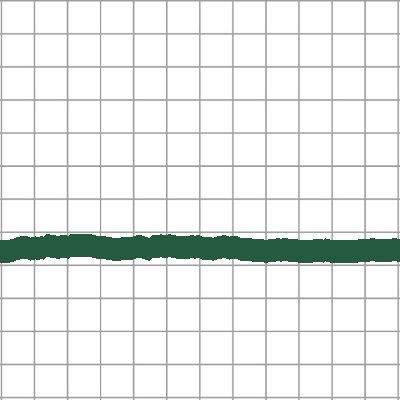

pitch73_thick2_color1_0_train.png


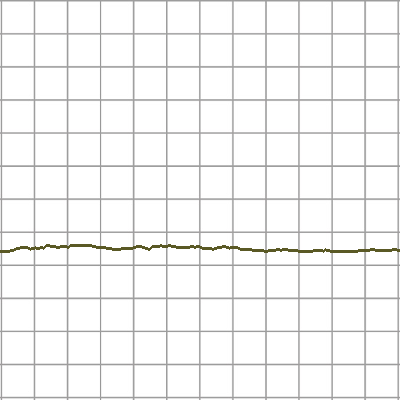

pitch73_thick0_color2_0_train.png


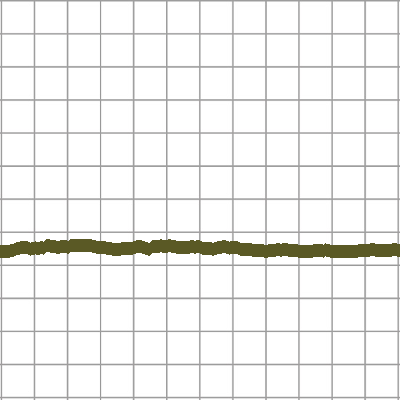

pitch73_thick1_color2_0_train.png


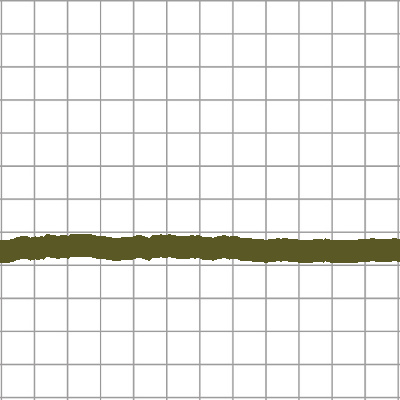

pitch73_thick2_color2_0_train.png


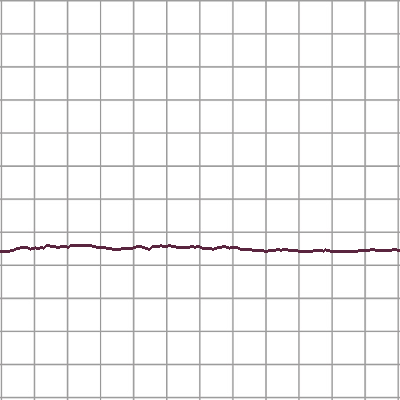

pitch73_thick0_color3_0_train.png


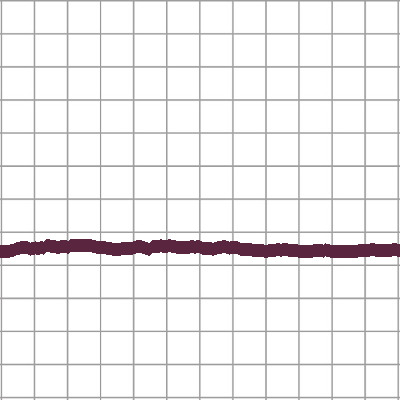

pitch73_thick1_color3_0_train.png


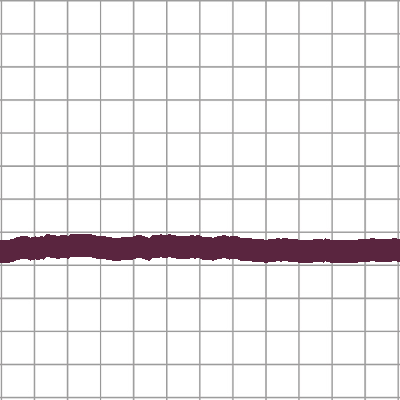

pitch73_thick2_color3_0_train.png


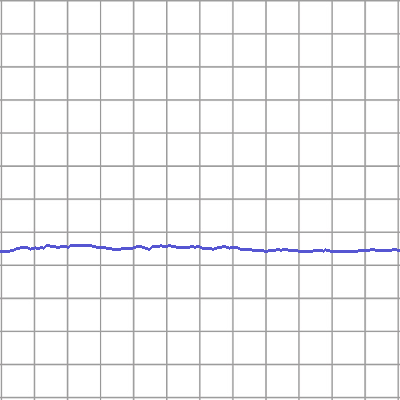

pitch73_thick0_color4_0_train.png


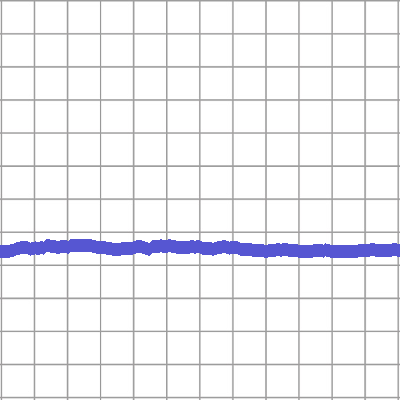

pitch73_thick1_color4_0_train.png


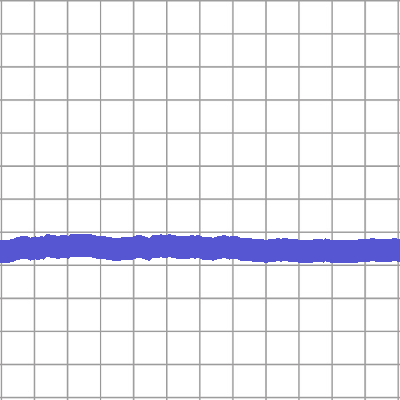

pitch73_thick2_color4_0_train.png


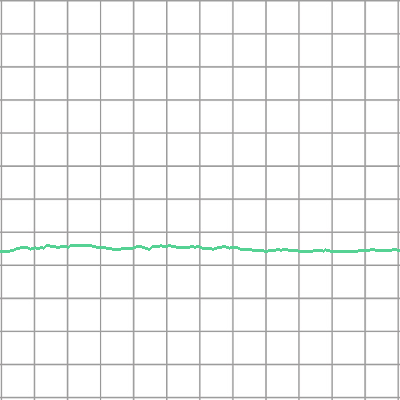

pitch73_thick0_color5_0_train.png


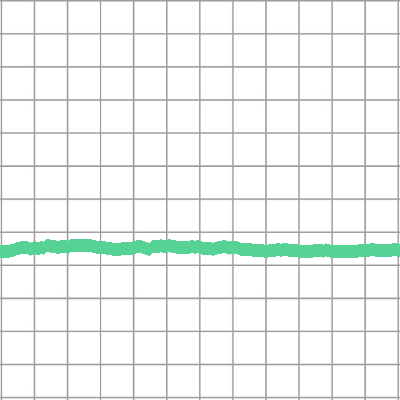

pitch73_thick1_color5_0_train.png


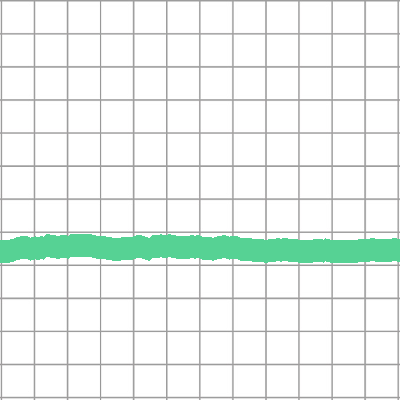

pitch73_thick2_color5_0_train.png


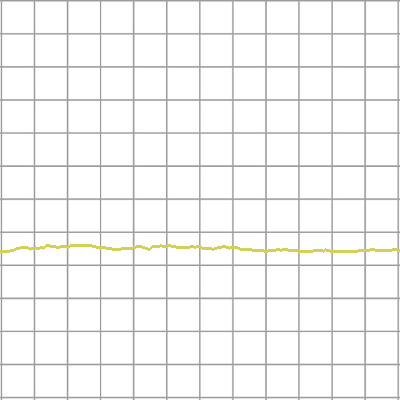

pitch73_thick0_color6_0_train.png


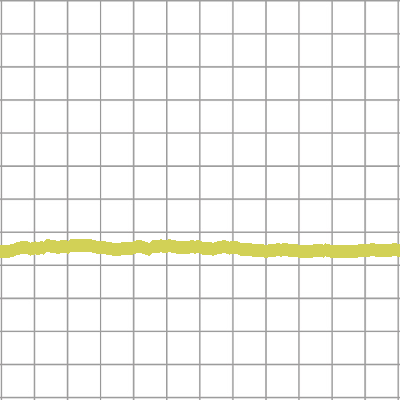

pitch73_thick1_color6_0_train.png


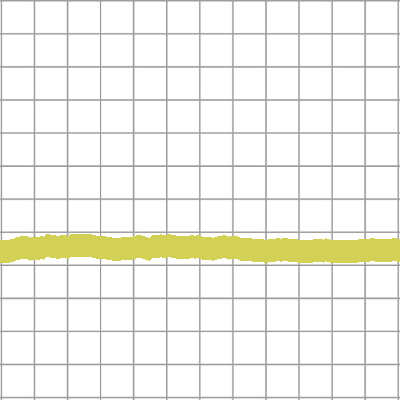

pitch73_thick2_color6_0_train.png


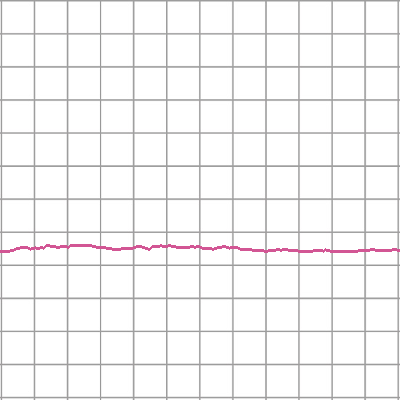

pitch73_thick0_color7_0_train.png


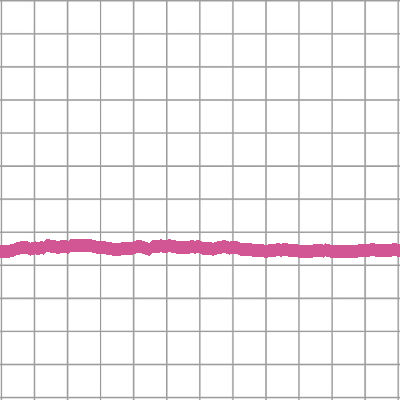

pitch73_thick1_color7_0_train.png


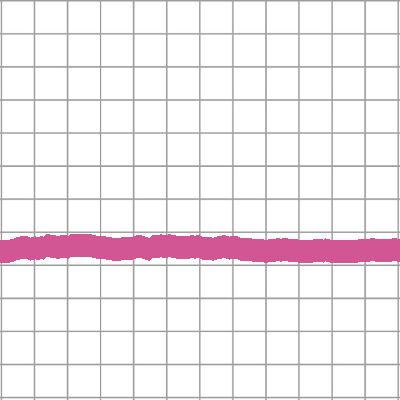

pitch73_thick2_color7_0_train.png


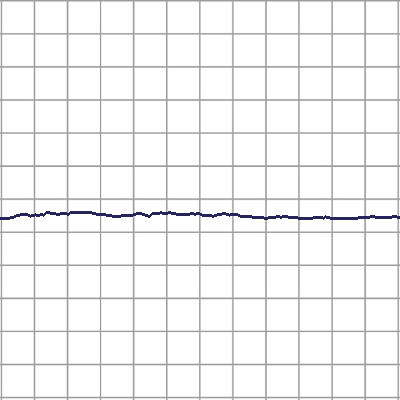

pitch74_thick0_color0_0_train.png


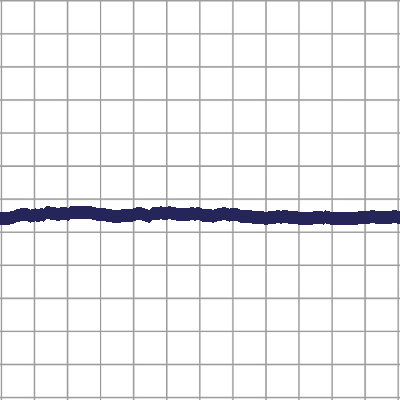

pitch74_thick1_color0_0_train.png


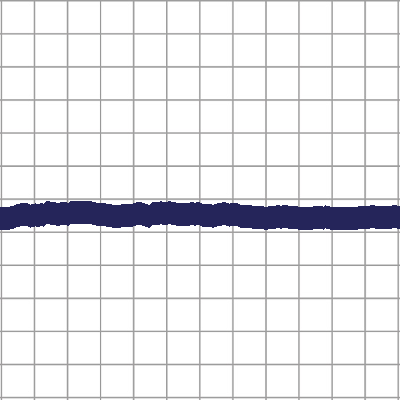

pitch74_thick2_color0_0_train.png


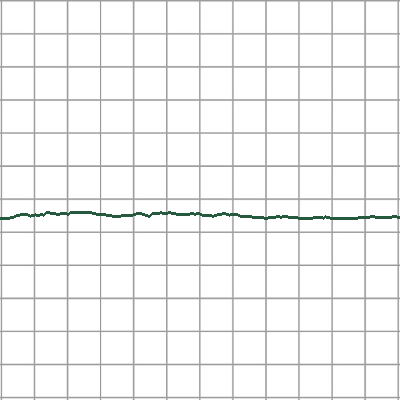

pitch74_thick0_color1_0_train.png


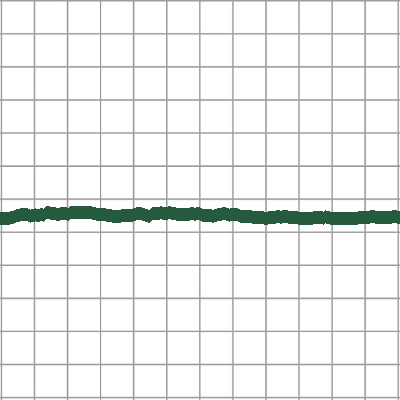

pitch74_thick1_color1_0_train.png


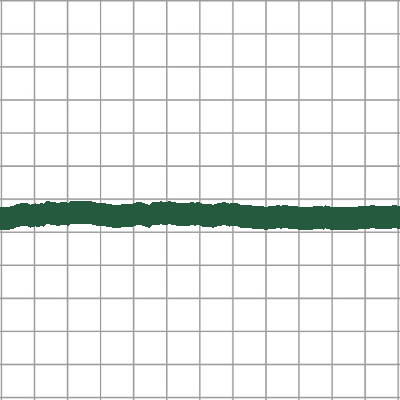

pitch74_thick2_color1_0_train.png


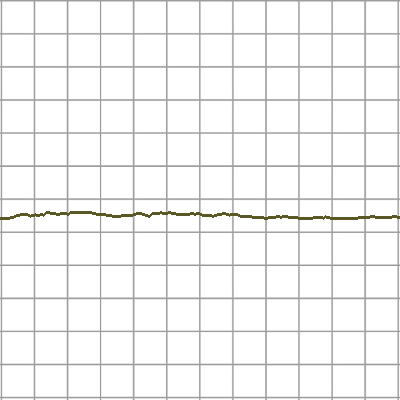

pitch74_thick0_color2_0_train.png


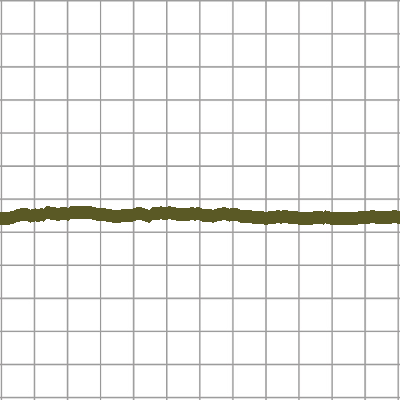

pitch74_thick1_color2_0_train.png


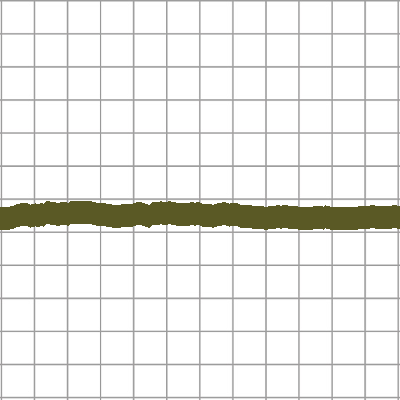

pitch74_thick2_color2_0_train.png


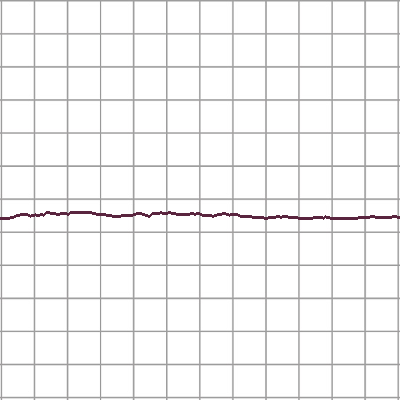

pitch74_thick0_color3_0_train.png


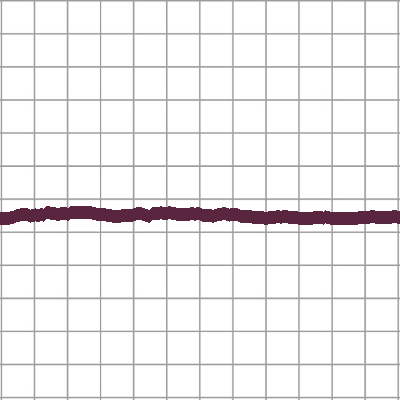

pitch74_thick1_color3_0_train.png


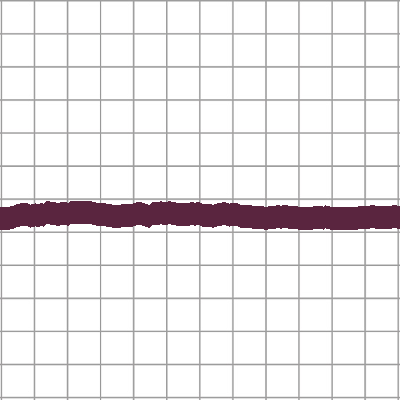

pitch74_thick2_color3_0_train.png


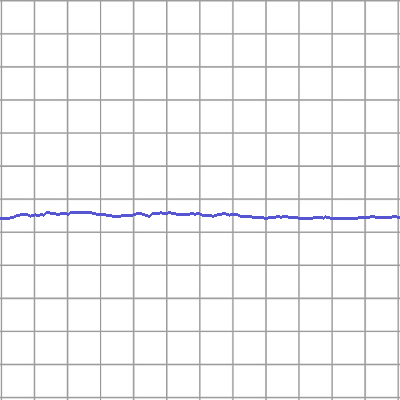

pitch74_thick0_color4_0_train.png


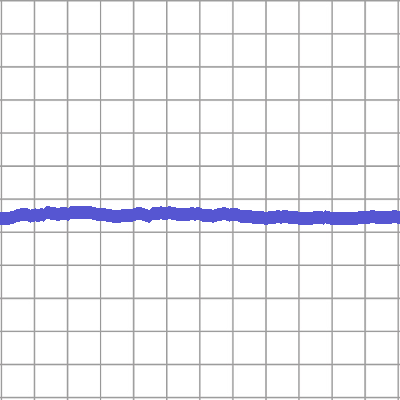

pitch74_thick1_color4_0_train.png


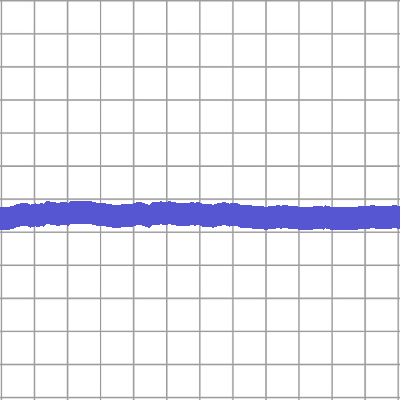

pitch74_thick2_color4_0_train.png


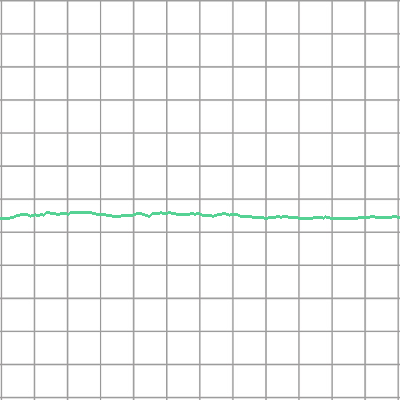

pitch74_thick0_color5_0_train.png


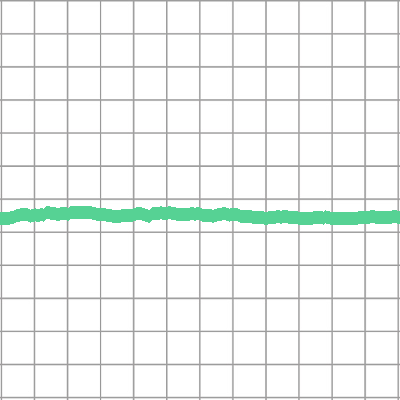

pitch74_thick1_color5_0_train.png


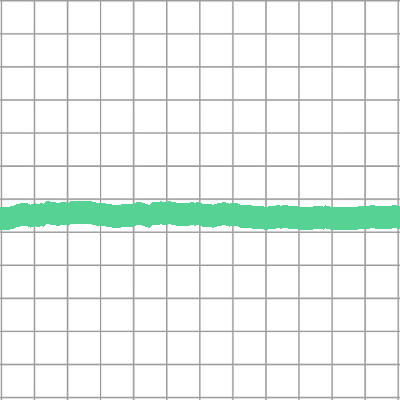

pitch74_thick2_color5_0_train.png


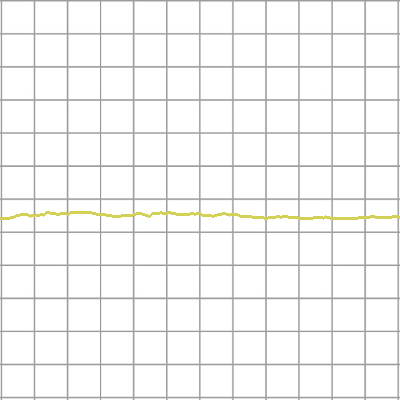

pitch74_thick0_color6_0_train.png


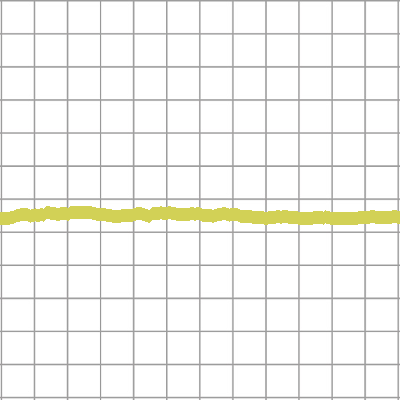

pitch74_thick1_color6_0_train.png


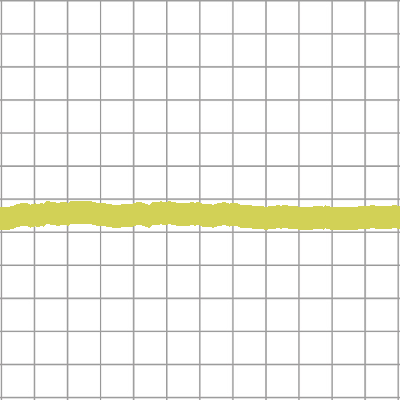

pitch74_thick2_color6_0_train.png


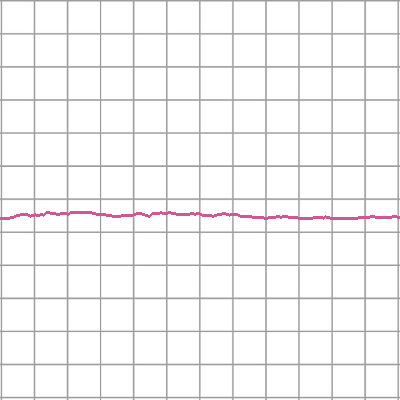

pitch74_thick0_color7_0_train.png


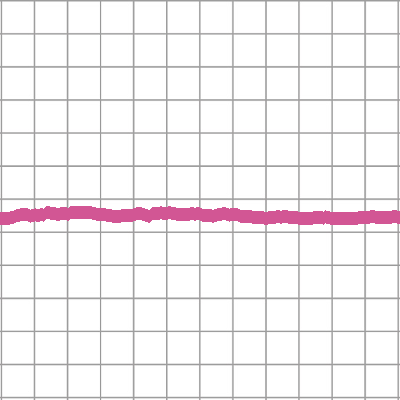

pitch74_thick1_color7_0_train.png


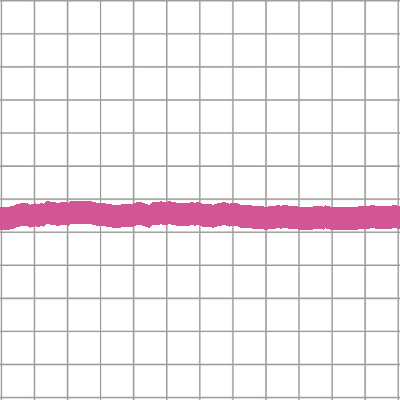

pitch74_thick2_color7_0_train.png


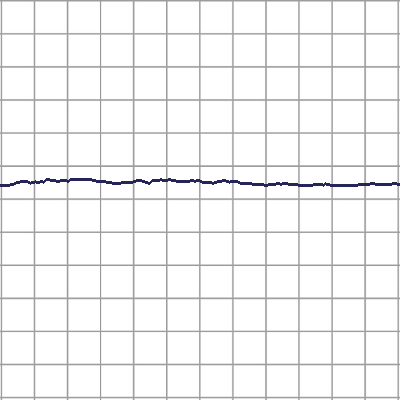

pitch75_thick0_color0_0_train.png


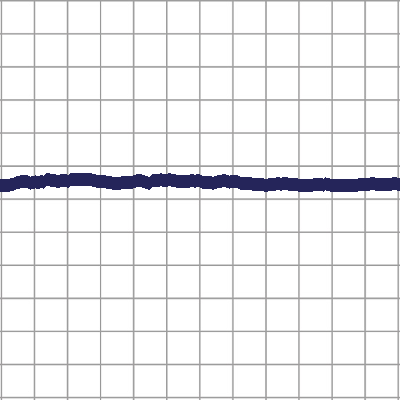

pitch75_thick1_color0_0_train.png


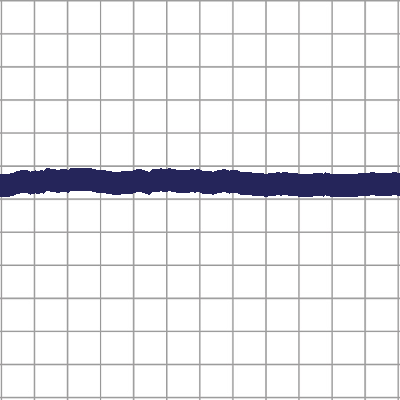

pitch75_thick2_color0_0_train.png


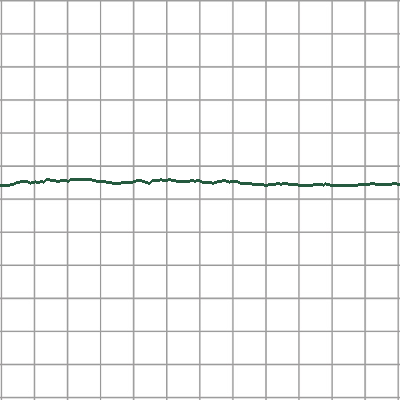

pitch75_thick0_color1_0_train.png


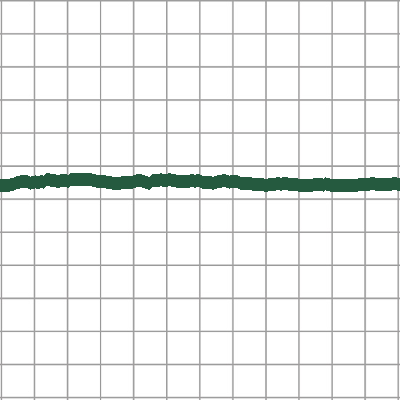

pitch75_thick1_color1_0_train.png


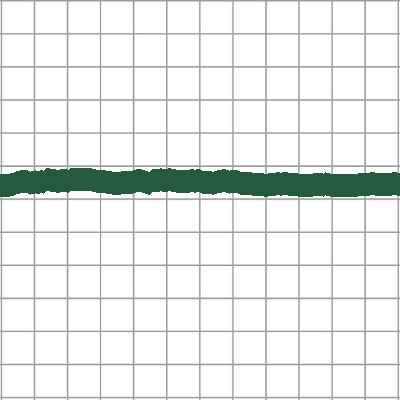

pitch75_thick2_color1_0_train.png


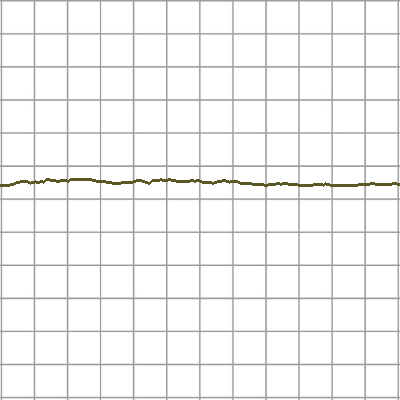

pitch75_thick0_color2_0_train.png


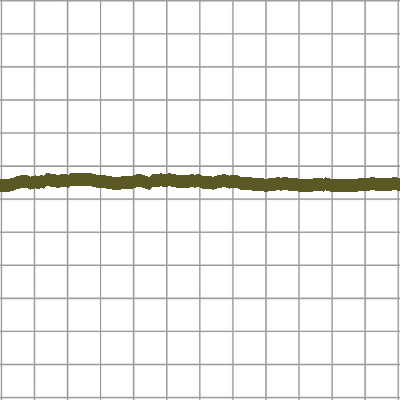

pitch75_thick1_color2_0_train.png


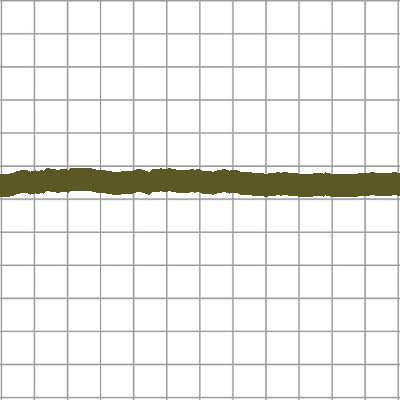

pitch75_thick2_color2_0_train.png


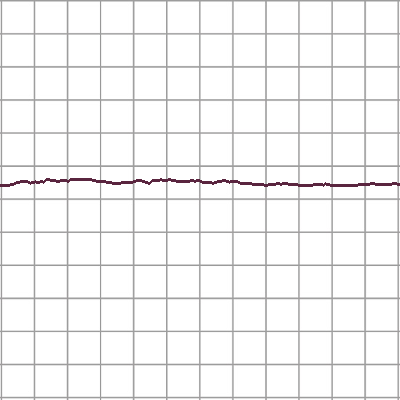

pitch75_thick0_color3_0_train.png


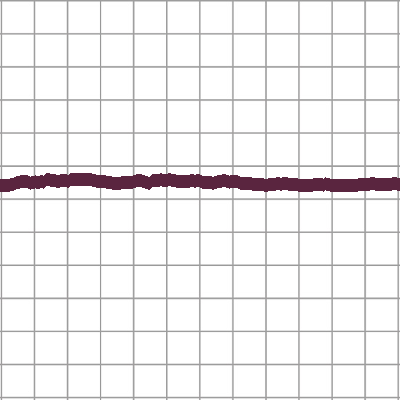

pitch75_thick1_color3_0_train.png


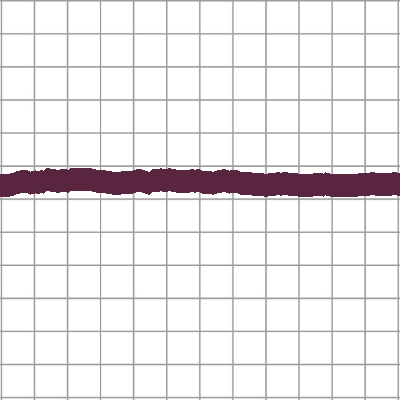

pitch75_thick2_color3_0_train.png


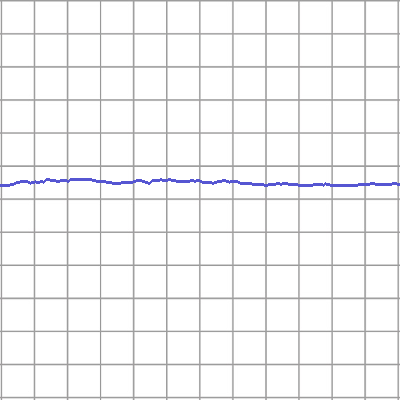

pitch75_thick0_color4_0_train.png


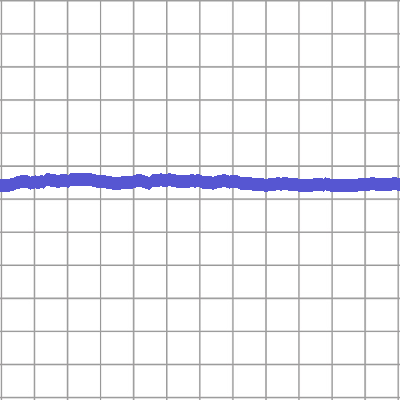

pitch75_thick1_color4_0_train.png


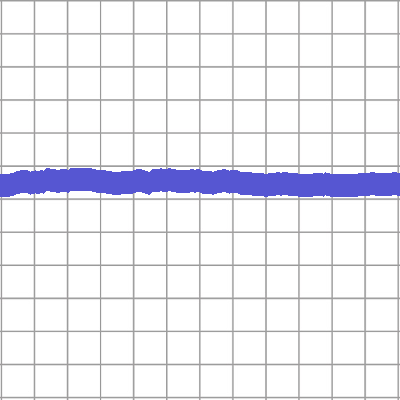

pitch75_thick2_color4_0_train.png


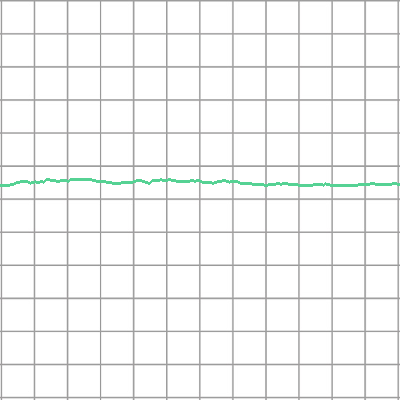

pitch75_thick0_color5_0_train.png


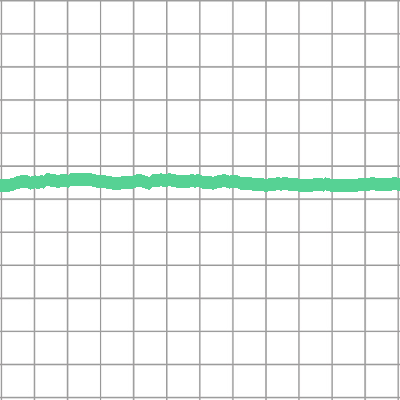

pitch75_thick1_color5_0_train.png


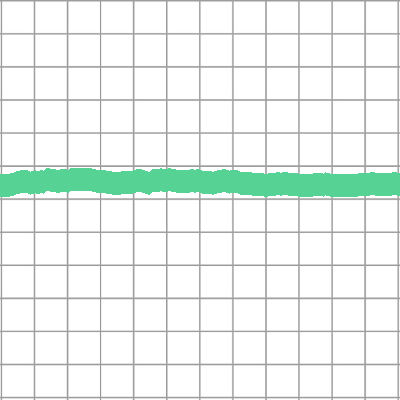

pitch75_thick2_color5_0_train.png


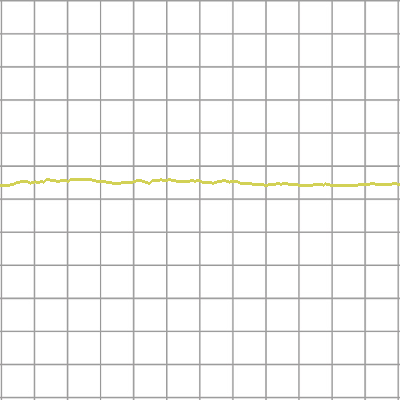

pitch75_thick0_color6_0_train.png


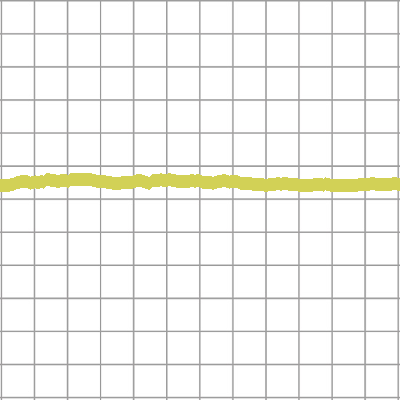

pitch75_thick1_color6_0_train.png


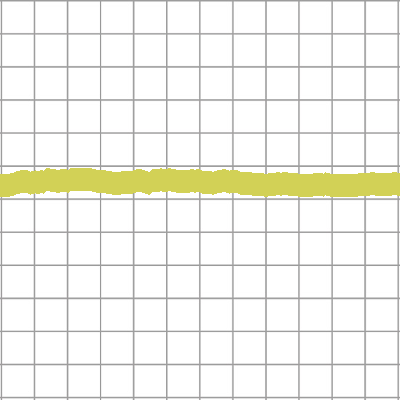

pitch75_thick2_color6_0_train.png


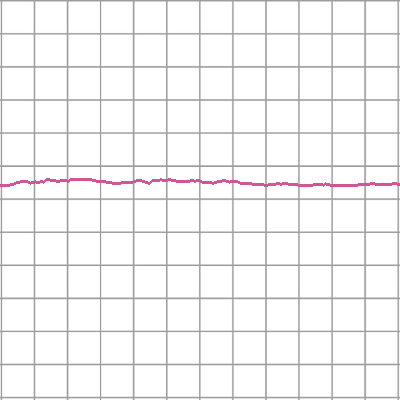

pitch75_thick0_color7_0_train.png


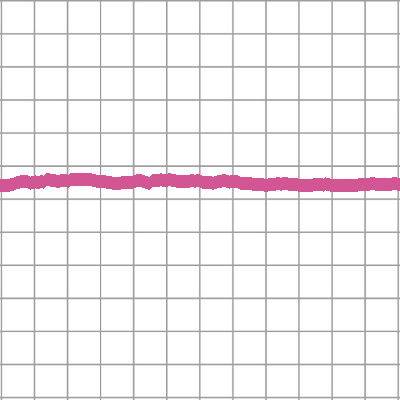

pitch75_thick1_color7_0_train.png


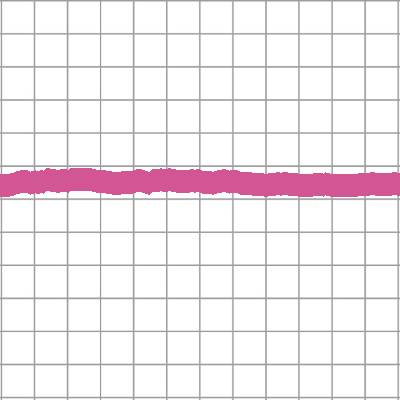

pitch75_thick2_color7_0_train.png


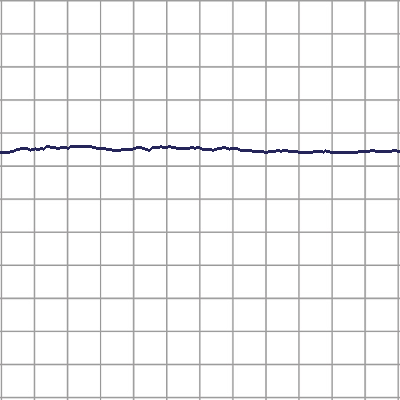

pitch76_thick0_color0_0_train.png


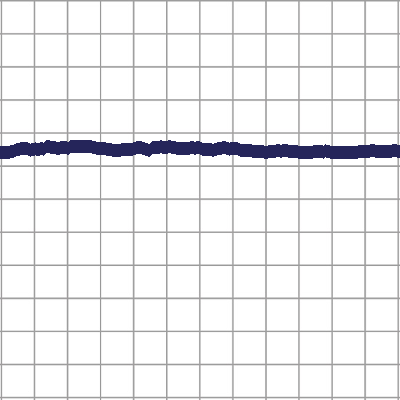

pitch76_thick1_color0_0_train.png


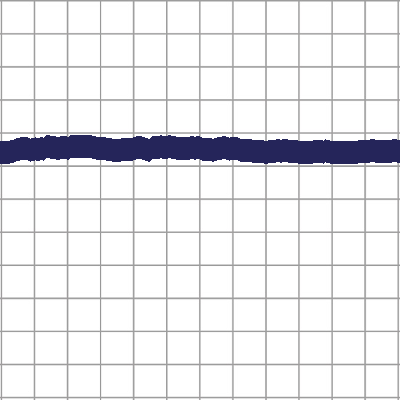

pitch76_thick2_color0_0_train.png


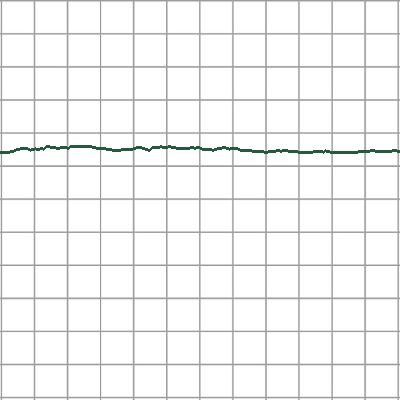

pitch76_thick0_color1_0_train.png


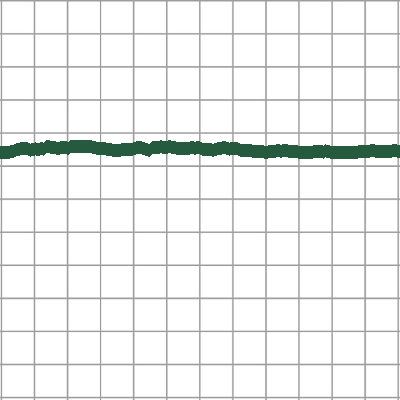

pitch76_thick1_color1_0_train.png


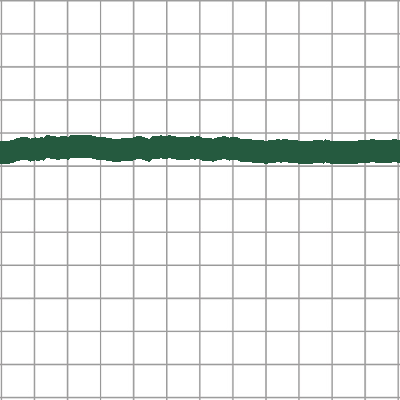

pitch76_thick2_color1_0_train.png


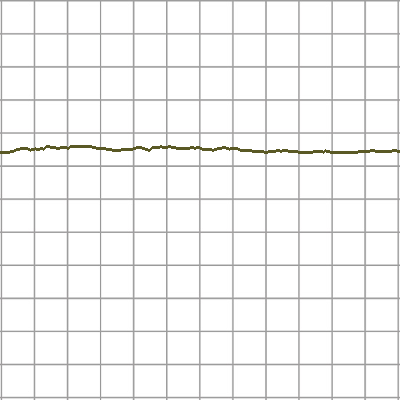

pitch76_thick0_color2_0_train.png


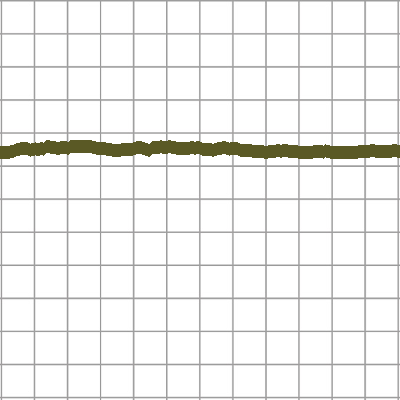

pitch76_thick1_color2_0_train.png


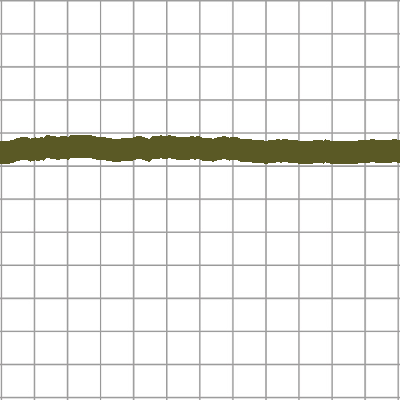

pitch76_thick2_color2_0_train.png


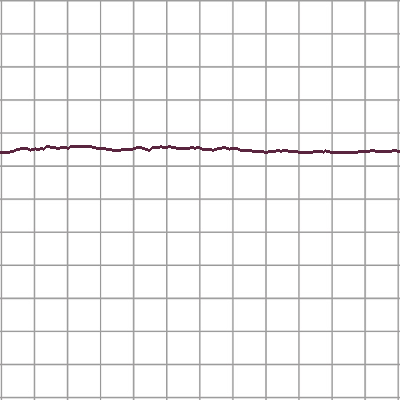

pitch76_thick0_color3_0_train.png


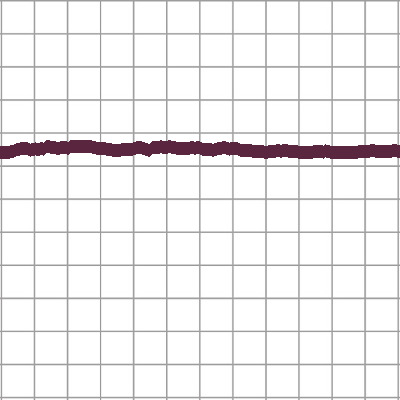

pitch76_thick1_color3_0_train.png


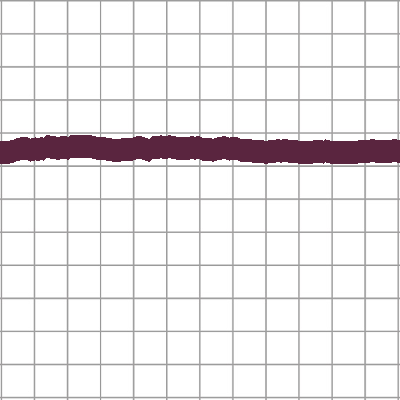

pitch76_thick2_color3_0_train.png


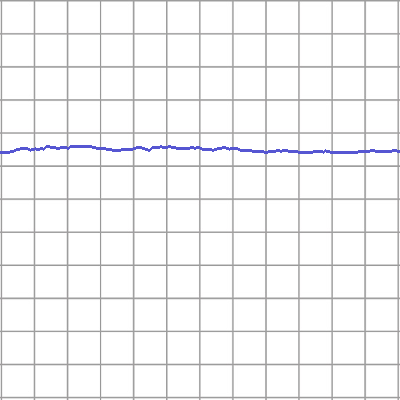

pitch76_thick0_color4_0_train.png


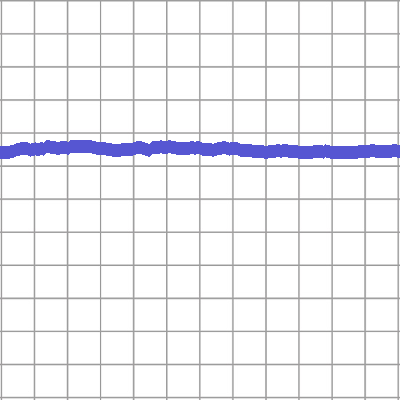

pitch76_thick1_color4_0_train.png


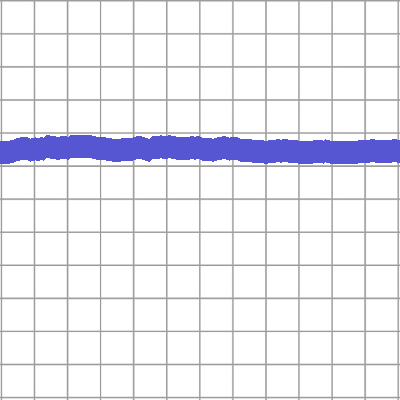

pitch76_thick2_color4_0_train.png


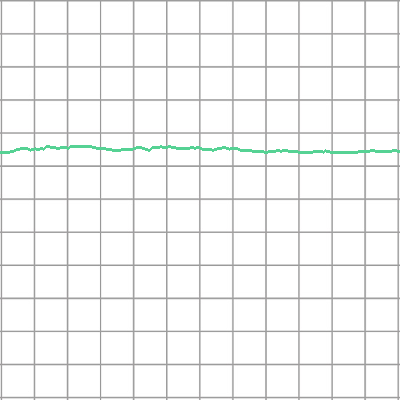

pitch76_thick0_color5_0_train.png


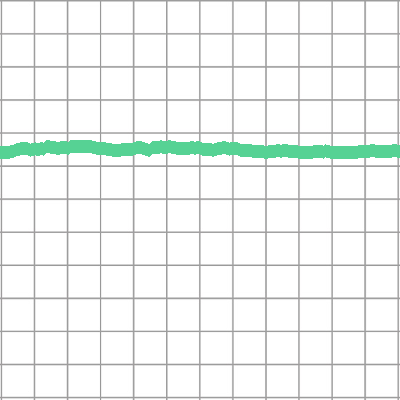

pitch76_thick1_color5_0_train.png


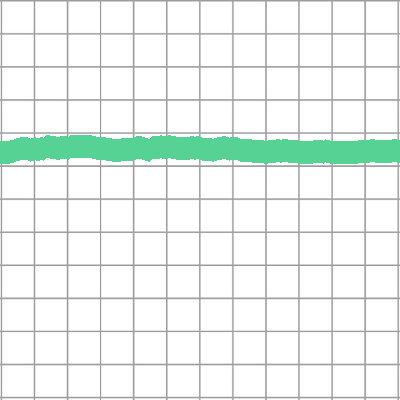

pitch76_thick2_color5_0_train.png


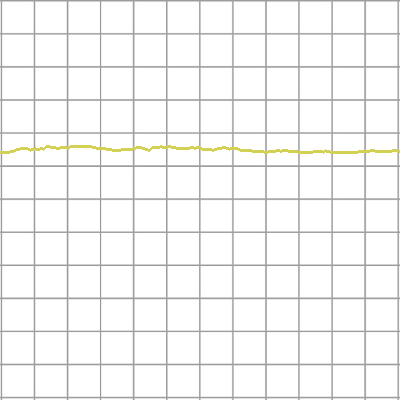

pitch76_thick0_color6_0_train.png


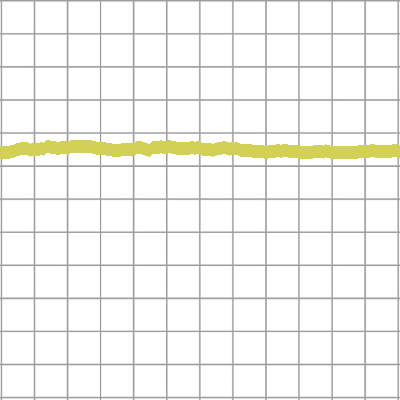

pitch76_thick1_color6_0_train.png


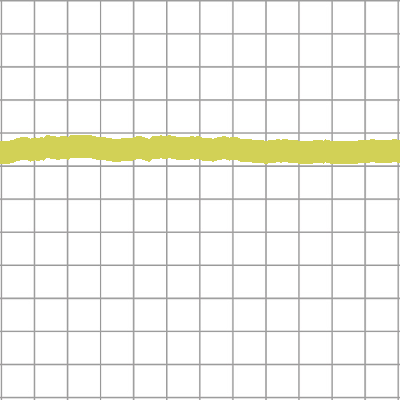

pitch76_thick2_color6_0_train.png


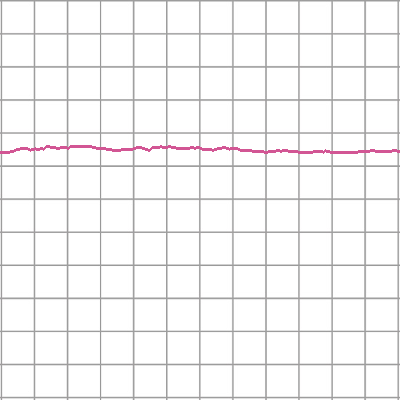

pitch76_thick0_color7_0_train.png


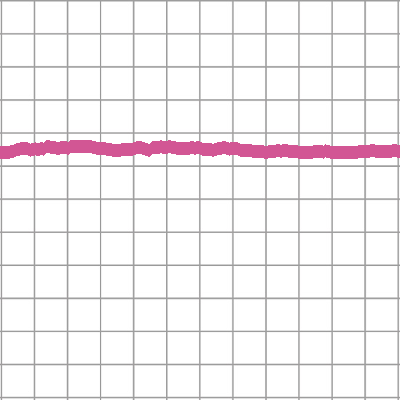

pitch76_thick1_color7_0_train.png


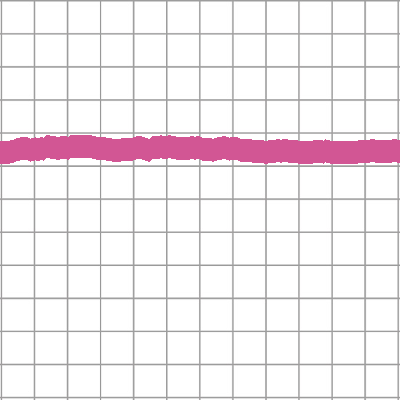

pitch76_thick2_color7_0_train.png


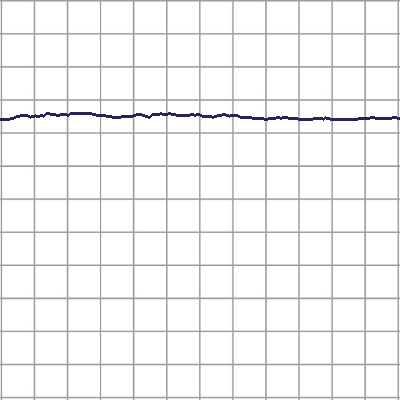

pitch77_thick0_color0_0_train.png


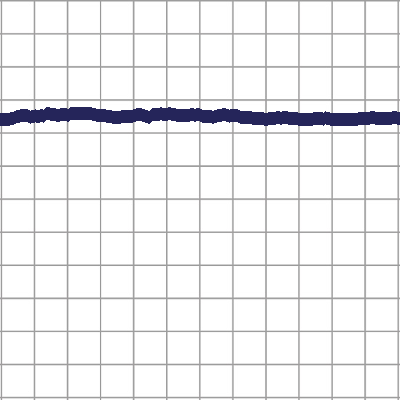

pitch77_thick1_color0_0_train.png


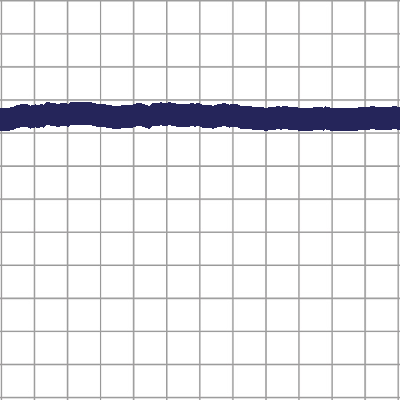

pitch77_thick2_color0_0_train.png


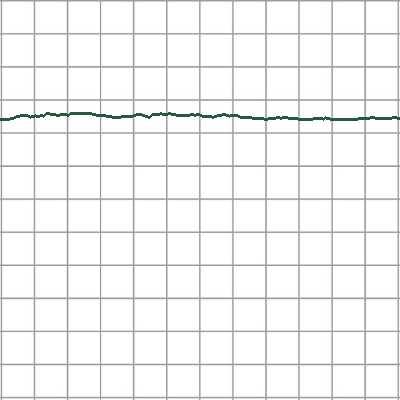

pitch77_thick0_color1_0_train.png


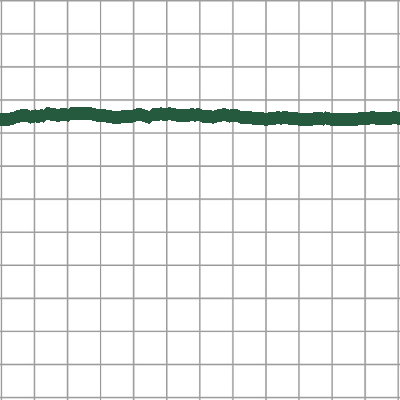

pitch77_thick1_color1_0_train.png


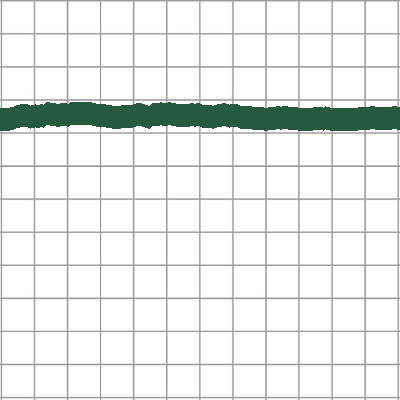

pitch77_thick2_color1_0_train.png


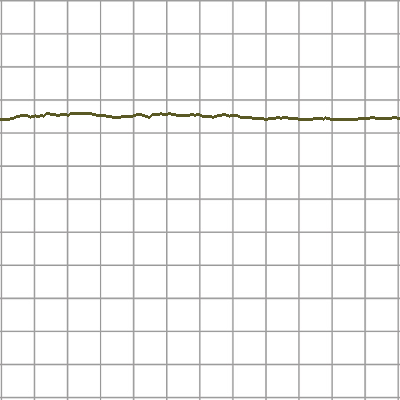

pitch77_thick0_color2_0_train.png


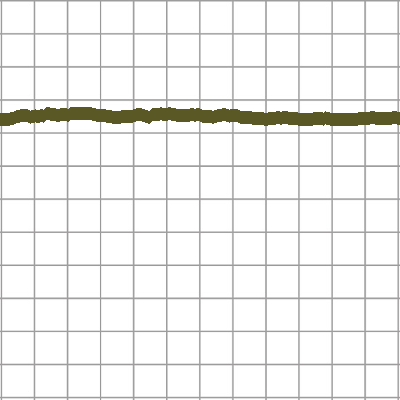

pitch77_thick1_color2_0_train.png


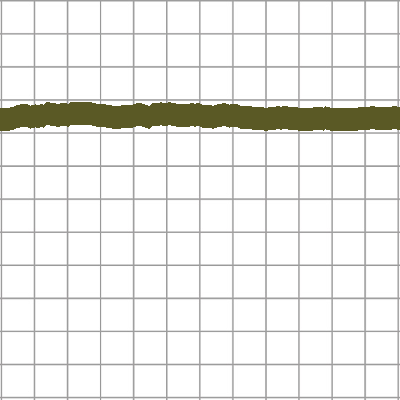

pitch77_thick2_color2_0_train.png


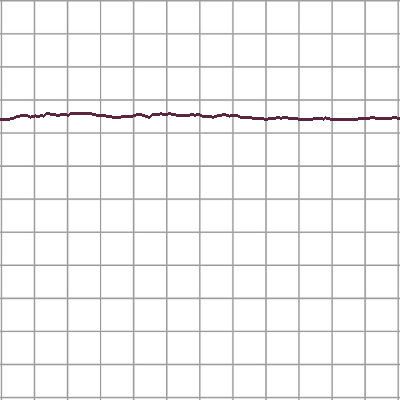

pitch77_thick0_color3_0_train.png


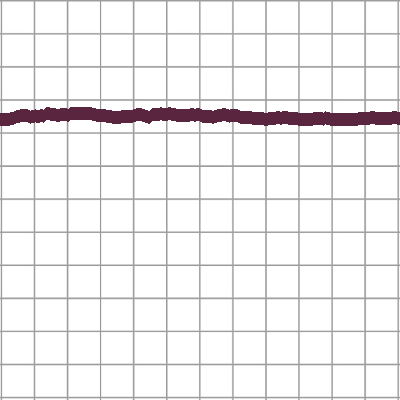

pitch77_thick1_color3_0_train.png


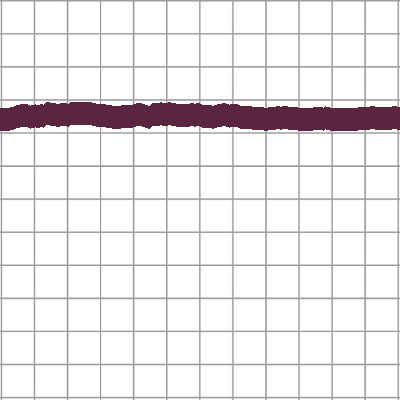

pitch77_thick2_color3_0_train.png


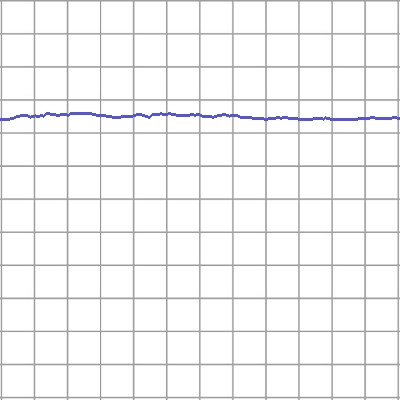

pitch77_thick0_color4_0_train.png


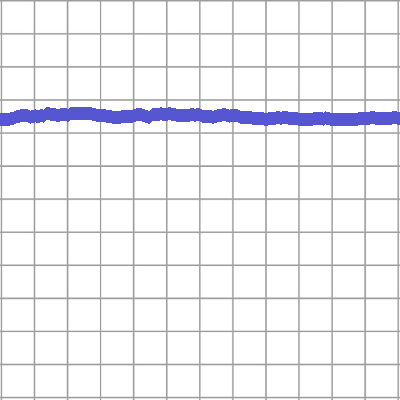

pitch77_thick1_color4_0_train.png


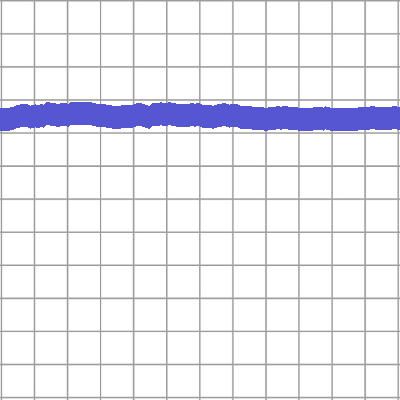

pitch77_thick2_color4_0_train.png


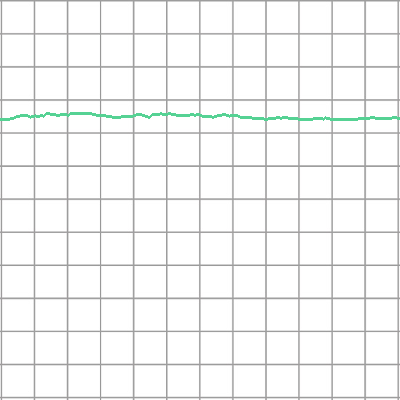

pitch77_thick0_color5_0_train.png


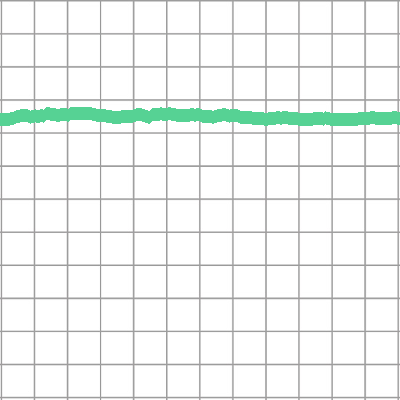

pitch77_thick1_color5_0_train.png


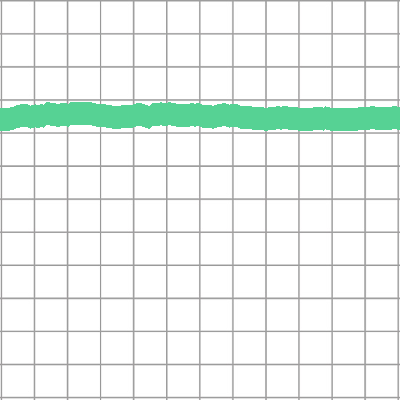

pitch77_thick2_color5_0_train.png


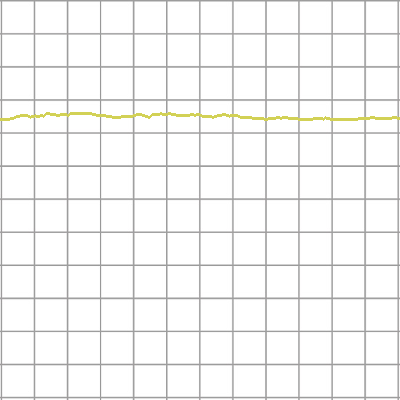

pitch77_thick0_color6_0_train.png


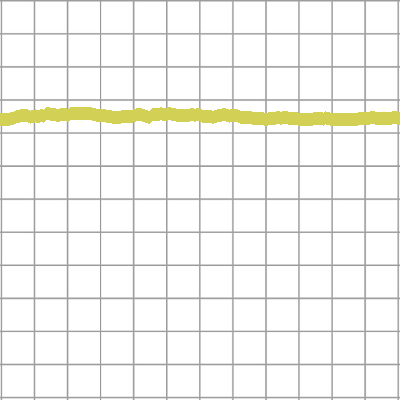

pitch77_thick1_color6_0_train.png


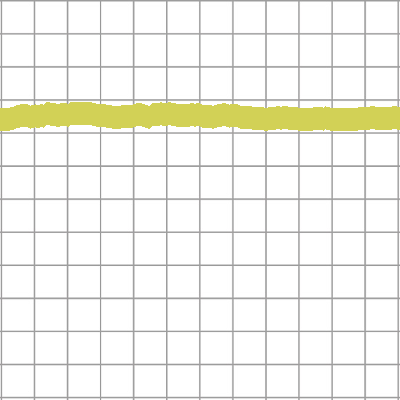

pitch77_thick2_color6_0_train.png


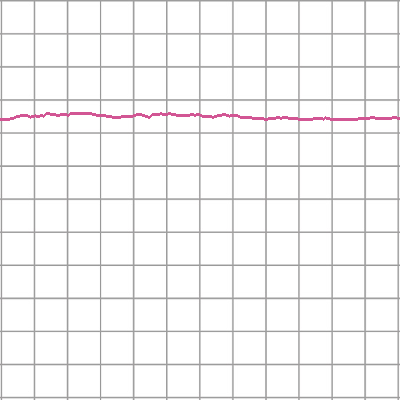

pitch77_thick0_color7_0_train.png


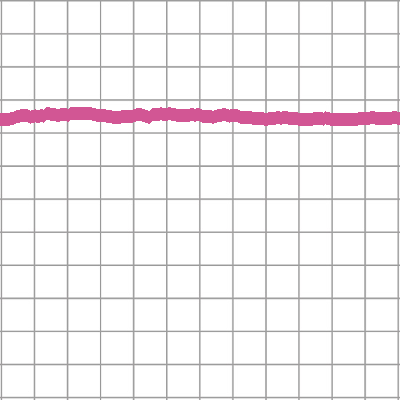

pitch77_thick1_color7_0_train.png


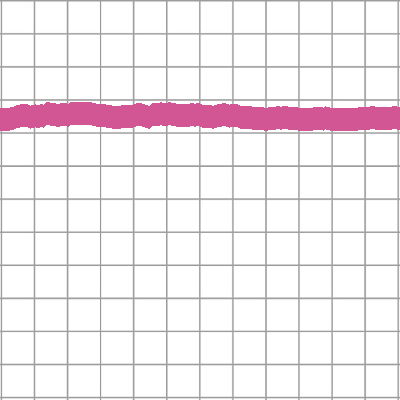

pitch77_thick2_color7_0_train.png


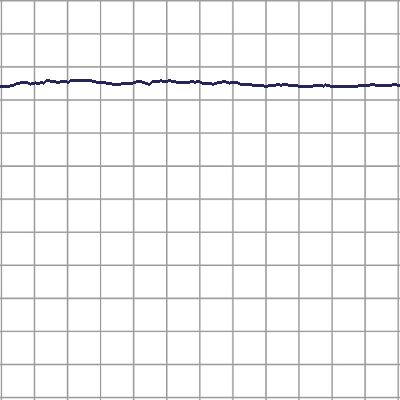

pitch78_thick0_color0_0_train.png


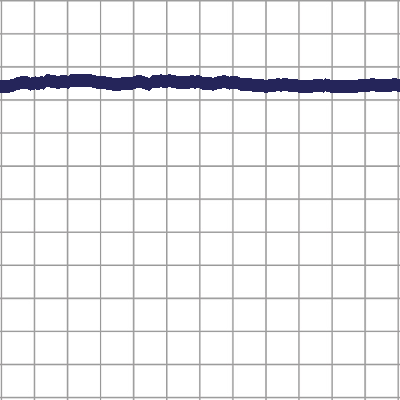

pitch78_thick1_color0_0_train.png


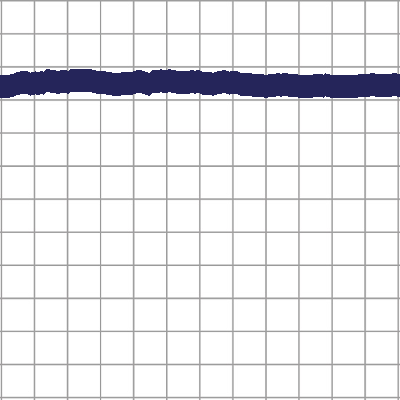

pitch78_thick2_color0_0_train.png


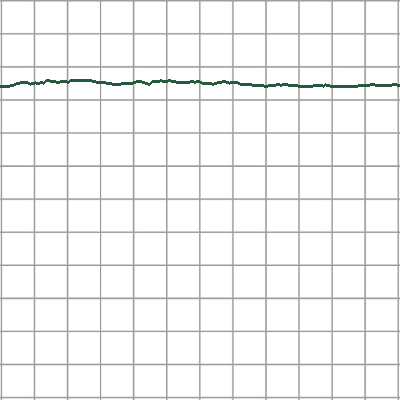

pitch78_thick0_color1_0_train.png


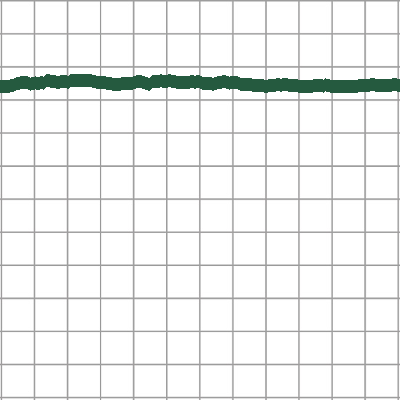

pitch78_thick1_color1_0_train.png


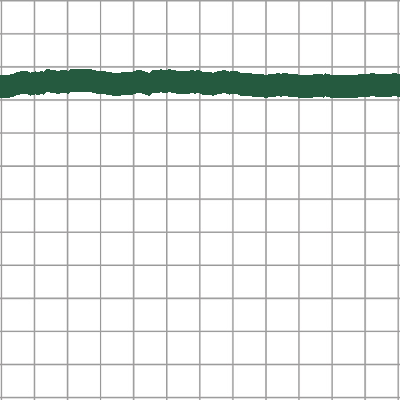

pitch78_thick2_color1_0_train.png


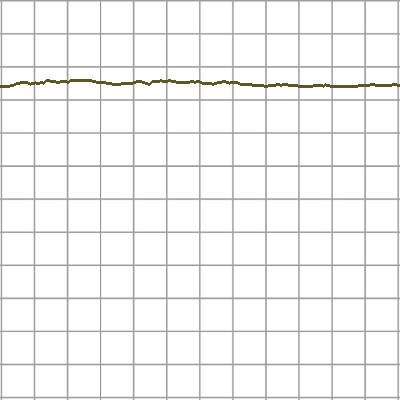

pitch78_thick0_color2_0_train.png


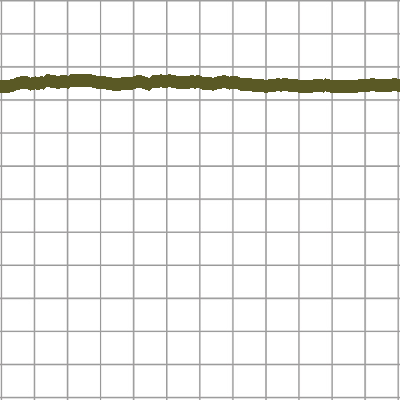

pitch78_thick1_color2_0_train.png


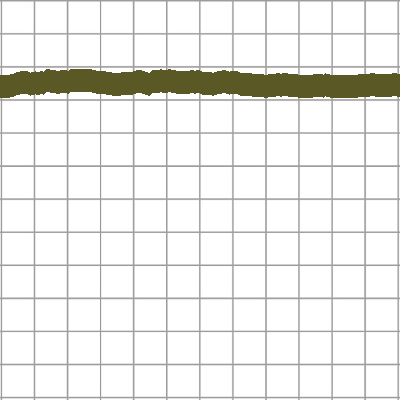

pitch78_thick2_color2_0_train.png


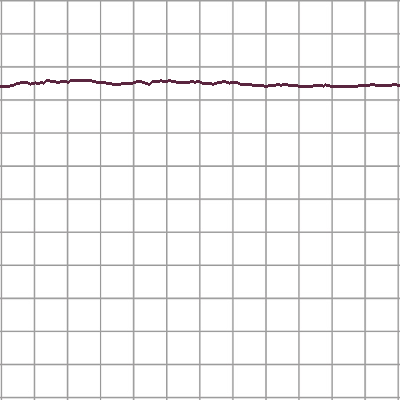

pitch78_thick0_color3_0_train.png


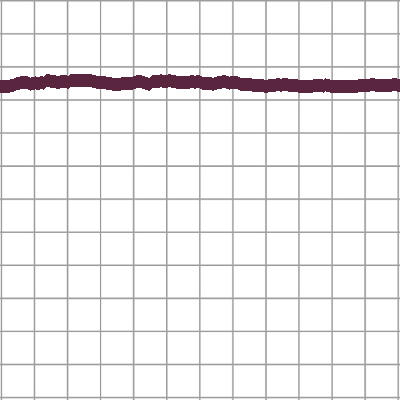

pitch78_thick1_color3_0_train.png


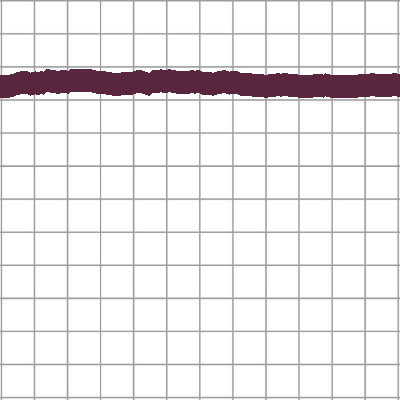

pitch78_thick2_color3_0_train.png


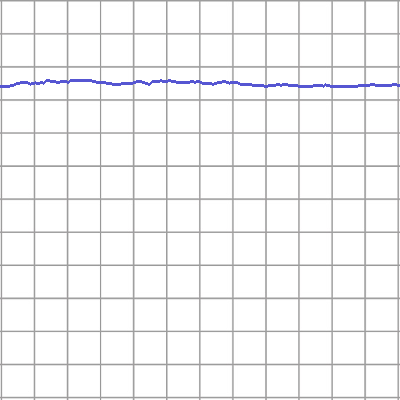

pitch78_thick0_color4_0_train.png


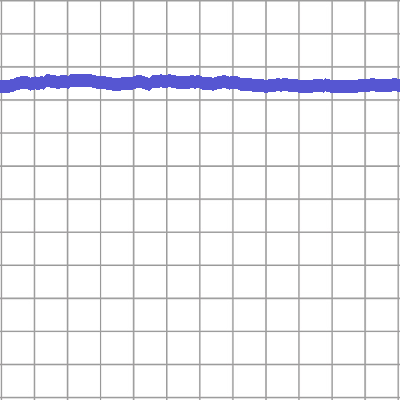

pitch78_thick1_color4_0_train.png


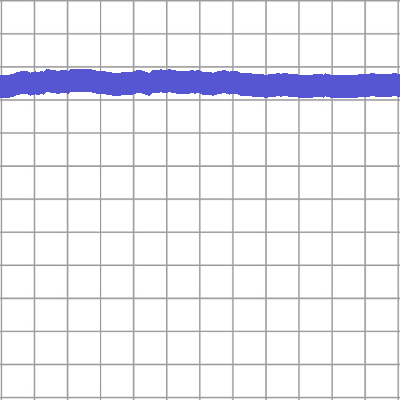

pitch78_thick2_color4_0_train.png


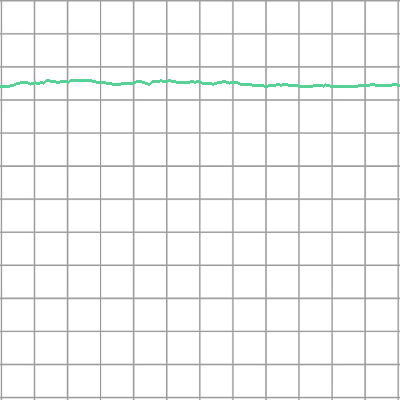

pitch78_thick0_color5_0_train.png


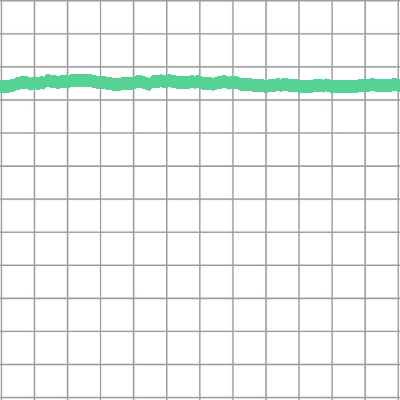

pitch78_thick1_color5_0_train.png


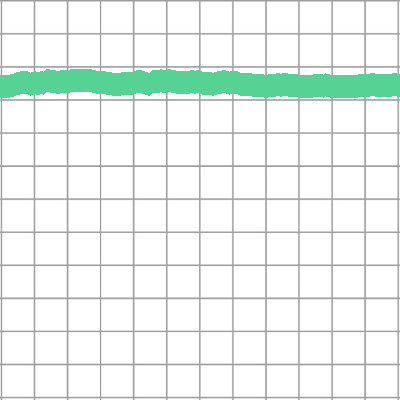

pitch78_thick2_color5_0_train.png


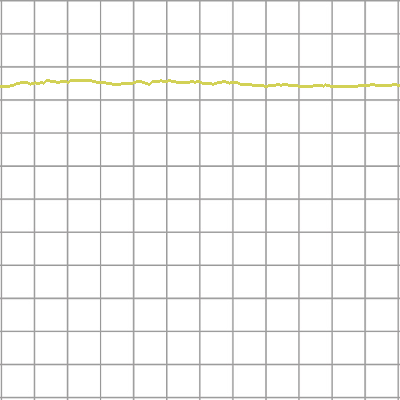

pitch78_thick0_color6_0_train.png


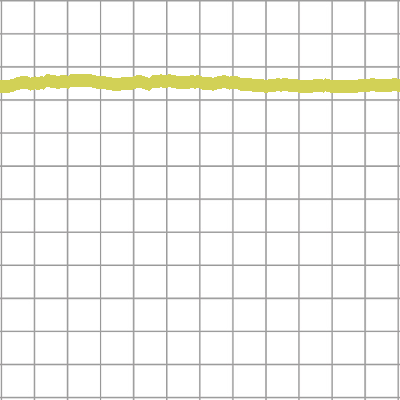

pitch78_thick1_color6_0_train.png


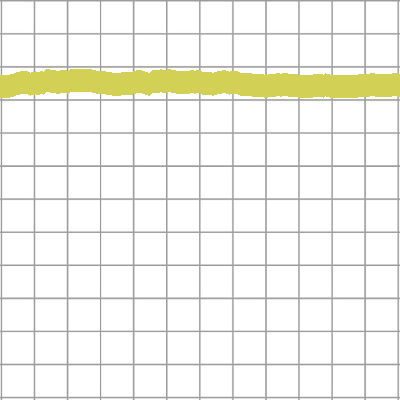

pitch78_thick2_color6_0_train.png


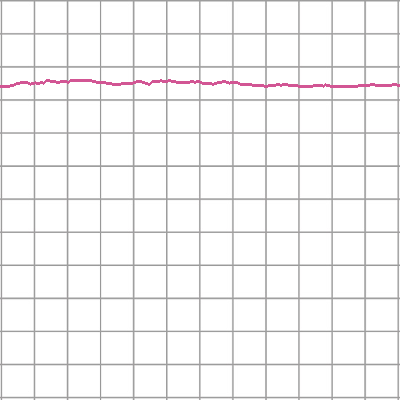

pitch78_thick0_color7_0_train.png


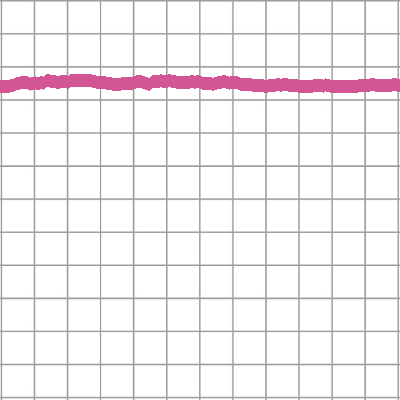

pitch78_thick1_color7_0_train.png


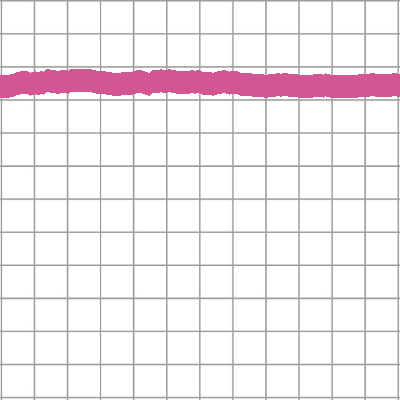

pitch78_thick2_color7_0_train.png


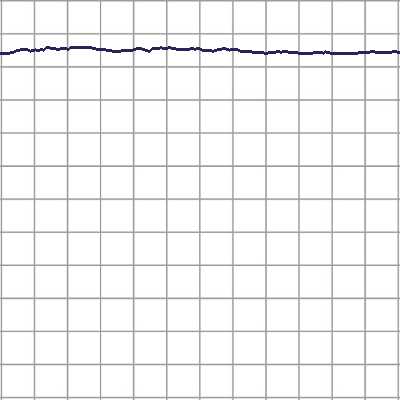

pitch79_thick0_color0_0_train.png


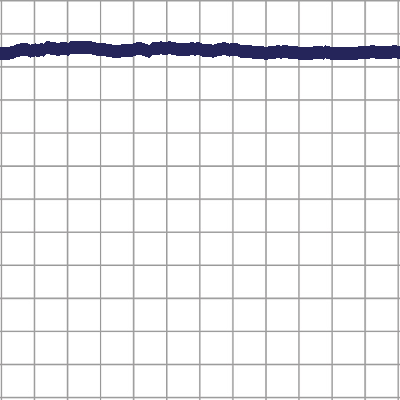

pitch79_thick1_color0_0_train.png


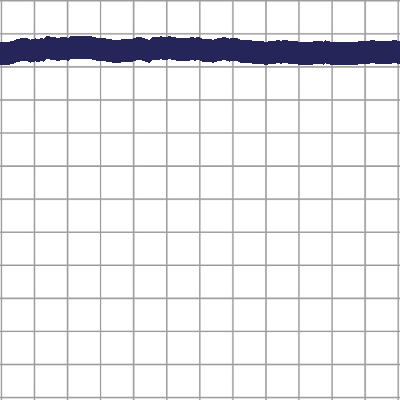

pitch79_thick2_color0_0_train.png


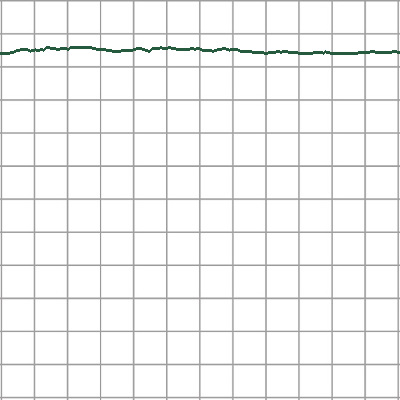

pitch79_thick0_color1_0_train.png


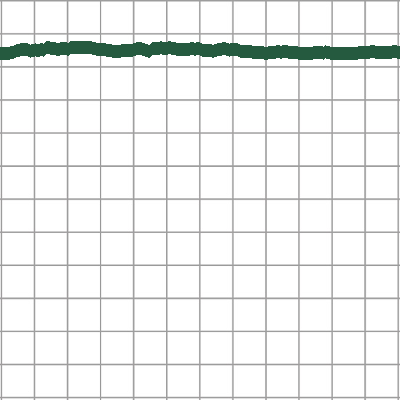

pitch79_thick1_color1_0_train.png


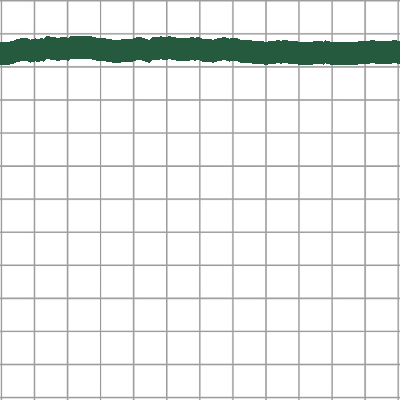

pitch79_thick2_color1_0_train.png


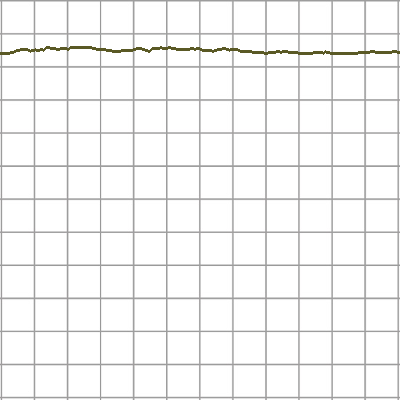

pitch79_thick0_color2_0_train.png


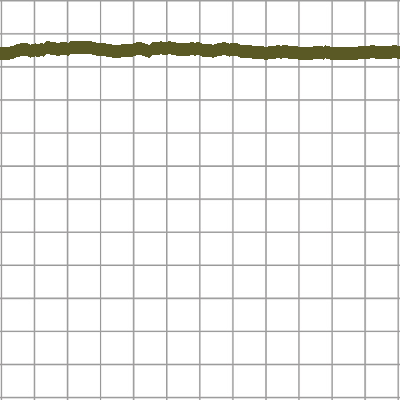

pitch79_thick1_color2_0_train.png


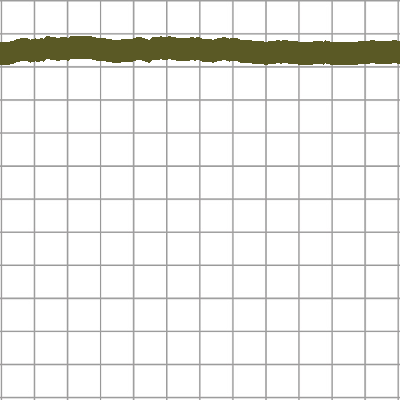

pitch79_thick2_color2_0_train.png


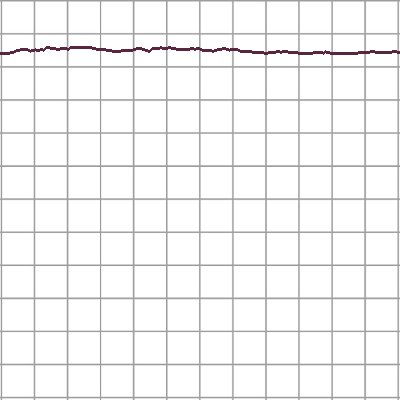

pitch79_thick0_color3_0_train.png


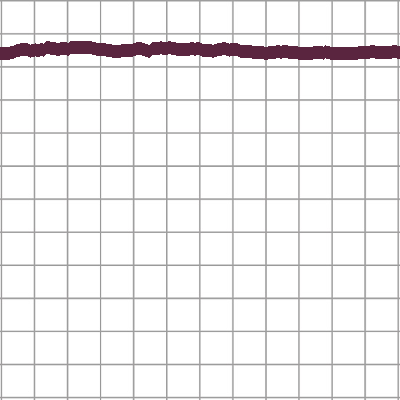

pitch79_thick1_color3_0_train.png


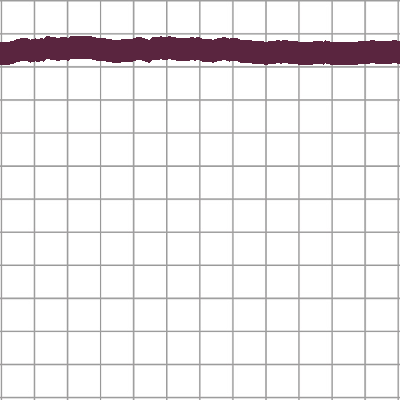

pitch79_thick2_color3_0_train.png


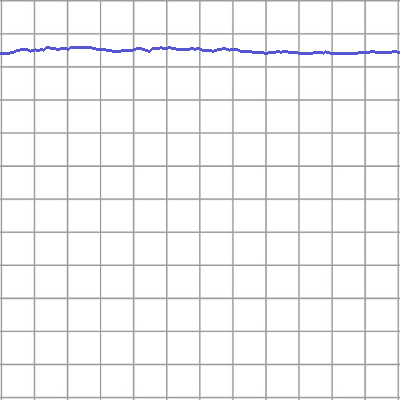

pitch79_thick0_color4_0_train.png


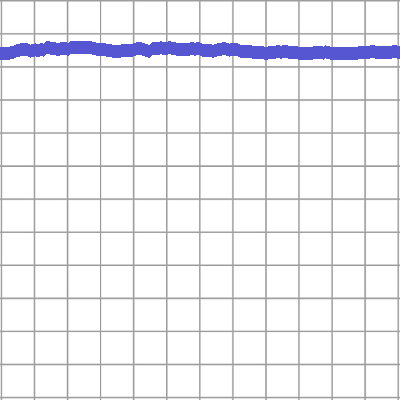

pitch79_thick1_color4_0_train.png


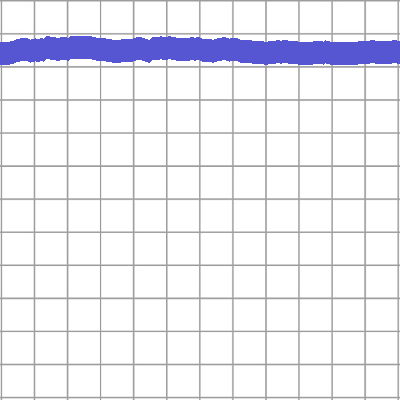

pitch79_thick2_color4_0_train.png


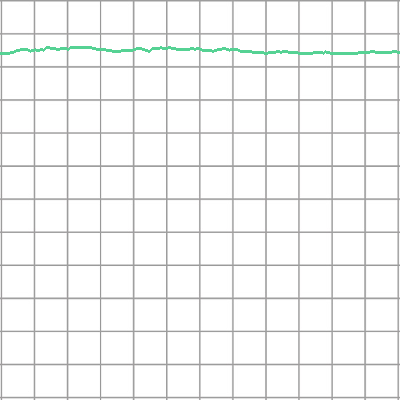

pitch79_thick0_color5_0_train.png


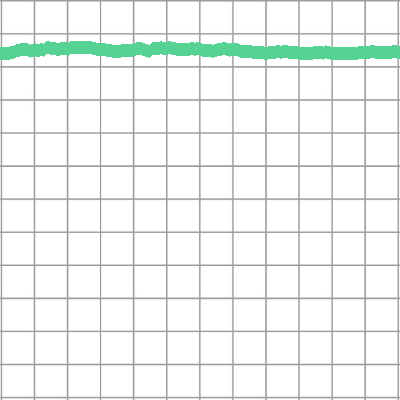

pitch79_thick1_color5_0_train.png


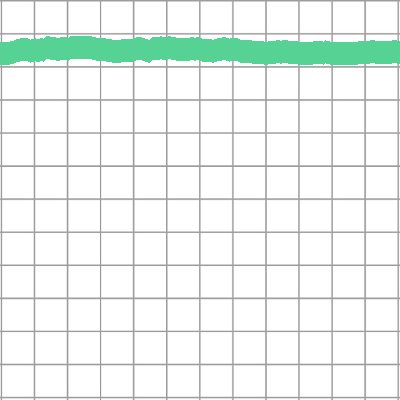

pitch79_thick2_color5_0_train.png


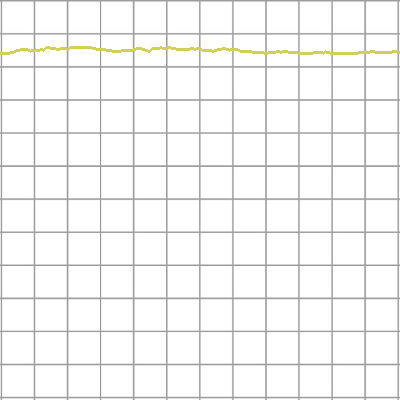

pitch79_thick0_color6_0_train.png


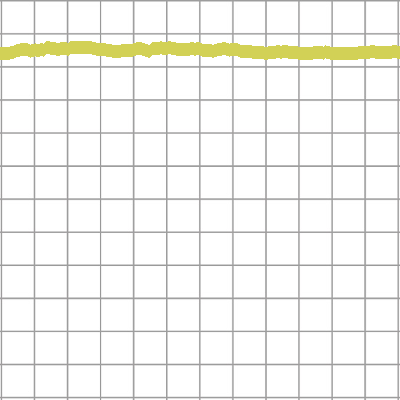

pitch79_thick1_color6_0_train.png


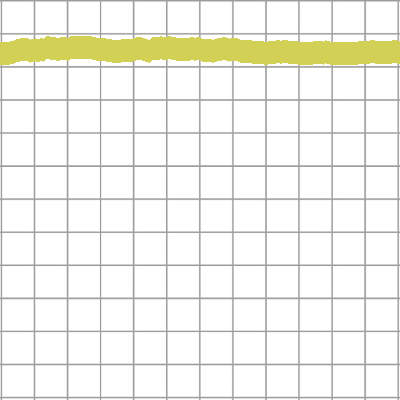

pitch79_thick2_color6_0_train.png


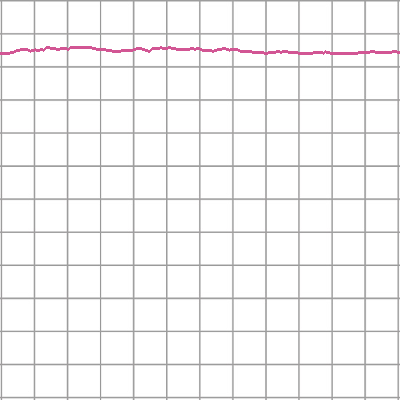

pitch79_thick0_color7_0_train.png


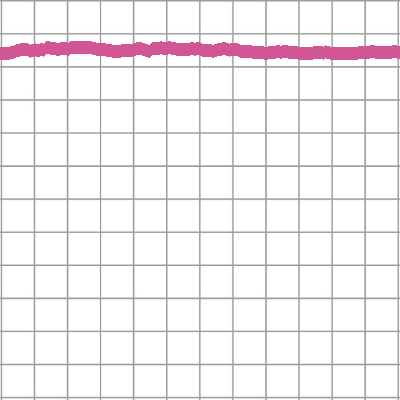

pitch79_thick1_color7_0_train.png


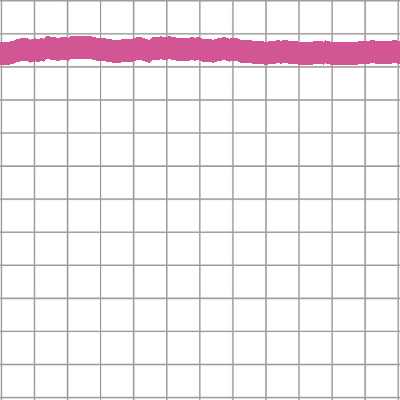

pitch79_thick2_color7_0_train.png


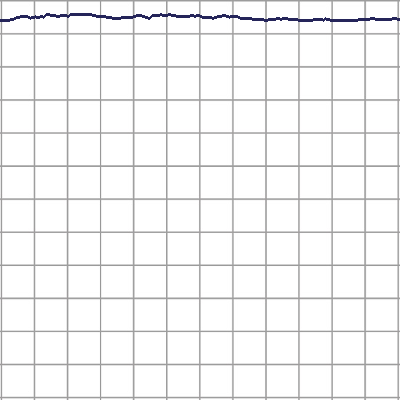

pitch80_thick0_color0_0_train.png


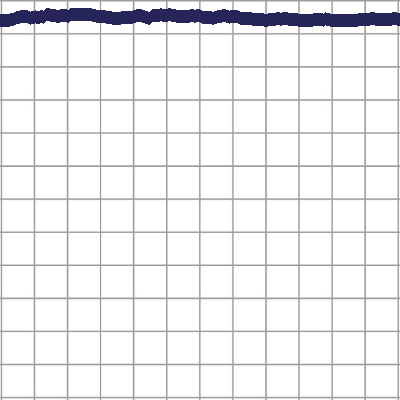

pitch80_thick1_color0_0_train.png


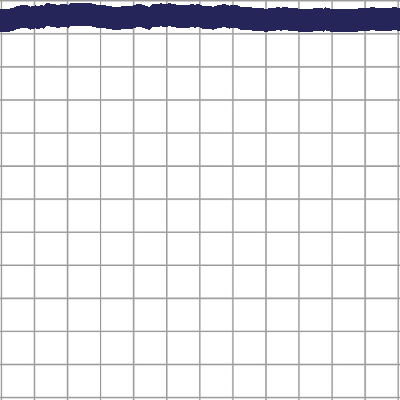

pitch80_thick2_color0_0_train.png


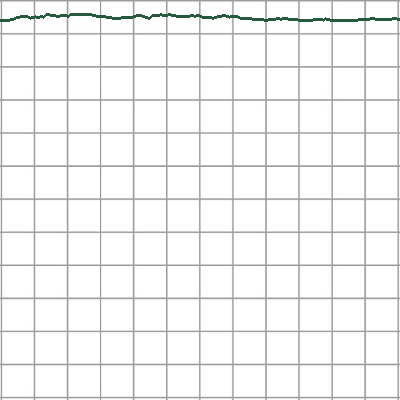

pitch80_thick0_color1_0_train.png


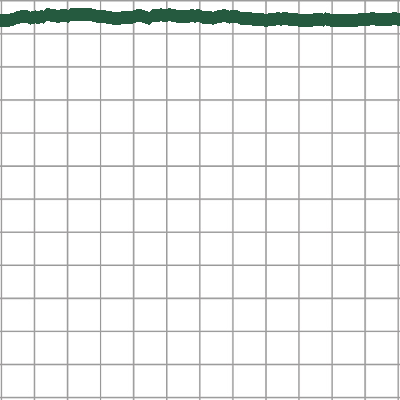

pitch80_thick1_color1_0_train.png


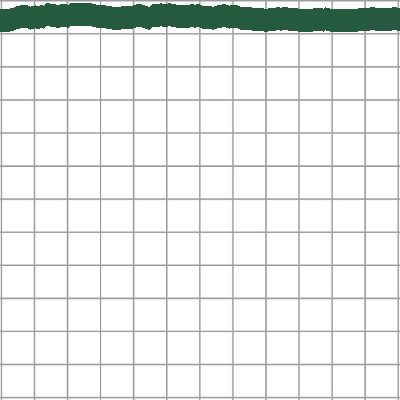

pitch80_thick2_color1_0_train.png


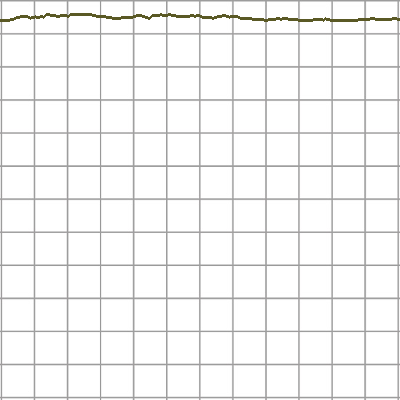

pitch80_thick0_color2_0_train.png


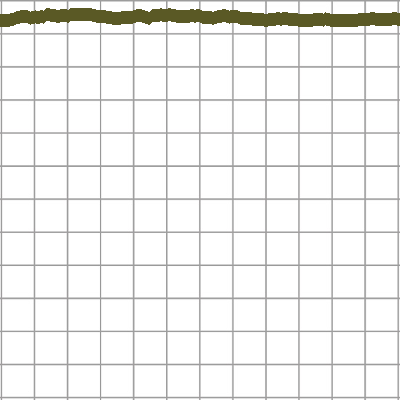

pitch80_thick1_color2_0_train.png


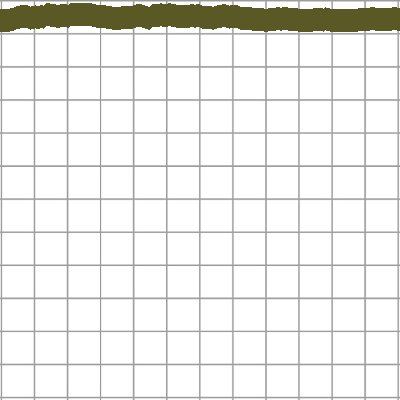

pitch80_thick2_color2_0_train.png


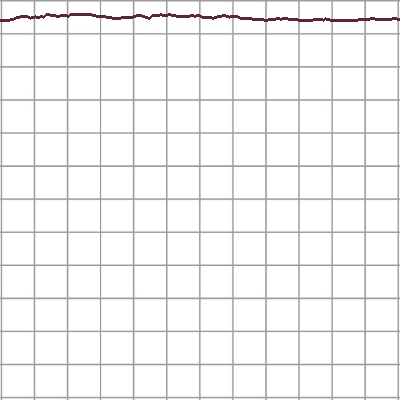

pitch80_thick0_color3_0_train.png


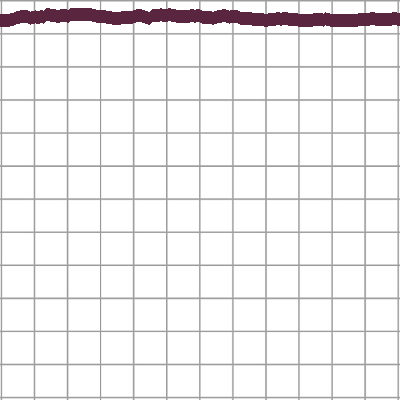

pitch80_thick1_color3_0_train.png


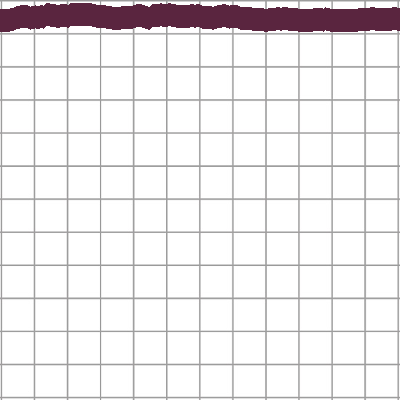

pitch80_thick2_color3_0_train.png


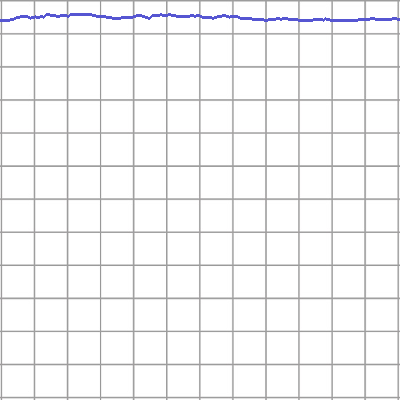

pitch80_thick0_color4_0_train.png


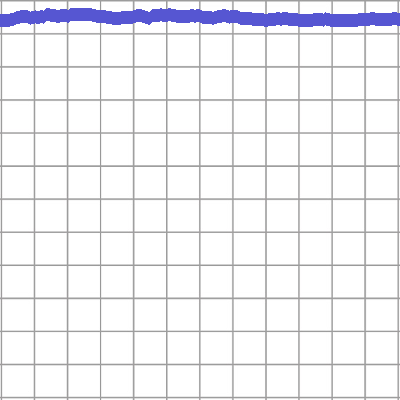

pitch80_thick1_color4_0_train.png


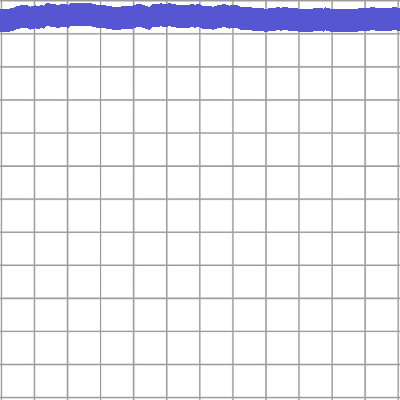

pitch80_thick2_color4_0_train.png


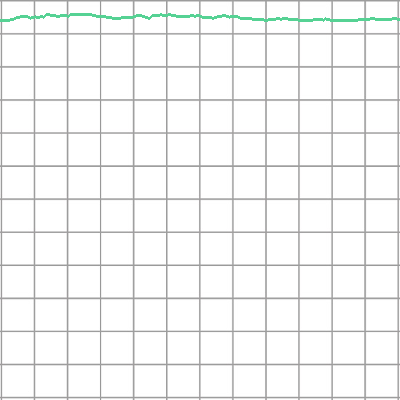

pitch80_thick0_color5_0_train.png


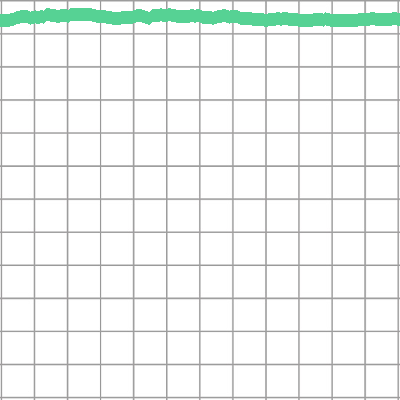

pitch80_thick1_color5_0_train.png


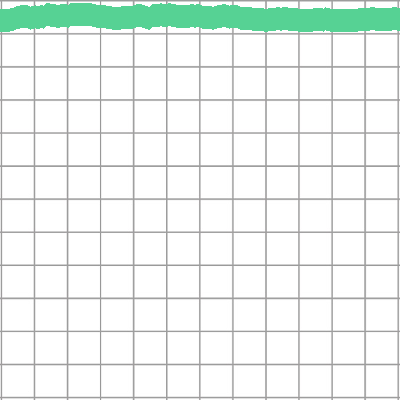

pitch80_thick2_color5_0_train.png


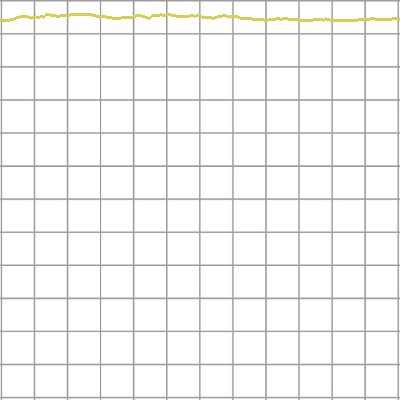

pitch80_thick0_color6_0_train.png


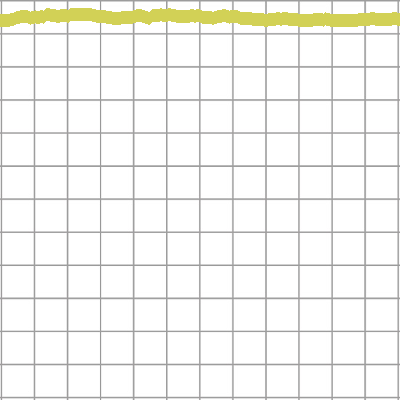

pitch80_thick1_color6_0_train.png


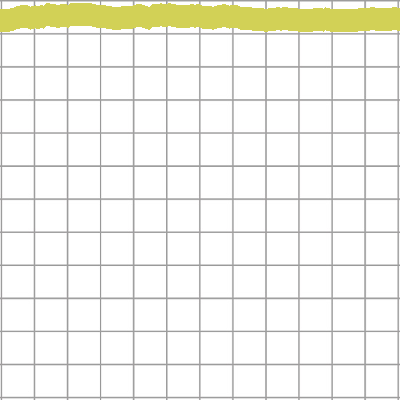

pitch80_thick2_color6_0_train.png


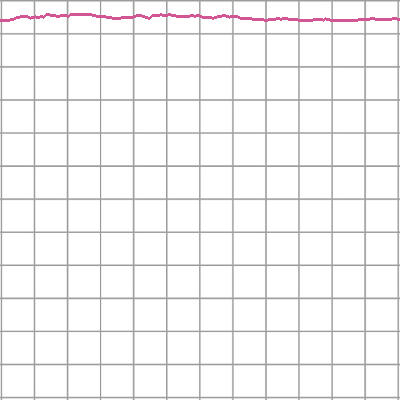

pitch80_thick0_color7_0_train.png


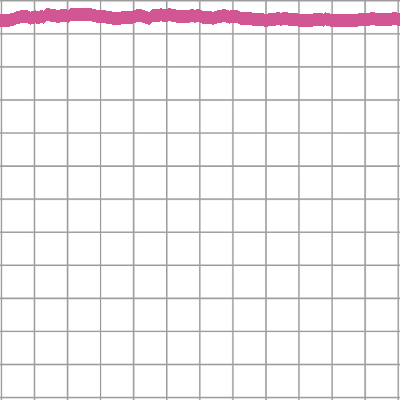

pitch80_thick1_color7_0_train.png


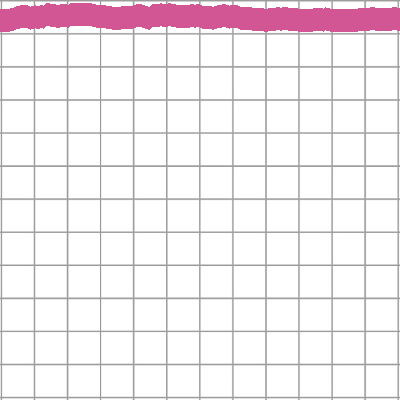

pitch80_thick2_color7_0_train.png


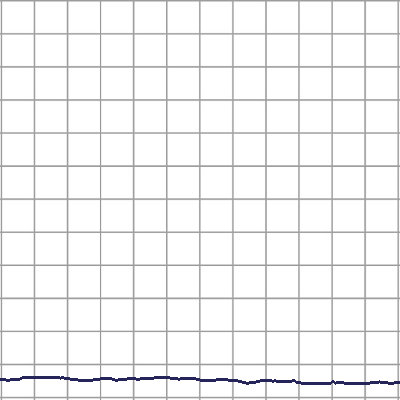

pitch69_thick0_color0_1_train.png


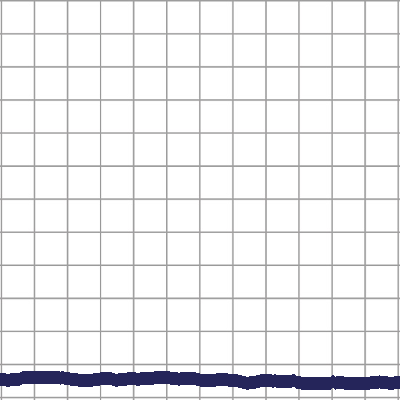

pitch69_thick1_color0_1_train.png


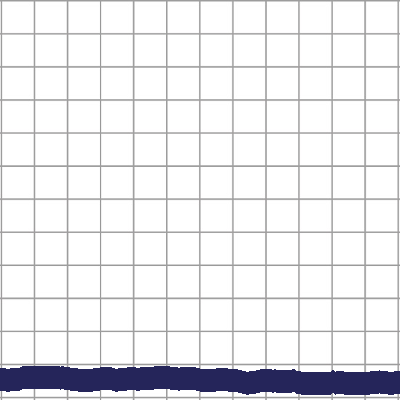

pitch69_thick2_color0_1_train.png


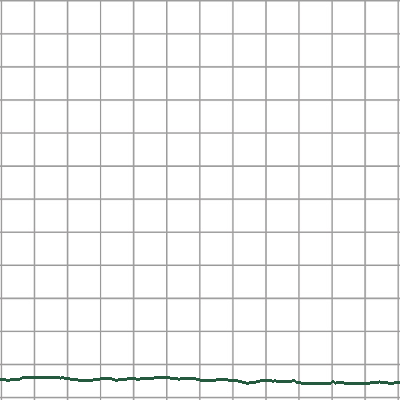

pitch69_thick0_color1_1_train.png


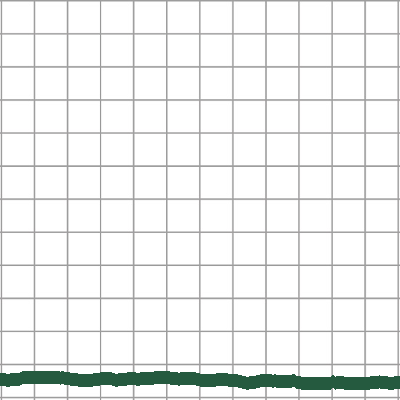

pitch69_thick1_color1_1_train.png


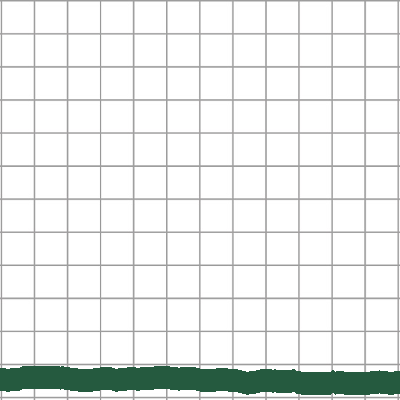

pitch69_thick2_color1_1_train.png


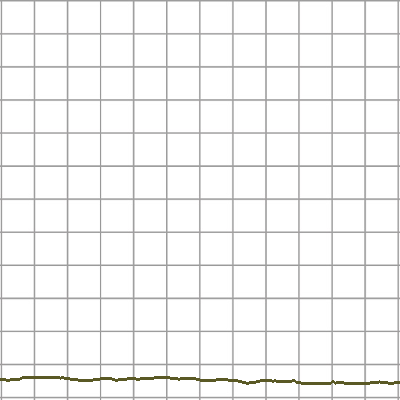

pitch69_thick0_color2_1_train.png


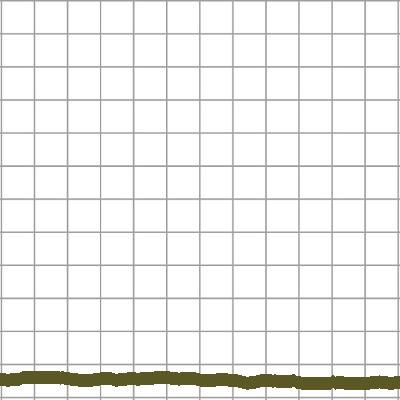

pitch69_thick1_color2_1_train.png


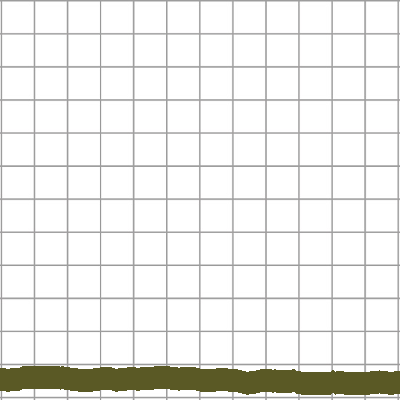

pitch69_thick2_color2_1_train.png


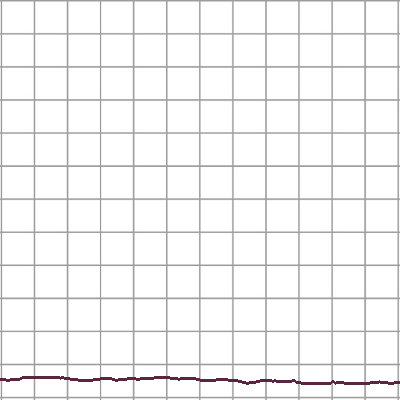

pitch69_thick0_color3_1_train.png


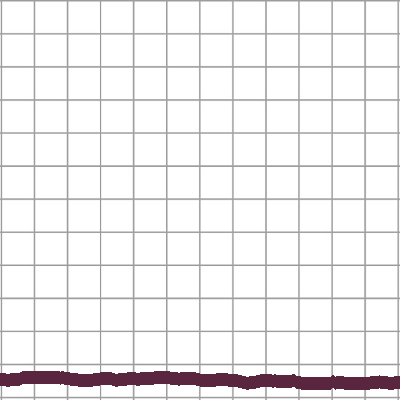

pitch69_thick1_color3_1_train.png


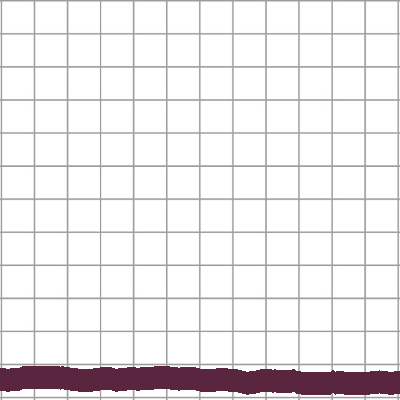

pitch69_thick2_color3_1_train.png


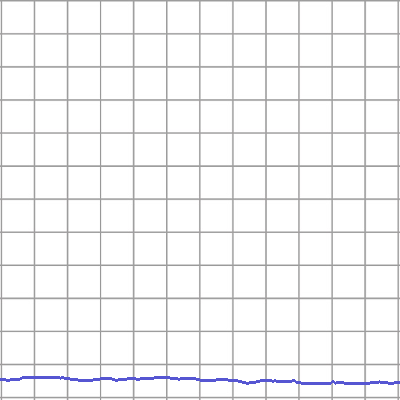

pitch69_thick0_color4_1_train.png


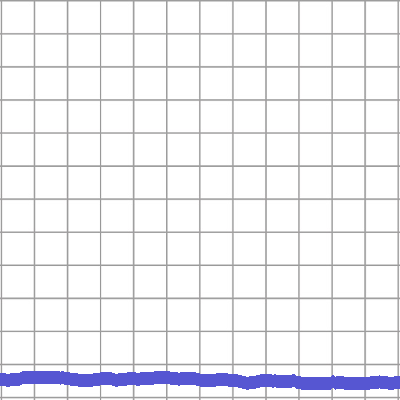

pitch69_thick1_color4_1_train.png


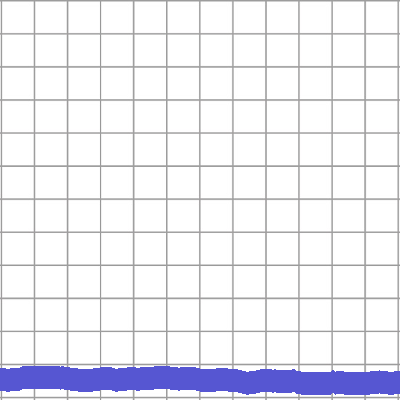

pitch69_thick2_color4_1_train.png


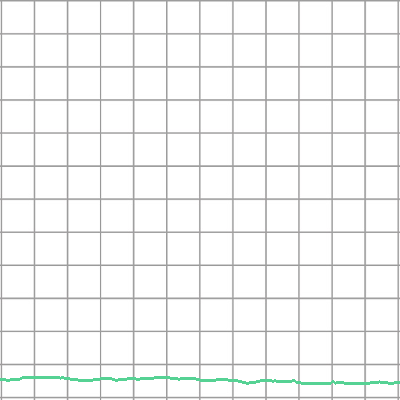

pitch69_thick0_color5_1_train.png


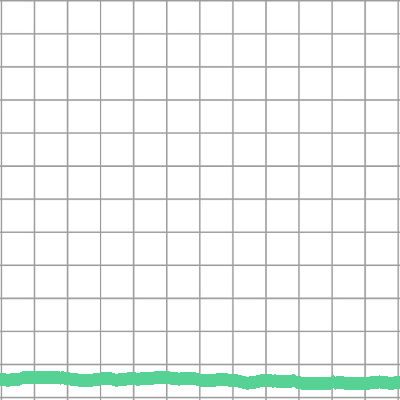

pitch69_thick1_color5_1_train.png


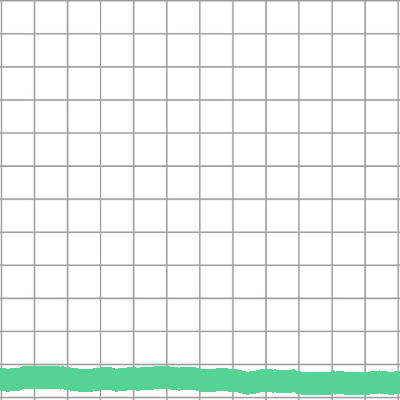

pitch69_thick2_color5_1_train.png


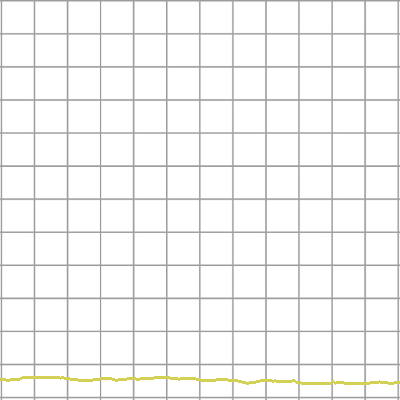

pitch69_thick0_color6_1_train.png


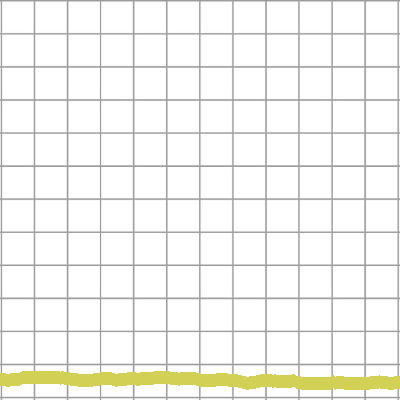

pitch69_thick1_color6_1_train.png


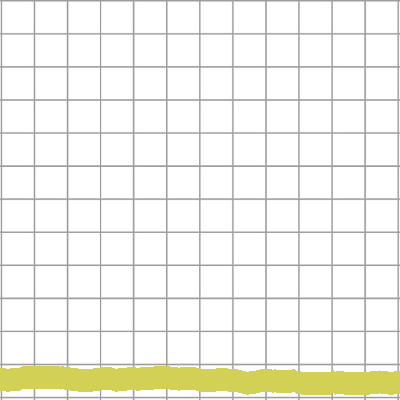

pitch69_thick2_color6_1_train.png


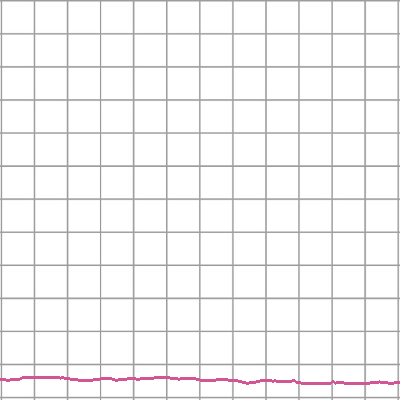

pitch69_thick0_color7_1_train.png


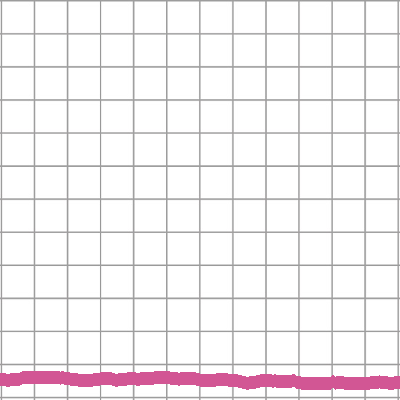

pitch69_thick1_color7_1_train.png


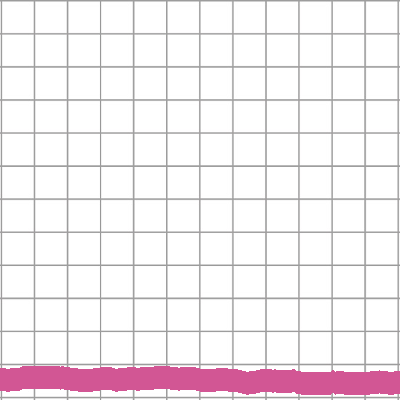

pitch69_thick2_color7_1_train.png


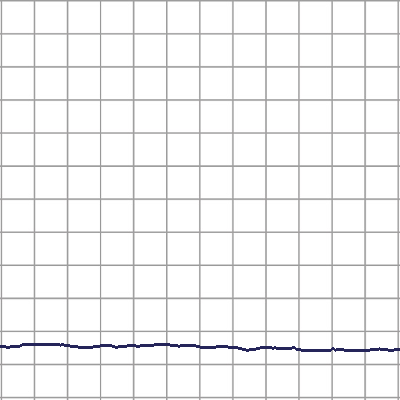

pitch70_thick0_color0_1_train.png


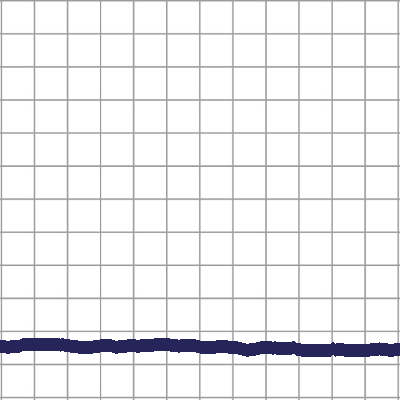

pitch70_thick1_color0_1_train.png


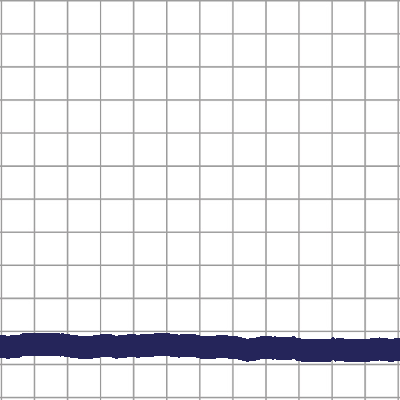

pitch70_thick2_color0_1_train.png


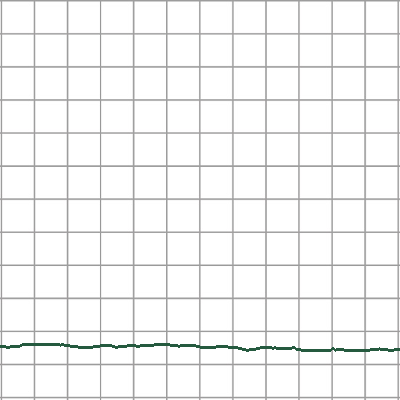

pitch70_thick0_color1_1_train.png


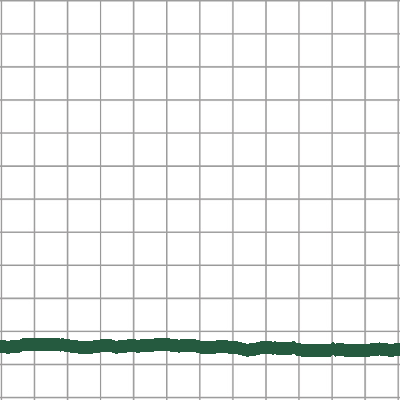

pitch70_thick1_color1_1_train.png


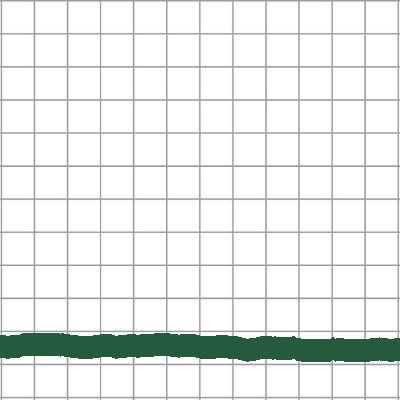

pitch70_thick2_color1_1_train.png


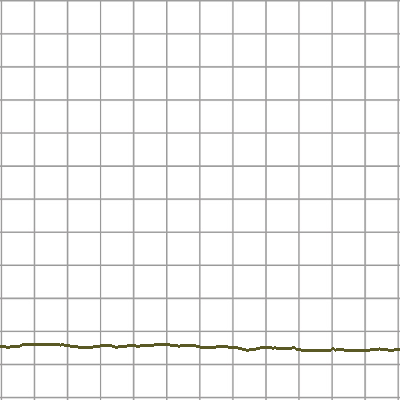

pitch70_thick0_color2_1_train.png


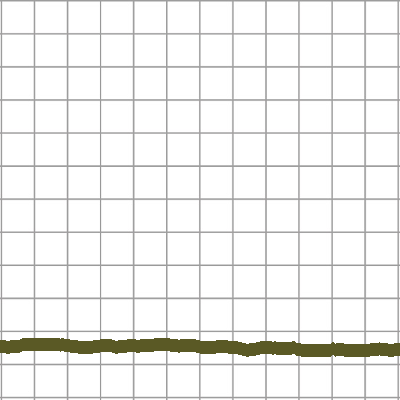

pitch70_thick1_color2_1_train.png


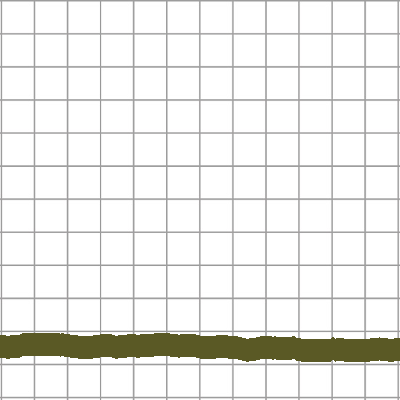

pitch70_thick2_color2_1_train.png


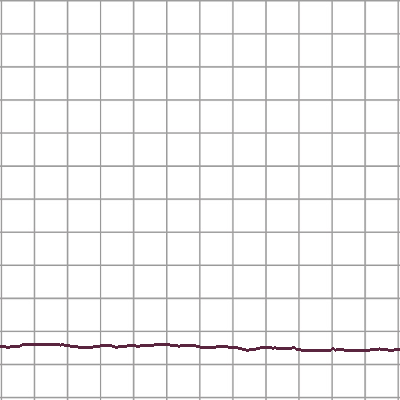

pitch70_thick0_color3_1_train.png


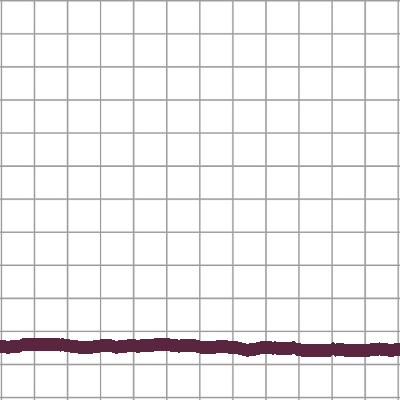

pitch70_thick1_color3_1_train.png


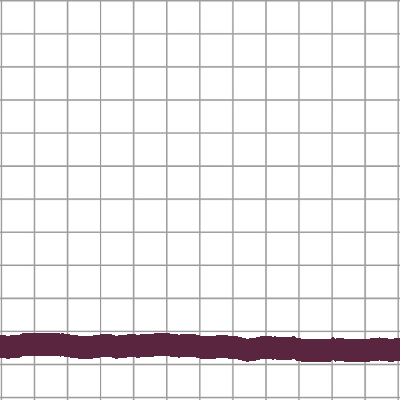

pitch70_thick2_color3_1_train.png


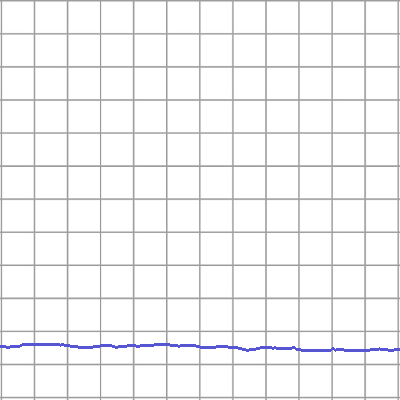

pitch70_thick0_color4_1_train.png


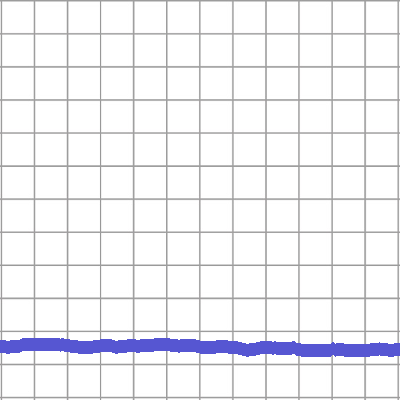

pitch70_thick1_color4_1_train.png


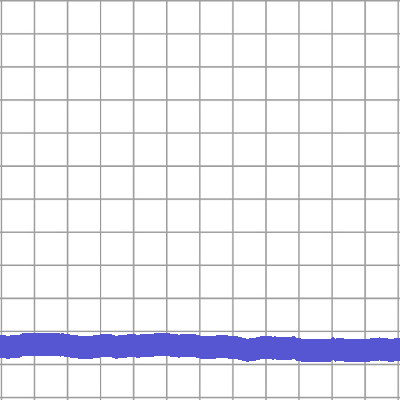

pitch70_thick2_color4_1_train.png


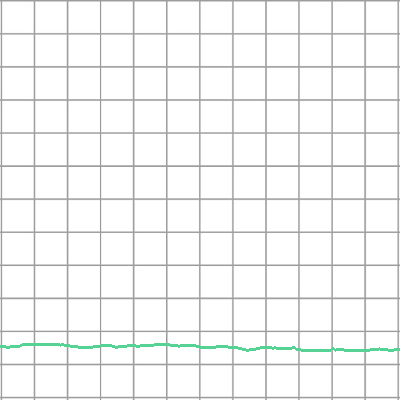

pitch70_thick0_color5_1_train.png


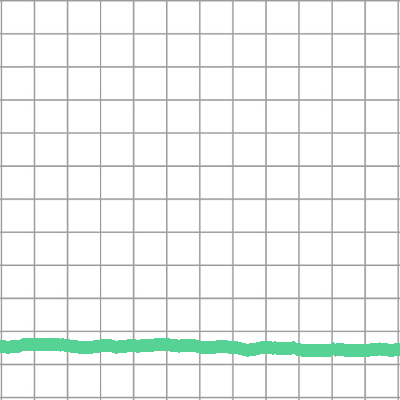

pitch70_thick1_color5_1_train.png


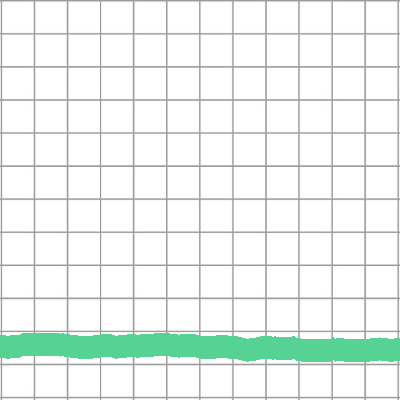

pitch70_thick2_color5_1_train.png


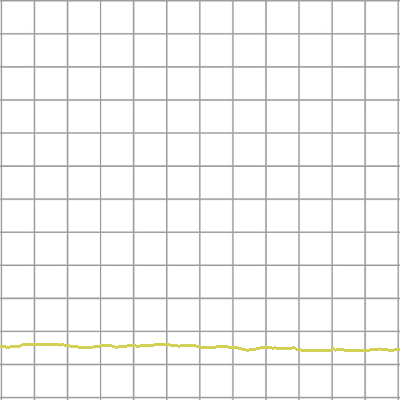

pitch70_thick0_color6_1_train.png


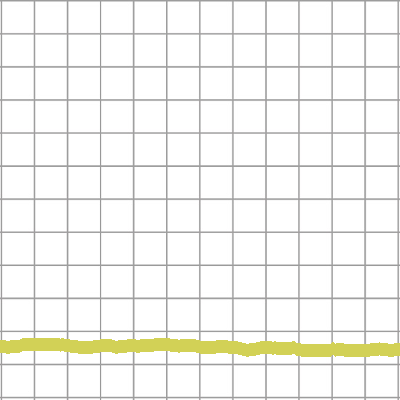

pitch70_thick1_color6_1_train.png


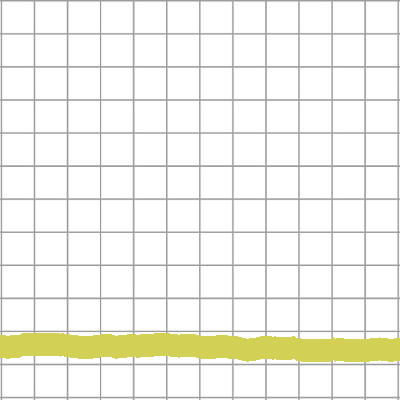

pitch70_thick2_color6_1_train.png


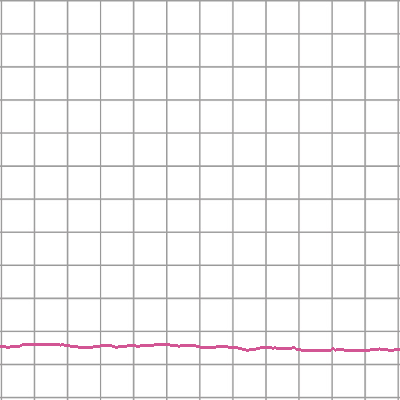

pitch70_thick0_color7_1_train.png


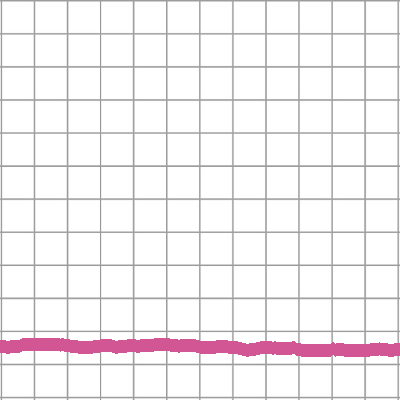

pitch70_thick1_color7_1_train.png


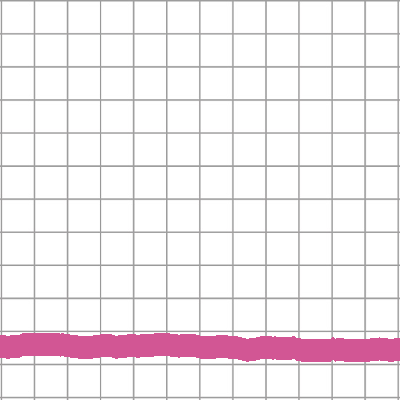

pitch70_thick2_color7_1_train.png


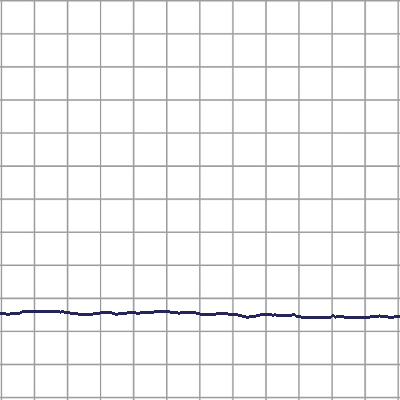

pitch71_thick0_color0_1_train.png


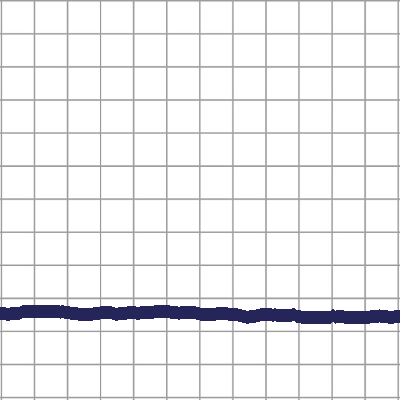

pitch71_thick1_color0_1_train.png


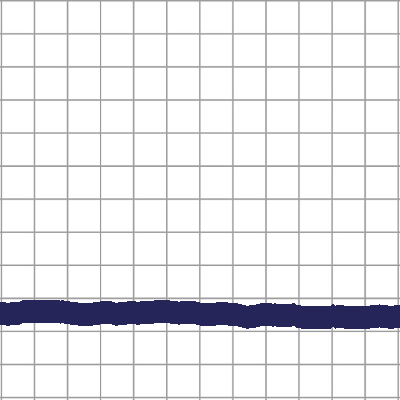

pitch71_thick2_color0_1_train.png


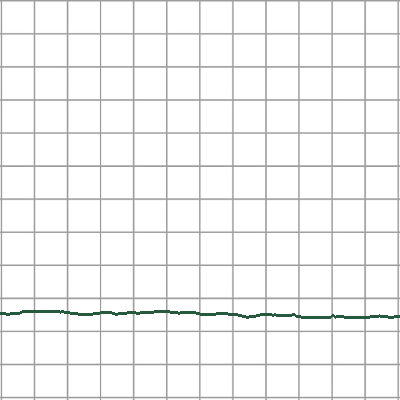

pitch71_thick0_color1_1_train.png


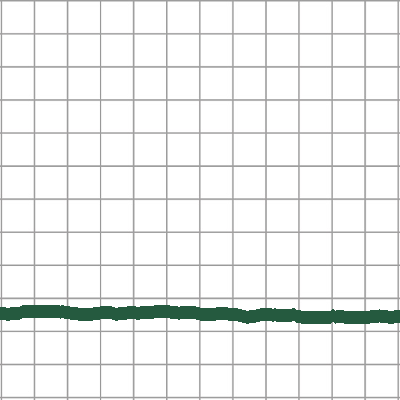

pitch71_thick1_color1_1_train.png


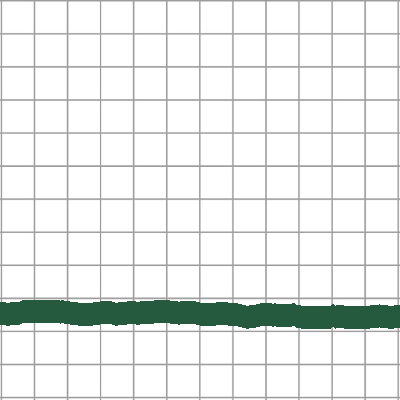

pitch71_thick2_color1_1_train.png


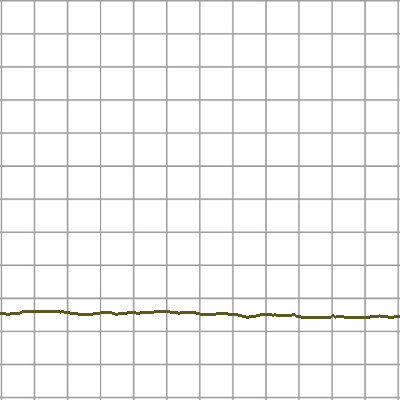

pitch71_thick0_color2_1_train.png


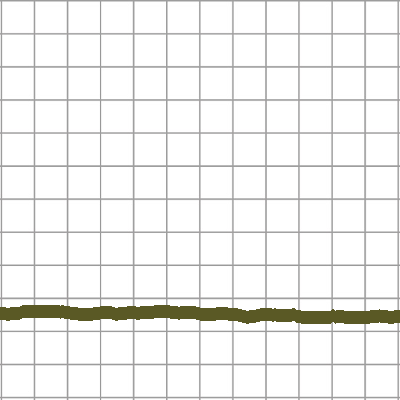

pitch71_thick1_color2_1_train.png


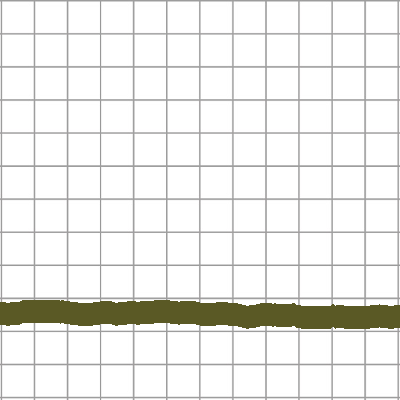

pitch71_thick2_color2_1_train.png


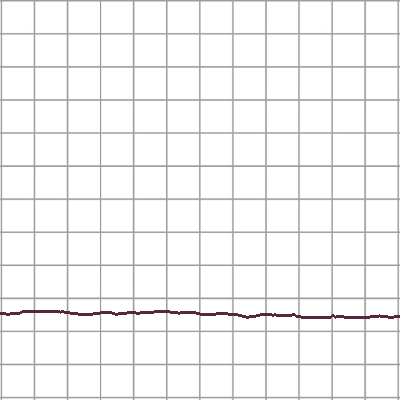

pitch71_thick0_color3_1_train.png


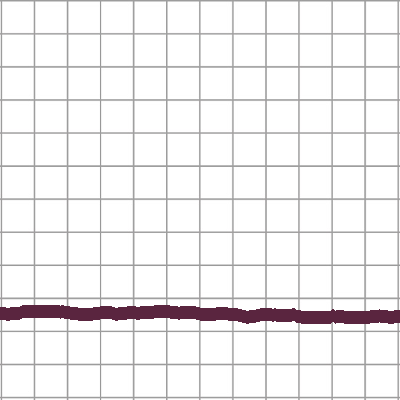

pitch71_thick1_color3_1_train.png


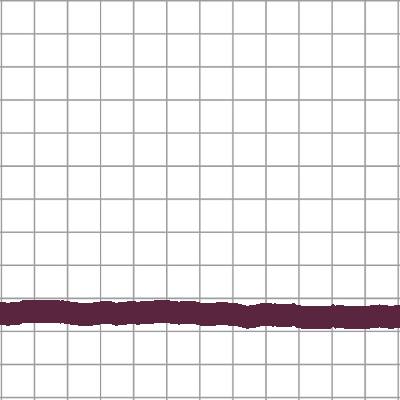

pitch71_thick2_color3_1_train.png


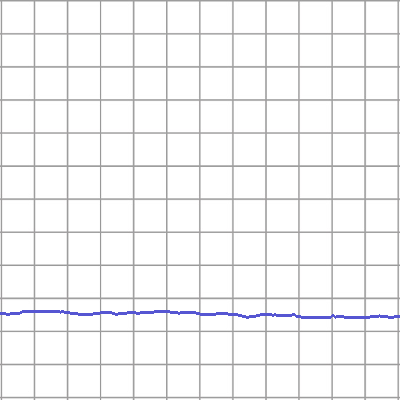

pitch71_thick0_color4_1_train.png


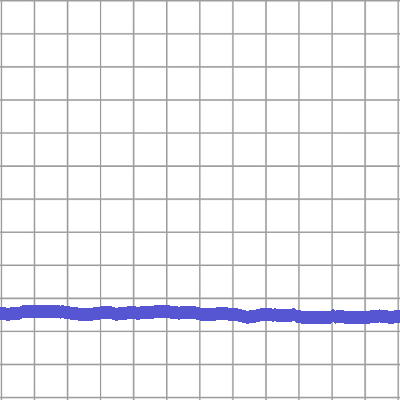

pitch71_thick1_color4_1_train.png


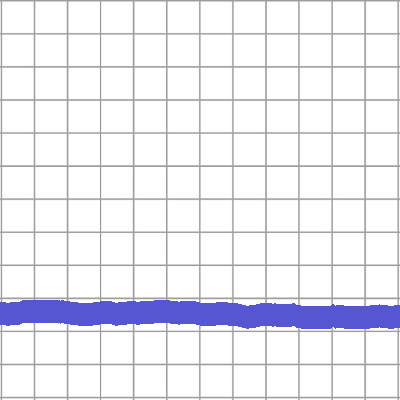

pitch71_thick2_color4_1_train.png


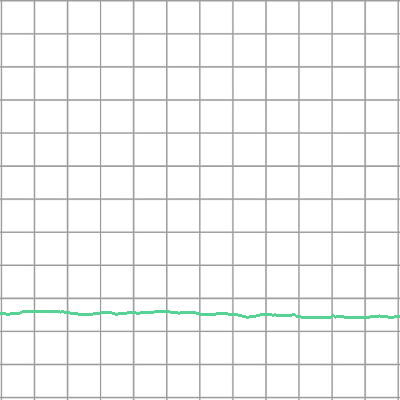

pitch71_thick0_color5_1_train.png


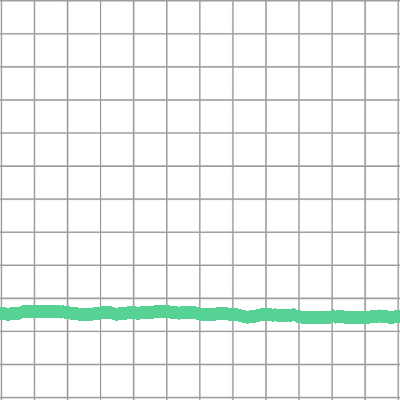

pitch71_thick1_color5_1_train.png


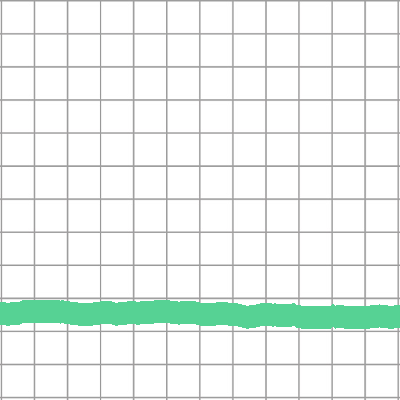

pitch71_thick2_color5_1_train.png


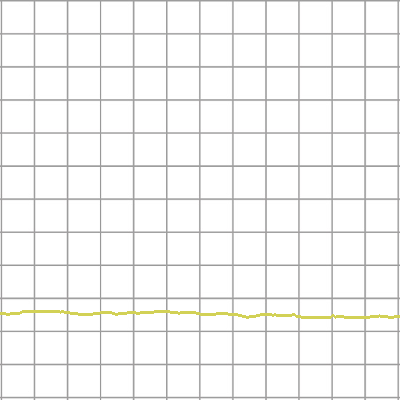

pitch71_thick0_color6_1_train.png


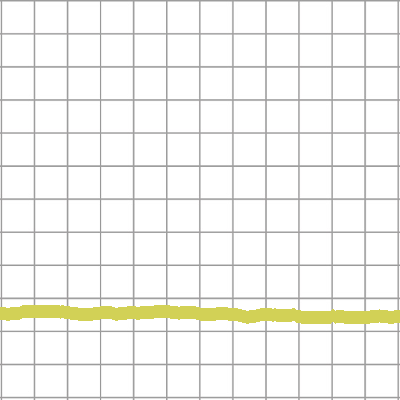

pitch71_thick1_color6_1_train.png


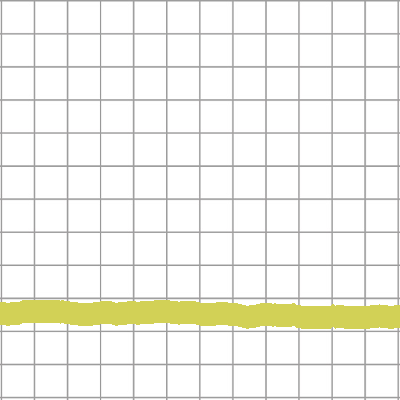

pitch71_thick2_color6_1_train.png


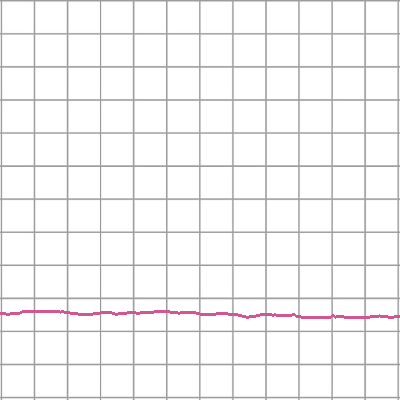

pitch71_thick0_color7_1_train.png


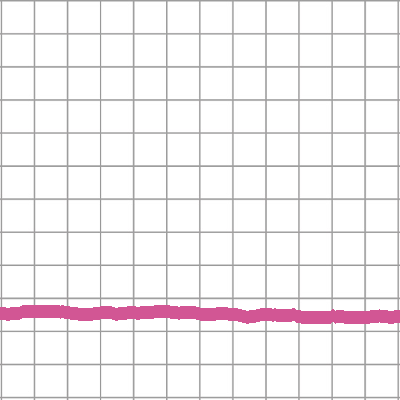

pitch71_thick1_color7_1_train.png


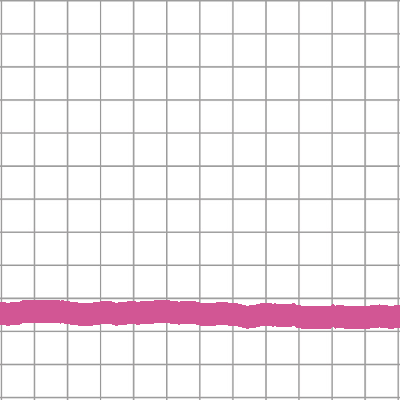

pitch71_thick2_color7_1_train.png


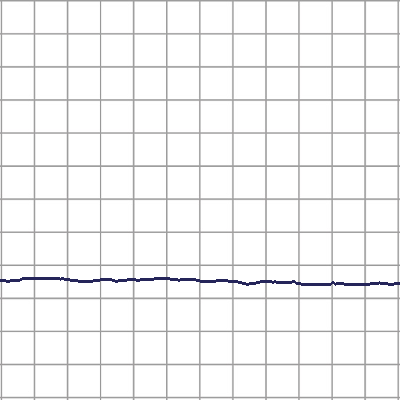

pitch72_thick0_color0_1_train.png


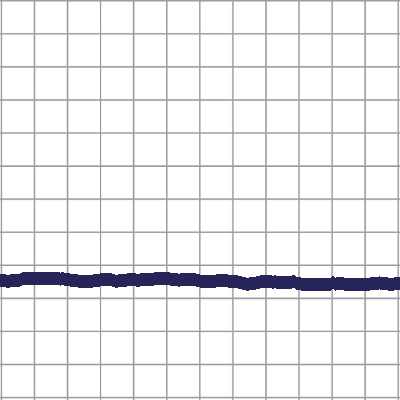

pitch72_thick1_color0_1_train.png


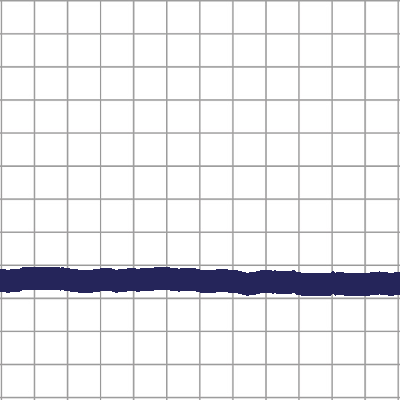

pitch72_thick2_color0_1_train.png


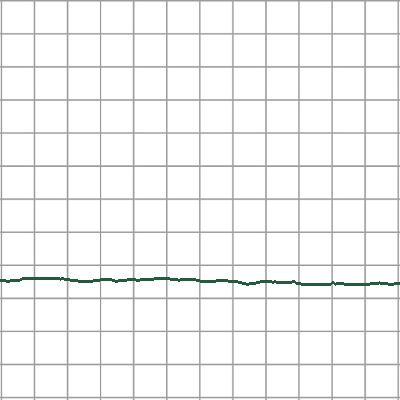

pitch72_thick0_color1_1_train.png


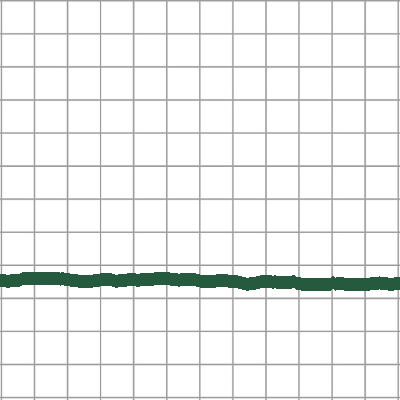

pitch72_thick1_color1_1_train.png


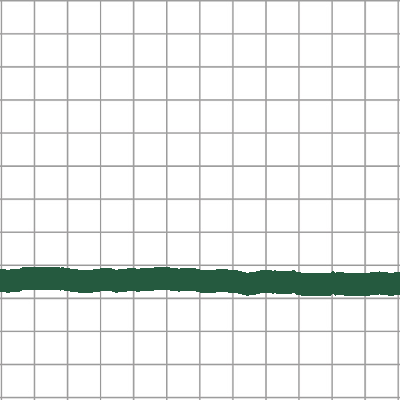

pitch72_thick2_color1_1_train.png


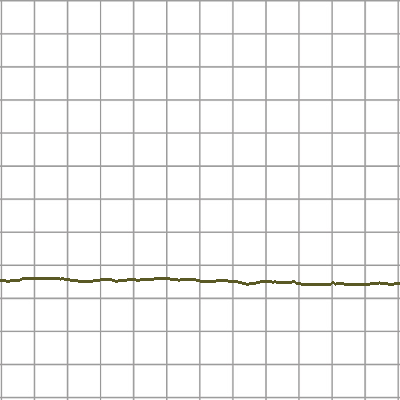

pitch72_thick0_color2_1_train.png


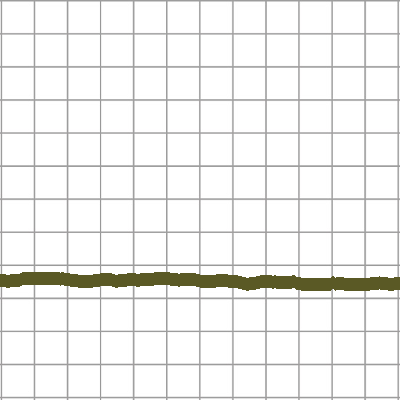

pitch72_thick1_color2_1_train.png


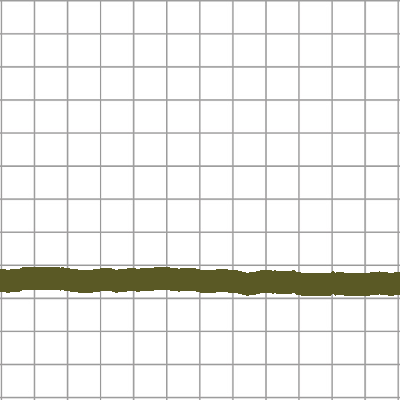

pitch72_thick2_color2_1_train.png


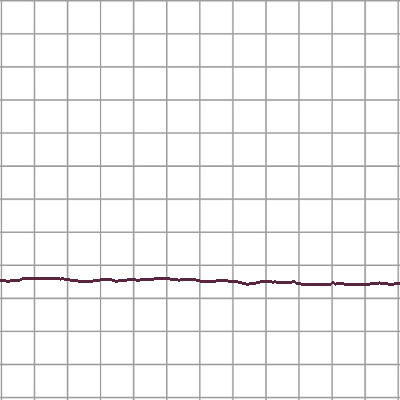

pitch72_thick0_color3_1_train.png


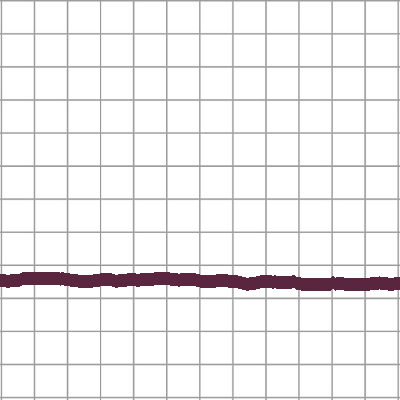

pitch72_thick1_color3_1_train.png


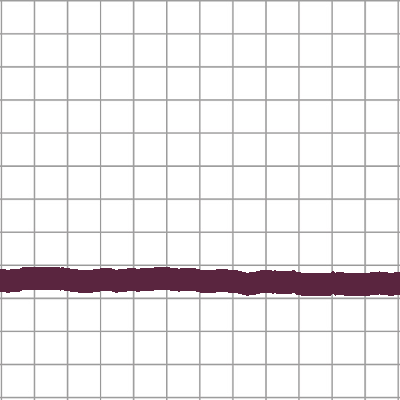

pitch72_thick2_color3_1_train.png


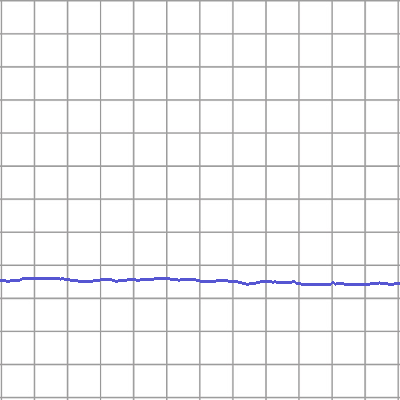

pitch72_thick0_color4_1_train.png


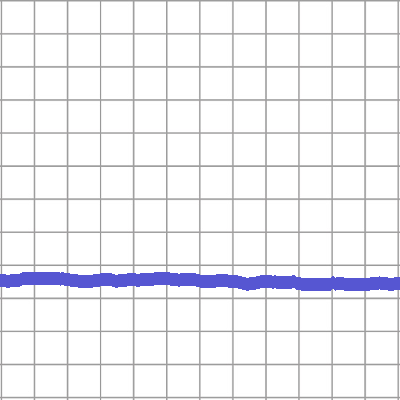

pitch72_thick1_color4_1_train.png


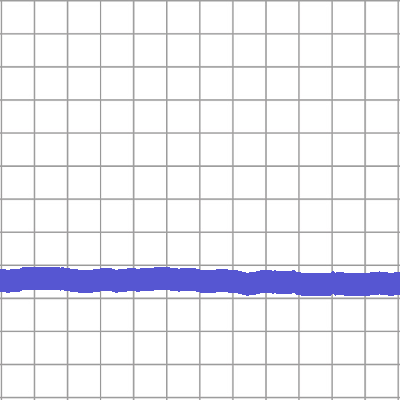

pitch72_thick2_color4_1_train.png


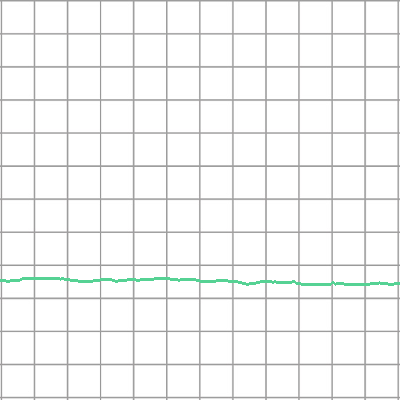

pitch72_thick0_color5_1_train.png


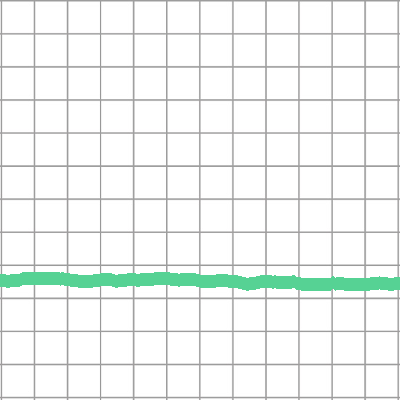

pitch72_thick1_color5_1_train.png


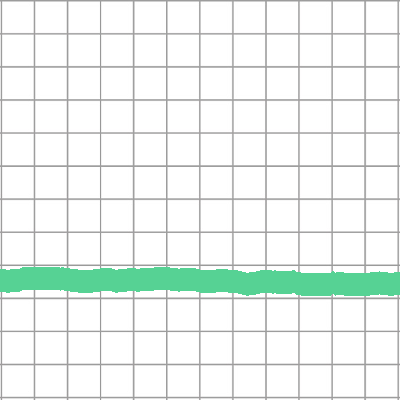

pitch72_thick2_color5_1_train.png


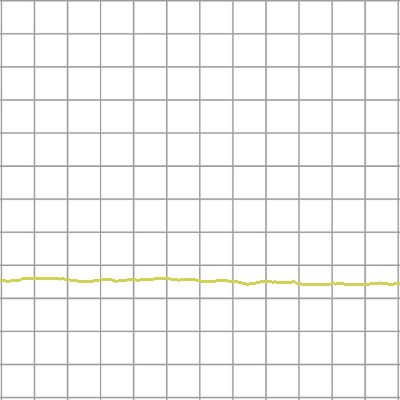

pitch72_thick0_color6_1_train.png


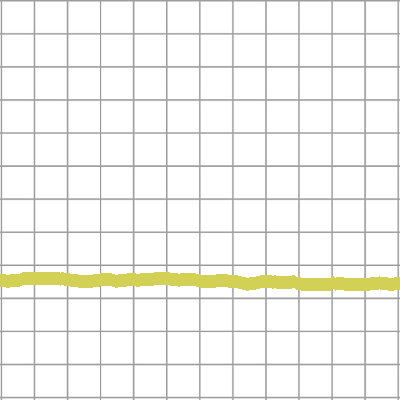

pitch72_thick1_color6_1_train.png


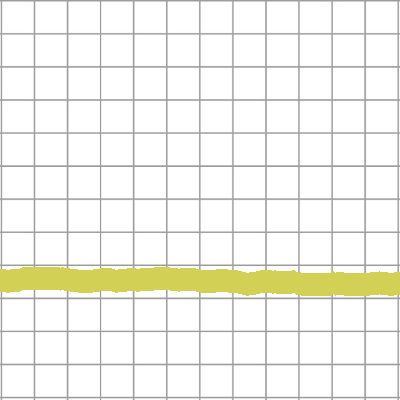

pitch72_thick2_color6_1_train.png


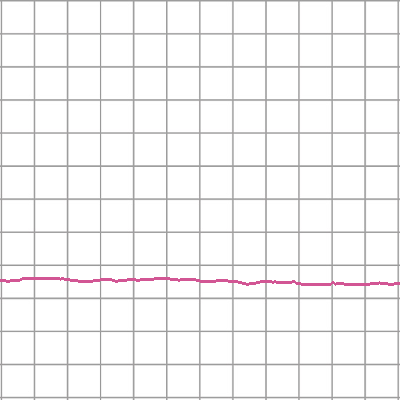

pitch72_thick0_color7_1_train.png


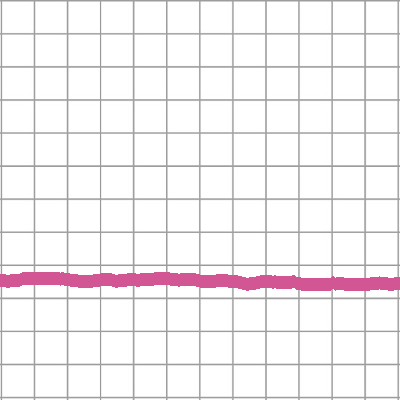

pitch72_thick1_color7_1_train.png


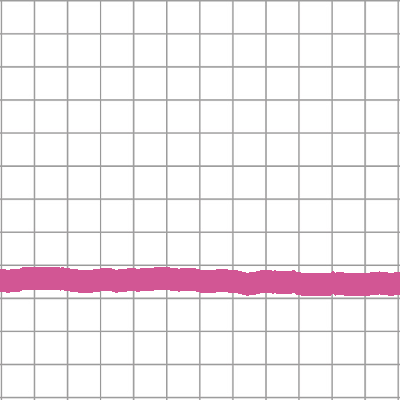

pitch72_thick2_color7_1_train.png


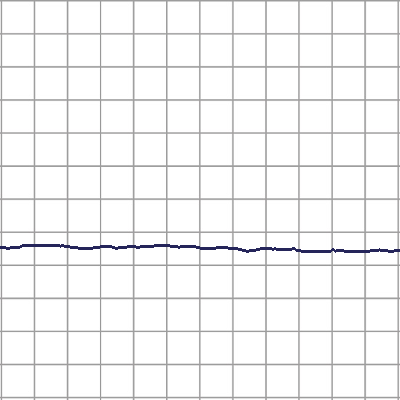

pitch73_thick0_color0_1_train.png


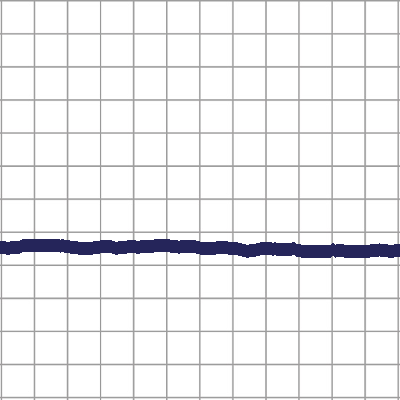

pitch73_thick1_color0_1_train.png


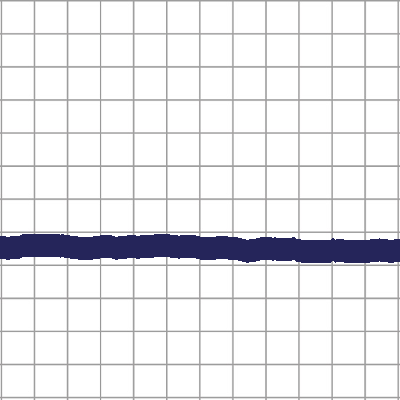

pitch73_thick2_color0_1_train.png


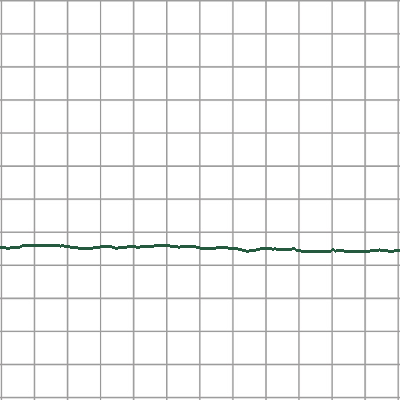

pitch73_thick0_color1_1_train.png


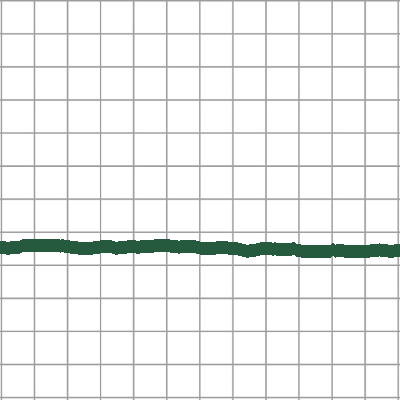

pitch73_thick1_color1_1_train.png


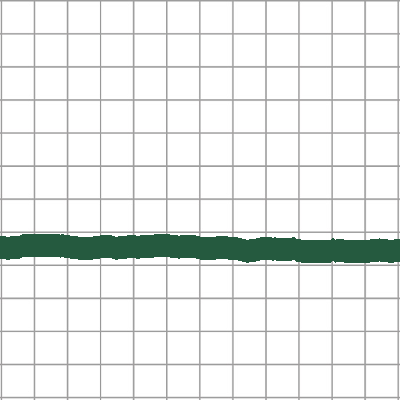

pitch73_thick2_color1_1_train.png


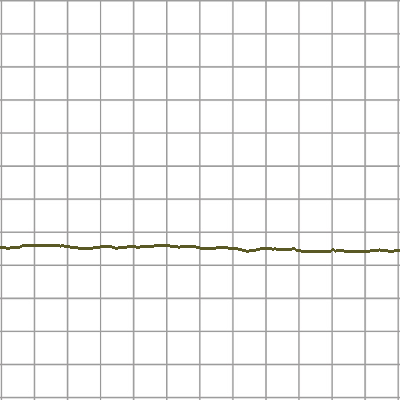

pitch73_thick0_color2_1_train.png


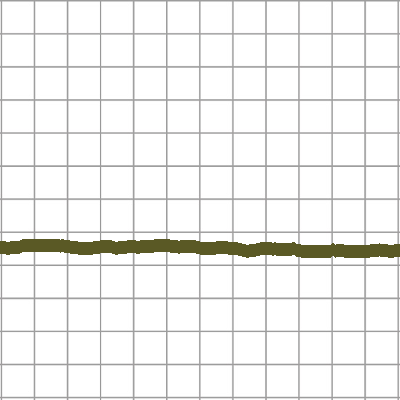

pitch73_thick1_color2_1_train.png


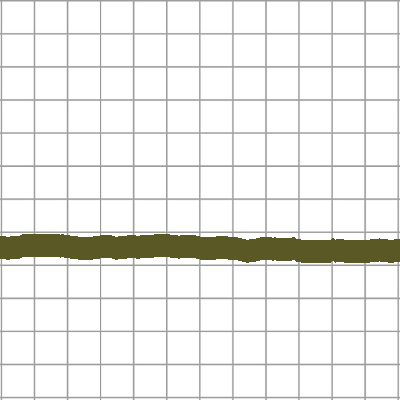

pitch73_thick2_color2_1_train.png


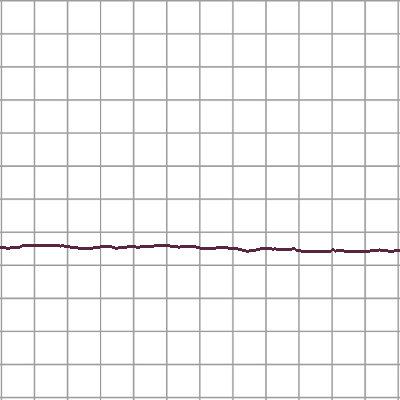

pitch73_thick0_color3_1_train.png


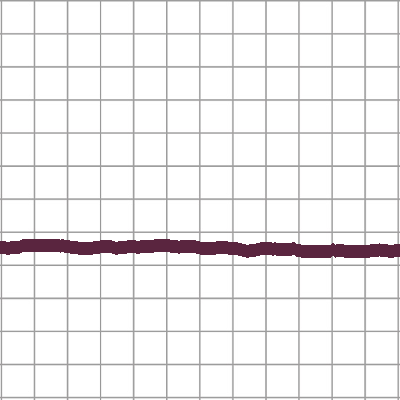

pitch73_thick1_color3_1_train.png


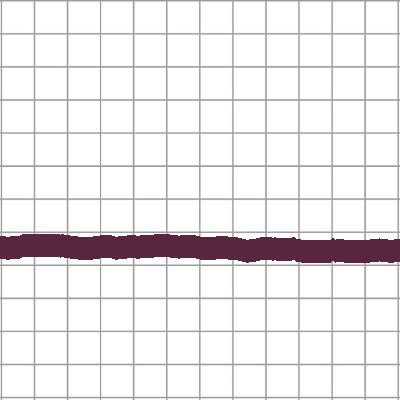

pitch73_thick2_color3_1_train.png


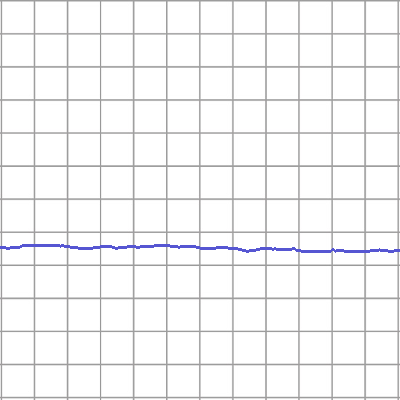

pitch73_thick0_color4_1_train.png


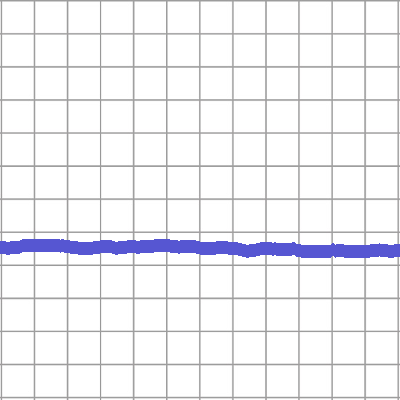

pitch73_thick1_color4_1_train.png


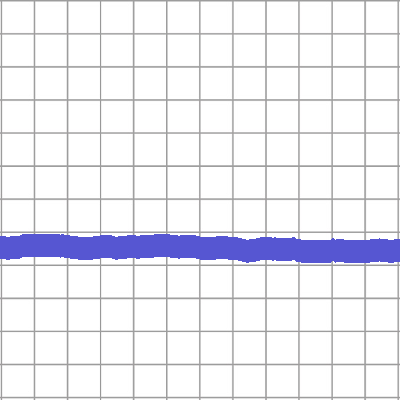

pitch73_thick2_color4_1_train.png


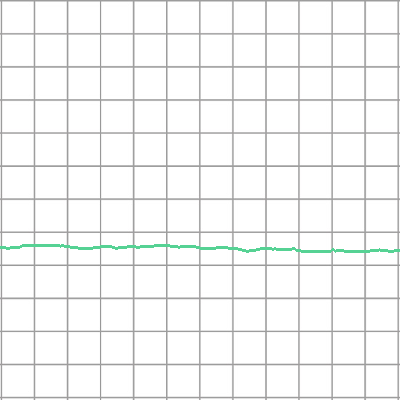

pitch73_thick0_color5_1_train.png


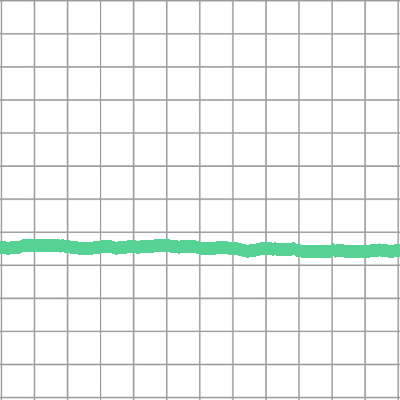

pitch73_thick1_color5_1_train.png


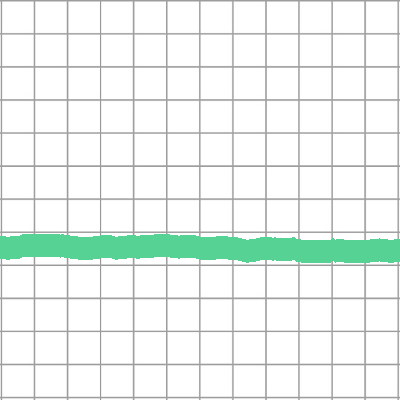

pitch73_thick2_color5_1_train.png


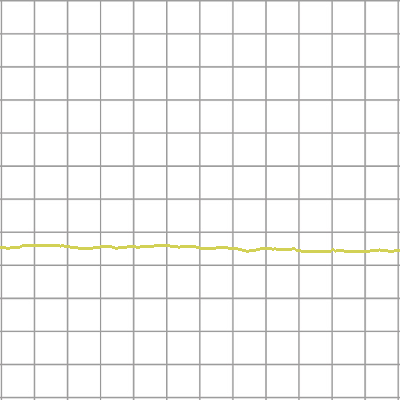

pitch73_thick0_color6_1_train.png


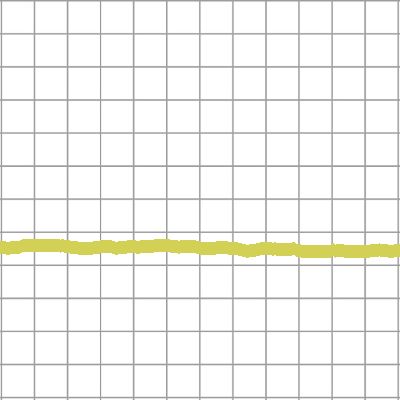

pitch73_thick1_color6_1_train.png


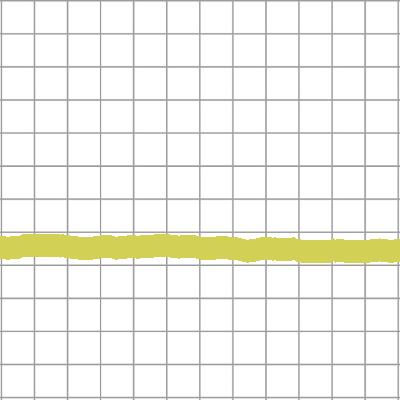

pitch73_thick2_color6_1_train.png


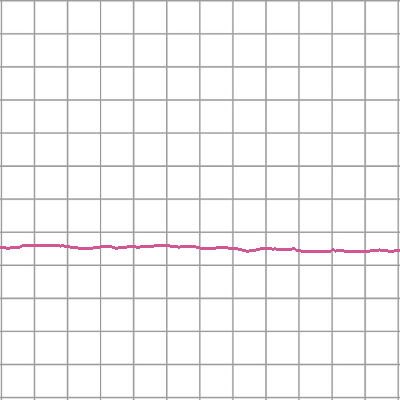

pitch73_thick0_color7_1_train.png


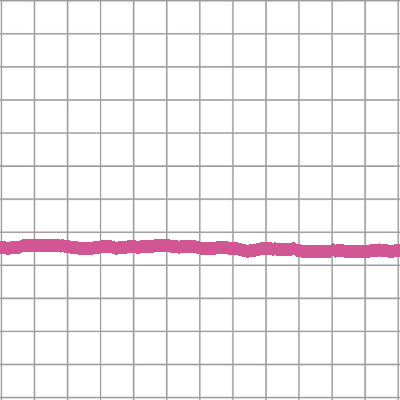

pitch73_thick1_color7_1_train.png


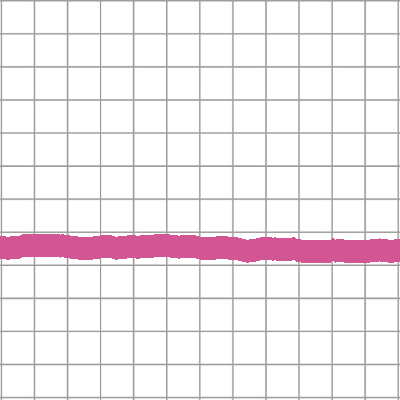

pitch73_thick2_color7_1_train.png


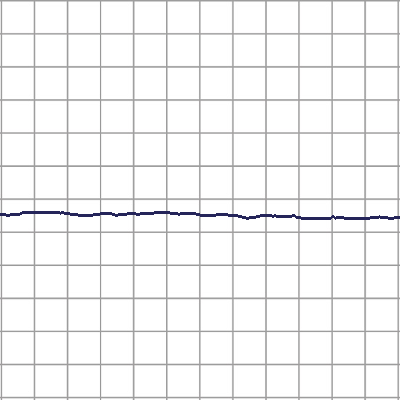

pitch74_thick0_color0_1_train.png


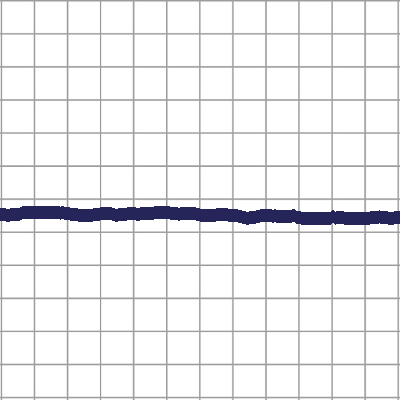

pitch74_thick1_color0_1_train.png


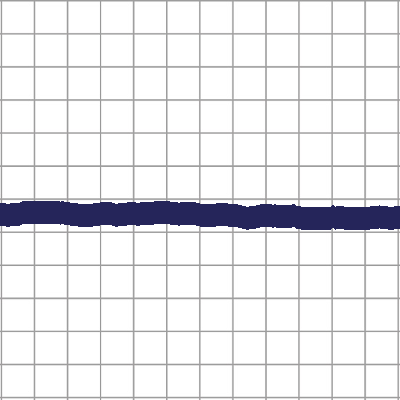

pitch74_thick2_color0_1_train.png


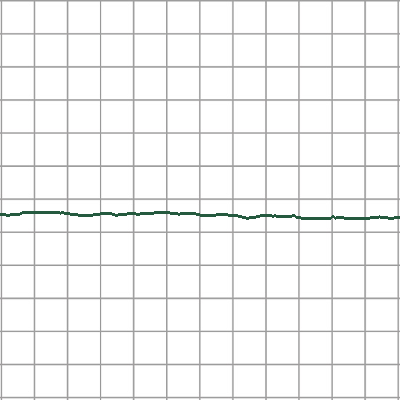

pitch74_thick0_color1_1_train.png


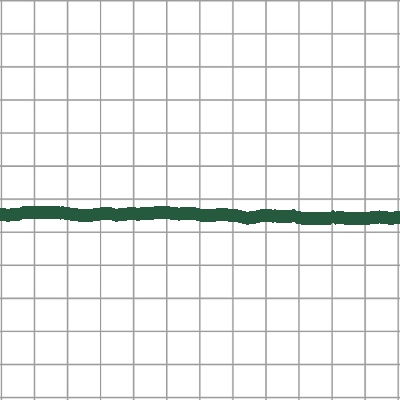

pitch74_thick1_color1_1_train.png


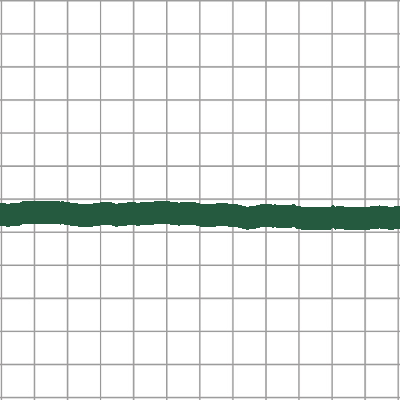

pitch74_thick2_color1_1_train.png


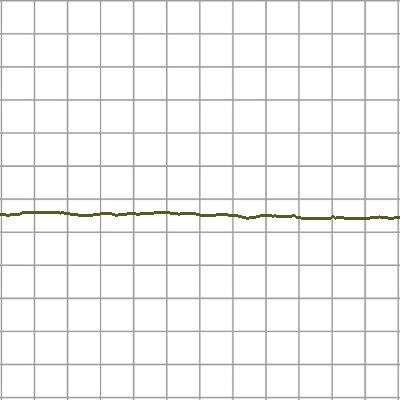

pitch74_thick0_color2_1_train.png


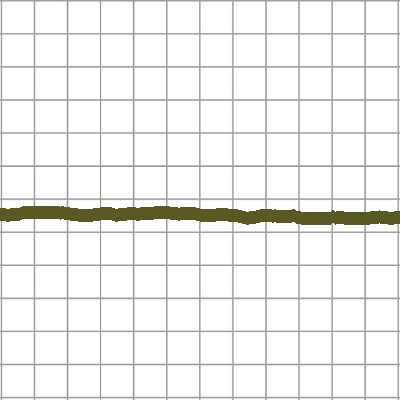

pitch74_thick1_color2_1_train.png


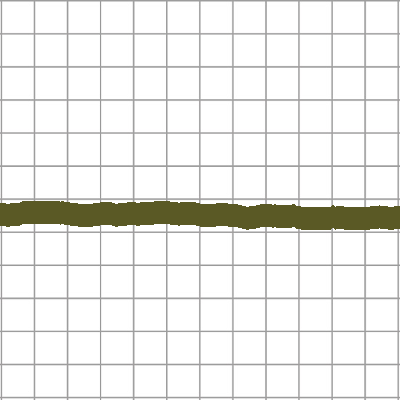

pitch74_thick2_color2_1_train.png


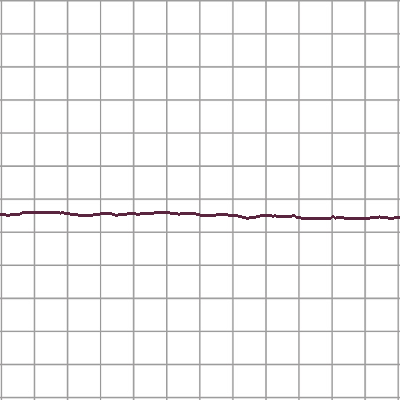

pitch74_thick0_color3_1_train.png


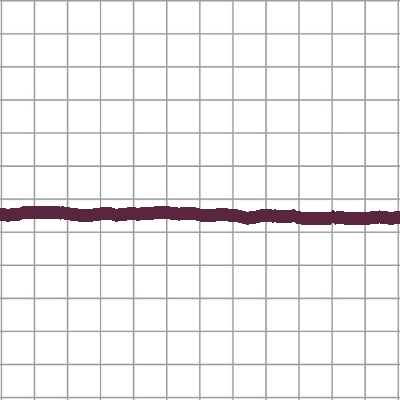

pitch74_thick1_color3_1_train.png


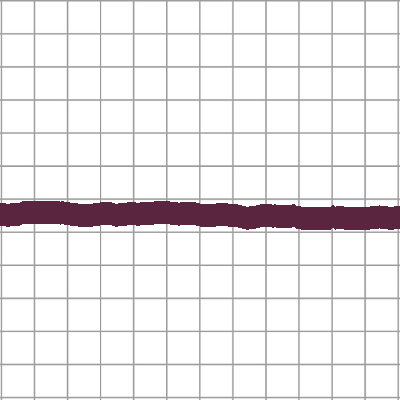

pitch74_thick2_color3_1_train.png


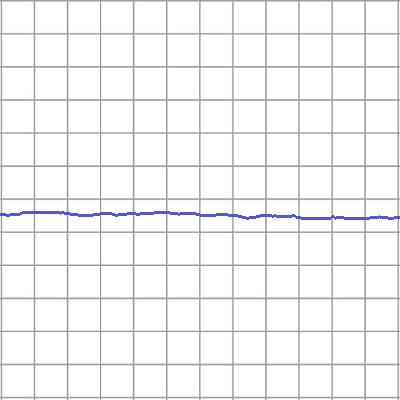

pitch74_thick0_color4_1_train.png


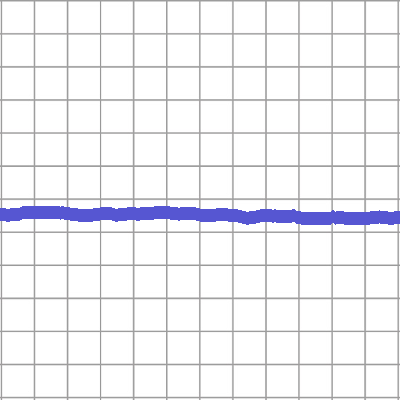

pitch74_thick1_color4_1_train.png


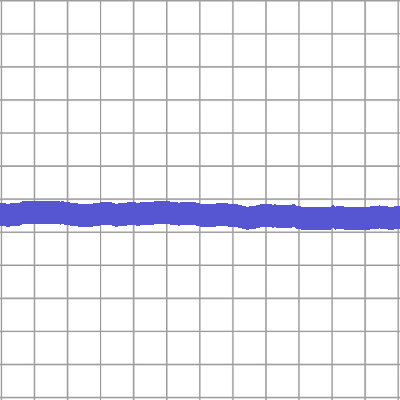

pitch74_thick2_color4_1_train.png


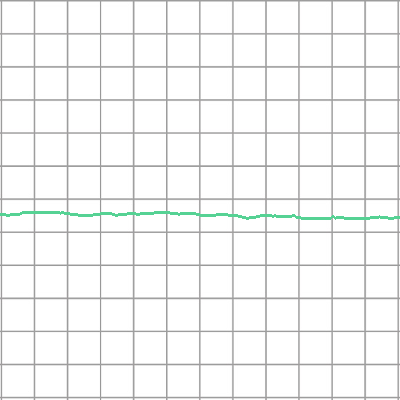

pitch74_thick0_color5_1_train.png


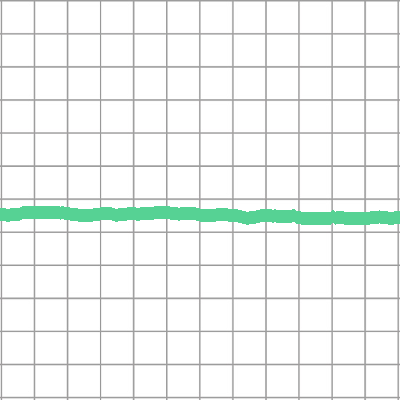

pitch74_thick1_color5_1_train.png


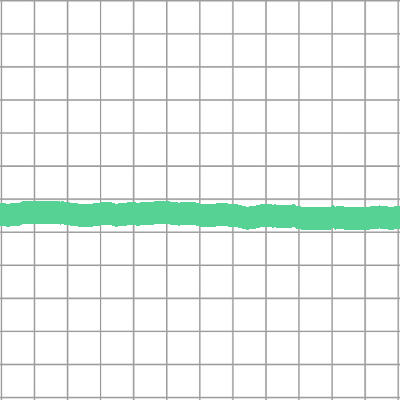

pitch74_thick2_color5_1_train.png


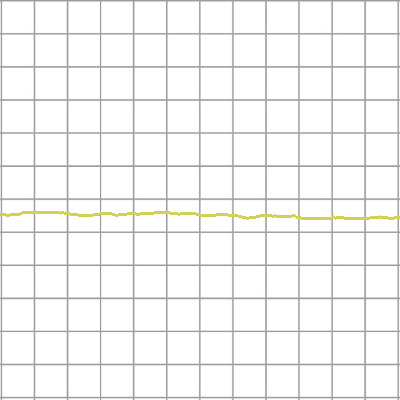

pitch74_thick0_color6_1_train.png


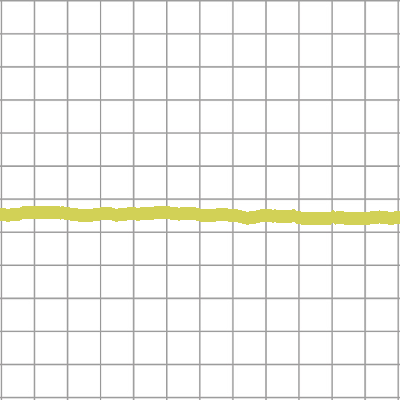

pitch74_thick1_color6_1_train.png


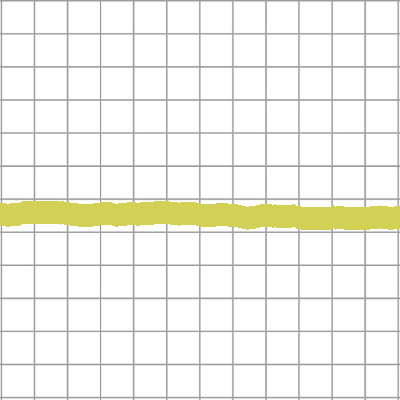

pitch74_thick2_color6_1_train.png


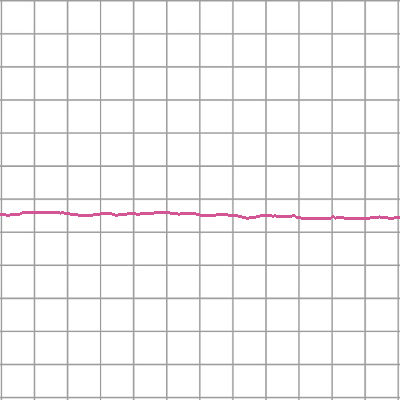

pitch74_thick0_color7_1_train.png


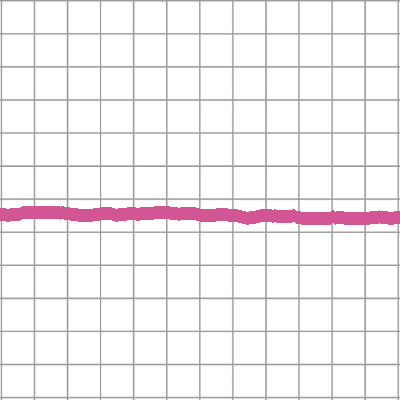

pitch74_thick1_color7_1_train.png


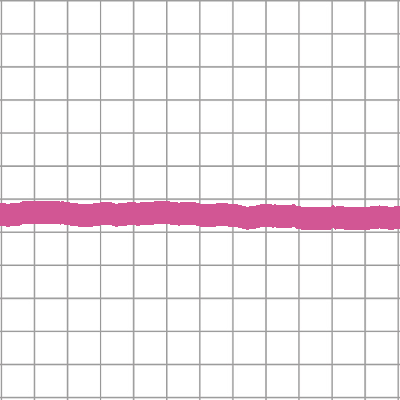

pitch74_thick2_color7_1_train.png


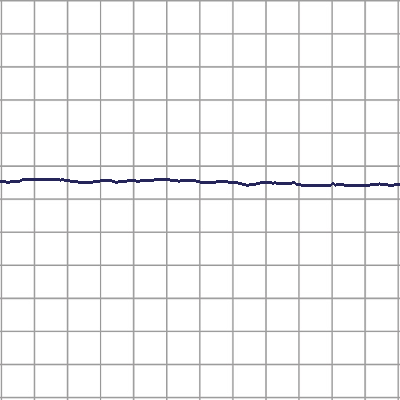

pitch75_thick0_color0_1_train.png


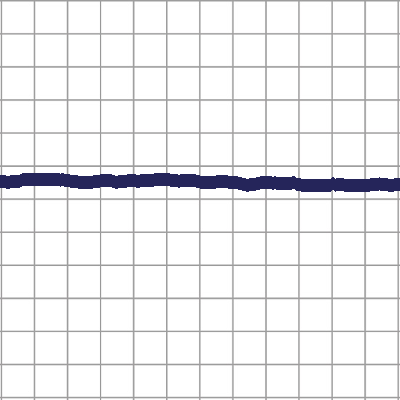

pitch75_thick1_color0_1_train.png


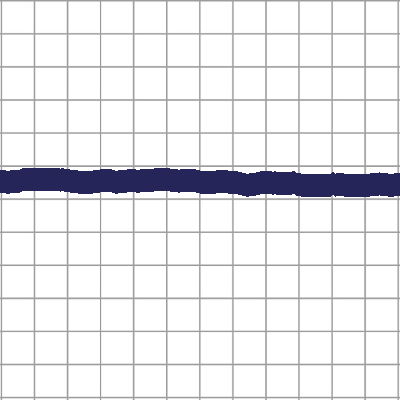

pitch75_thick2_color0_1_train.png


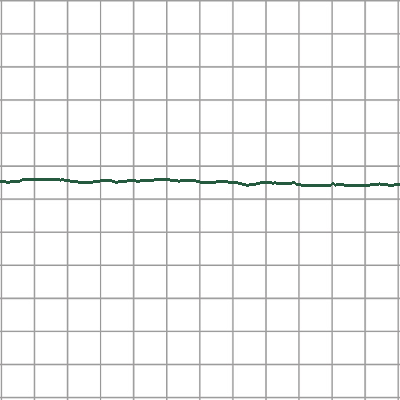

pitch75_thick0_color1_1_train.png


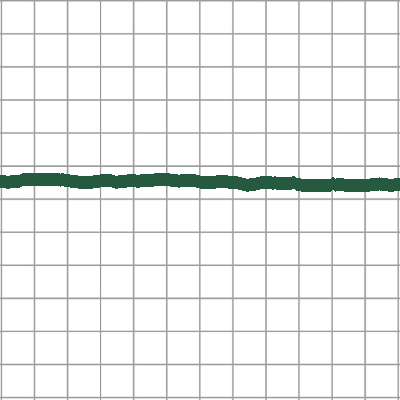

pitch75_thick1_color1_1_train.png


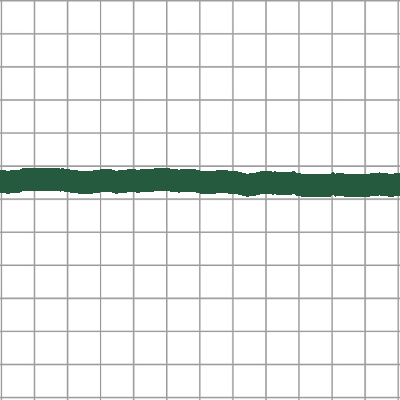

pitch75_thick2_color1_1_train.png


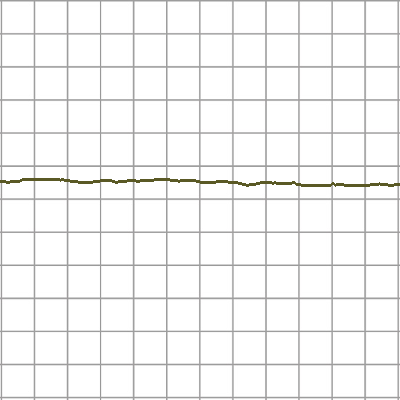

pitch75_thick0_color2_1_train.png


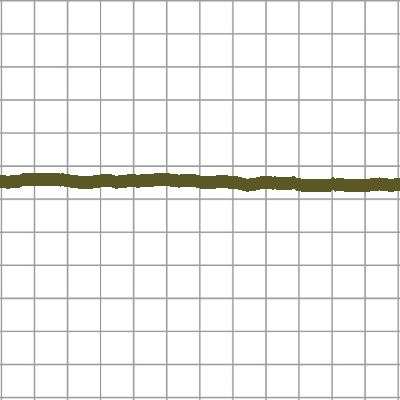

pitch75_thick1_color2_1_train.png


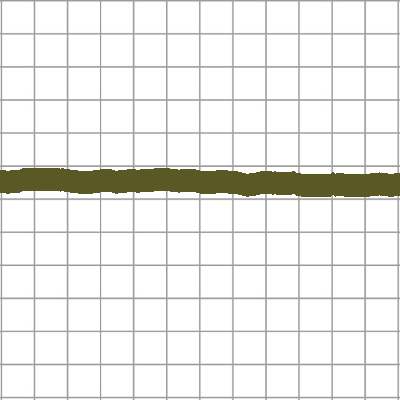

pitch75_thick2_color2_1_train.png


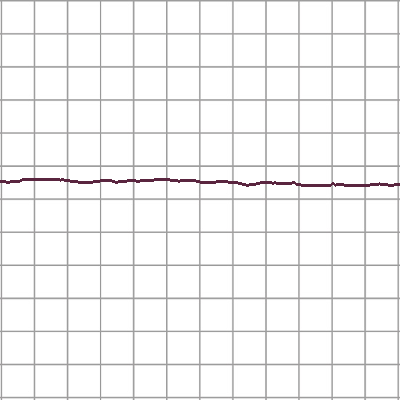

pitch75_thick0_color3_1_train.png


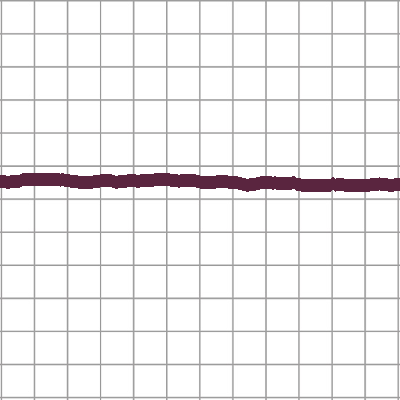

pitch75_thick1_color3_1_train.png


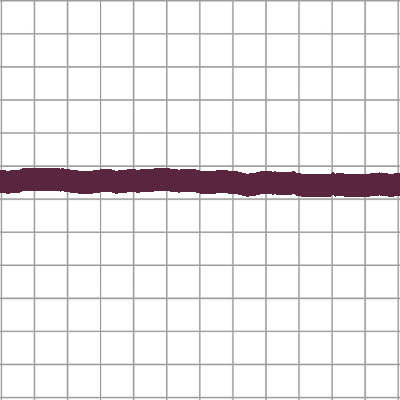

pitch75_thick2_color3_1_train.png


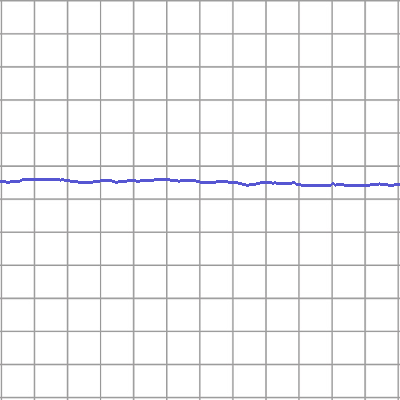

pitch75_thick0_color4_1_train.png


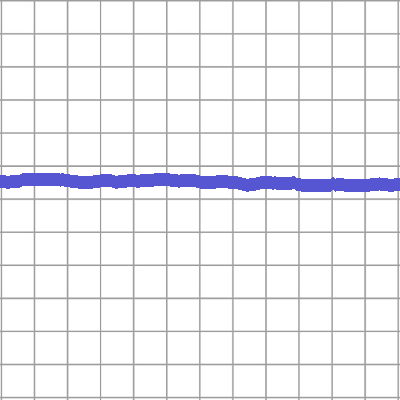

pitch75_thick1_color4_1_train.png


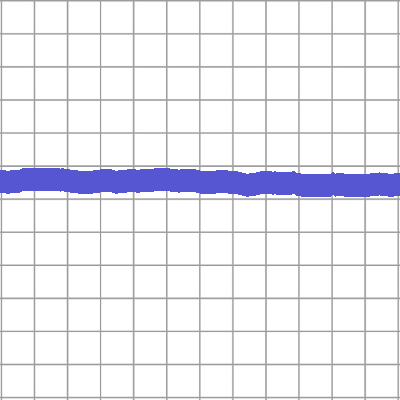

pitch75_thick2_color4_1_train.png


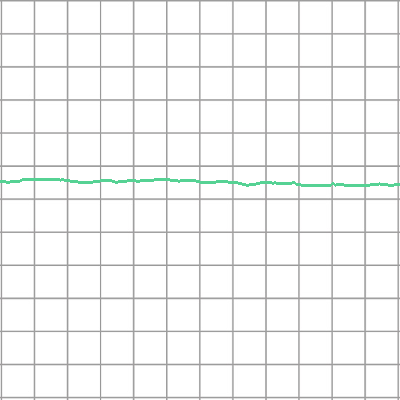

pitch75_thick0_color5_1_train.png


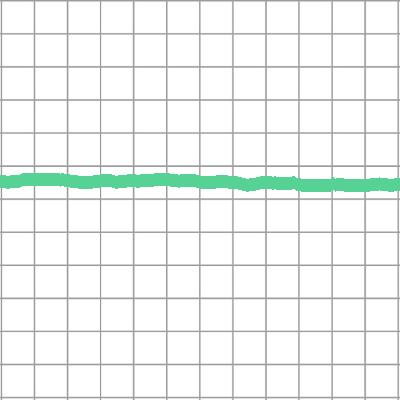

pitch75_thick1_color5_1_train.png


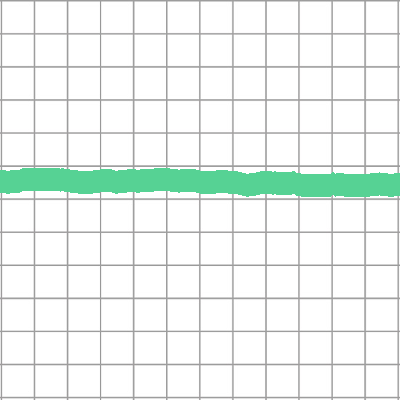

pitch75_thick2_color5_1_train.png


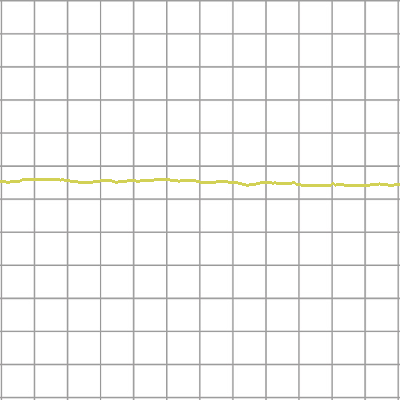

pitch75_thick0_color6_1_train.png


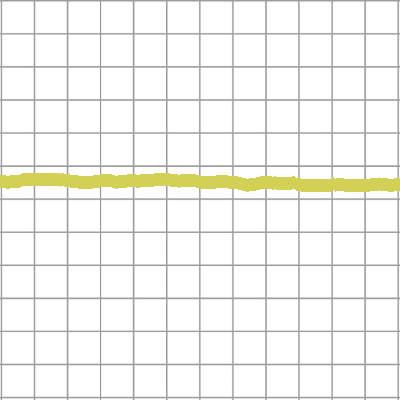

pitch75_thick1_color6_1_train.png


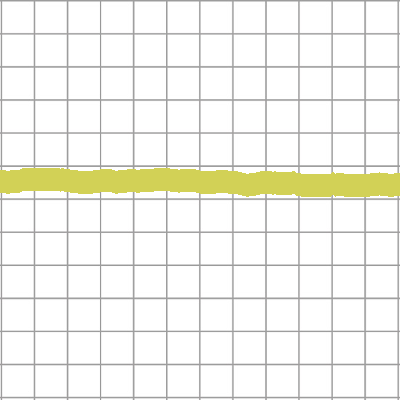

pitch75_thick2_color6_1_train.png


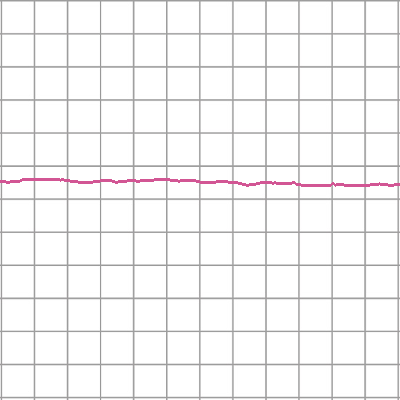

pitch75_thick0_color7_1_train.png


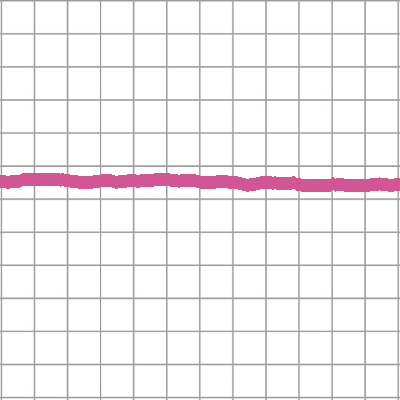

pitch75_thick1_color7_1_train.png


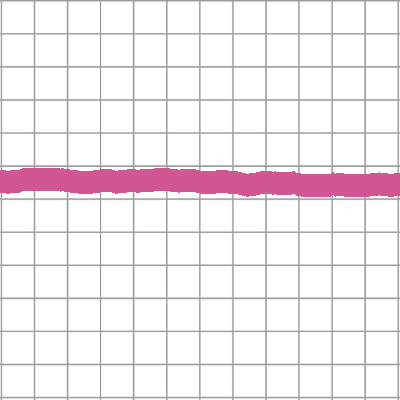

pitch75_thick2_color7_1_train.png


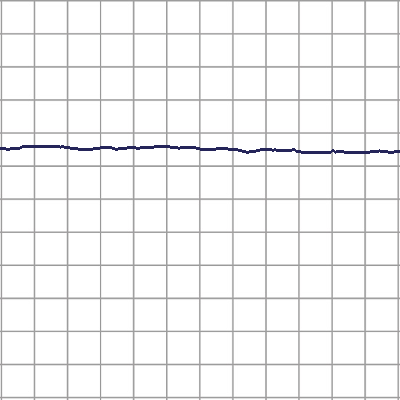

pitch76_thick0_color0_1_train.png


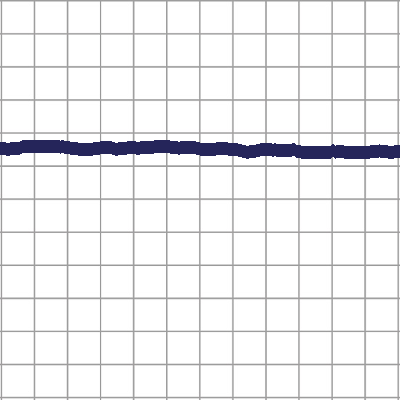

pitch76_thick1_color0_1_train.png


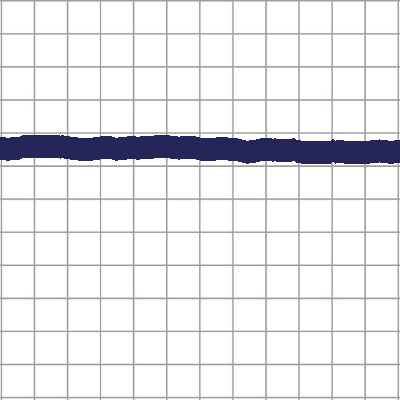

pitch76_thick2_color0_1_train.png


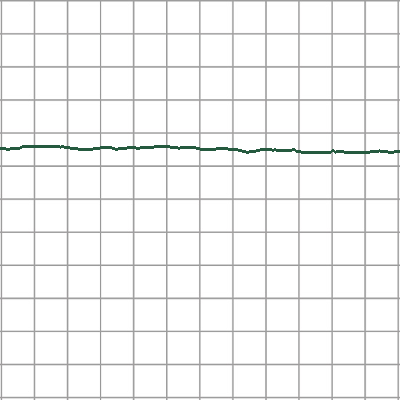

pitch76_thick0_color1_1_train.png


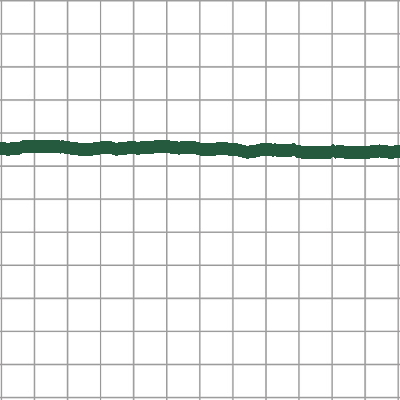

pitch76_thick1_color1_1_train.png


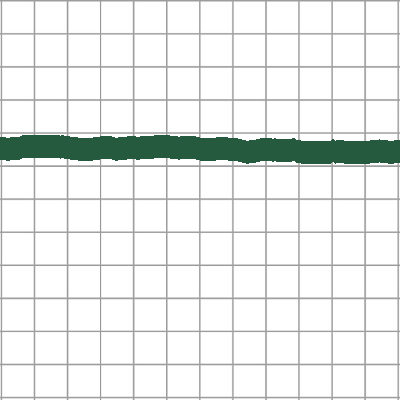

pitch76_thick2_color1_1_train.png


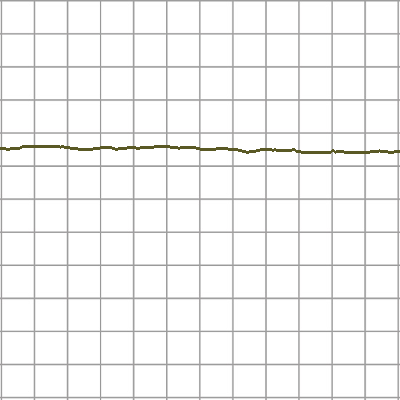

pitch76_thick0_color2_1_train.png


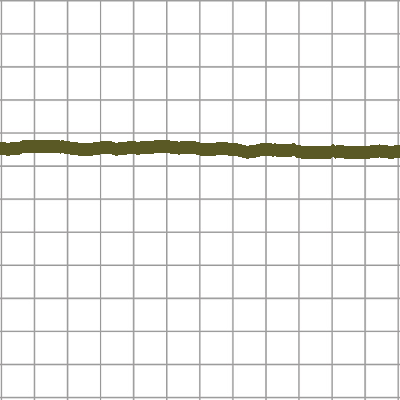

pitch76_thick1_color2_1_train.png


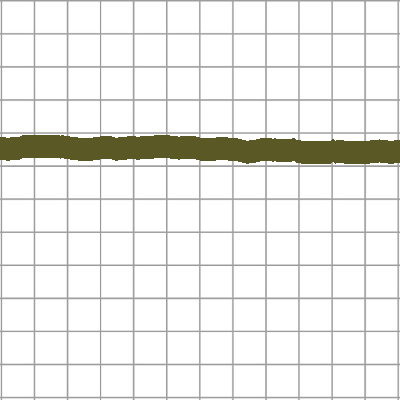

pitch76_thick2_color2_1_train.png


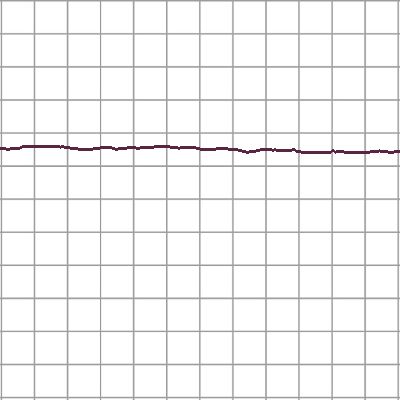

pitch76_thick0_color3_1_train.png


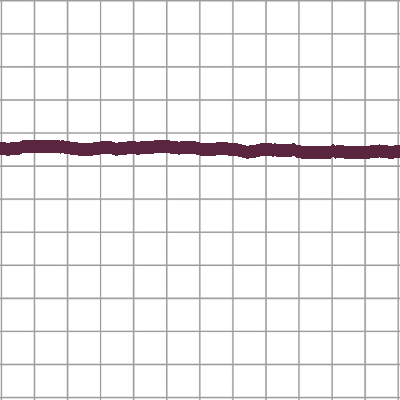

pitch76_thick1_color3_1_train.png


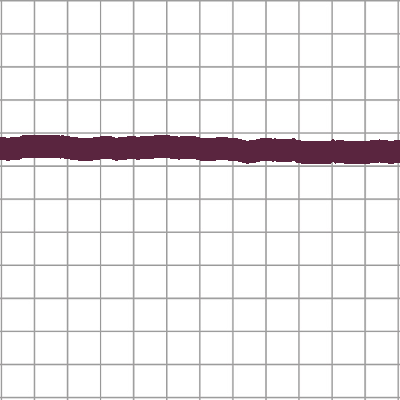

pitch76_thick2_color3_1_train.png


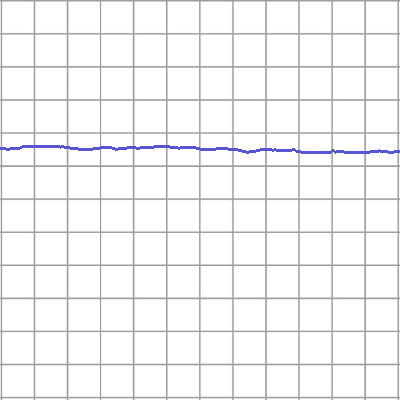

pitch76_thick0_color4_1_train.png


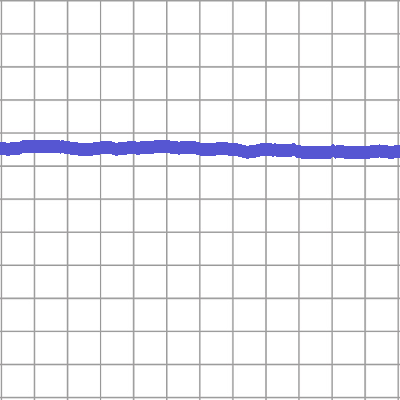

pitch76_thick1_color4_1_train.png


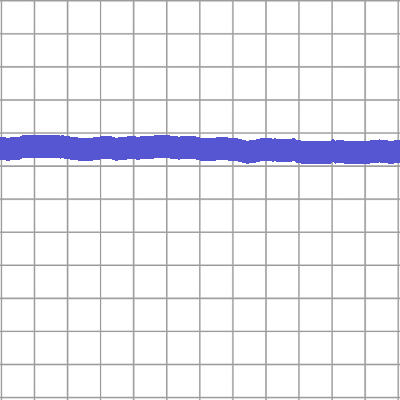

pitch76_thick2_color4_1_train.png


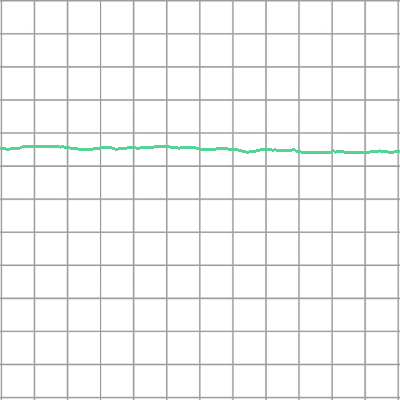

pitch76_thick0_color5_1_train.png


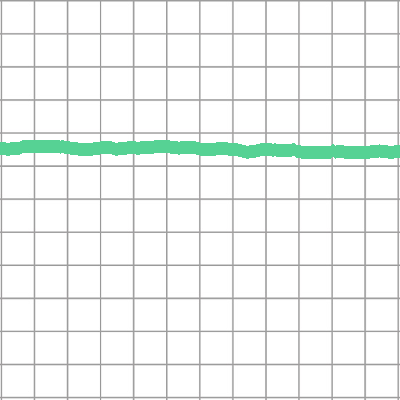

pitch76_thick1_color5_1_train.png


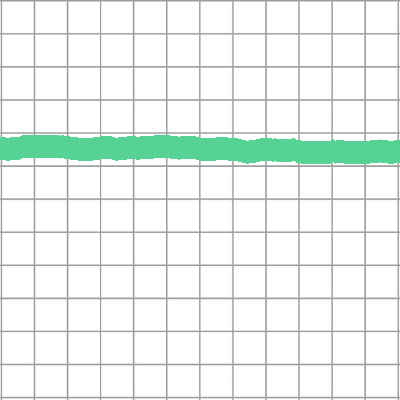

pitch76_thick2_color5_1_train.png


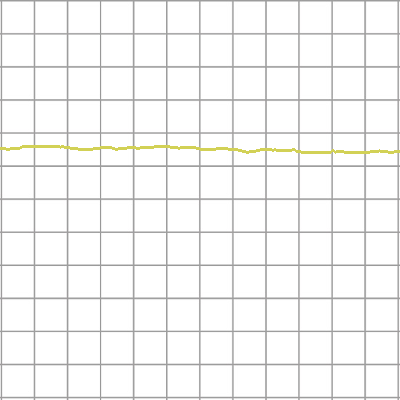

pitch76_thick0_color6_1_train.png


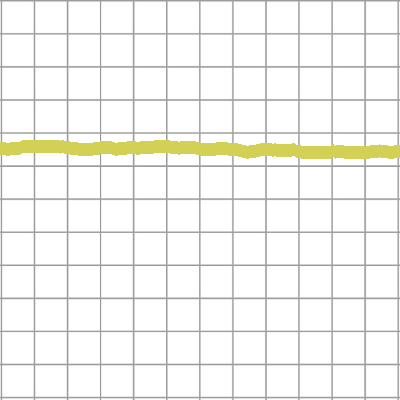

pitch76_thick1_color6_1_train.png


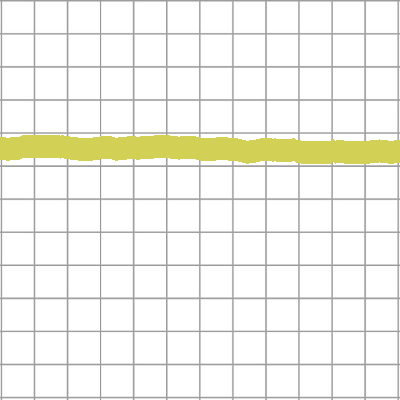

pitch76_thick2_color6_1_train.png


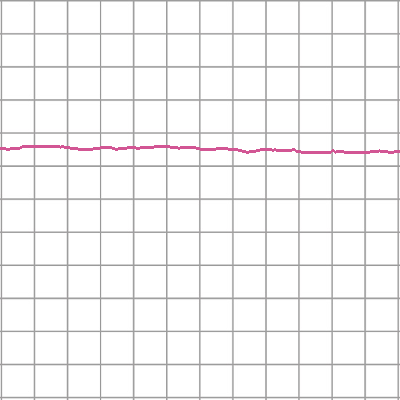

pitch76_thick0_color7_1_train.png


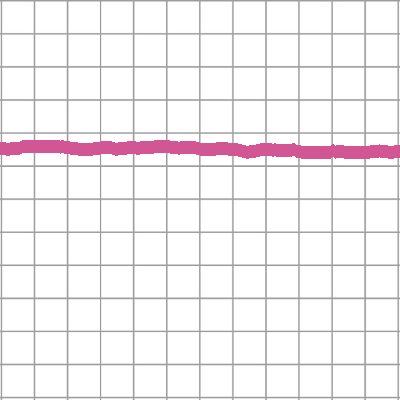

pitch76_thick1_color7_1_train.png


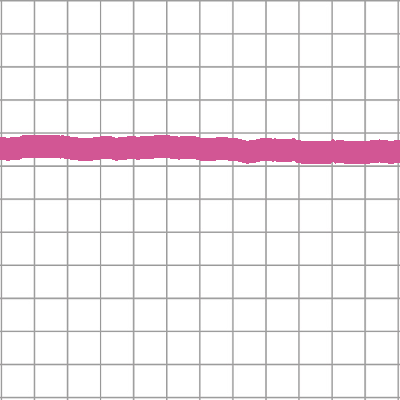

pitch76_thick2_color7_1_train.png


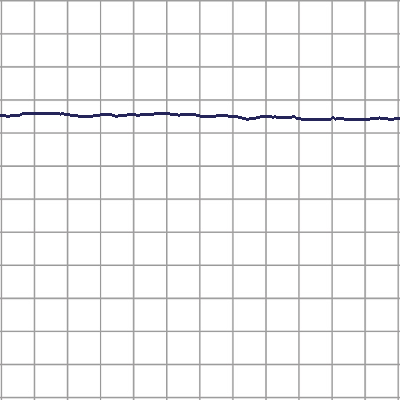

pitch77_thick0_color0_1_train.png


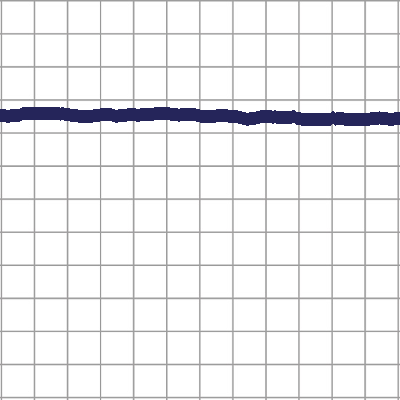

pitch77_thick1_color0_1_train.png


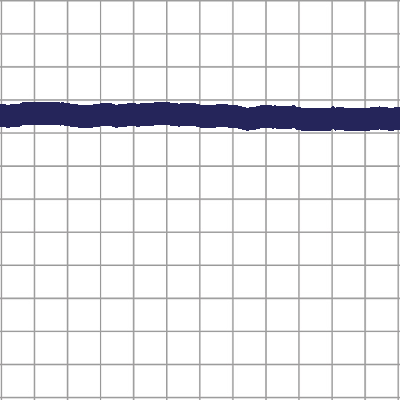

pitch77_thick2_color0_1_train.png


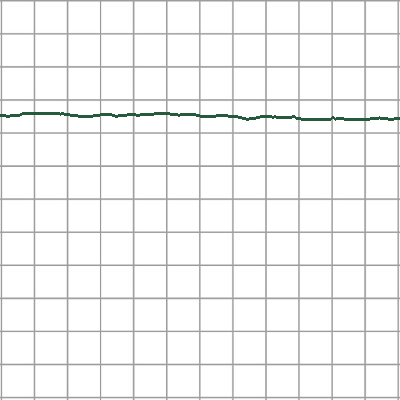

pitch77_thick0_color1_1_train.png


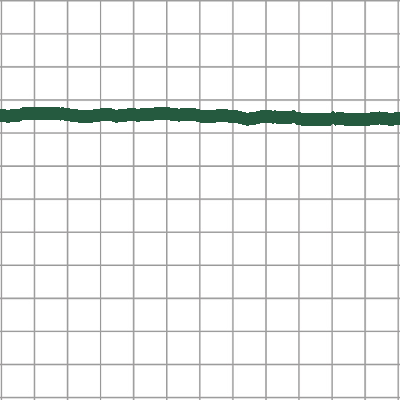

pitch77_thick1_color1_1_train.png


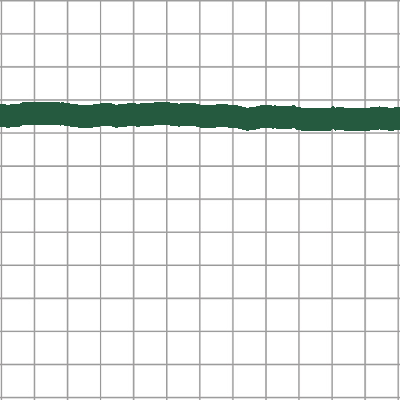

pitch77_thick2_color1_1_train.png


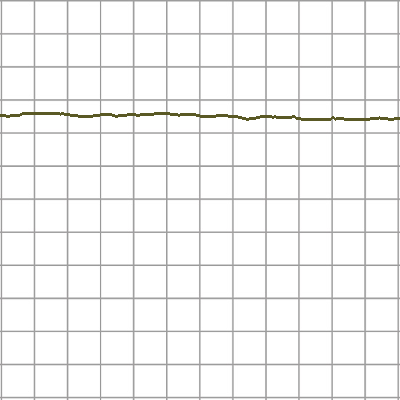

pitch77_thick0_color2_1_train.png


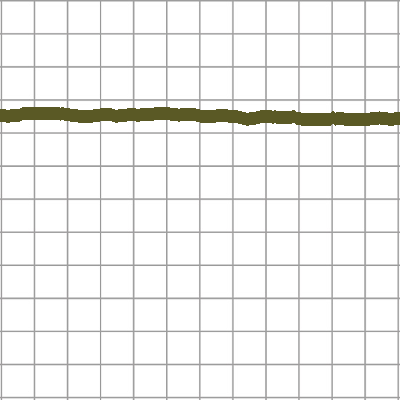

pitch77_thick1_color2_1_train.png


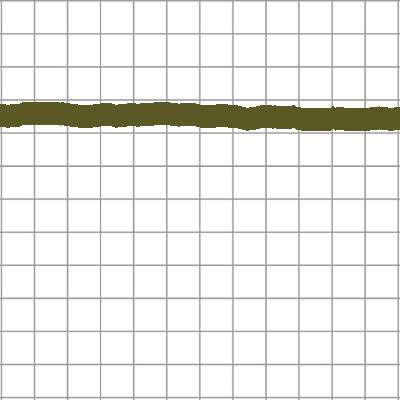

pitch77_thick2_color2_1_train.png


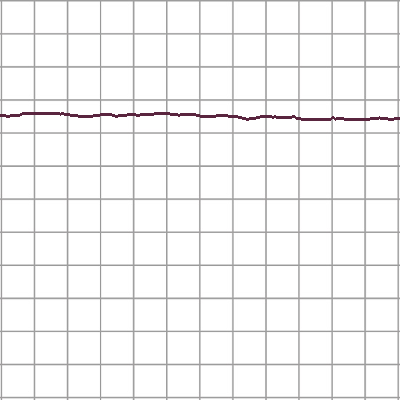

pitch77_thick0_color3_1_train.png


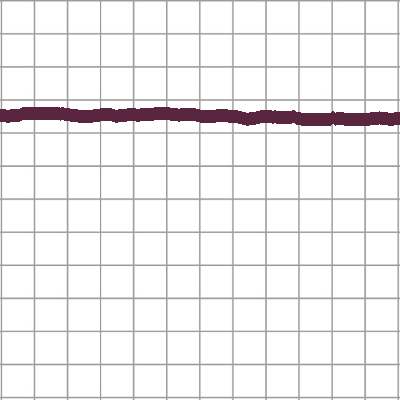

pitch77_thick1_color3_1_train.png


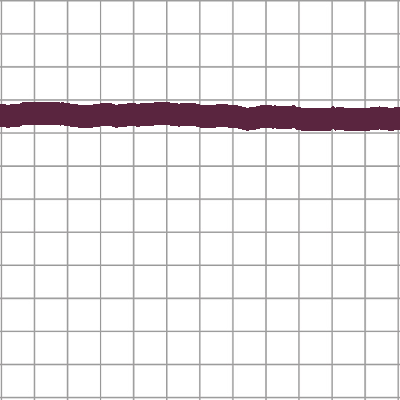

pitch77_thick2_color3_1_train.png


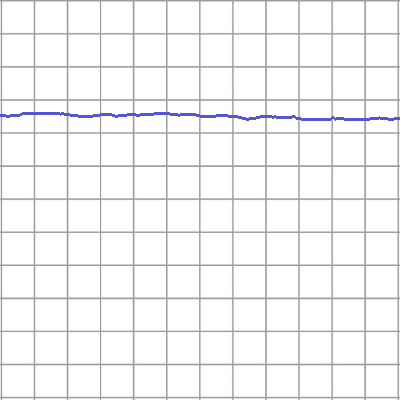

pitch77_thick0_color4_1_train.png


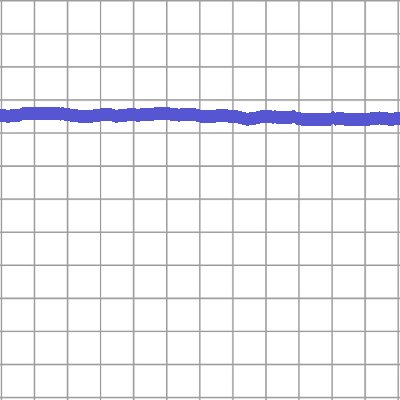

pitch77_thick1_color4_1_train.png


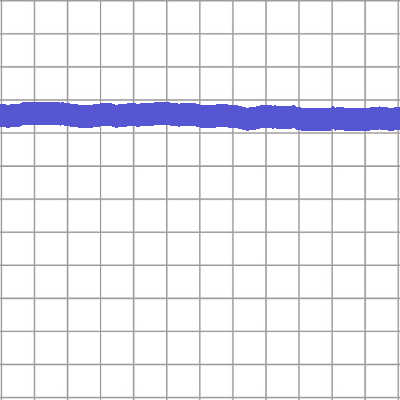

pitch77_thick2_color4_1_train.png


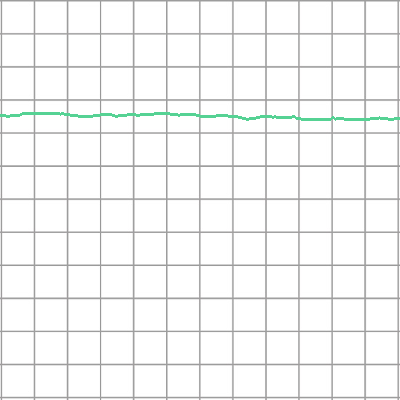

pitch77_thick0_color5_1_train.png


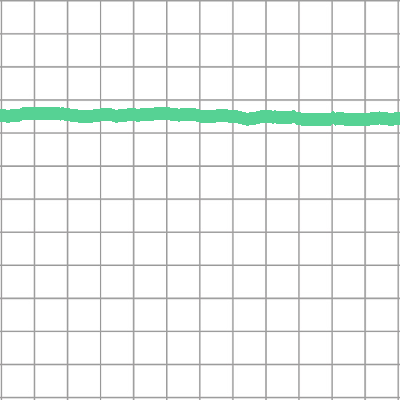

pitch77_thick1_color5_1_train.png


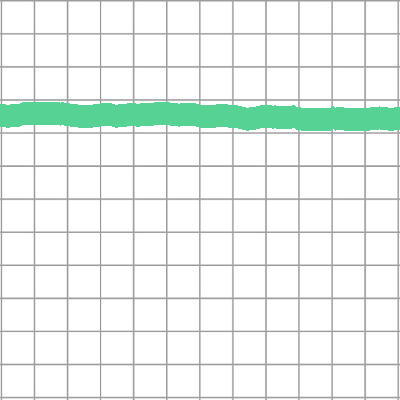

pitch77_thick2_color5_1_train.png


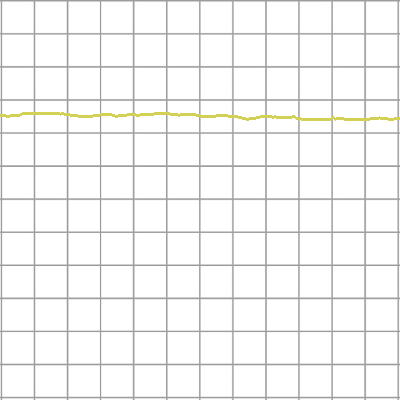

pitch77_thick0_color6_1_train.png


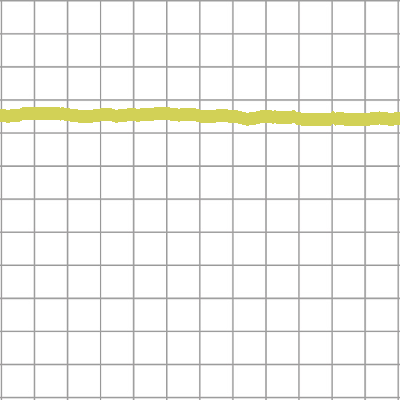

pitch77_thick1_color6_1_train.png


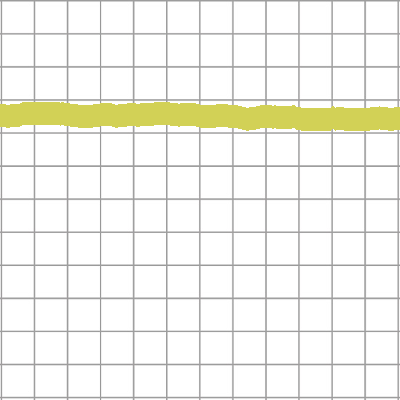

pitch77_thick2_color6_1_train.png


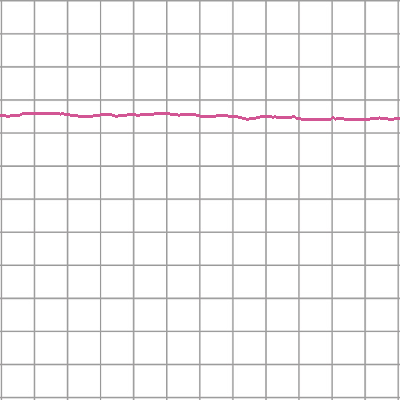

pitch77_thick0_color7_1_train.png


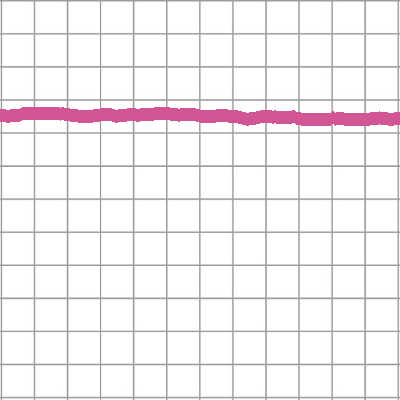

pitch77_thick1_color7_1_train.png


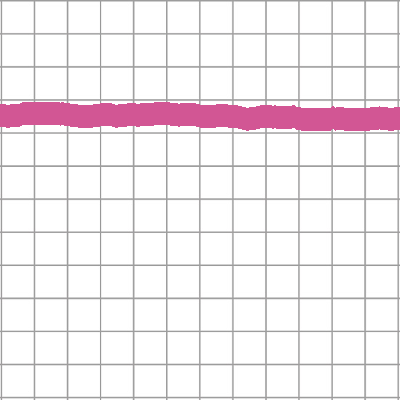

pitch77_thick2_color7_1_train.png


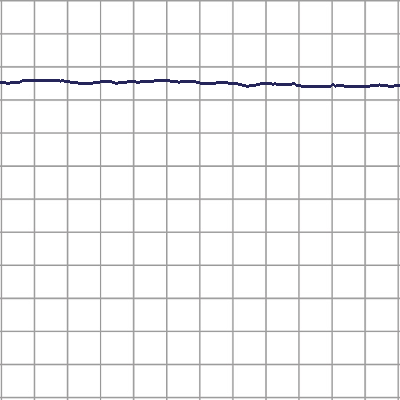

pitch78_thick0_color0_1_train.png


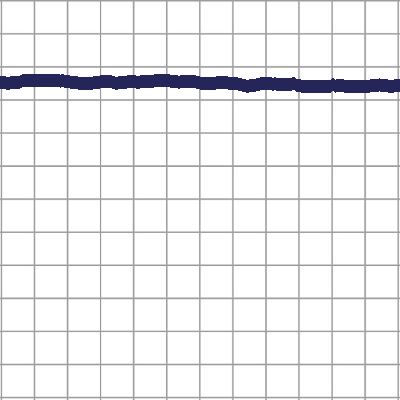

pitch78_thick1_color0_1_train.png


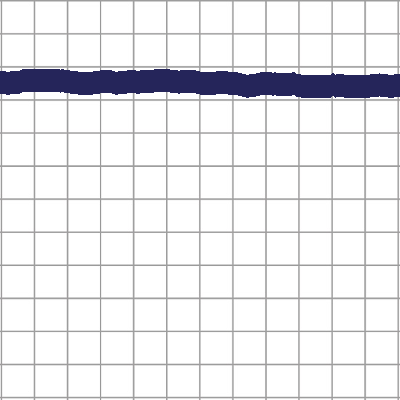

pitch78_thick2_color0_1_train.png


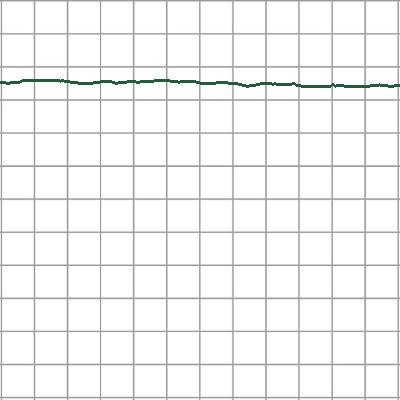

pitch78_thick0_color1_1_train.png


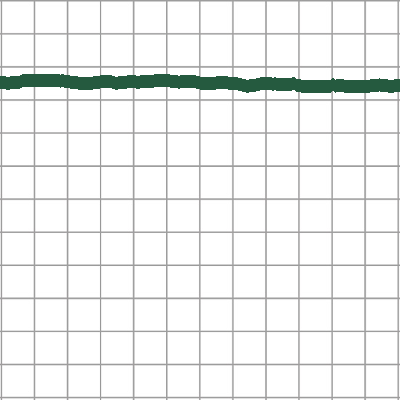

pitch78_thick1_color1_1_train.png


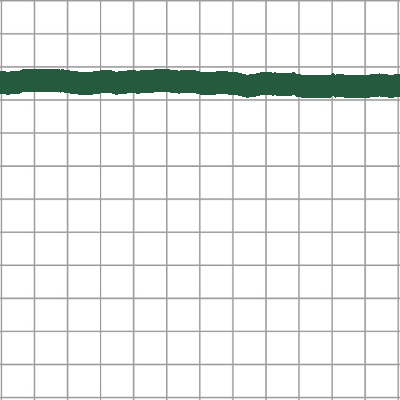

pitch78_thick2_color1_1_train.png


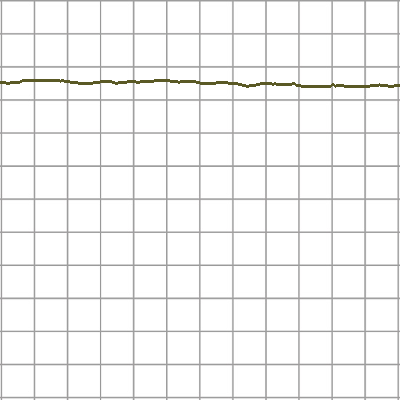

pitch78_thick0_color2_1_train.png


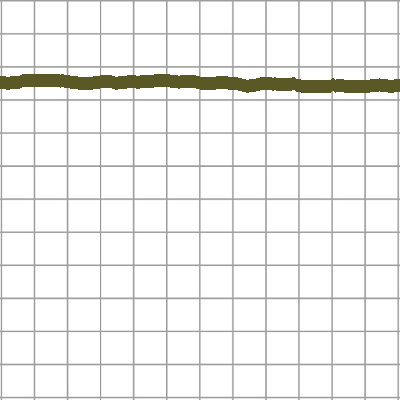

pitch78_thick1_color2_1_train.png


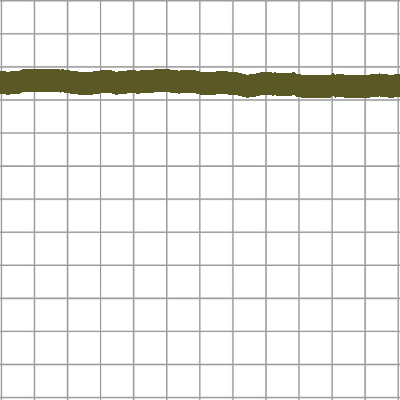

pitch78_thick2_color2_1_train.png


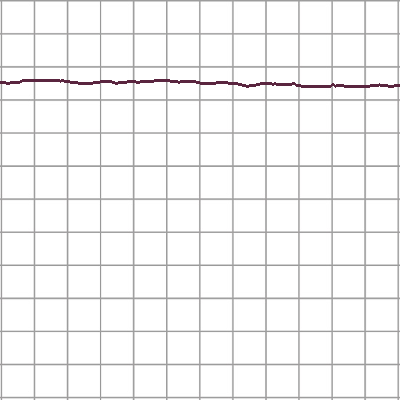

pitch78_thick0_color3_1_train.png


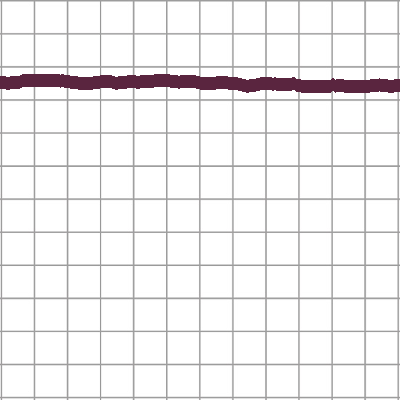

pitch78_thick1_color3_1_train.png


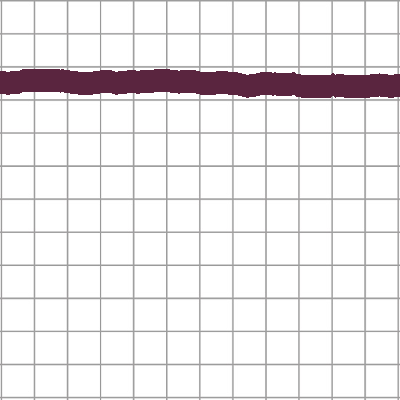

pitch78_thick2_color3_1_train.png


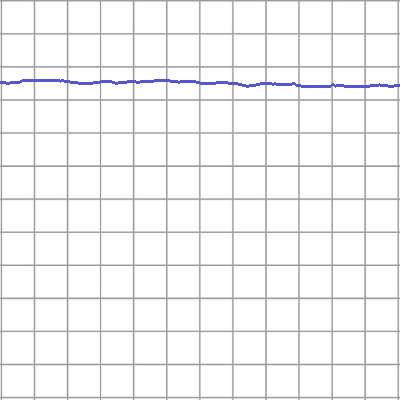

pitch78_thick0_color4_1_train.png


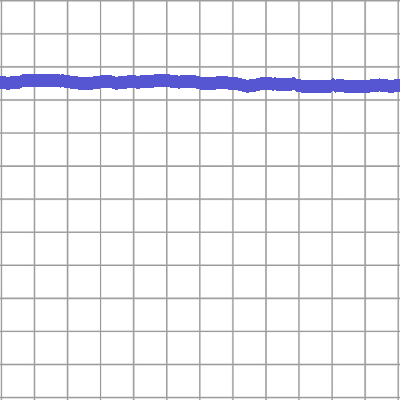

pitch78_thick1_color4_1_train.png


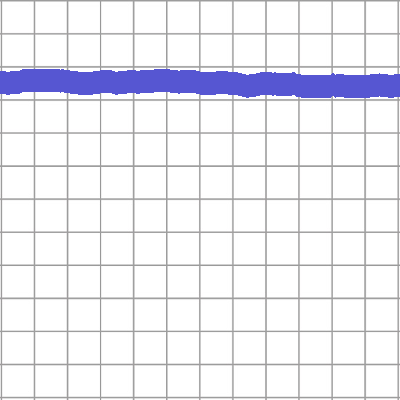

pitch78_thick2_color4_1_train.png


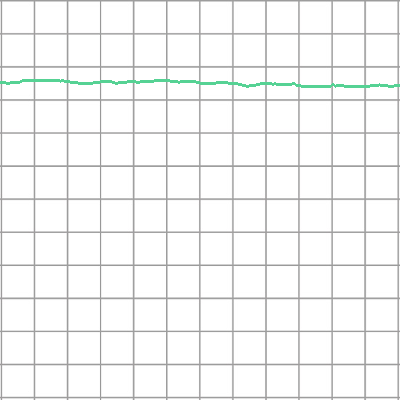

pitch78_thick0_color5_1_train.png


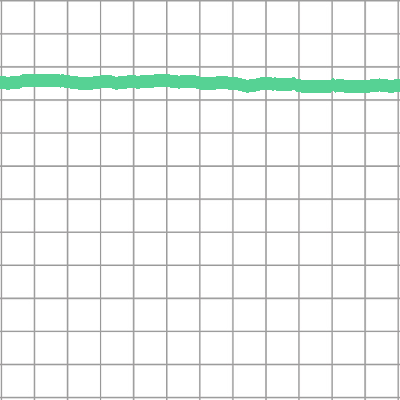

pitch78_thick1_color5_1_train.png


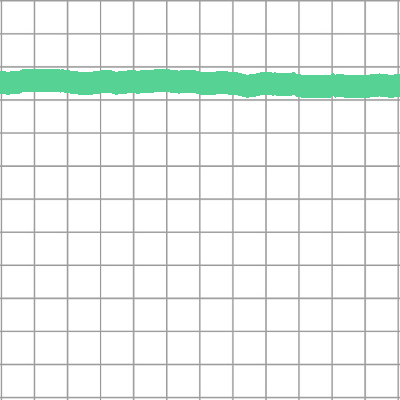

pitch78_thick2_color5_1_train.png


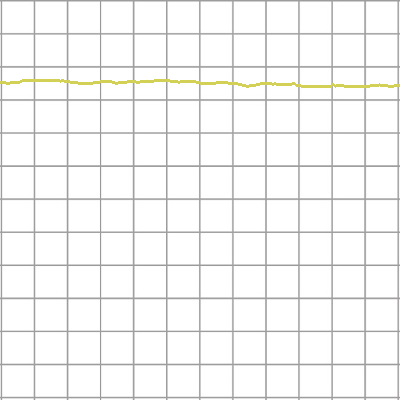

pitch78_thick0_color6_1_train.png


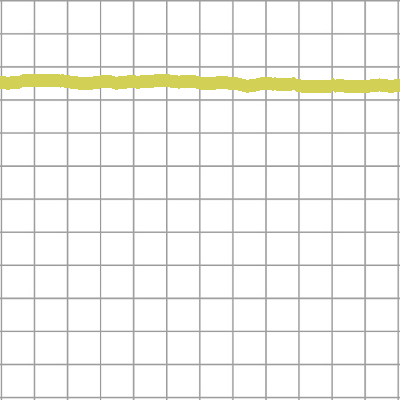

pitch78_thick1_color6_1_train.png


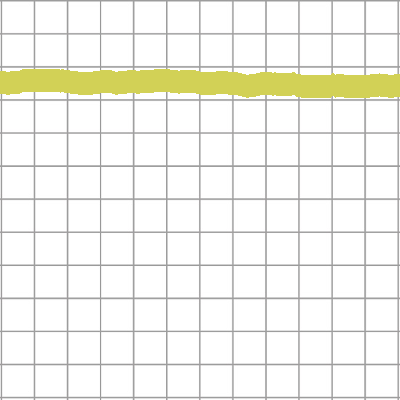

pitch78_thick2_color6_1_train.png


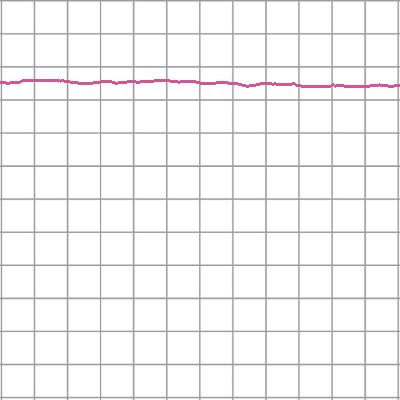

pitch78_thick0_color7_1_train.png


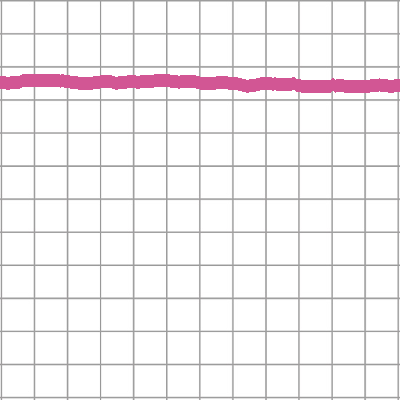

pitch78_thick1_color7_1_train.png


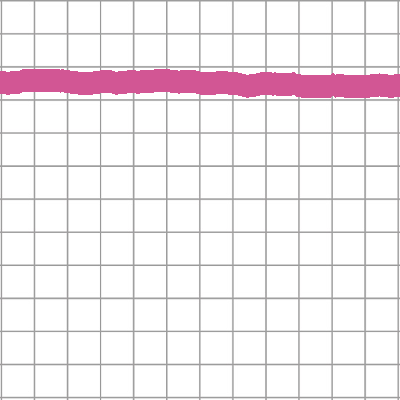

pitch78_thick2_color7_1_train.png


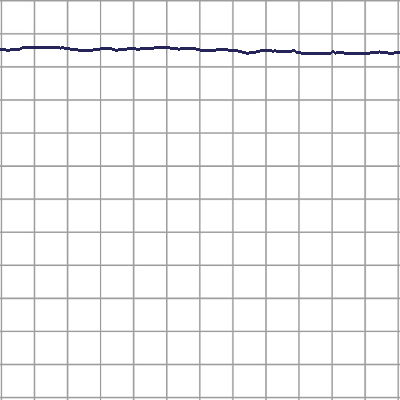

pitch79_thick0_color0_1_train.png


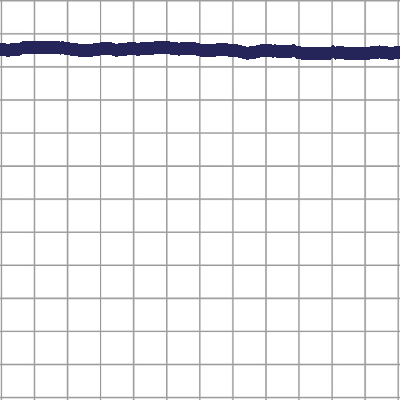

pitch79_thick1_color0_1_train.png


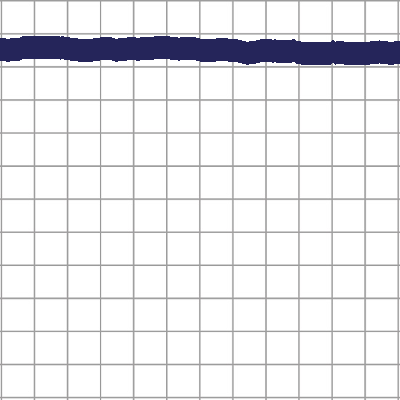

pitch79_thick2_color0_1_train.png


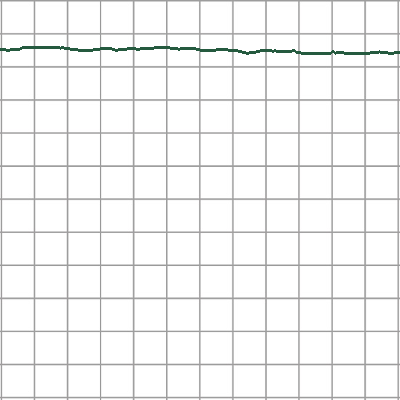

pitch79_thick0_color1_1_train.png


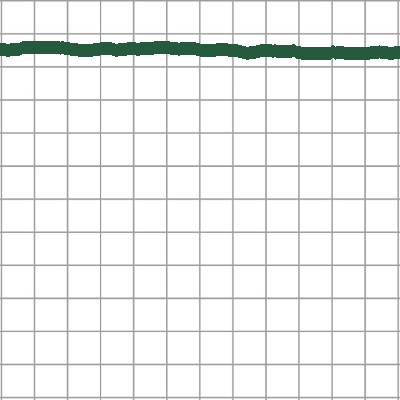

pitch79_thick1_color1_1_train.png


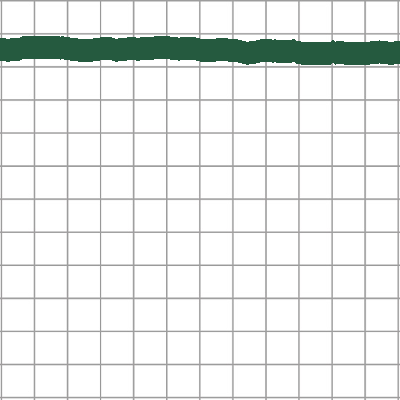

pitch79_thick2_color1_1_train.png


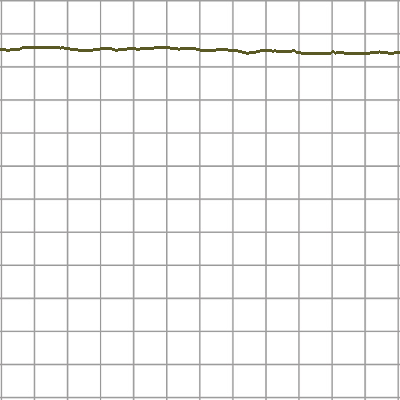

pitch79_thick0_color2_1_train.png


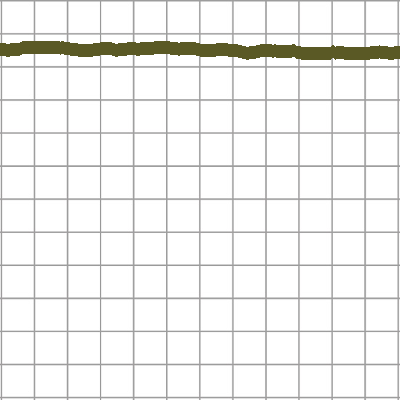

pitch79_thick1_color2_1_train.png


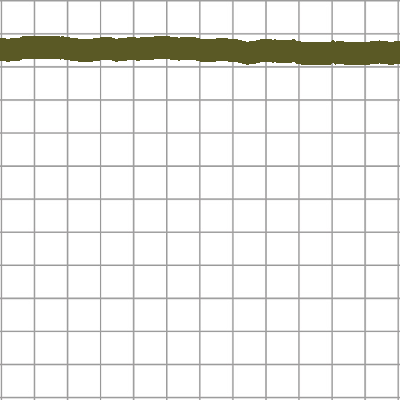

pitch79_thick2_color2_1_train.png


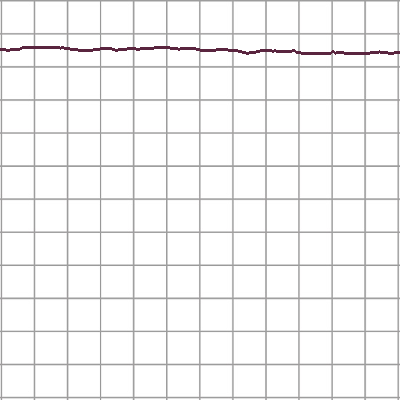

pitch79_thick0_color3_1_train.png


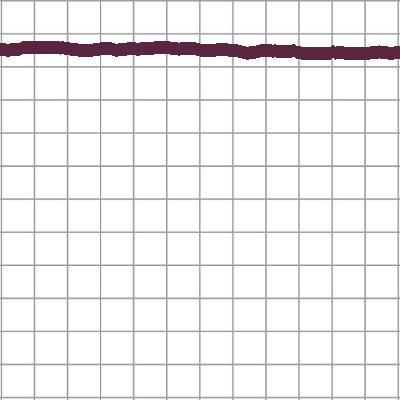

pitch79_thick1_color3_1_train.png


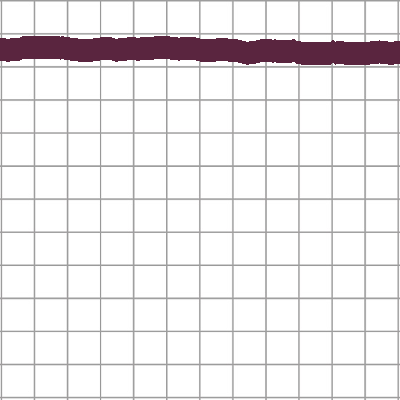

pitch79_thick2_color3_1_train.png


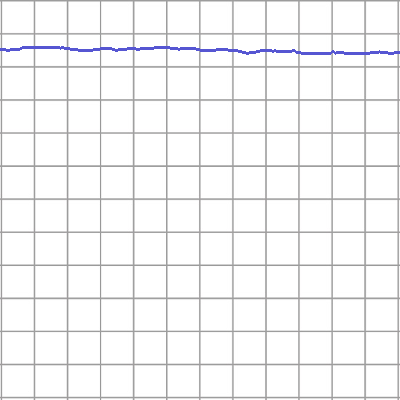

pitch79_thick0_color4_1_train.png


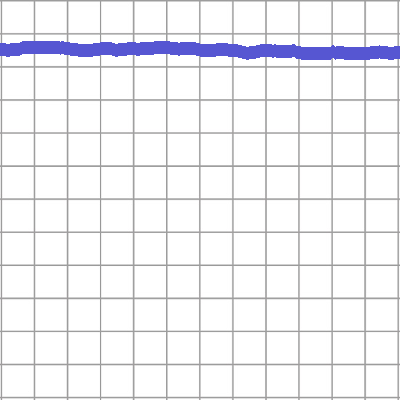

pitch79_thick1_color4_1_train.png


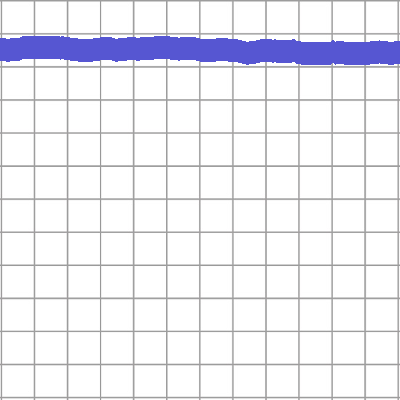

pitch79_thick2_color4_1_train.png


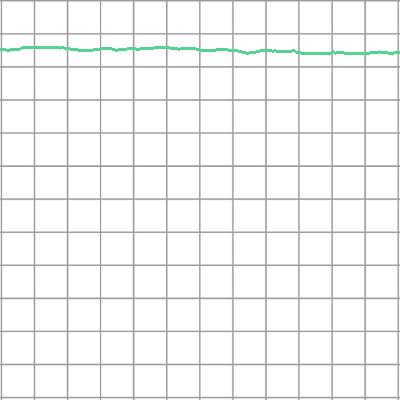

pitch79_thick0_color5_1_train.png


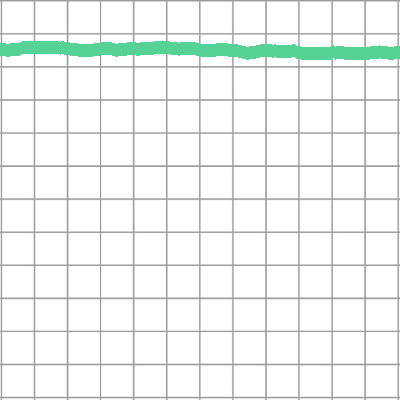

pitch79_thick1_color5_1_train.png


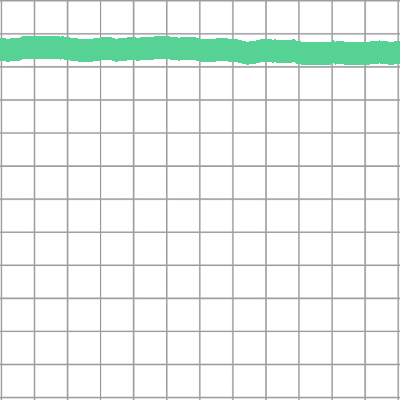

pitch79_thick2_color5_1_train.png


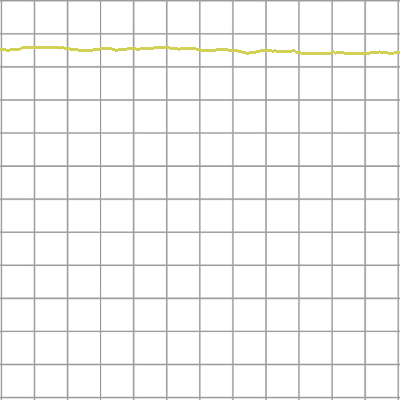

pitch79_thick0_color6_1_train.png


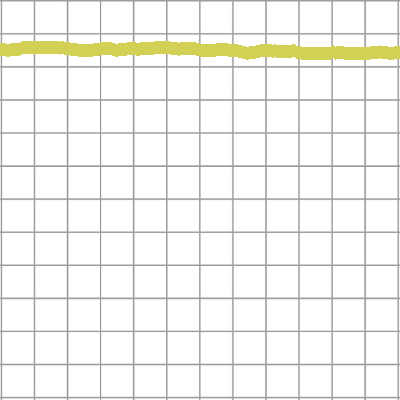

pitch79_thick1_color6_1_train.png


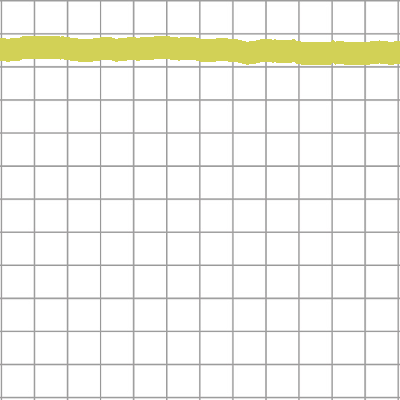

pitch79_thick2_color6_1_train.png


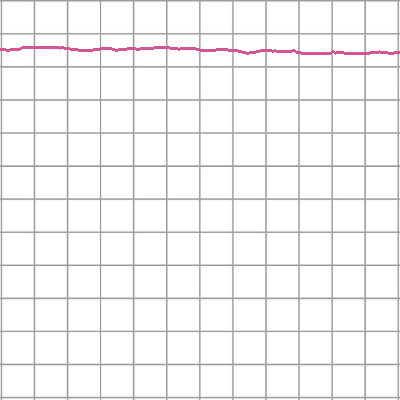

pitch79_thick0_color7_1_train.png


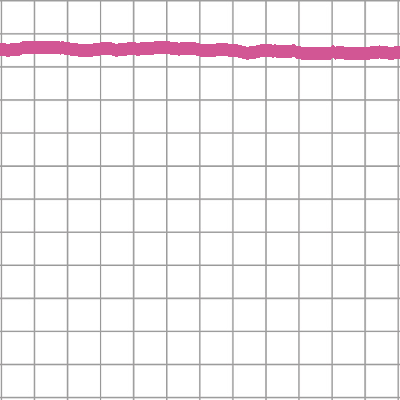

pitch79_thick1_color7_1_train.png


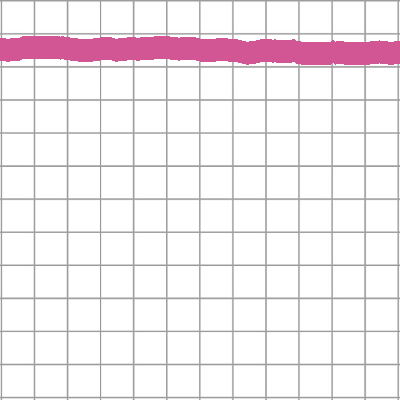

pitch79_thick2_color7_1_train.png


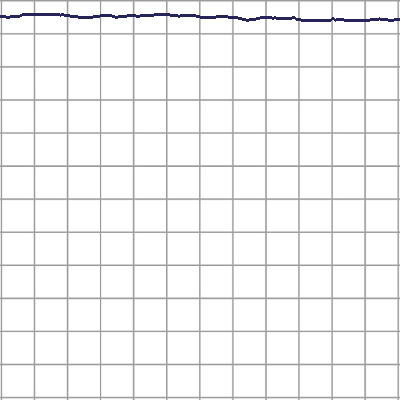

pitch80_thick0_color0_1_train.png


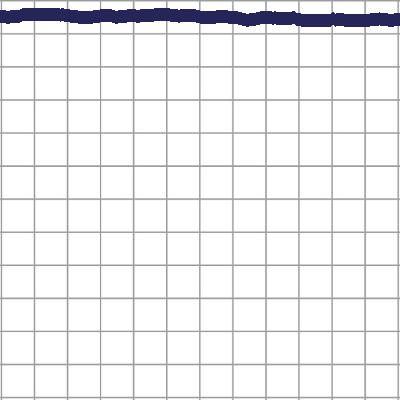

pitch80_thick1_color0_1_train.png


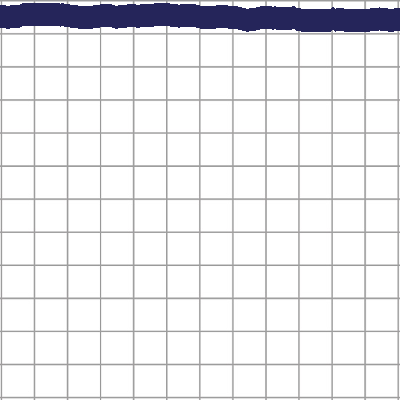

pitch80_thick2_color0_1_train.png


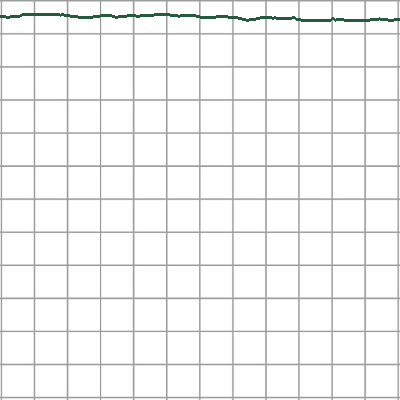

pitch80_thick0_color1_1_train.png


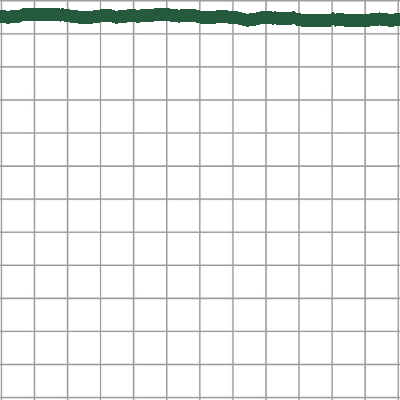

pitch80_thick1_color1_1_train.png


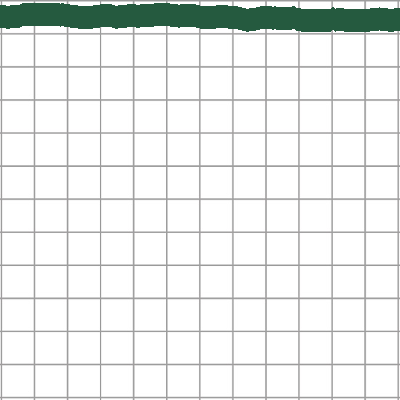

pitch80_thick2_color1_1_train.png


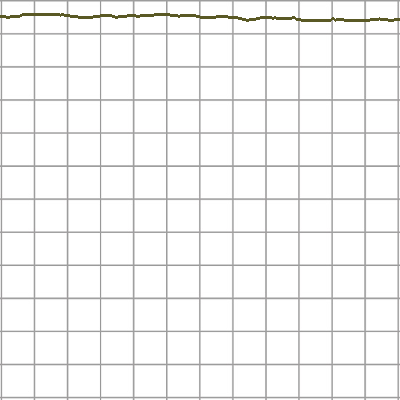

pitch80_thick0_color2_1_train.png


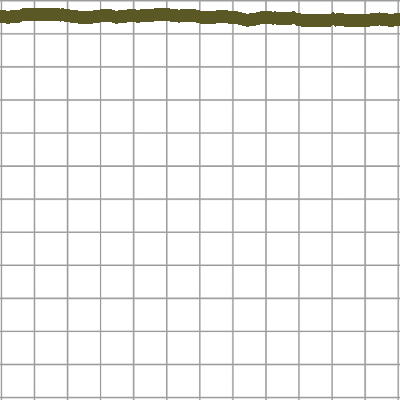

pitch80_thick1_color2_1_train.png


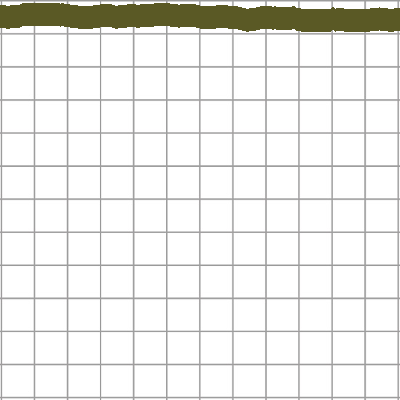

pitch80_thick2_color2_1_train.png


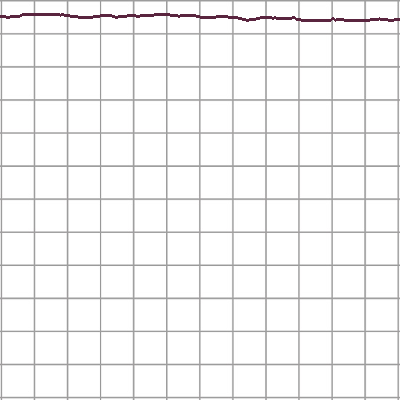

pitch80_thick0_color3_1_train.png


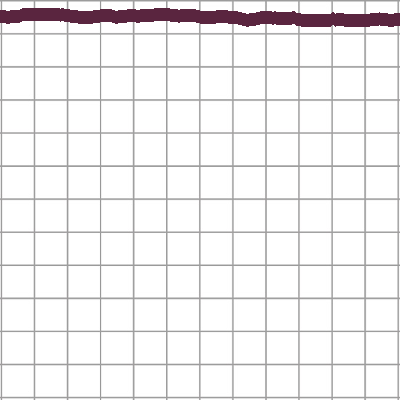

pitch80_thick1_color3_1_train.png


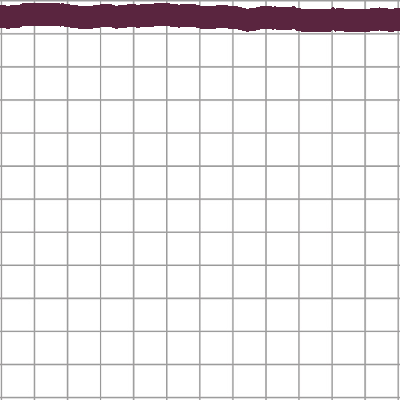

pitch80_thick2_color3_1_train.png


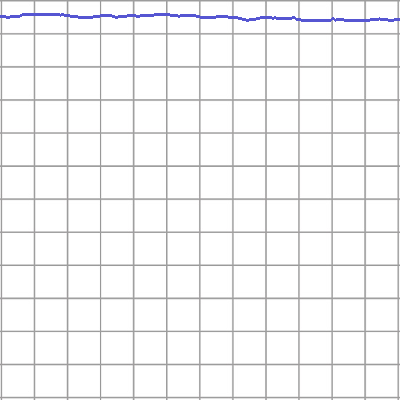

pitch80_thick0_color4_1_train.png


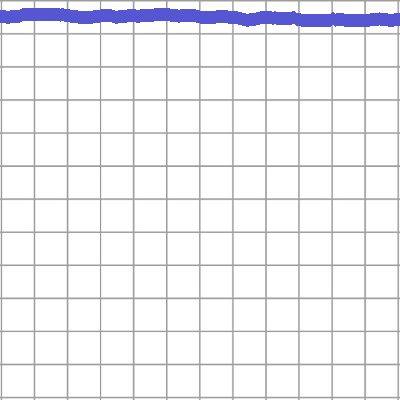

pitch80_thick1_color4_1_train.png


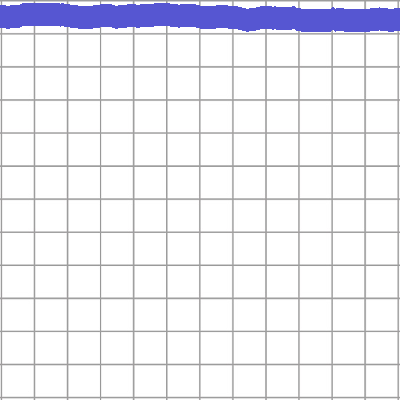

pitch80_thick2_color4_1_train.png


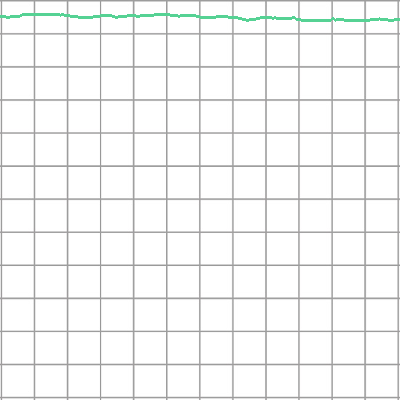

pitch80_thick0_color5_1_train.png


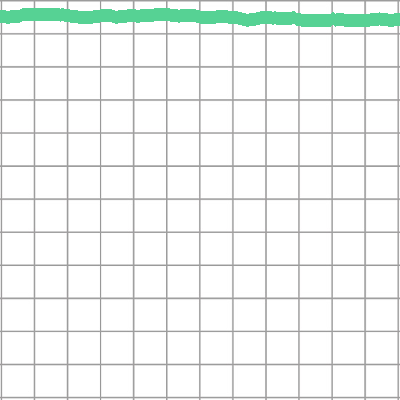

pitch80_thick1_color5_1_train.png


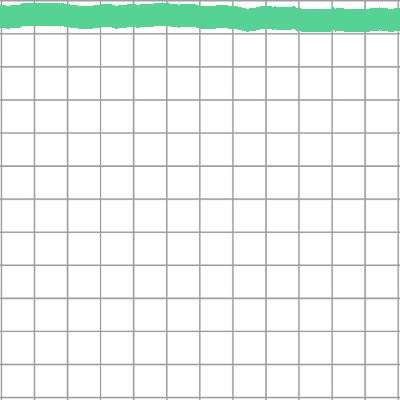

pitch80_thick2_color5_1_train.png


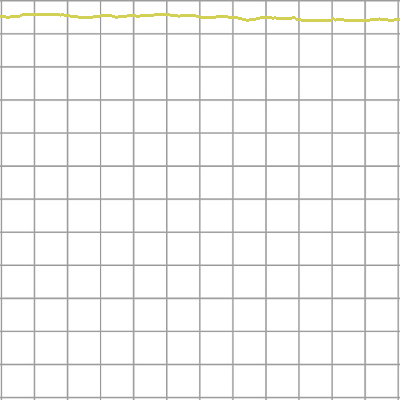

pitch80_thick0_color6_1_train.png


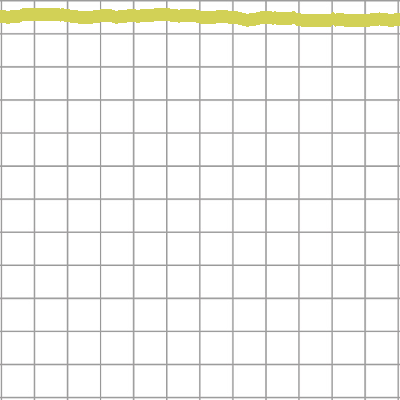

pitch80_thick1_color6_1_train.png


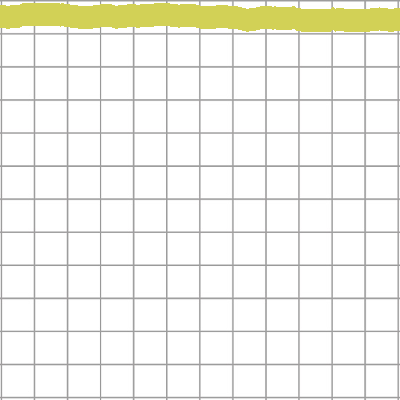

pitch80_thick2_color6_1_train.png


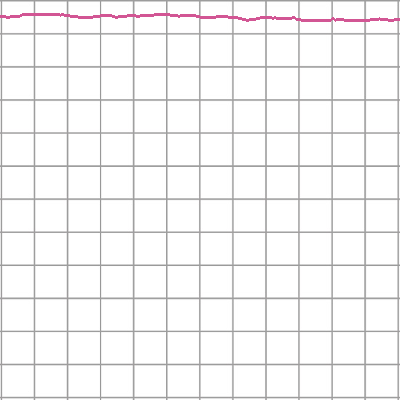

pitch80_thick0_color7_1_train.png


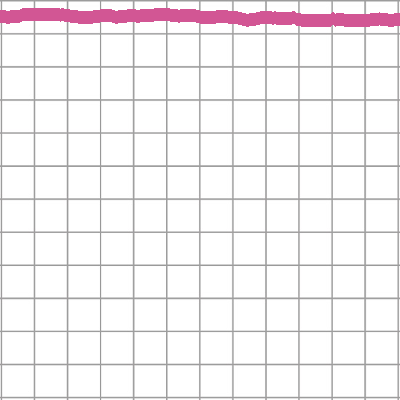

pitch80_thick1_color7_1_train.png


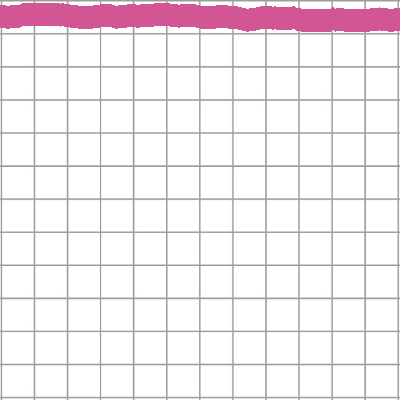

pitch80_thick2_color7_1_train.png
[INFO] generating validation dataset...


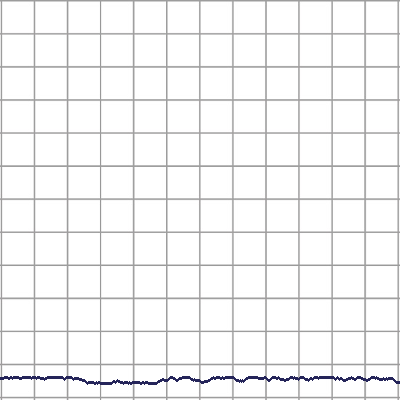

pitch69_thick0_color0_0_validation.png


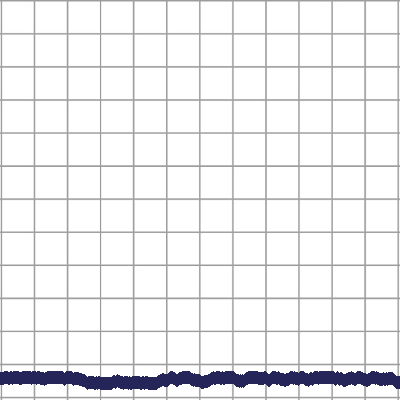

pitch69_thick1_color0_0_validation.png


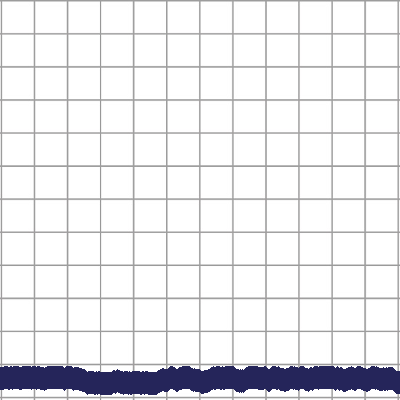

pitch69_thick2_color0_0_validation.png


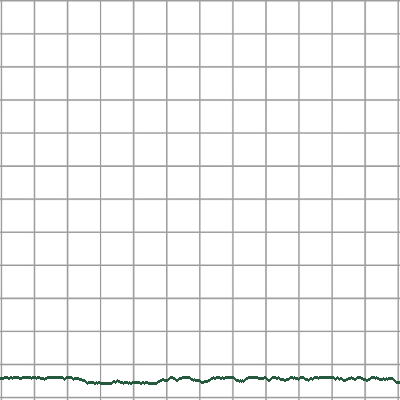

pitch69_thick0_color1_0_validation.png


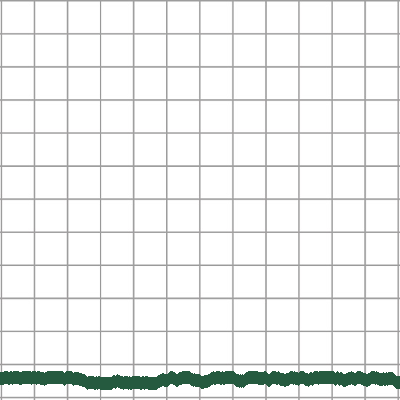

pitch69_thick1_color1_0_validation.png


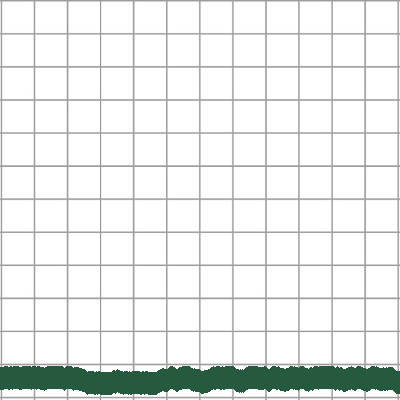

pitch69_thick2_color1_0_validation.png


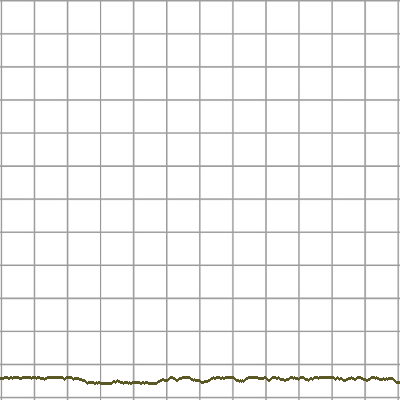

pitch69_thick0_color2_0_validation.png


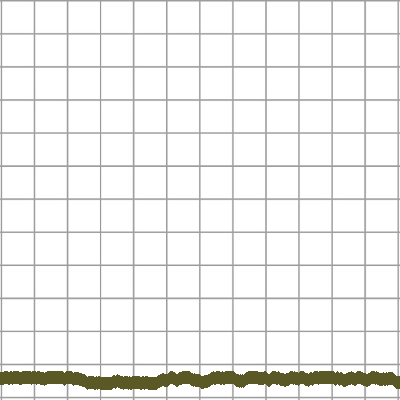

pitch69_thick1_color2_0_validation.png


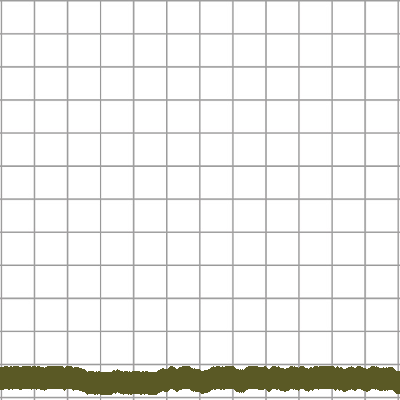

pitch69_thick2_color2_0_validation.png


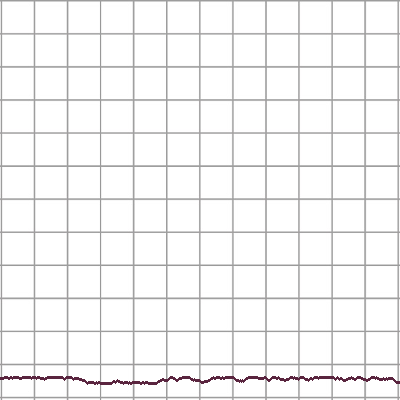

pitch69_thick0_color3_0_validation.png


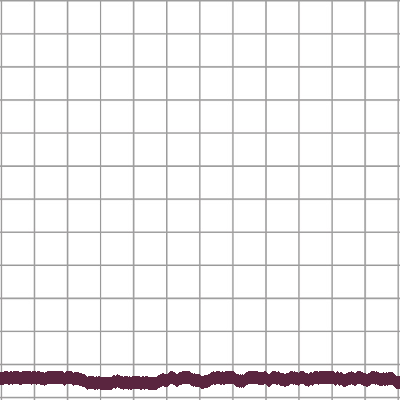

pitch69_thick1_color3_0_validation.png


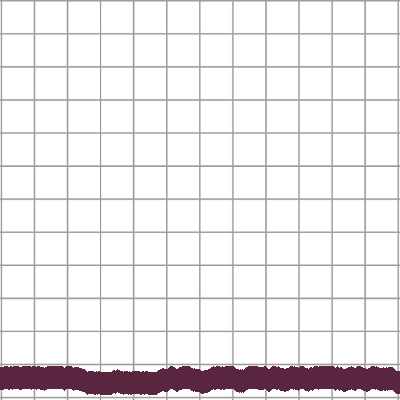

pitch69_thick2_color3_0_validation.png


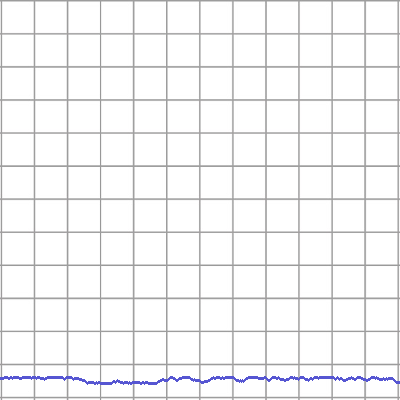

pitch69_thick0_color4_0_validation.png


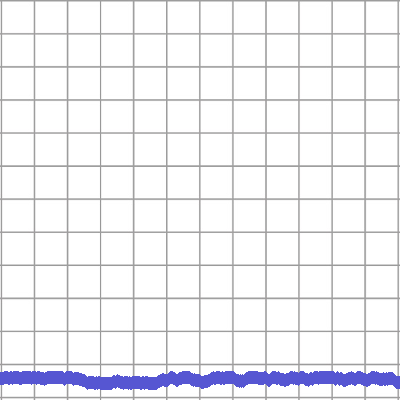

pitch69_thick1_color4_0_validation.png


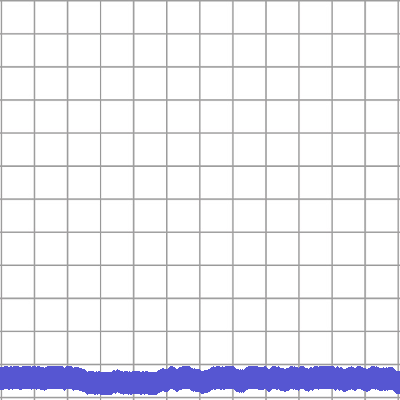

pitch69_thick2_color4_0_validation.png


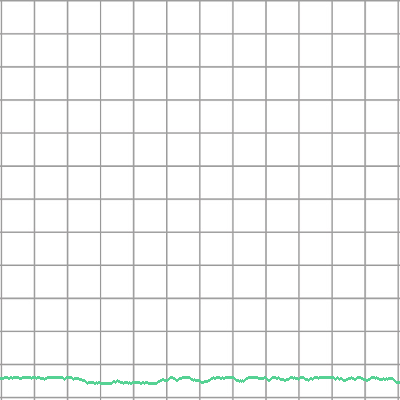

pitch69_thick0_color5_0_validation.png


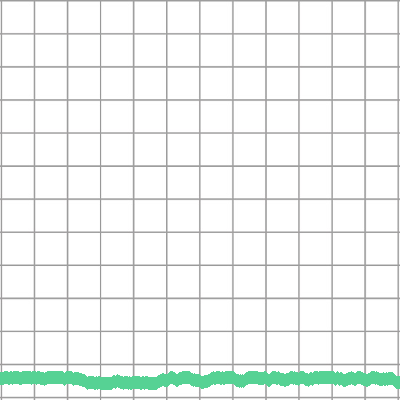

pitch69_thick1_color5_0_validation.png


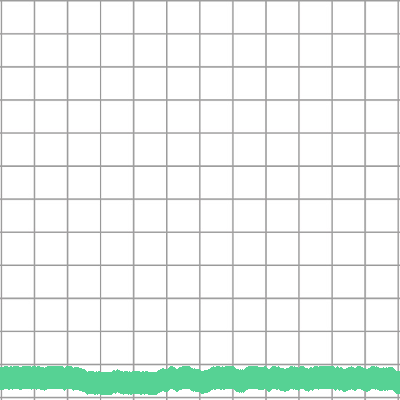

pitch69_thick2_color5_0_validation.png


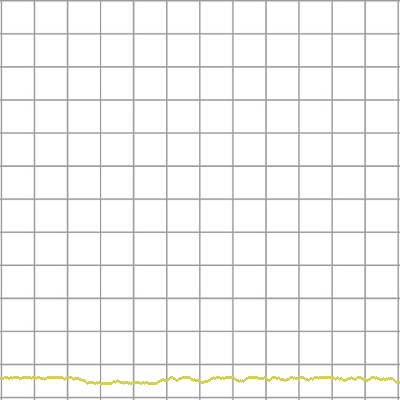

pitch69_thick0_color6_0_validation.png


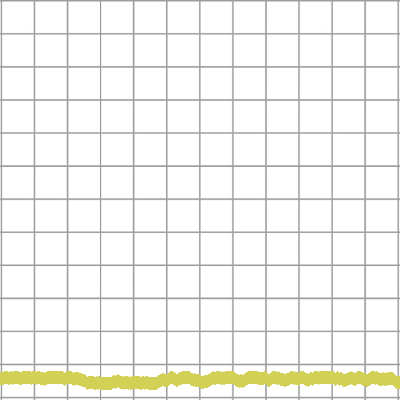

pitch69_thick1_color6_0_validation.png


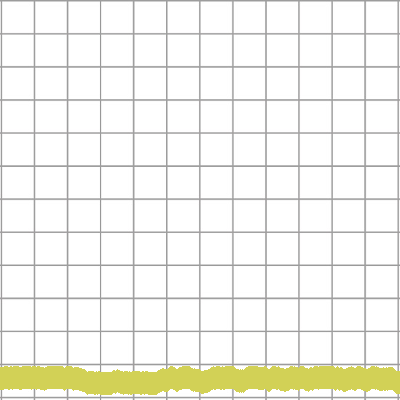

pitch69_thick2_color6_0_validation.png


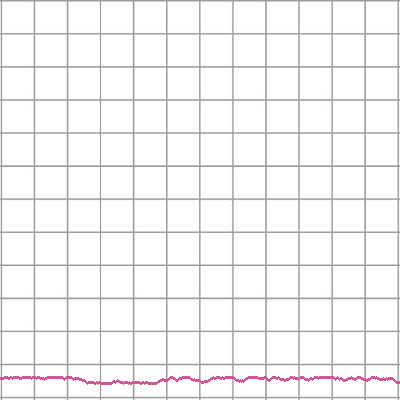

pitch69_thick0_color7_0_validation.png


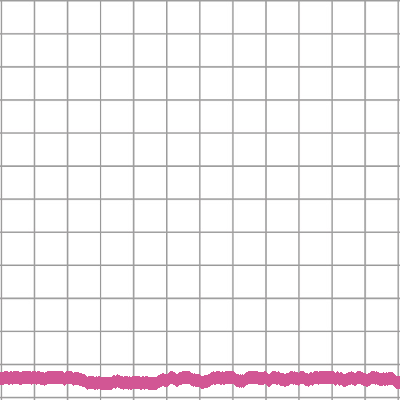

pitch69_thick1_color7_0_validation.png


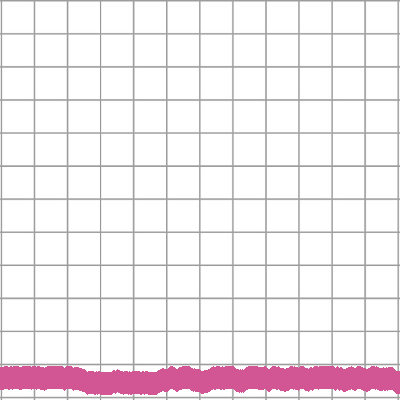

pitch69_thick2_color7_0_validation.png


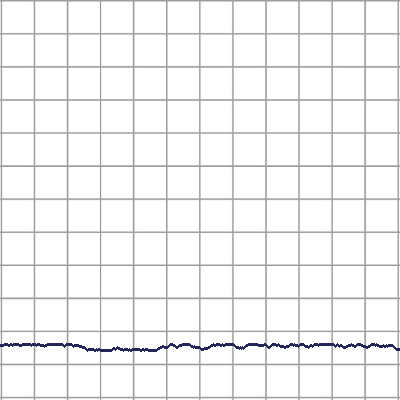

pitch70_thick0_color0_0_validation.png


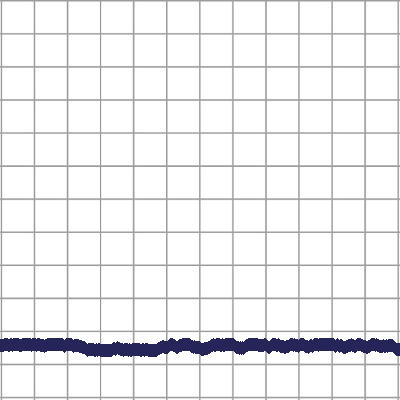

pitch70_thick1_color0_0_validation.png


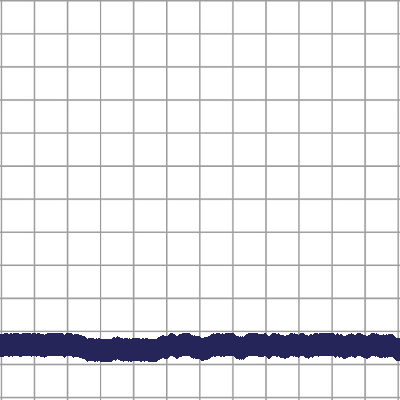

pitch70_thick2_color0_0_validation.png


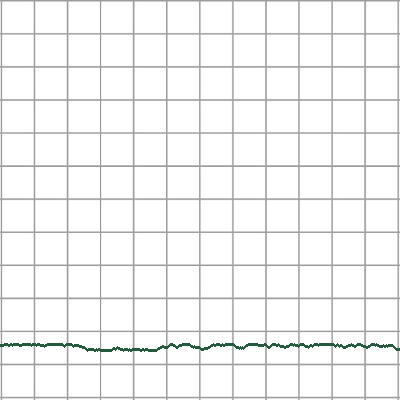

pitch70_thick0_color1_0_validation.png


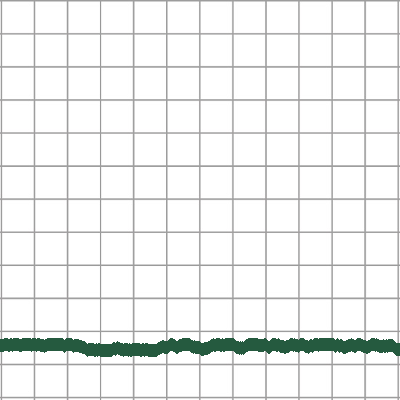

pitch70_thick1_color1_0_validation.png


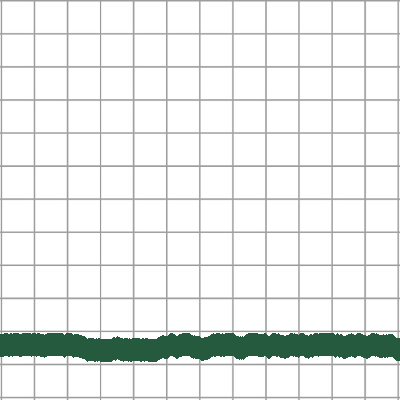

pitch70_thick2_color1_0_validation.png


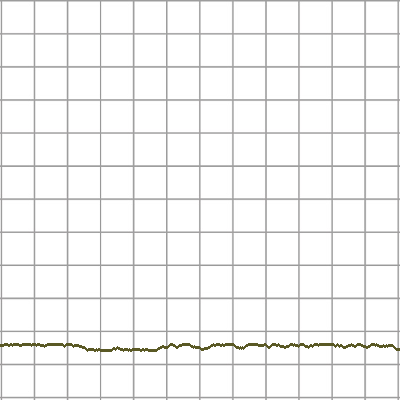

pitch70_thick0_color2_0_validation.png


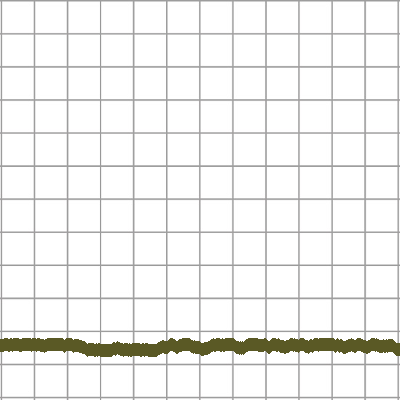

pitch70_thick1_color2_0_validation.png


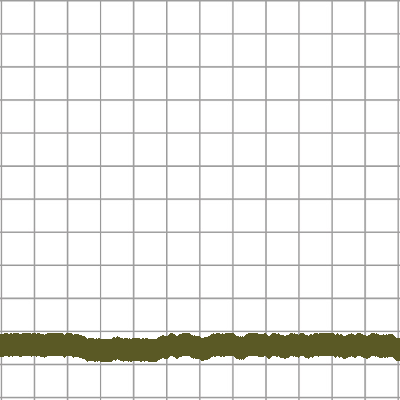

pitch70_thick2_color2_0_validation.png


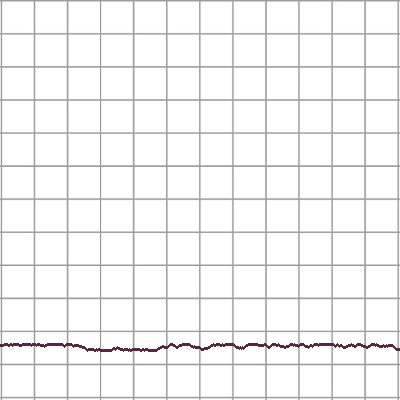

pitch70_thick0_color3_0_validation.png


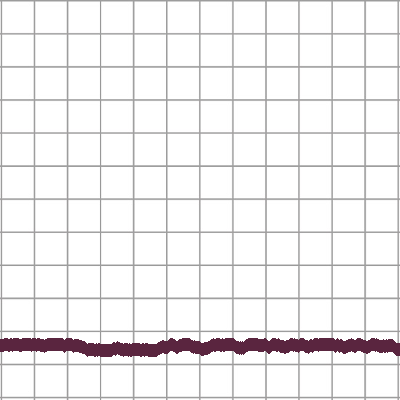

pitch70_thick1_color3_0_validation.png


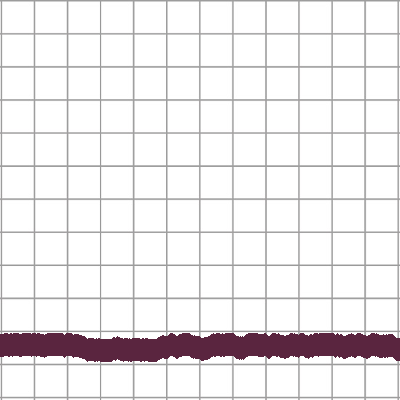

pitch70_thick2_color3_0_validation.png


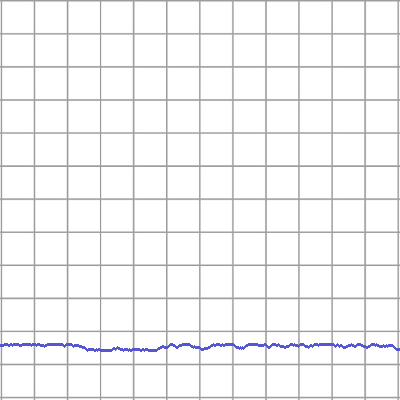

pitch70_thick0_color4_0_validation.png


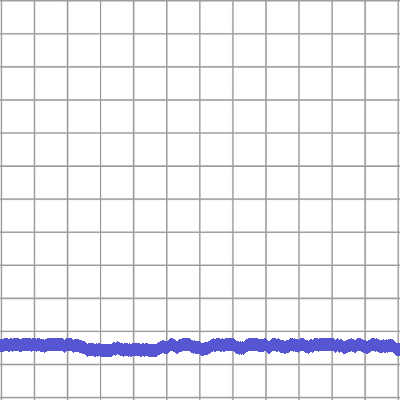

pitch70_thick1_color4_0_validation.png


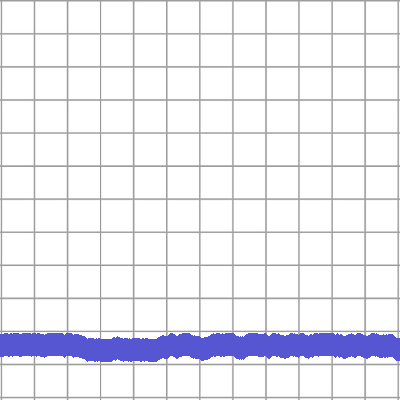

pitch70_thick2_color4_0_validation.png


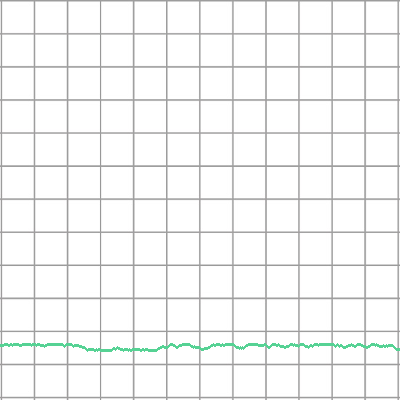

pitch70_thick0_color5_0_validation.png


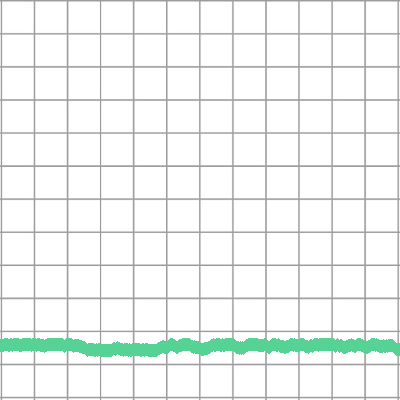

pitch70_thick1_color5_0_validation.png


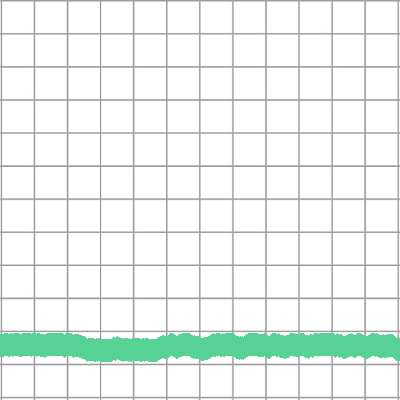

pitch70_thick2_color5_0_validation.png


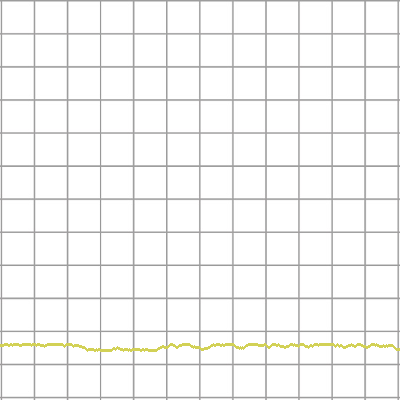

pitch70_thick0_color6_0_validation.png


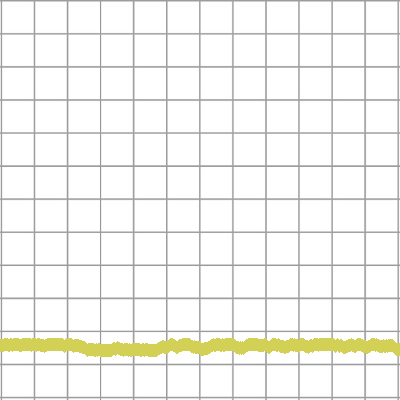

pitch70_thick1_color6_0_validation.png


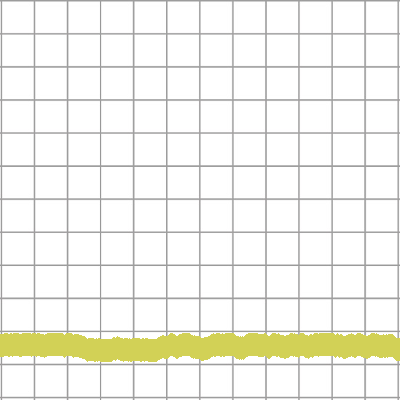

pitch70_thick2_color6_0_validation.png


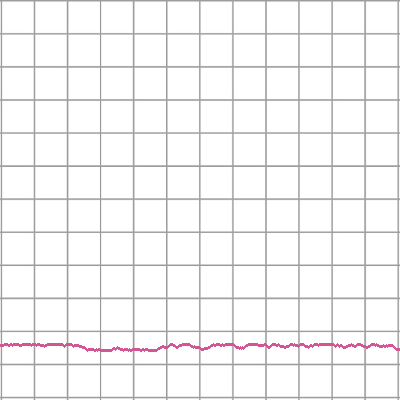

pitch70_thick0_color7_0_validation.png


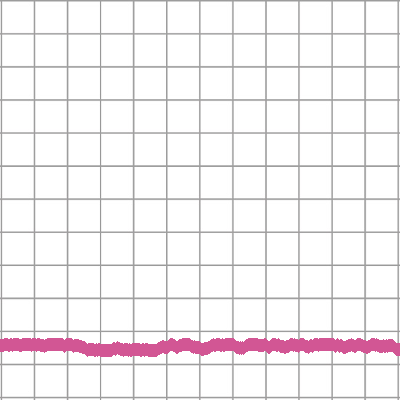

pitch70_thick1_color7_0_validation.png


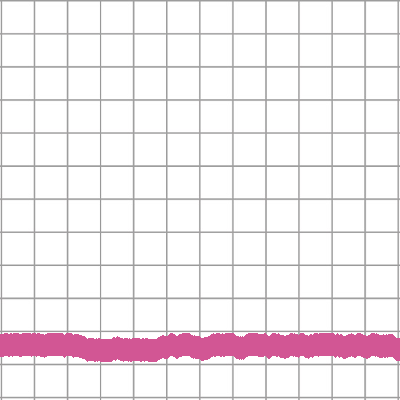

pitch70_thick2_color7_0_validation.png


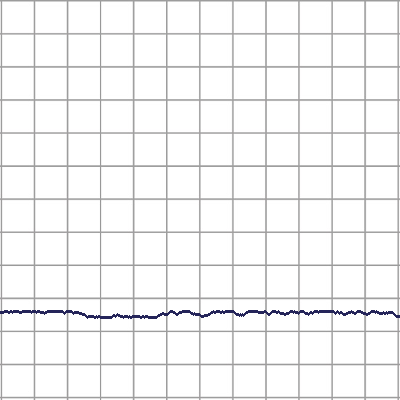

pitch71_thick0_color0_0_validation.png


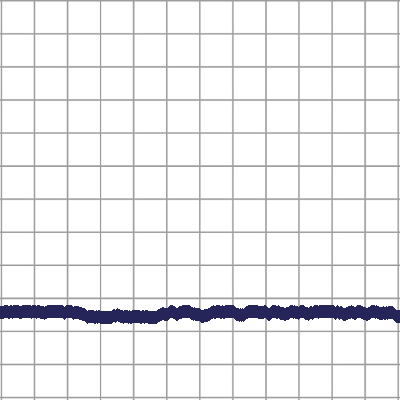

pitch71_thick1_color0_0_validation.png


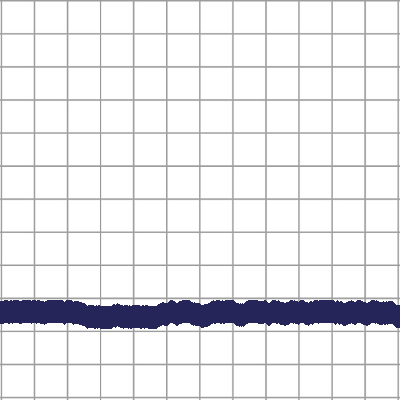

pitch71_thick2_color0_0_validation.png


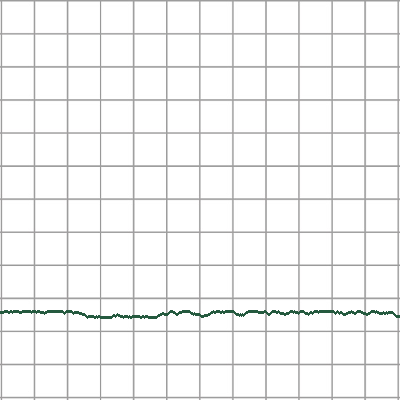

pitch71_thick0_color1_0_validation.png


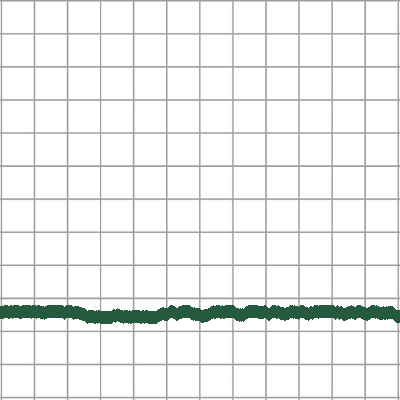

pitch71_thick1_color1_0_validation.png


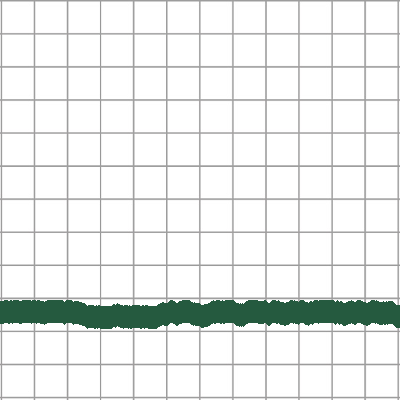

pitch71_thick2_color1_0_validation.png


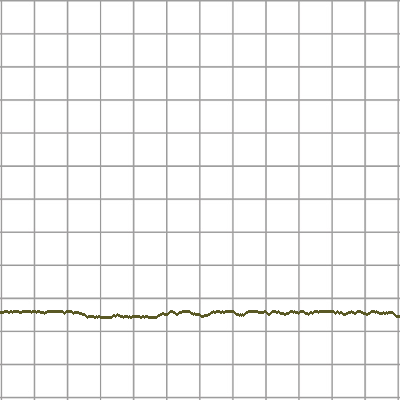

pitch71_thick0_color2_0_validation.png


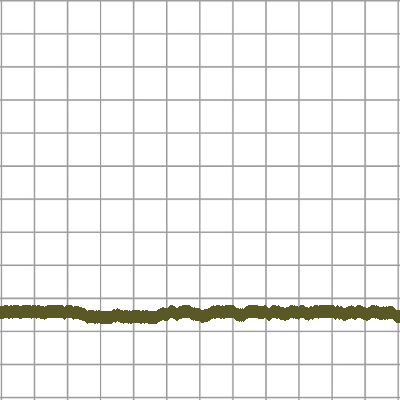

pitch71_thick1_color2_0_validation.png


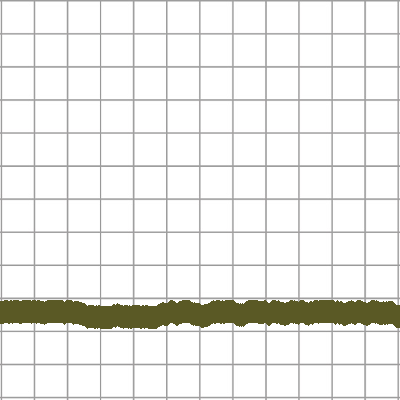

pitch71_thick2_color2_0_validation.png


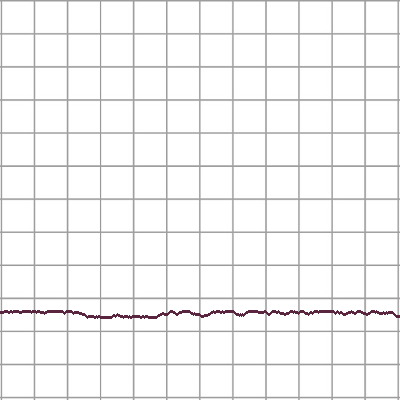

pitch71_thick0_color3_0_validation.png


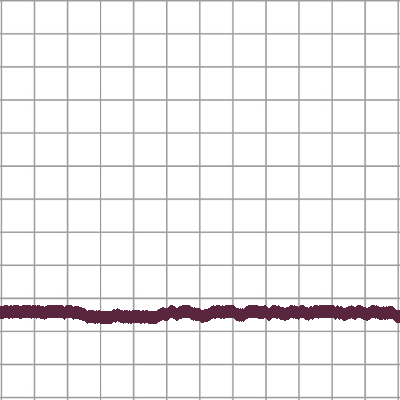

pitch71_thick1_color3_0_validation.png


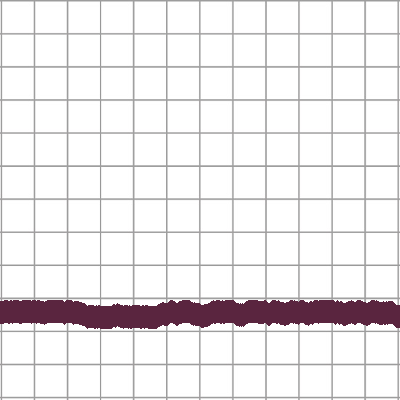

pitch71_thick2_color3_0_validation.png


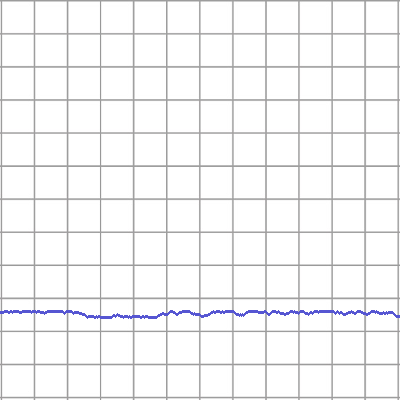

pitch71_thick0_color4_0_validation.png


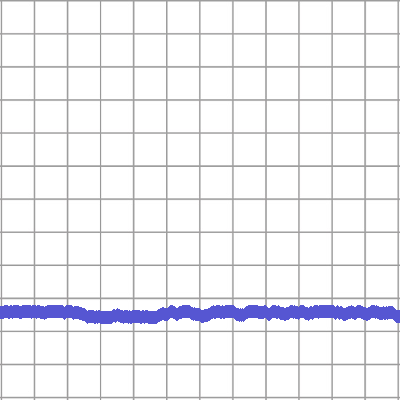

pitch71_thick1_color4_0_validation.png


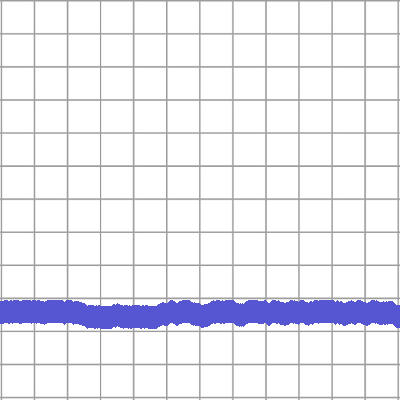

pitch71_thick2_color4_0_validation.png


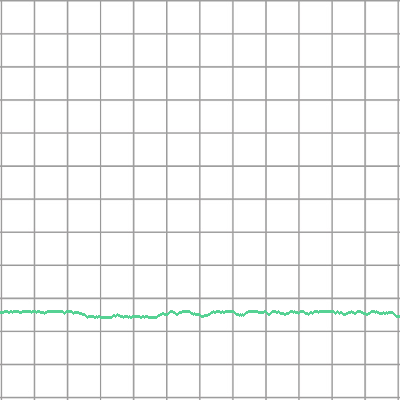

pitch71_thick0_color5_0_validation.png


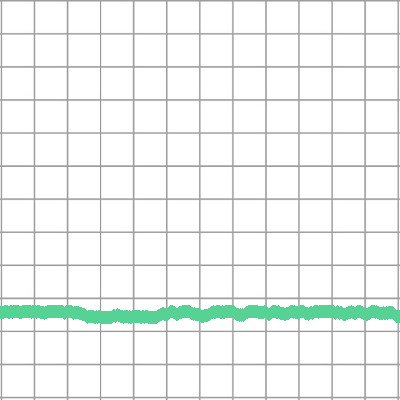

pitch71_thick1_color5_0_validation.png


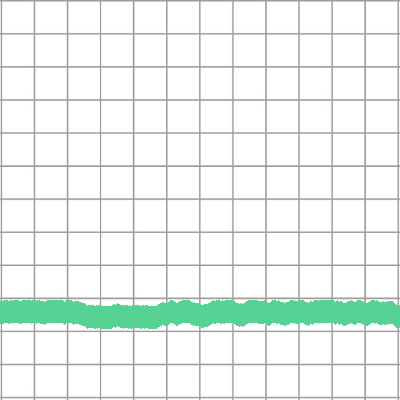

pitch71_thick2_color5_0_validation.png


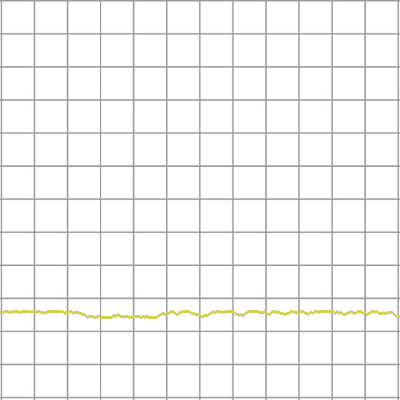

pitch71_thick0_color6_0_validation.png


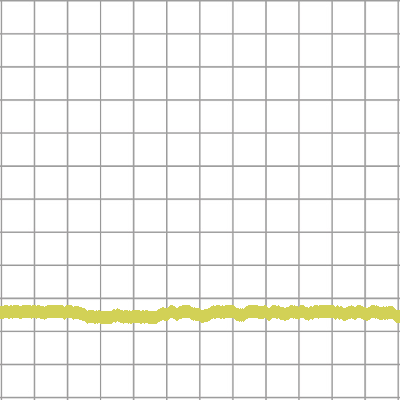

pitch71_thick1_color6_0_validation.png


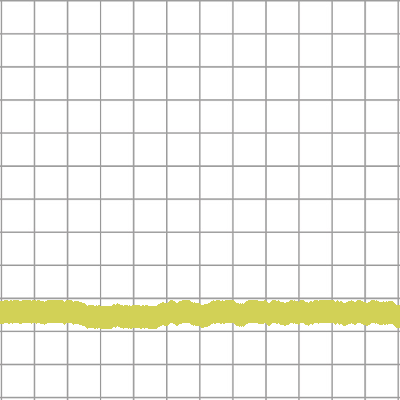

pitch71_thick2_color6_0_validation.png


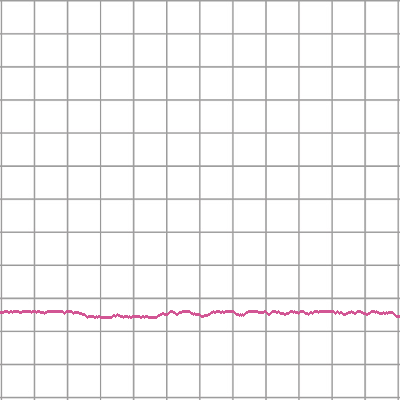

pitch71_thick0_color7_0_validation.png


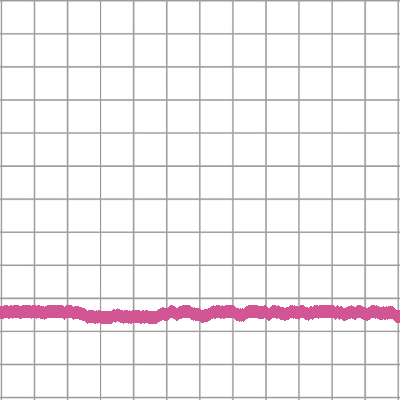

pitch71_thick1_color7_0_validation.png


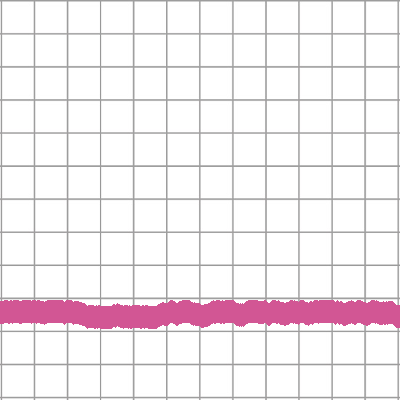

pitch71_thick2_color7_0_validation.png


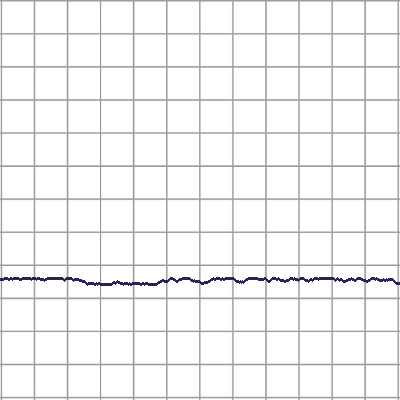

pitch72_thick0_color0_0_validation.png


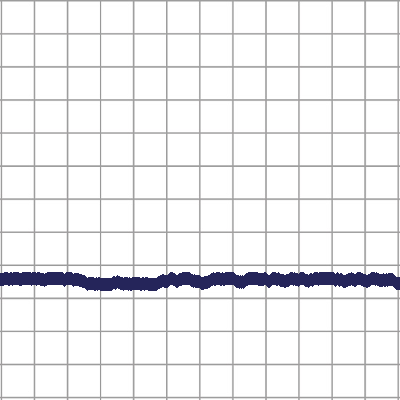

pitch72_thick1_color0_0_validation.png


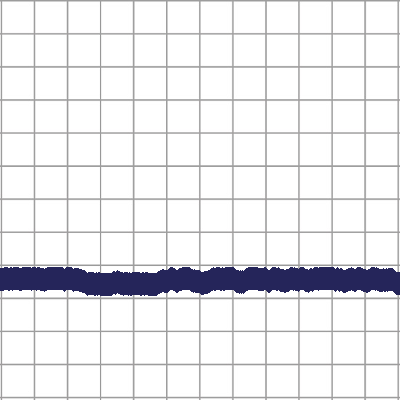

pitch72_thick2_color0_0_validation.png


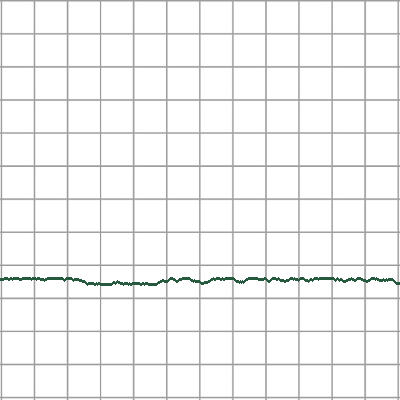

pitch72_thick0_color1_0_validation.png


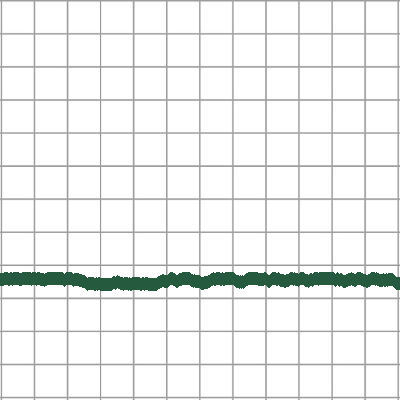

pitch72_thick1_color1_0_validation.png


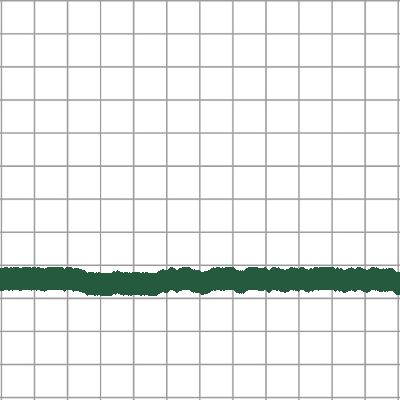

pitch72_thick2_color1_0_validation.png


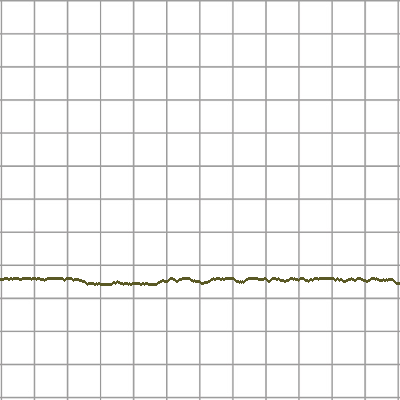

pitch72_thick0_color2_0_validation.png


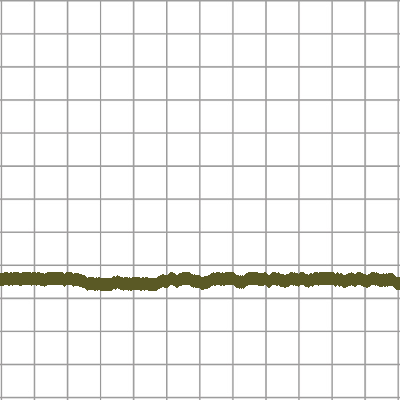

pitch72_thick1_color2_0_validation.png


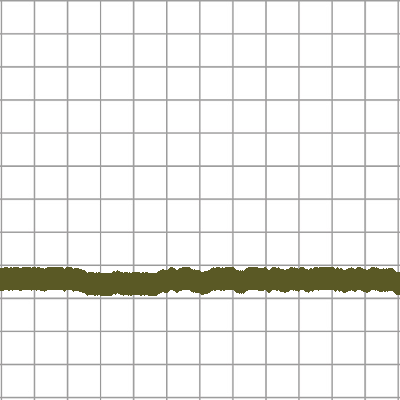

pitch72_thick2_color2_0_validation.png


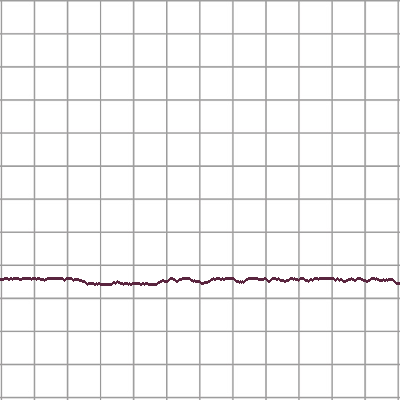

pitch72_thick0_color3_0_validation.png


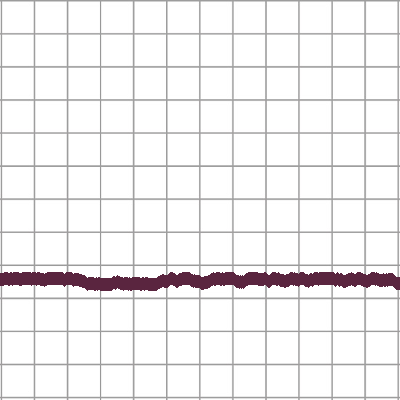

pitch72_thick1_color3_0_validation.png


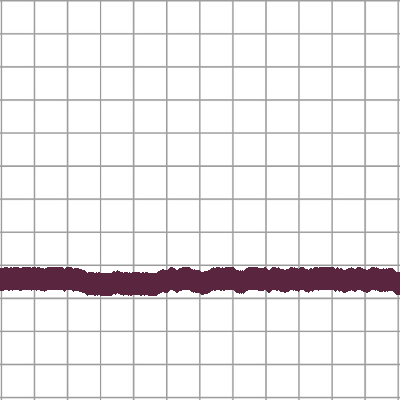

pitch72_thick2_color3_0_validation.png


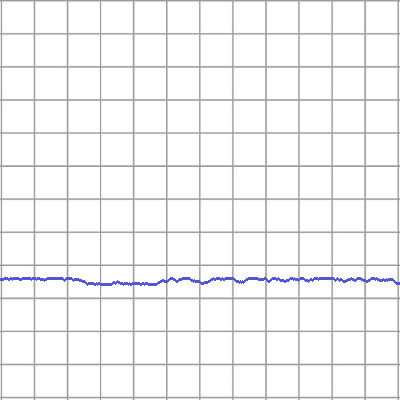

pitch72_thick0_color4_0_validation.png


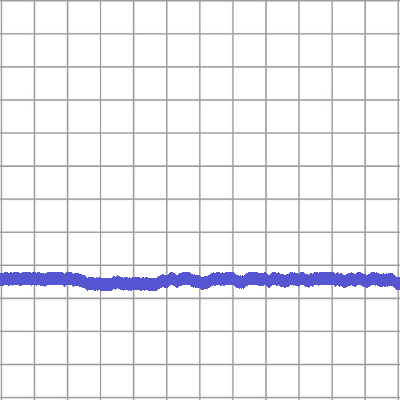

pitch72_thick1_color4_0_validation.png


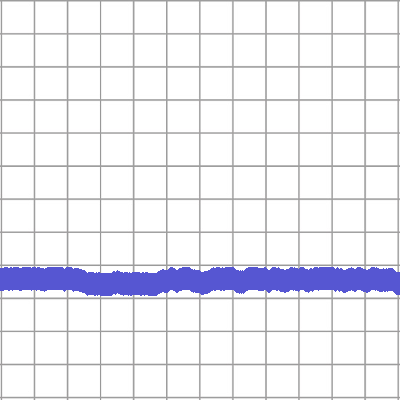

pitch72_thick2_color4_0_validation.png


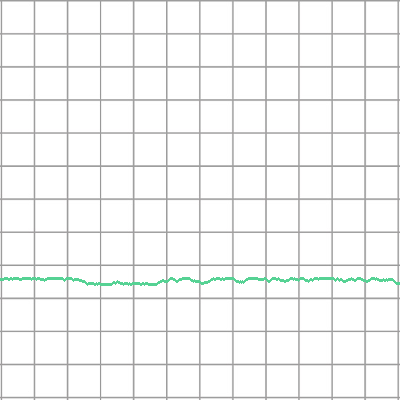

pitch72_thick0_color5_0_validation.png


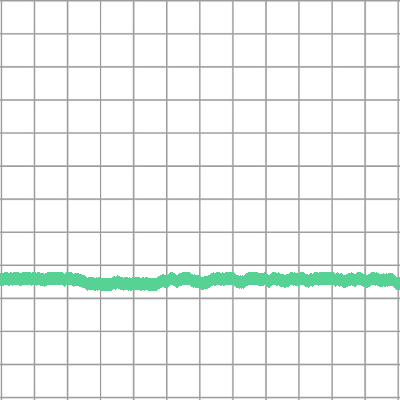

pitch72_thick1_color5_0_validation.png


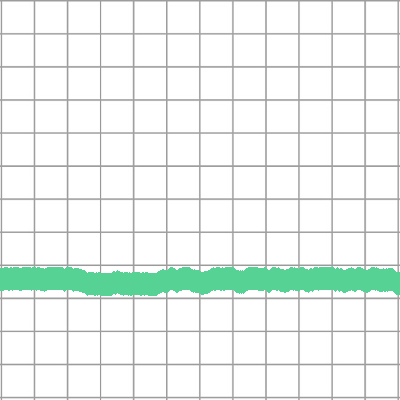

pitch72_thick2_color5_0_validation.png


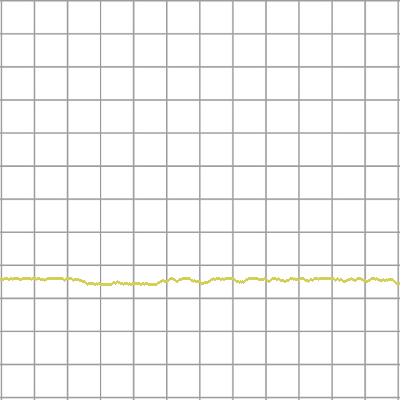

pitch72_thick0_color6_0_validation.png


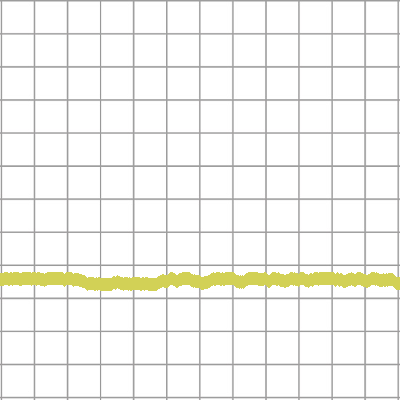

pitch72_thick1_color6_0_validation.png


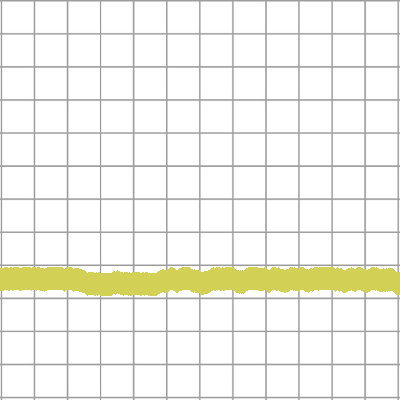

pitch72_thick2_color6_0_validation.png


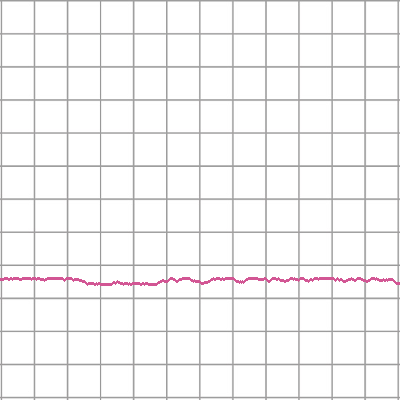

pitch72_thick0_color7_0_validation.png


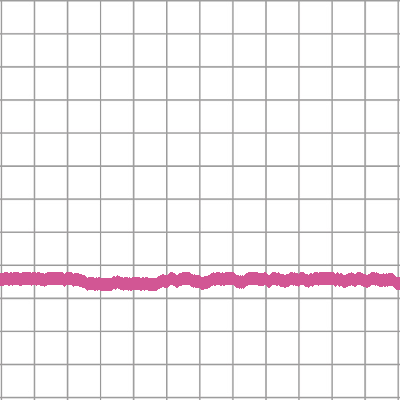

pitch72_thick1_color7_0_validation.png


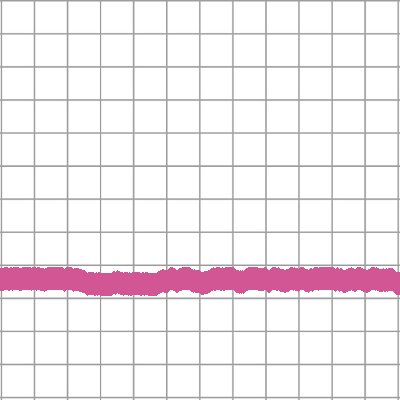

pitch72_thick2_color7_0_validation.png


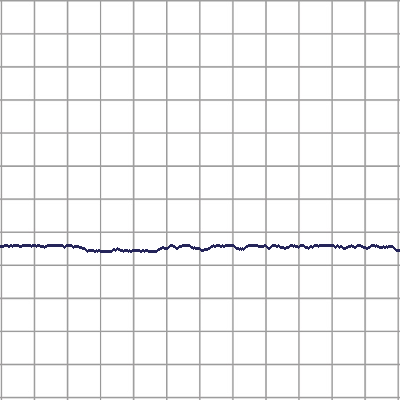

pitch73_thick0_color0_0_validation.png


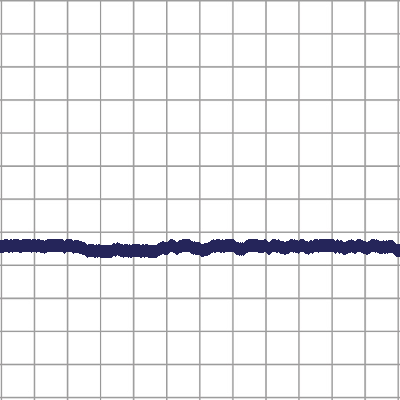

pitch73_thick1_color0_0_validation.png


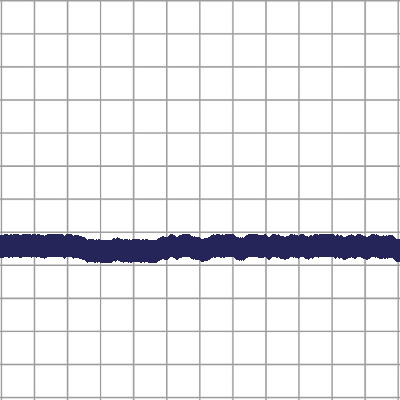

pitch73_thick2_color0_0_validation.png


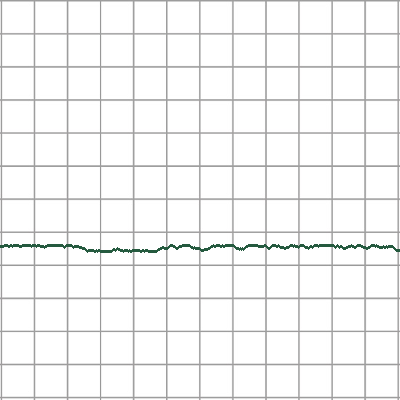

pitch73_thick0_color1_0_validation.png


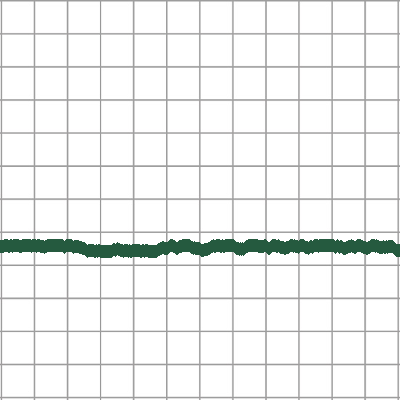

pitch73_thick1_color1_0_validation.png


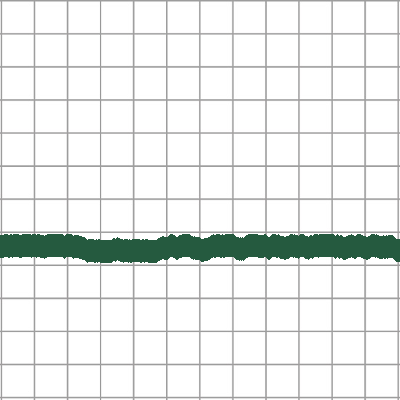

pitch73_thick2_color1_0_validation.png


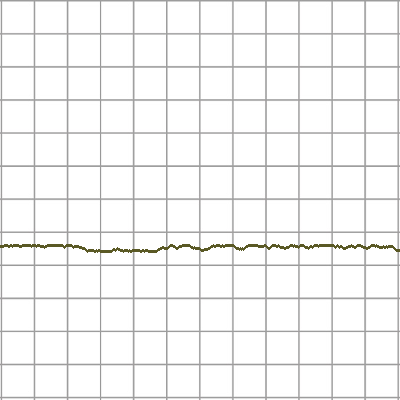

pitch73_thick0_color2_0_validation.png


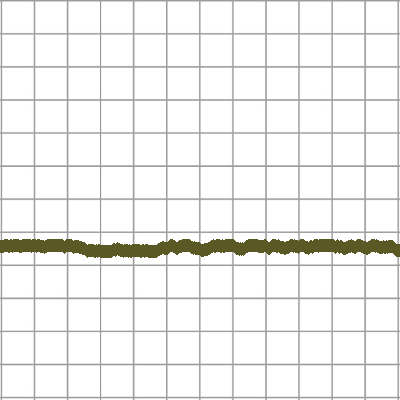

pitch73_thick1_color2_0_validation.png


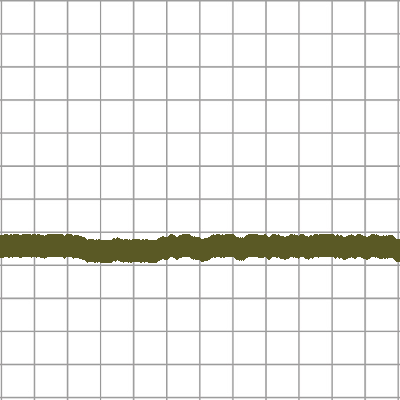

pitch73_thick2_color2_0_validation.png


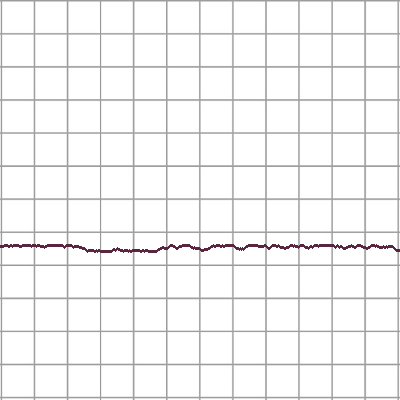

pitch73_thick0_color3_0_validation.png


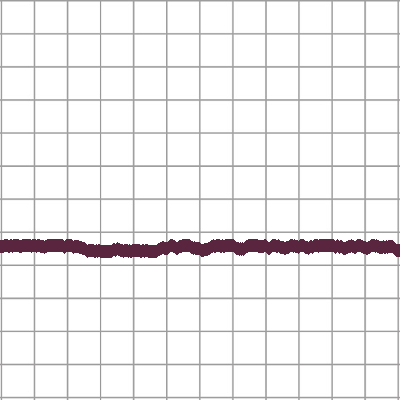

pitch73_thick1_color3_0_validation.png


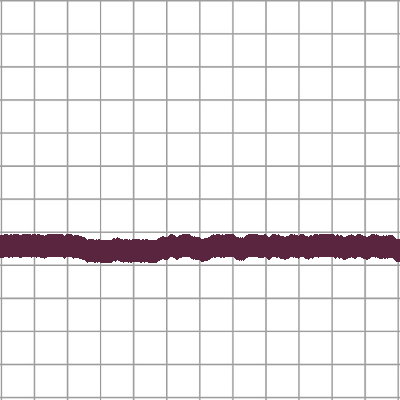

pitch73_thick2_color3_0_validation.png


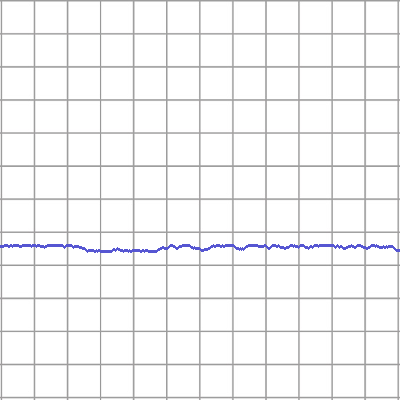

pitch73_thick0_color4_0_validation.png


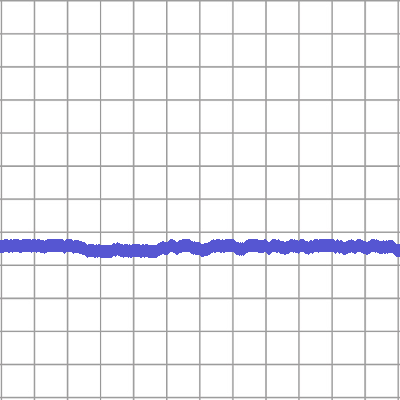

pitch73_thick1_color4_0_validation.png


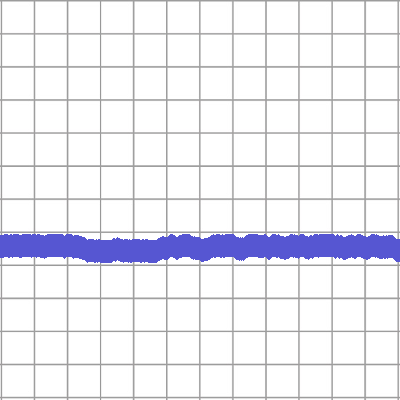

pitch73_thick2_color4_0_validation.png


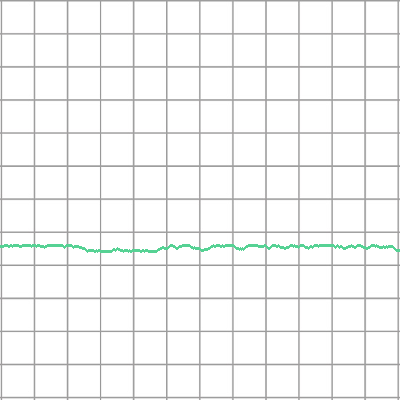

pitch73_thick0_color5_0_validation.png


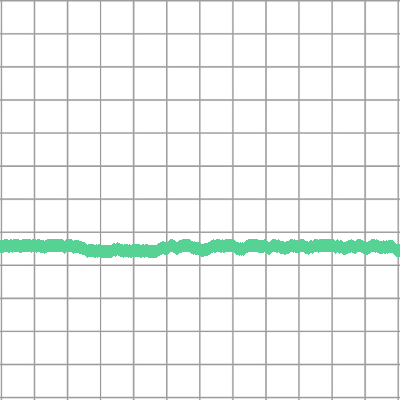

pitch73_thick1_color5_0_validation.png


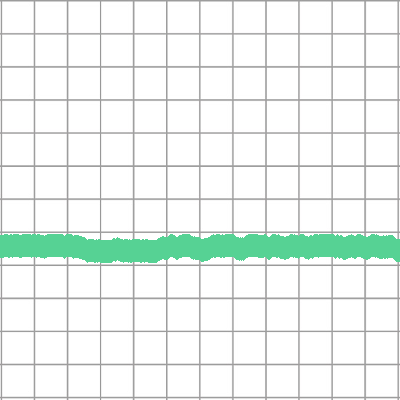

pitch73_thick2_color5_0_validation.png


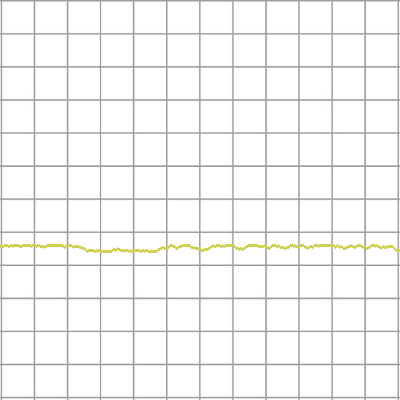

pitch73_thick0_color6_0_validation.png


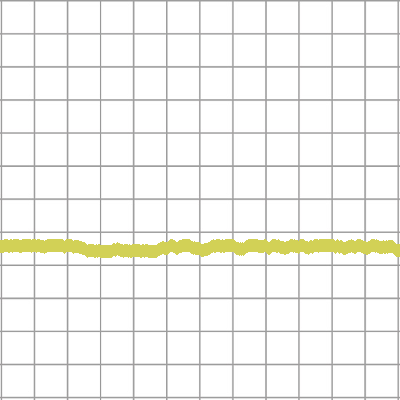

pitch73_thick1_color6_0_validation.png


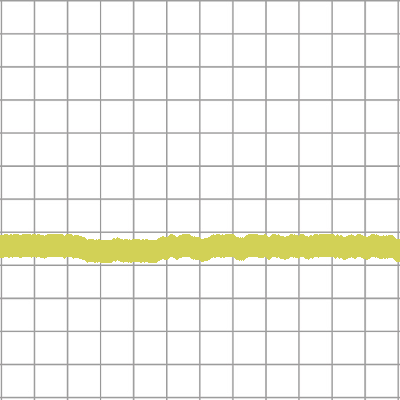

pitch73_thick2_color6_0_validation.png


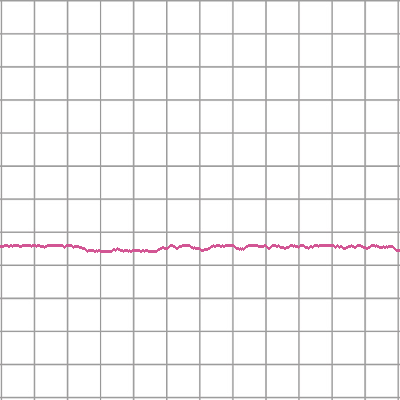

pitch73_thick0_color7_0_validation.png


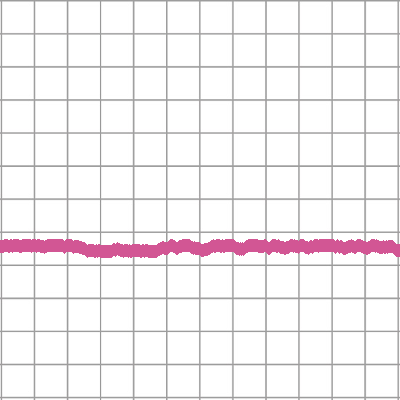

pitch73_thick1_color7_0_validation.png


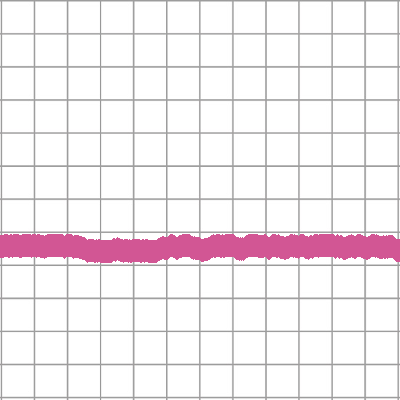

pitch73_thick2_color7_0_validation.png


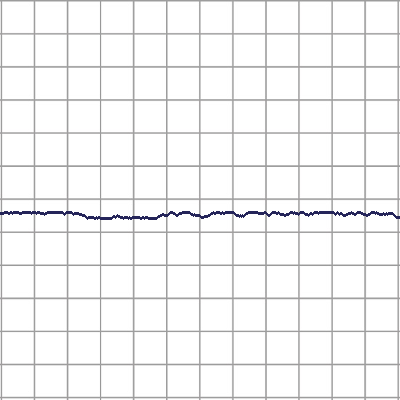

pitch74_thick0_color0_0_validation.png


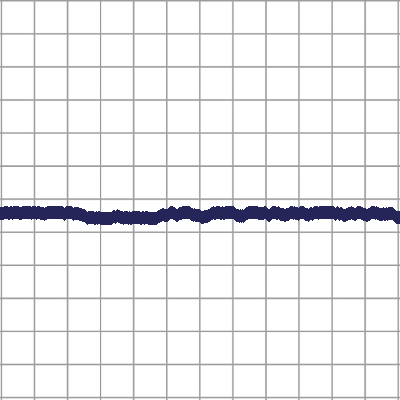

pitch74_thick1_color0_0_validation.png


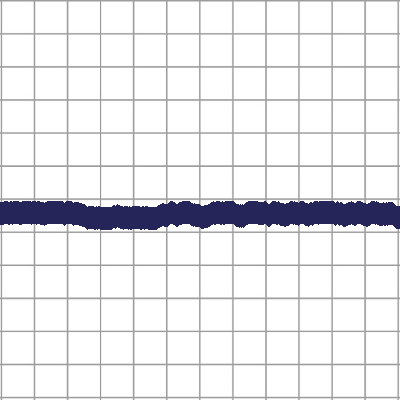

pitch74_thick2_color0_0_validation.png


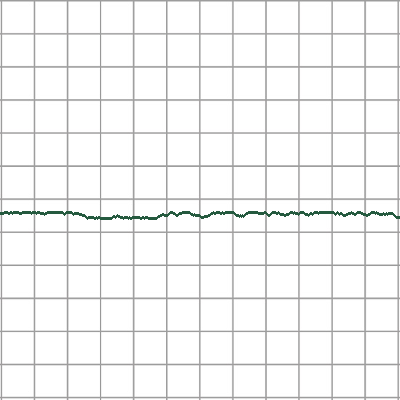

pitch74_thick0_color1_0_validation.png


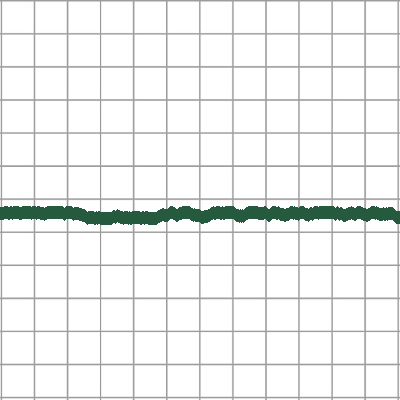

pitch74_thick1_color1_0_validation.png


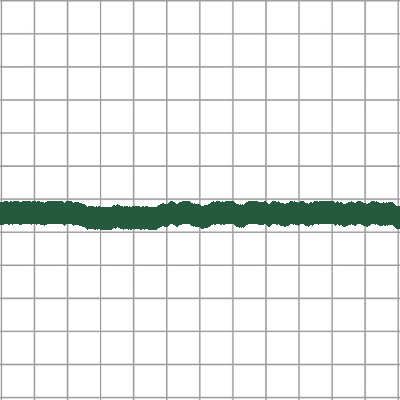

pitch74_thick2_color1_0_validation.png


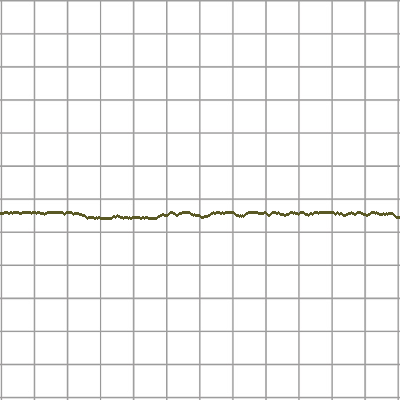

pitch74_thick0_color2_0_validation.png


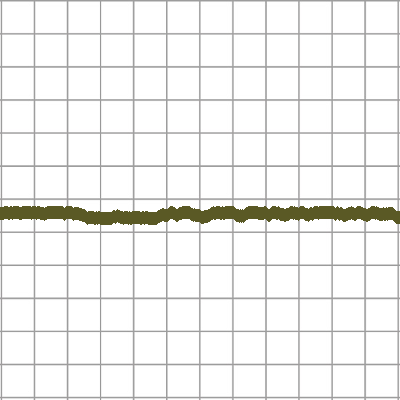

pitch74_thick1_color2_0_validation.png


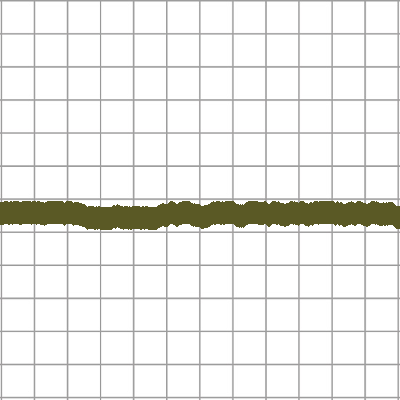

pitch74_thick2_color2_0_validation.png


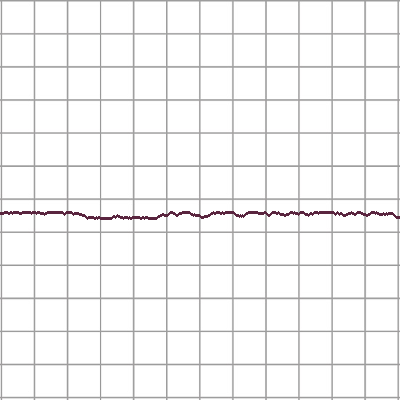

pitch74_thick0_color3_0_validation.png


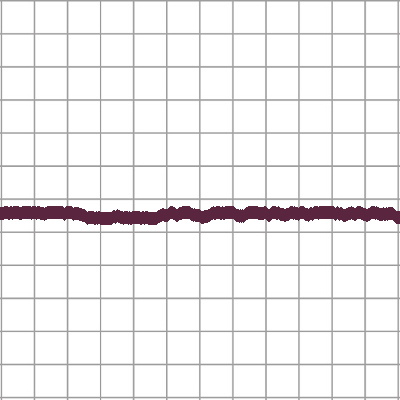

pitch74_thick1_color3_0_validation.png


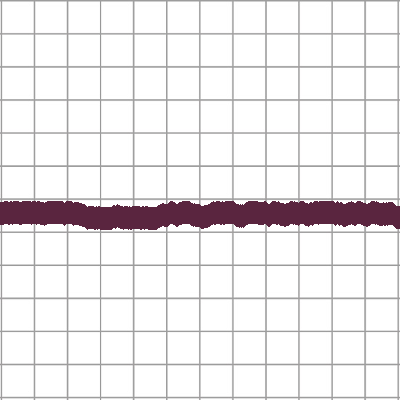

pitch74_thick2_color3_0_validation.png


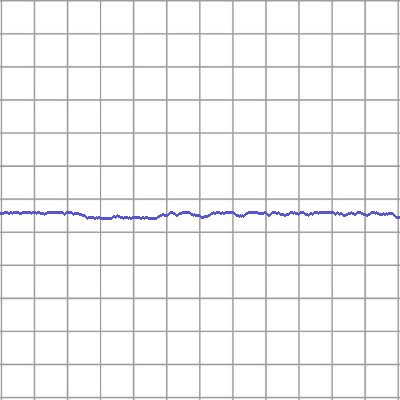

pitch74_thick0_color4_0_validation.png


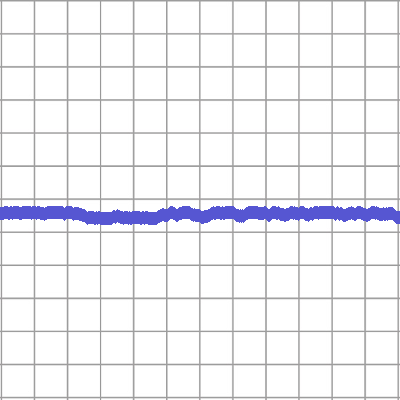

pitch74_thick1_color4_0_validation.png


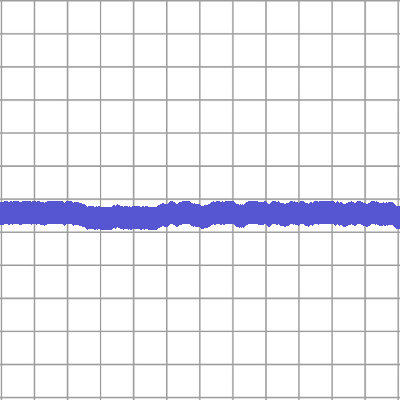

pitch74_thick2_color4_0_validation.png


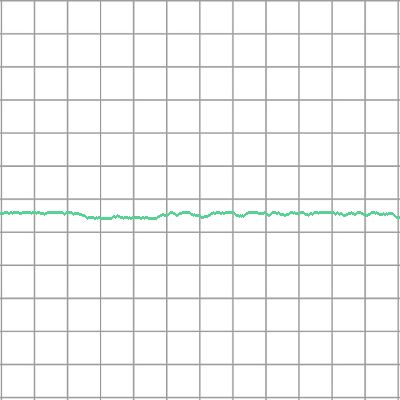

pitch74_thick0_color5_0_validation.png


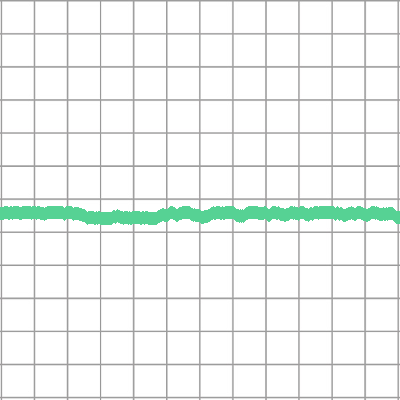

pitch74_thick1_color5_0_validation.png


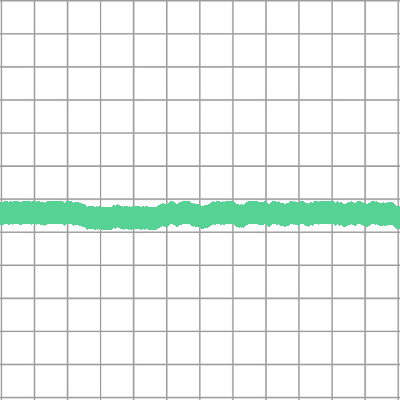

pitch74_thick2_color5_0_validation.png


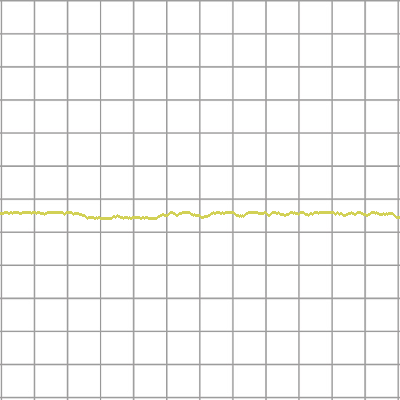

pitch74_thick0_color6_0_validation.png


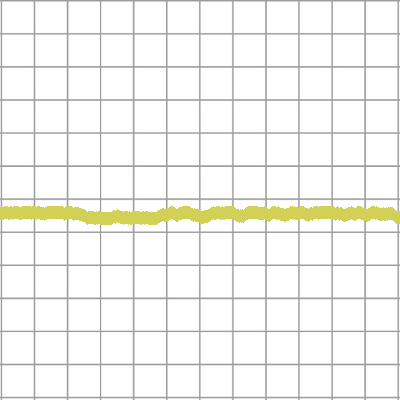

pitch74_thick1_color6_0_validation.png


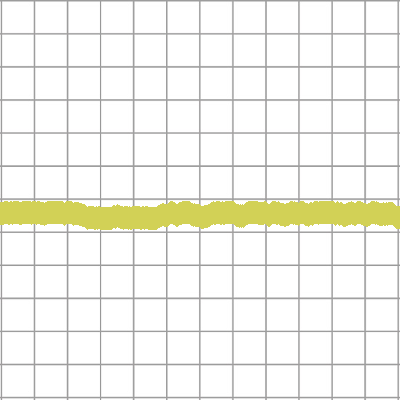

pitch74_thick2_color6_0_validation.png


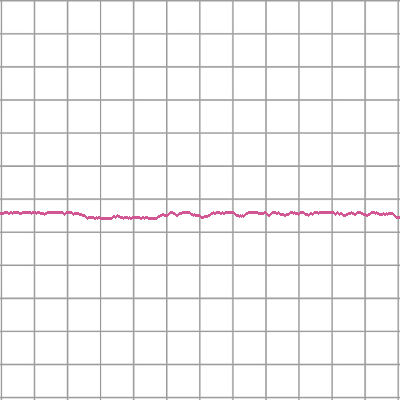

pitch74_thick0_color7_0_validation.png


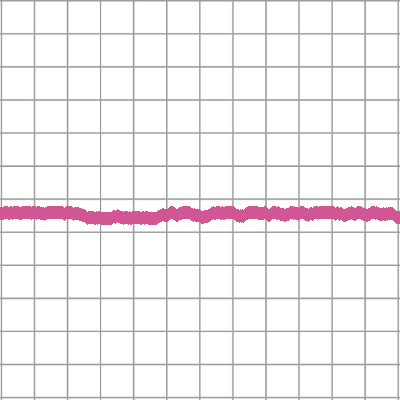

pitch74_thick1_color7_0_validation.png


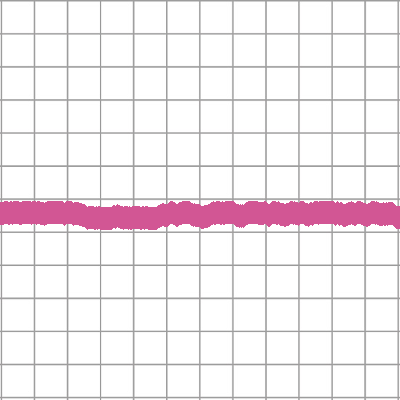

pitch74_thick2_color7_0_validation.png


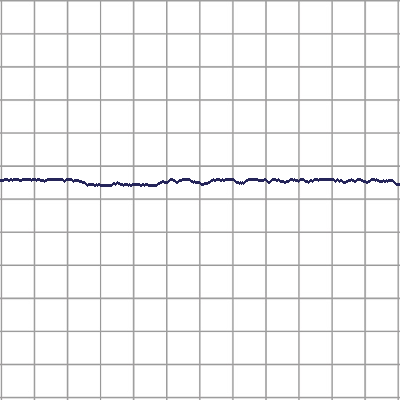

pitch75_thick0_color0_0_validation.png


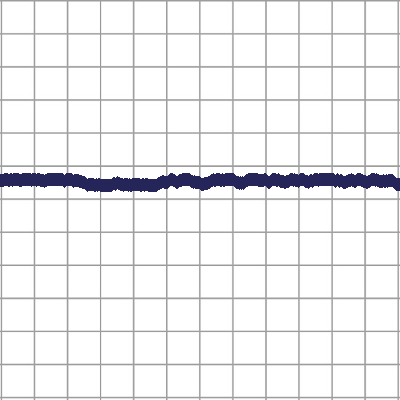

pitch75_thick1_color0_0_validation.png


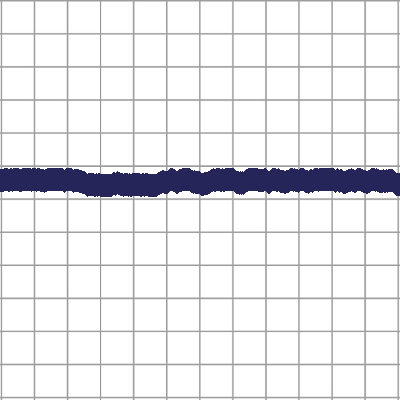

pitch75_thick2_color0_0_validation.png


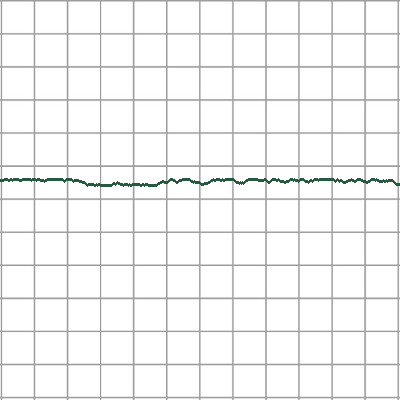

pitch75_thick0_color1_0_validation.png


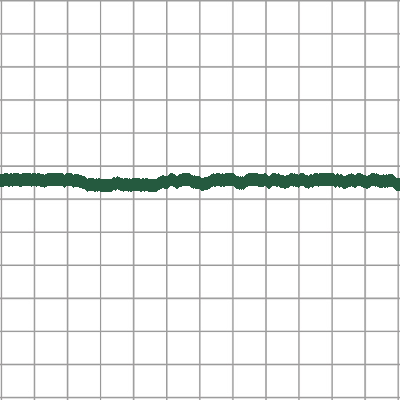

pitch75_thick1_color1_0_validation.png


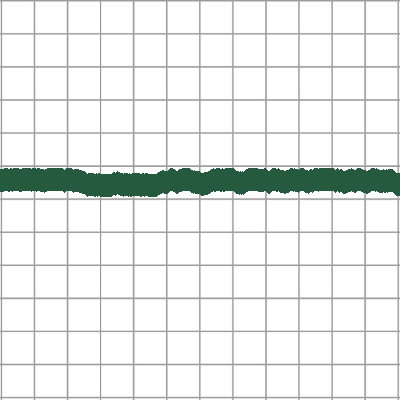

pitch75_thick2_color1_0_validation.png


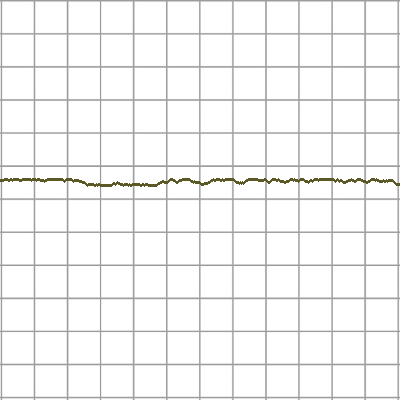

pitch75_thick0_color2_0_validation.png


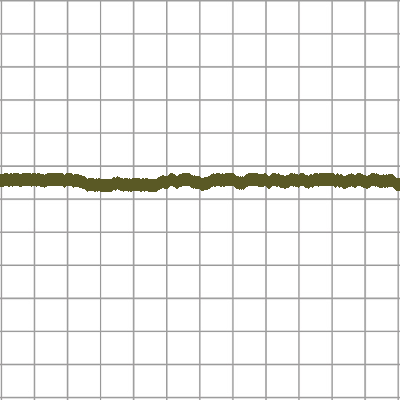

pitch75_thick1_color2_0_validation.png


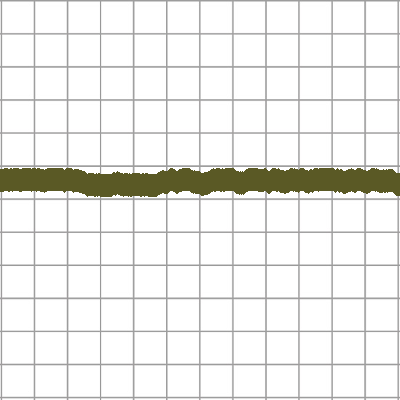

pitch75_thick2_color2_0_validation.png


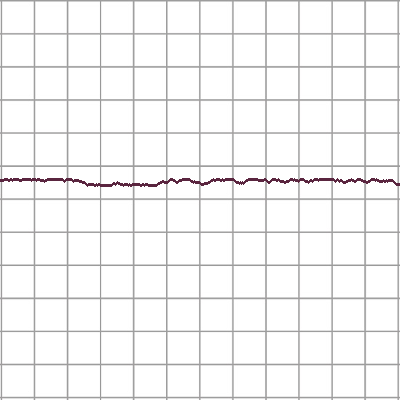

pitch75_thick0_color3_0_validation.png


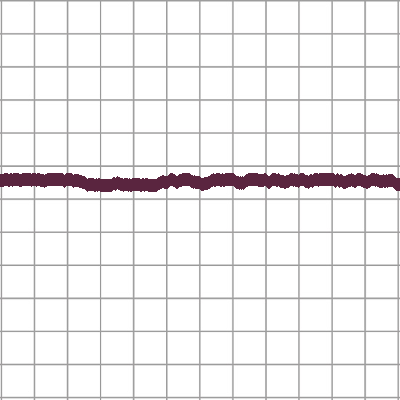

pitch75_thick1_color3_0_validation.png


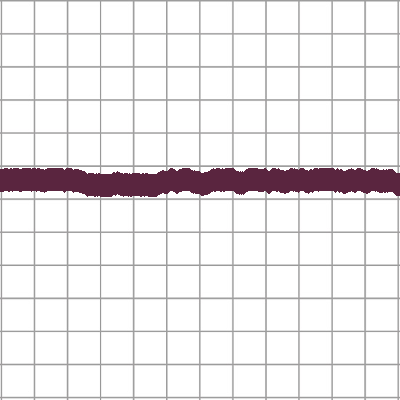

pitch75_thick2_color3_0_validation.png


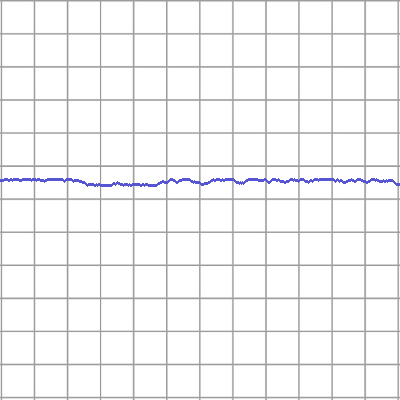

pitch75_thick0_color4_0_validation.png


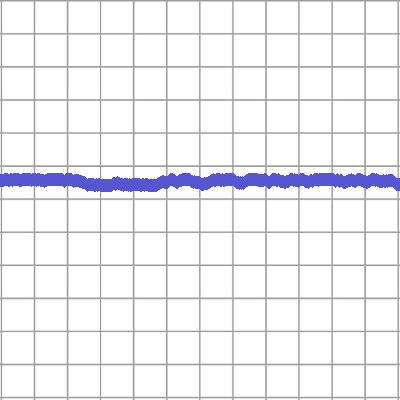

pitch75_thick1_color4_0_validation.png


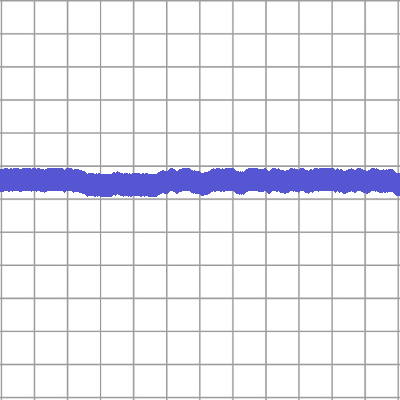

pitch75_thick2_color4_0_validation.png


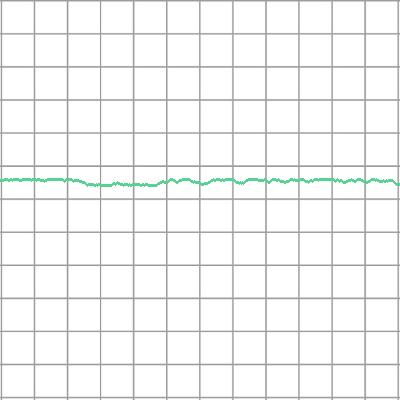

pitch75_thick0_color5_0_validation.png


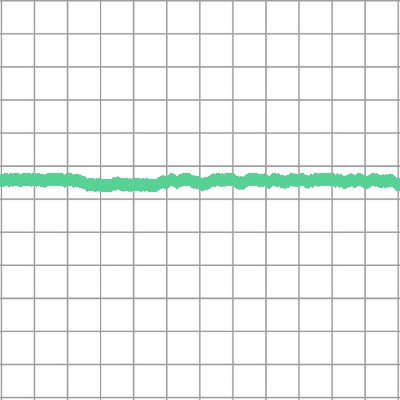

pitch75_thick1_color5_0_validation.png


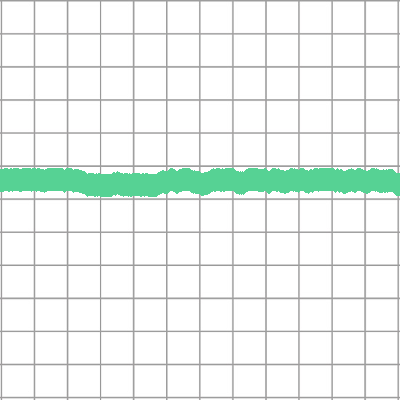

pitch75_thick2_color5_0_validation.png


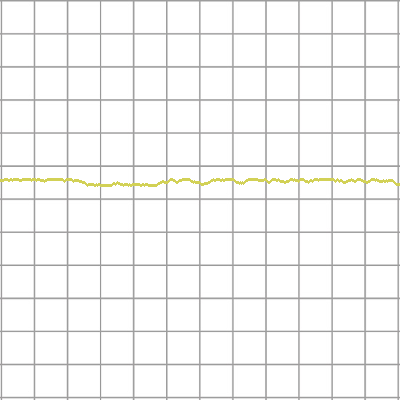

pitch75_thick0_color6_0_validation.png


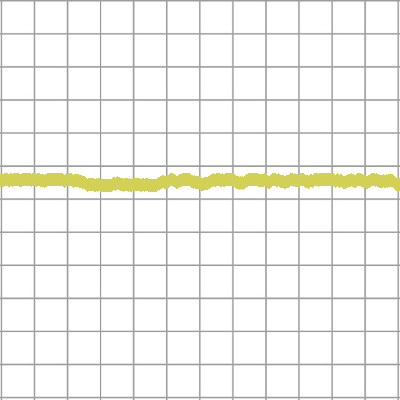

pitch75_thick1_color6_0_validation.png


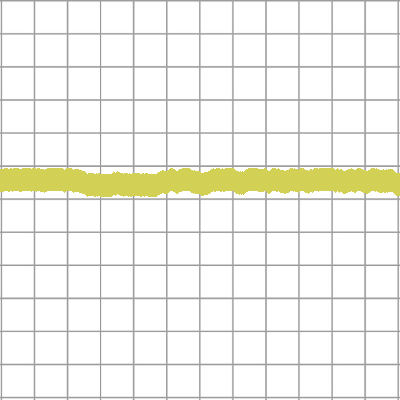

pitch75_thick2_color6_0_validation.png


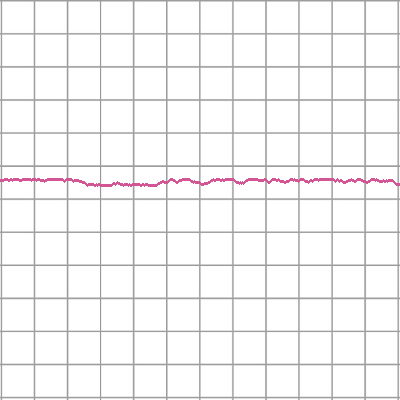

pitch75_thick0_color7_0_validation.png


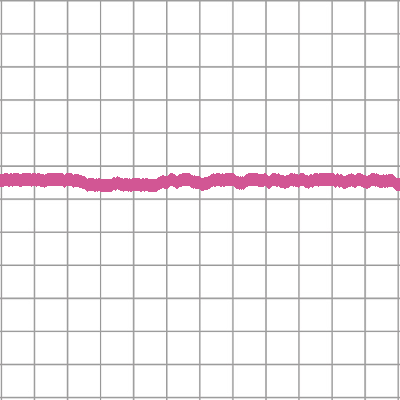

pitch75_thick1_color7_0_validation.png


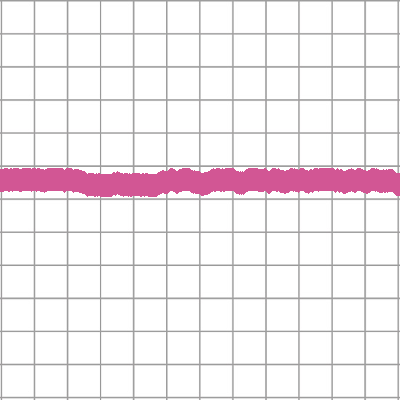

pitch75_thick2_color7_0_validation.png


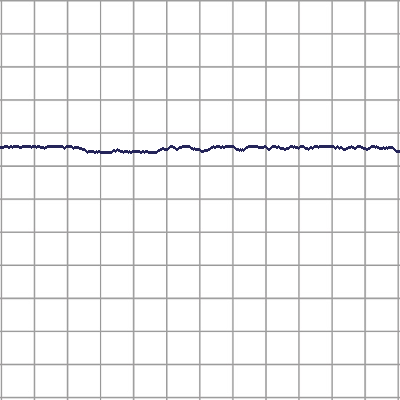

pitch76_thick0_color0_0_validation.png


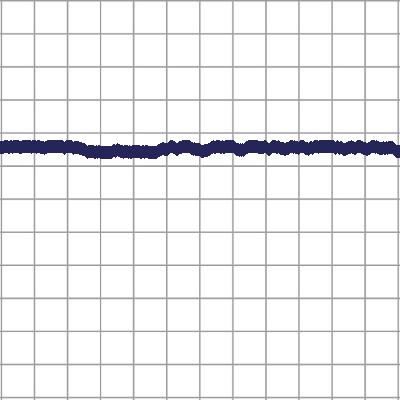

pitch76_thick1_color0_0_validation.png


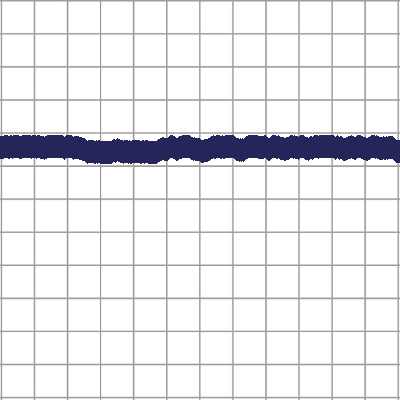

pitch76_thick2_color0_0_validation.png


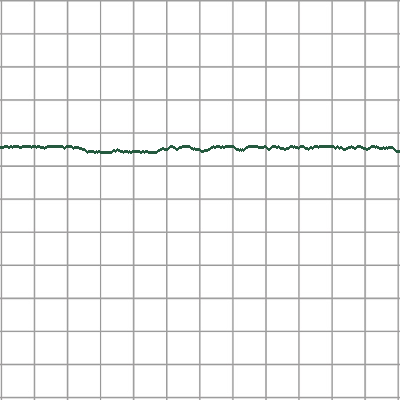

pitch76_thick0_color1_0_validation.png


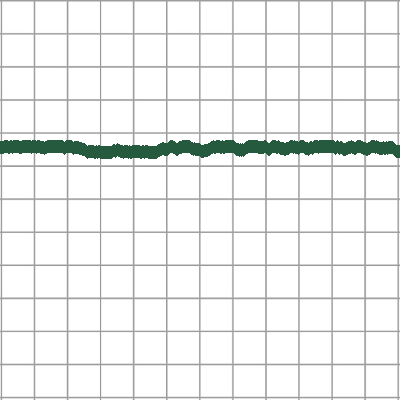

pitch76_thick1_color1_0_validation.png


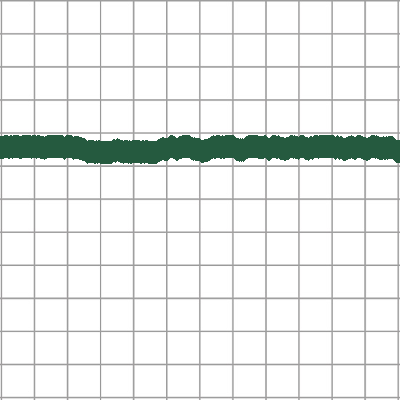

pitch76_thick2_color1_0_validation.png


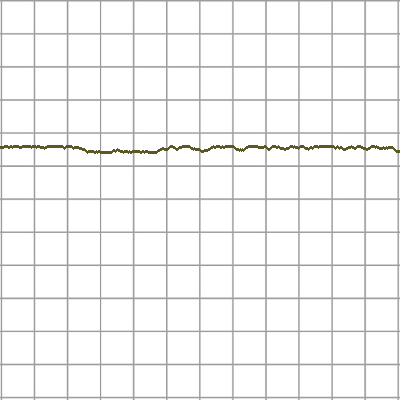

pitch76_thick0_color2_0_validation.png


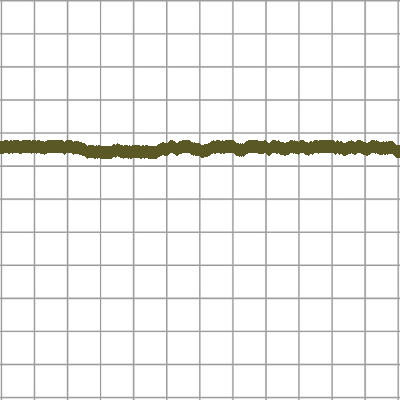

pitch76_thick1_color2_0_validation.png


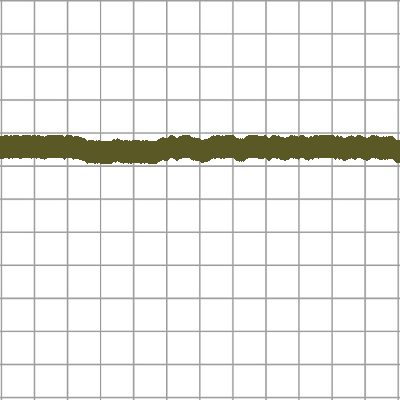

pitch76_thick2_color2_0_validation.png


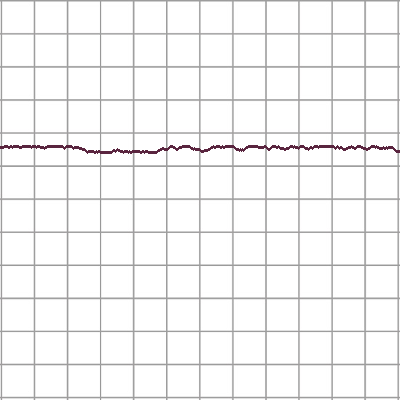

pitch76_thick0_color3_0_validation.png


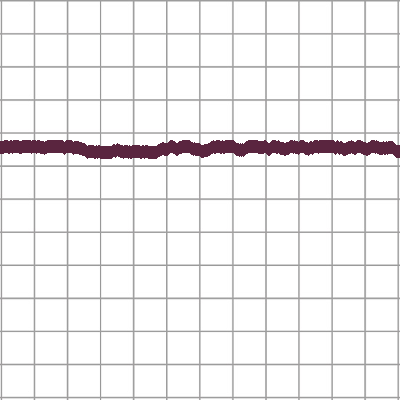

pitch76_thick1_color3_0_validation.png


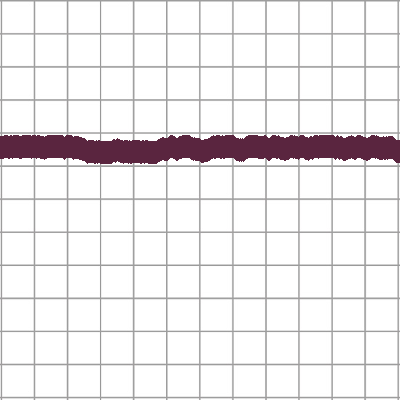

pitch76_thick2_color3_0_validation.png


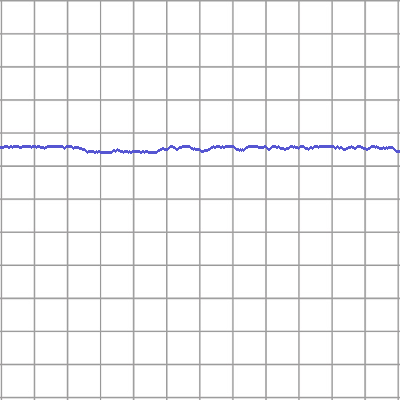

pitch76_thick0_color4_0_validation.png


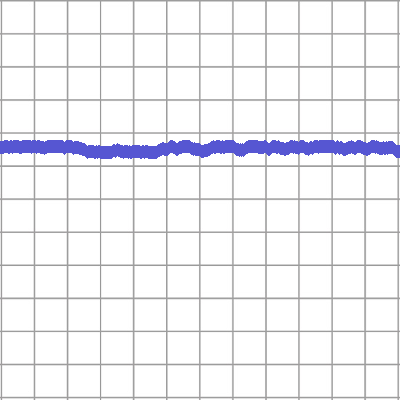

pitch76_thick1_color4_0_validation.png


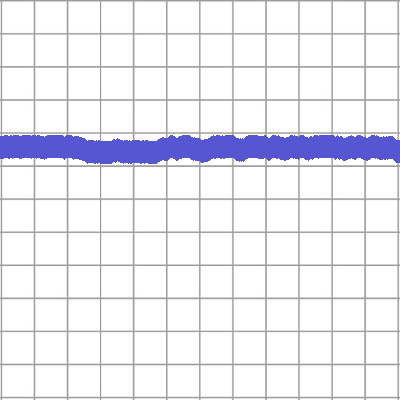

pitch76_thick2_color4_0_validation.png


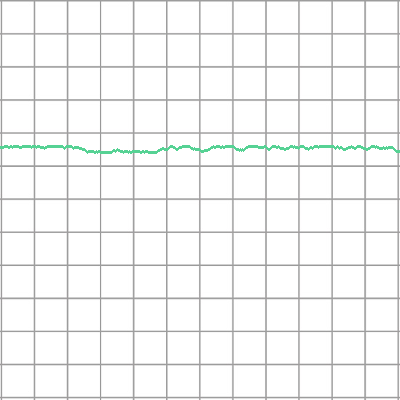

pitch76_thick0_color5_0_validation.png


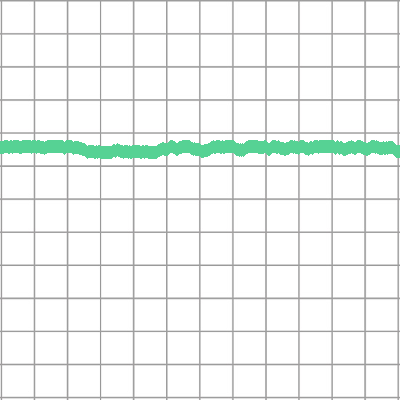

pitch76_thick1_color5_0_validation.png


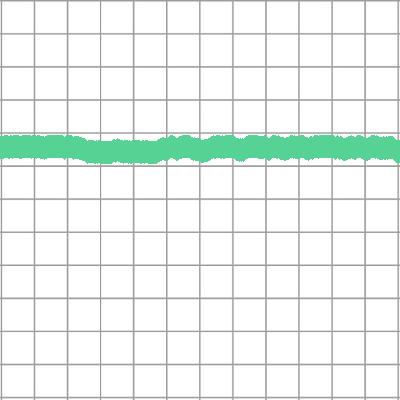

pitch76_thick2_color5_0_validation.png


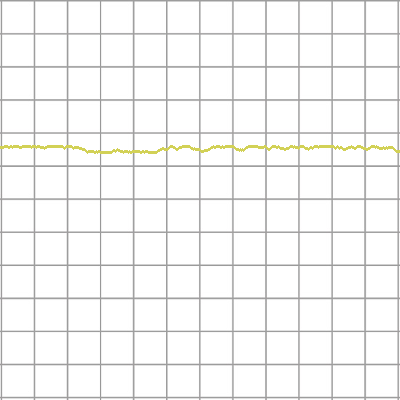

pitch76_thick0_color6_0_validation.png


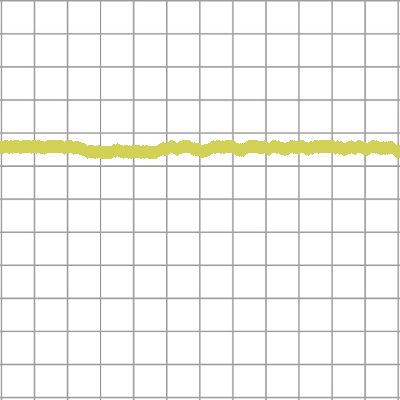

pitch76_thick1_color6_0_validation.png


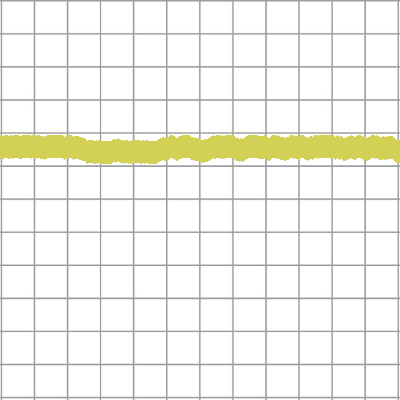

pitch76_thick2_color6_0_validation.png


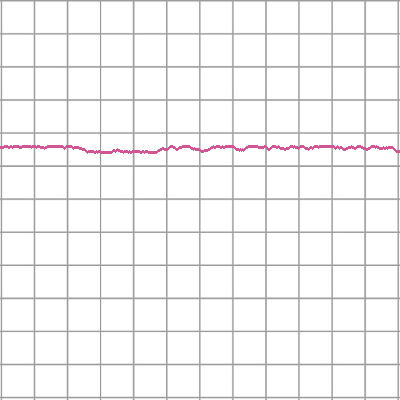

pitch76_thick0_color7_0_validation.png


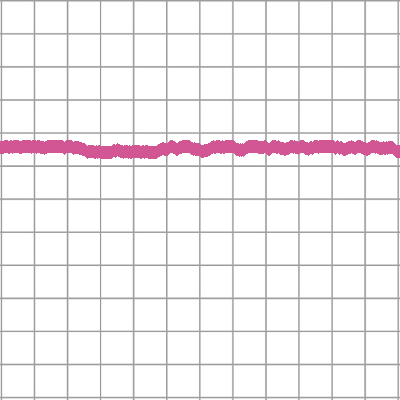

pitch76_thick1_color7_0_validation.png


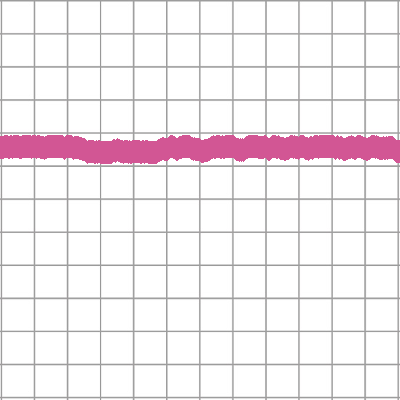

pitch76_thick2_color7_0_validation.png


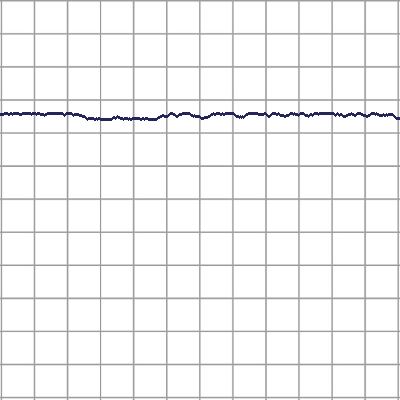

pitch77_thick0_color0_0_validation.png


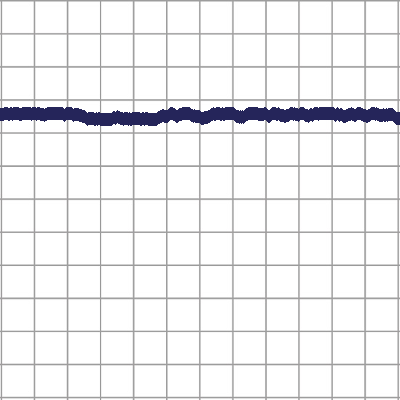

pitch77_thick1_color0_0_validation.png


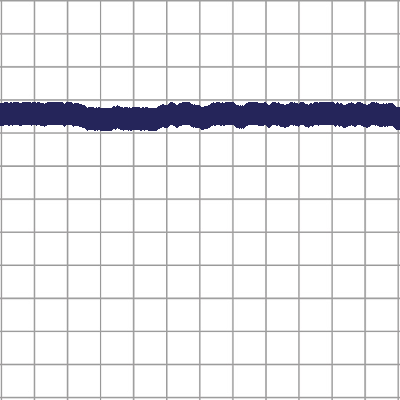

pitch77_thick2_color0_0_validation.png


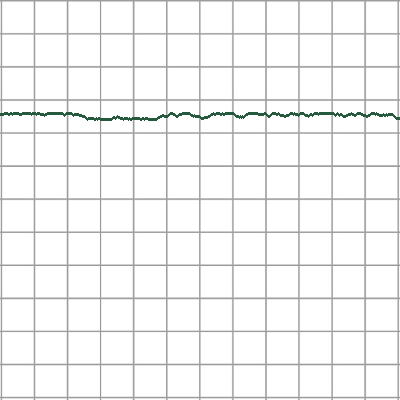

pitch77_thick0_color1_0_validation.png


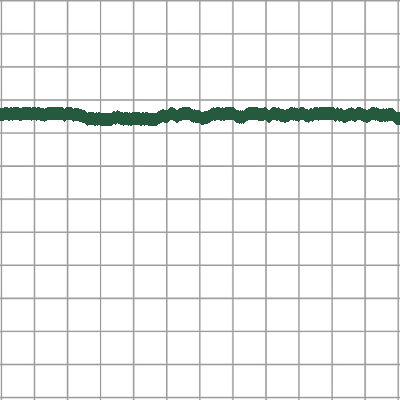

pitch77_thick1_color1_0_validation.png


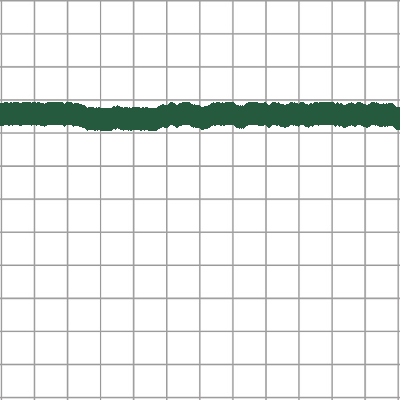

pitch77_thick2_color1_0_validation.png


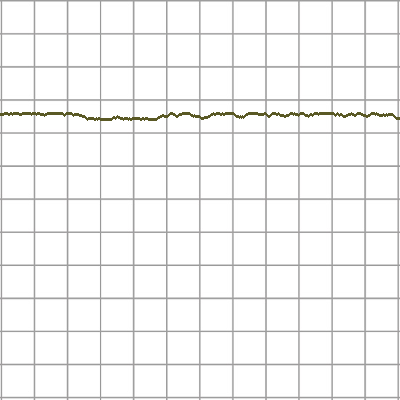

pitch77_thick0_color2_0_validation.png


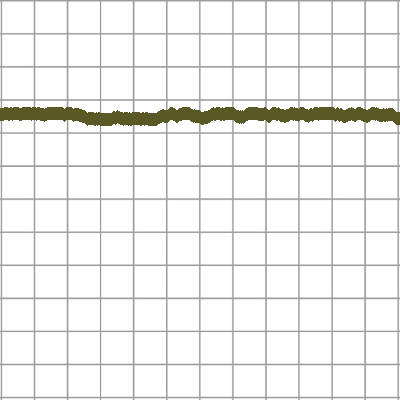

pitch77_thick1_color2_0_validation.png


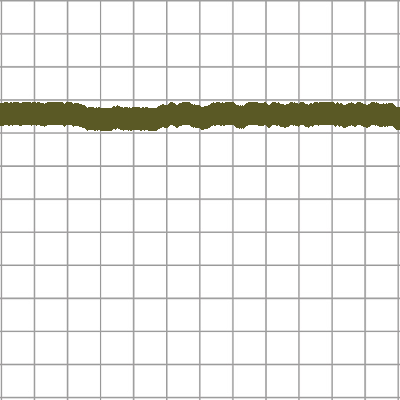

pitch77_thick2_color2_0_validation.png


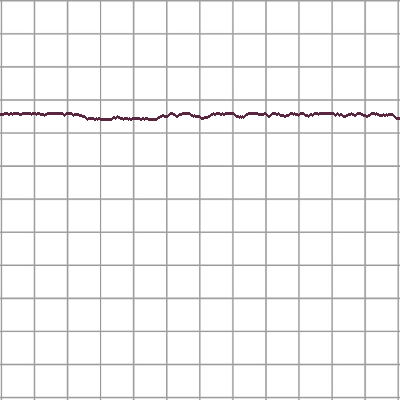

pitch77_thick0_color3_0_validation.png


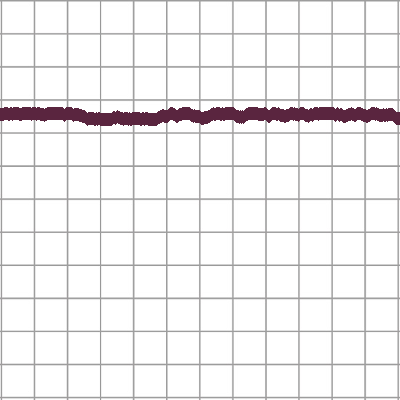

pitch77_thick1_color3_0_validation.png


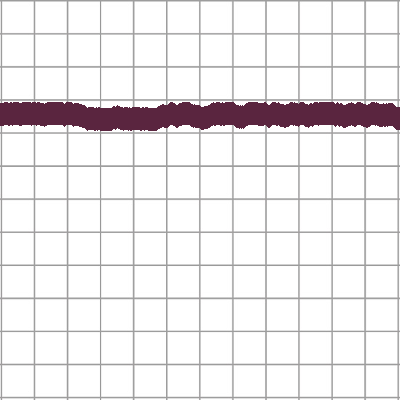

pitch77_thick2_color3_0_validation.png


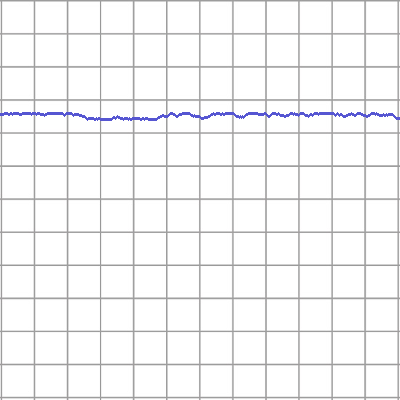

pitch77_thick0_color4_0_validation.png


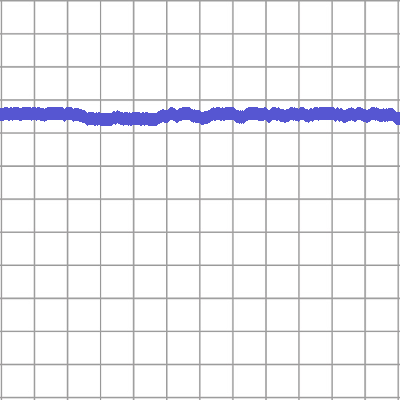

pitch77_thick1_color4_0_validation.png


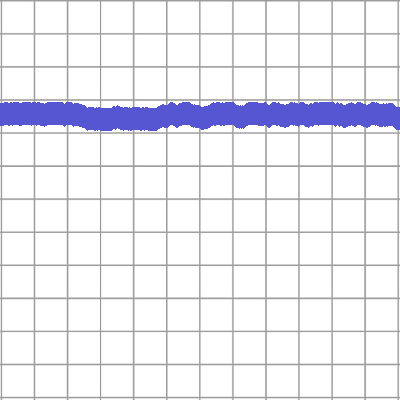

pitch77_thick2_color4_0_validation.png


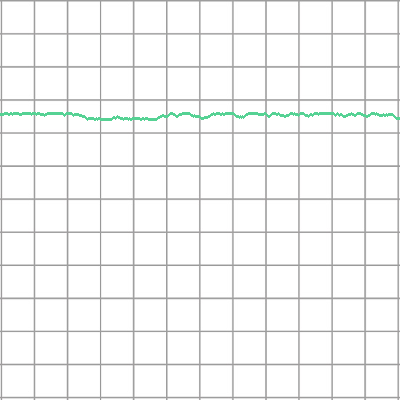

pitch77_thick0_color5_0_validation.png


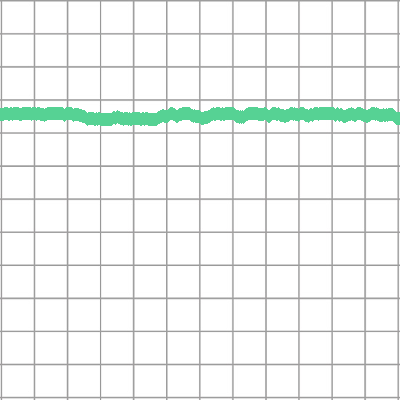

pitch77_thick1_color5_0_validation.png


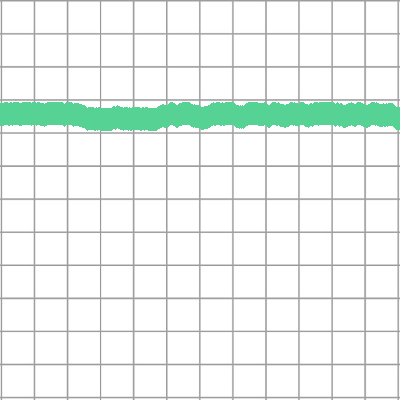

pitch77_thick2_color5_0_validation.png


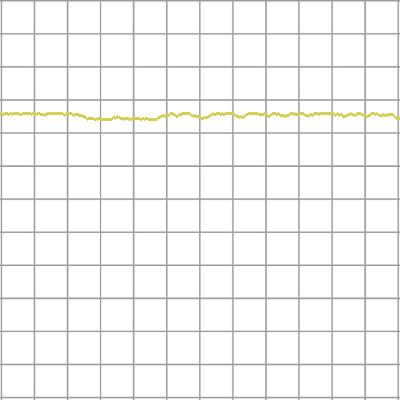

pitch77_thick0_color6_0_validation.png


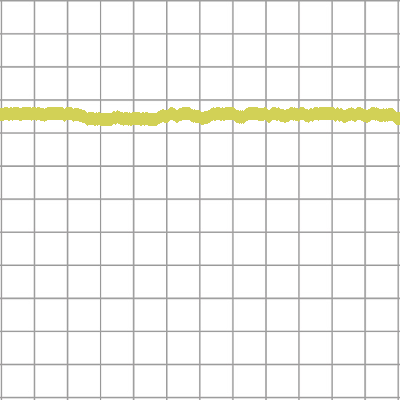

pitch77_thick1_color6_0_validation.png


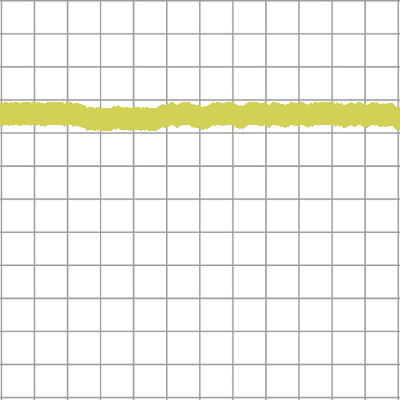

pitch77_thick2_color6_0_validation.png


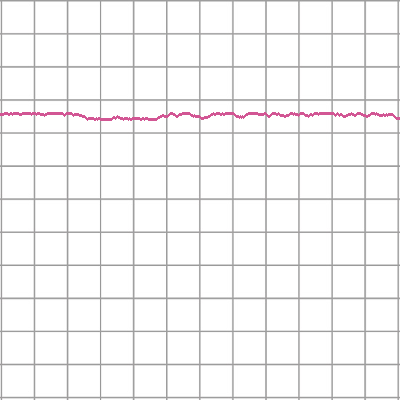

pitch77_thick0_color7_0_validation.png


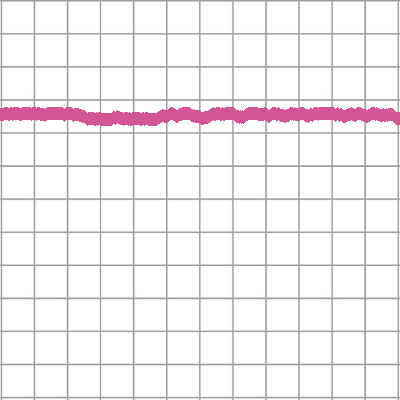

pitch77_thick1_color7_0_validation.png


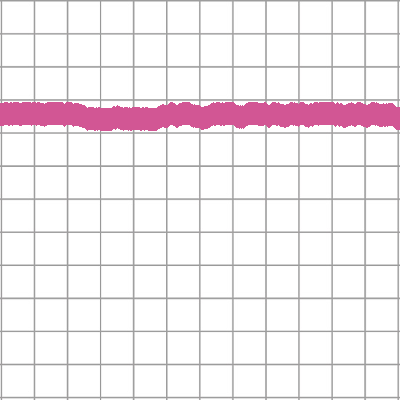

pitch77_thick2_color7_0_validation.png


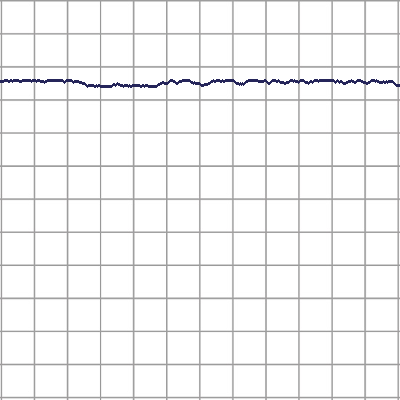

pitch78_thick0_color0_0_validation.png


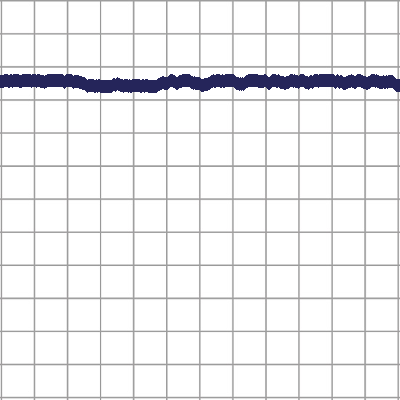

pitch78_thick1_color0_0_validation.png


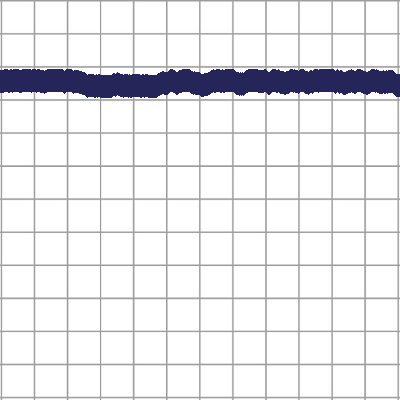

pitch78_thick2_color0_0_validation.png


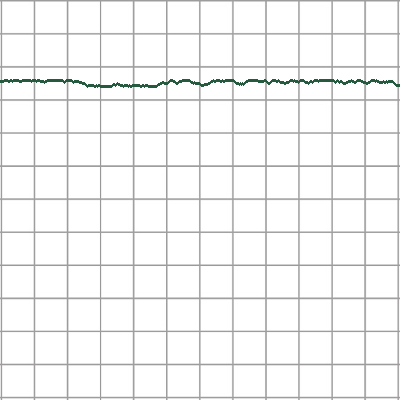

pitch78_thick0_color1_0_validation.png


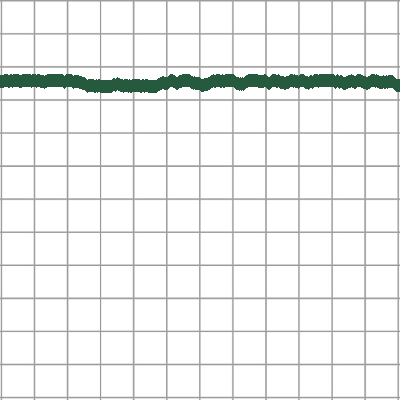

pitch78_thick1_color1_0_validation.png


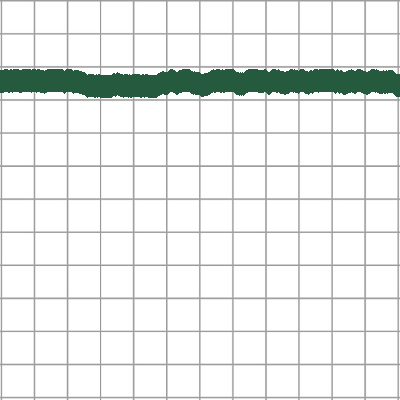

pitch78_thick2_color1_0_validation.png


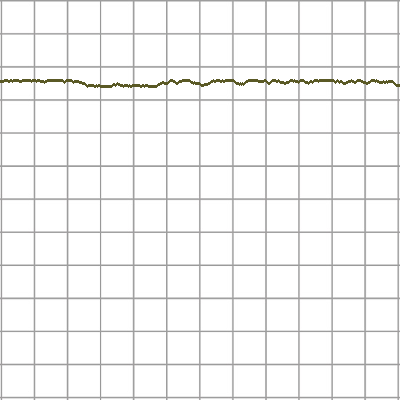

pitch78_thick0_color2_0_validation.png


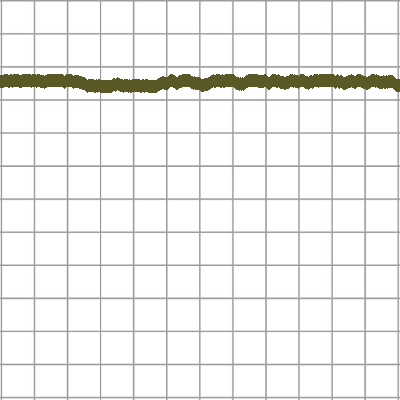

pitch78_thick1_color2_0_validation.png


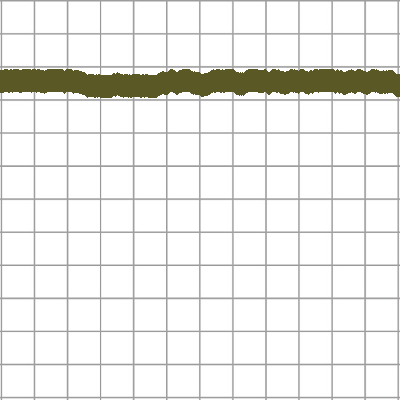

pitch78_thick2_color2_0_validation.png


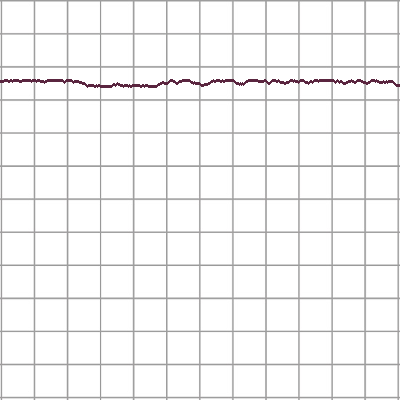

pitch78_thick0_color3_0_validation.png


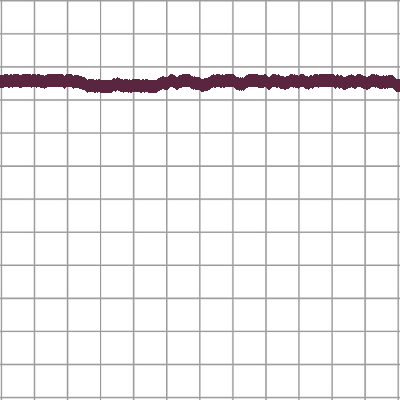

pitch78_thick1_color3_0_validation.png


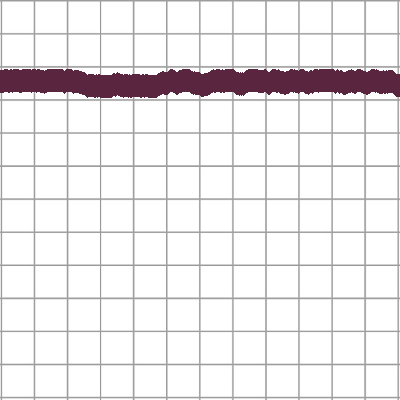

pitch78_thick2_color3_0_validation.png


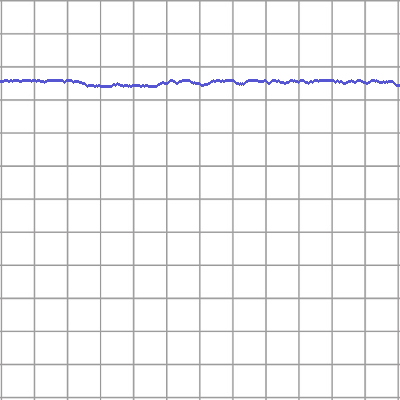

pitch78_thick0_color4_0_validation.png


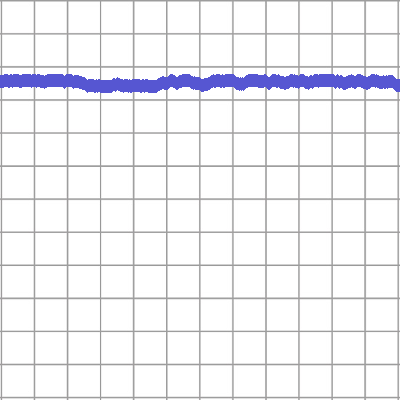

pitch78_thick1_color4_0_validation.png


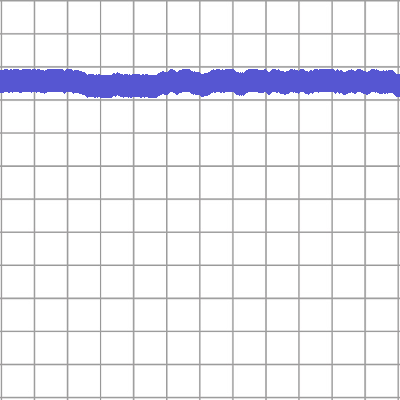

pitch78_thick2_color4_0_validation.png


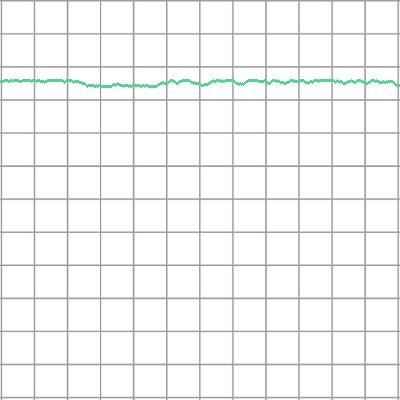

pitch78_thick0_color5_0_validation.png


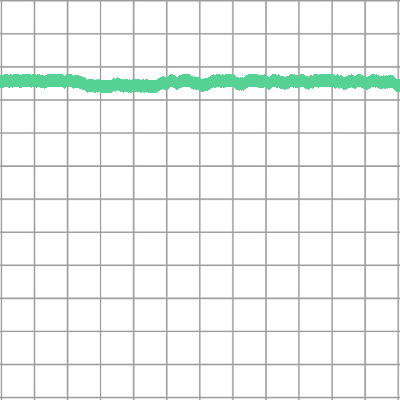

pitch78_thick1_color5_0_validation.png


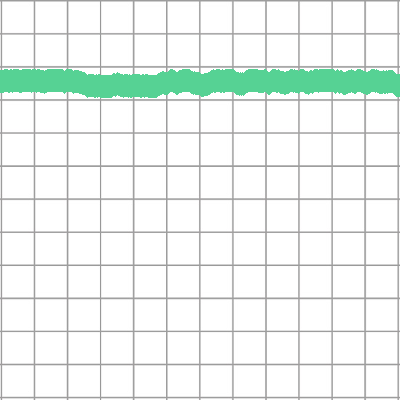

pitch78_thick2_color5_0_validation.png


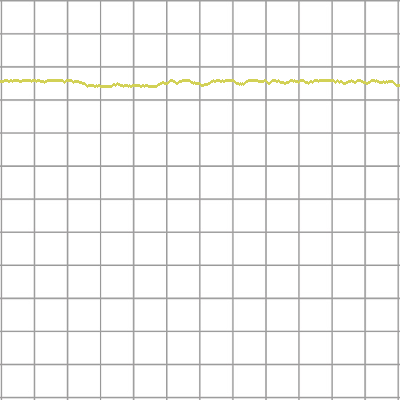

pitch78_thick0_color6_0_validation.png


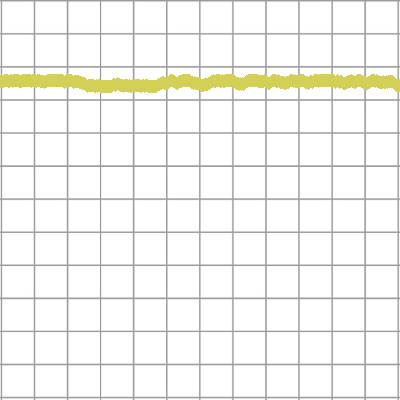

pitch78_thick1_color6_0_validation.png


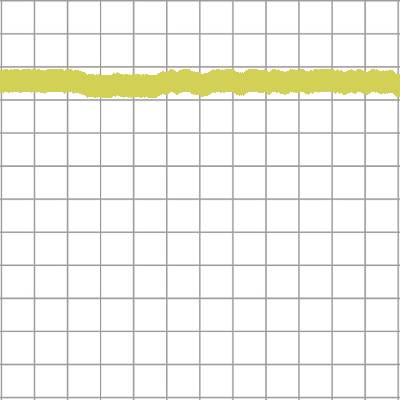

pitch78_thick2_color6_0_validation.png


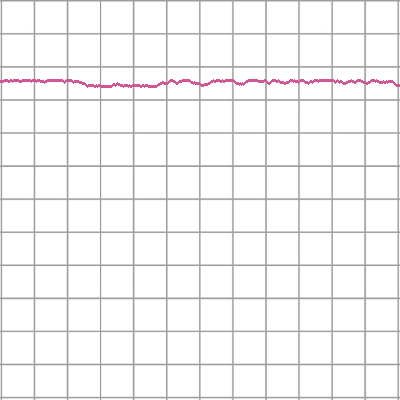

pitch78_thick0_color7_0_validation.png


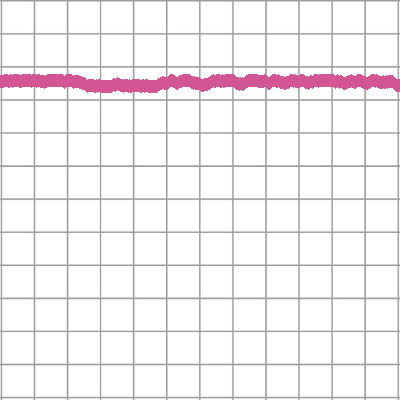

pitch78_thick1_color7_0_validation.png


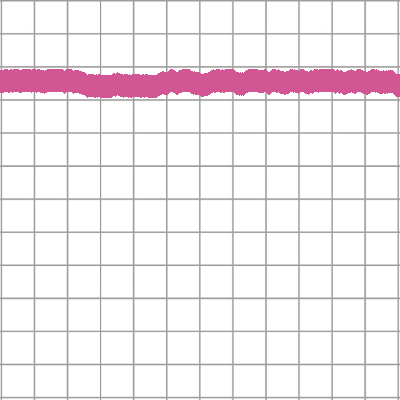

pitch78_thick2_color7_0_validation.png


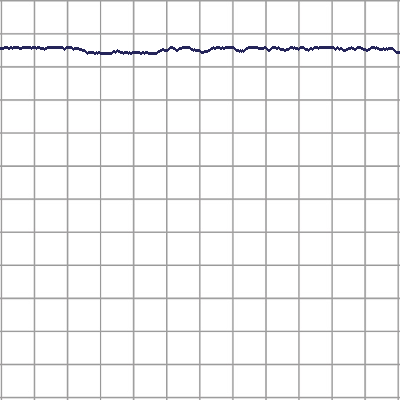

pitch79_thick0_color0_0_validation.png


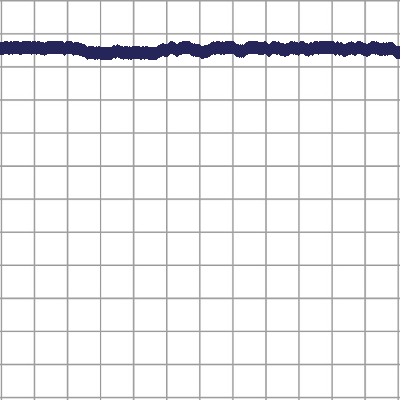

pitch79_thick1_color0_0_validation.png


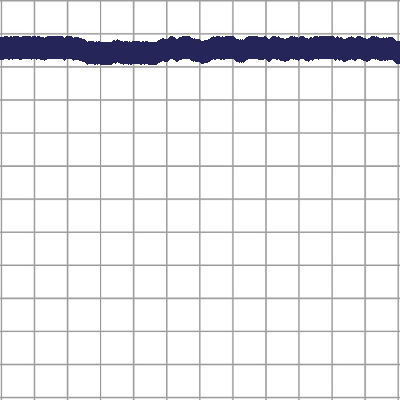

pitch79_thick2_color0_0_validation.png


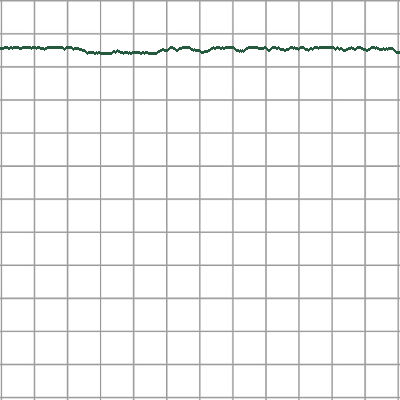

pitch79_thick0_color1_0_validation.png


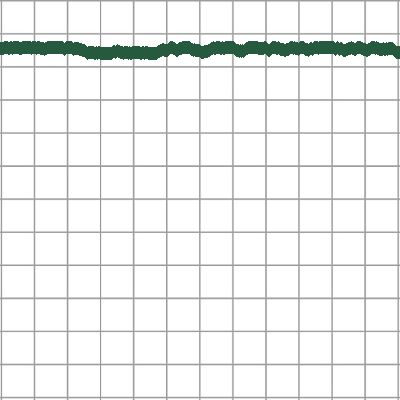

pitch79_thick1_color1_0_validation.png


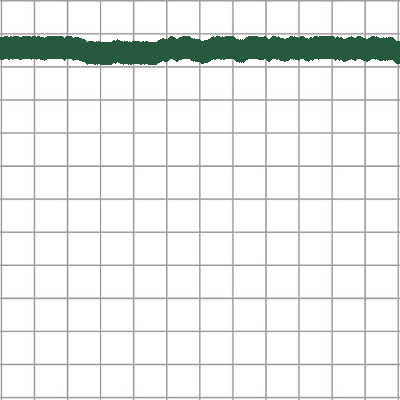

pitch79_thick2_color1_0_validation.png


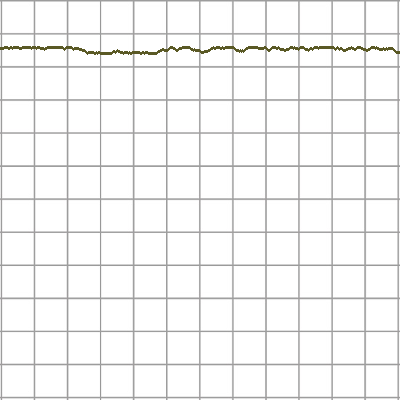

pitch79_thick0_color2_0_validation.png


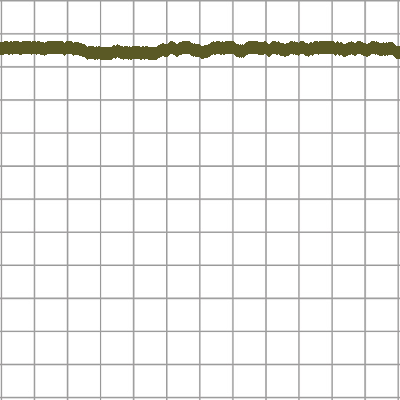

pitch79_thick1_color2_0_validation.png


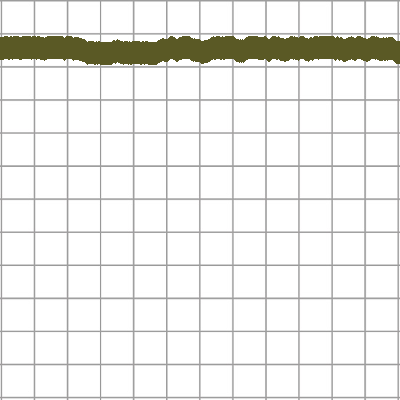

pitch79_thick2_color2_0_validation.png


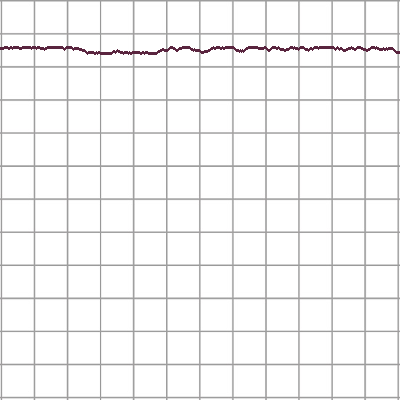

pitch79_thick0_color3_0_validation.png


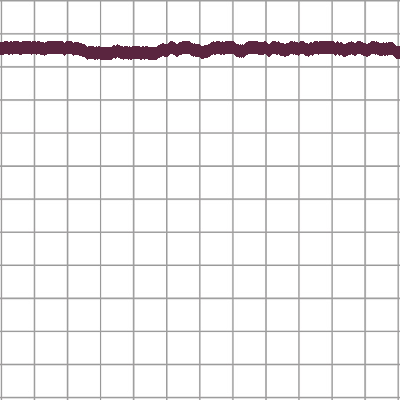

pitch79_thick1_color3_0_validation.png


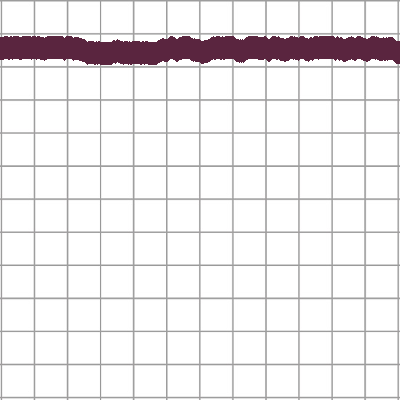

pitch79_thick2_color3_0_validation.png


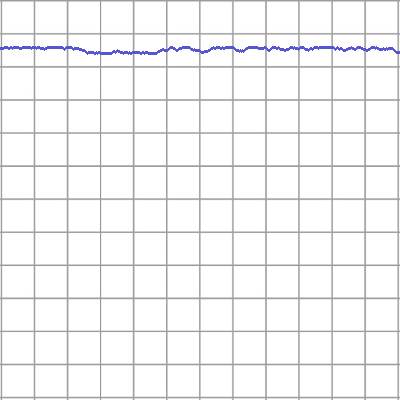

pitch79_thick0_color4_0_validation.png


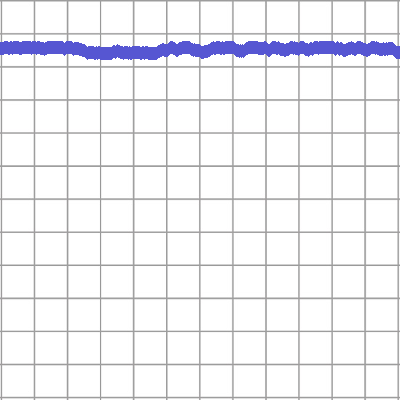

pitch79_thick1_color4_0_validation.png


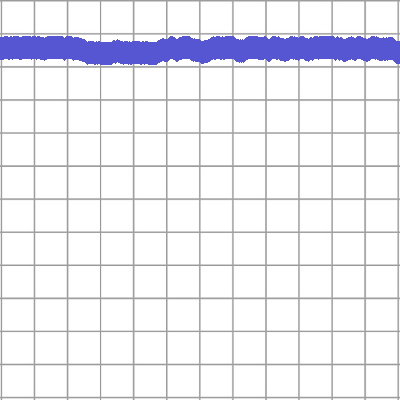

pitch79_thick2_color4_0_validation.png


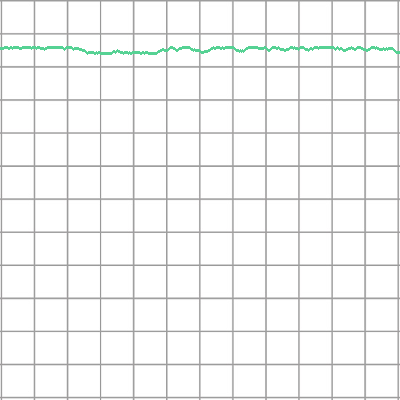

pitch79_thick0_color5_0_validation.png


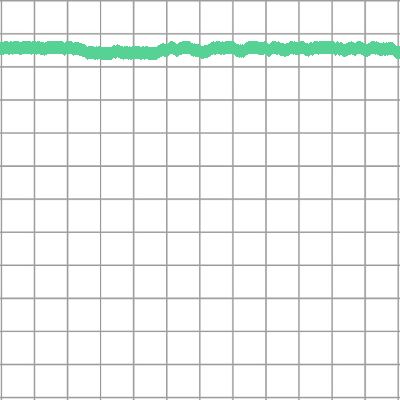

pitch79_thick1_color5_0_validation.png


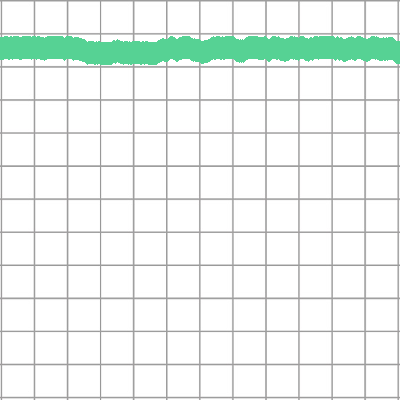

pitch79_thick2_color5_0_validation.png


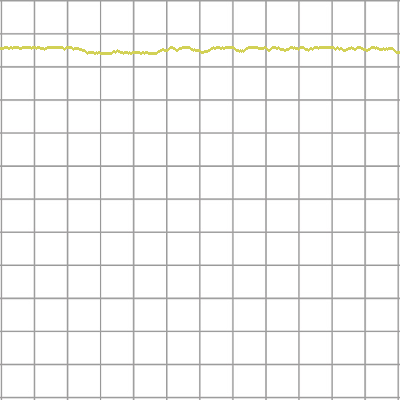

pitch79_thick0_color6_0_validation.png


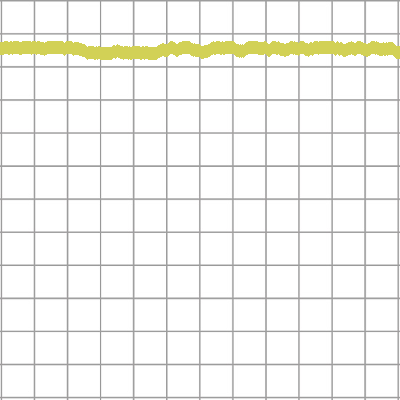

pitch79_thick1_color6_0_validation.png


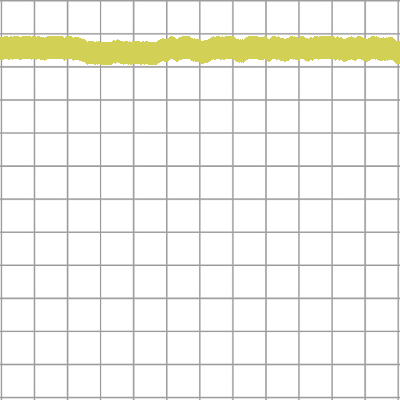

pitch79_thick2_color6_0_validation.png


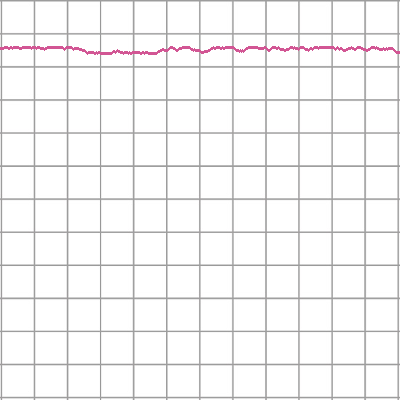

pitch79_thick0_color7_0_validation.png


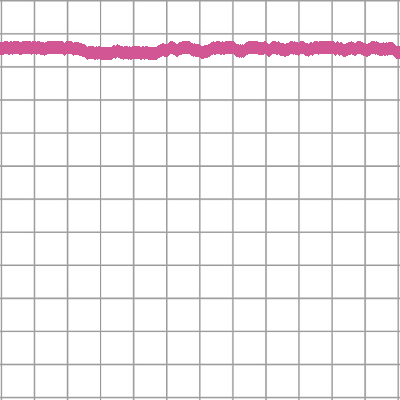

pitch79_thick1_color7_0_validation.png


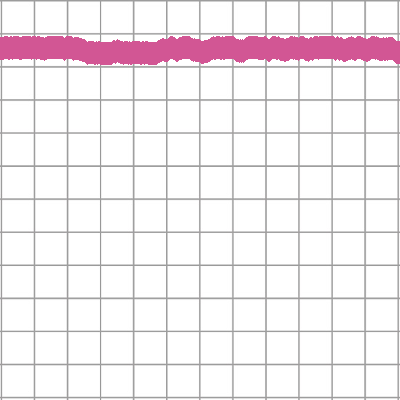

pitch79_thick2_color7_0_validation.png


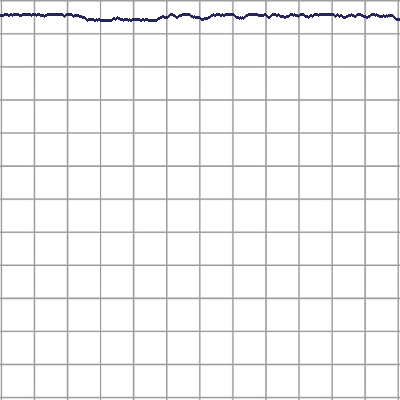

pitch80_thick0_color0_0_validation.png


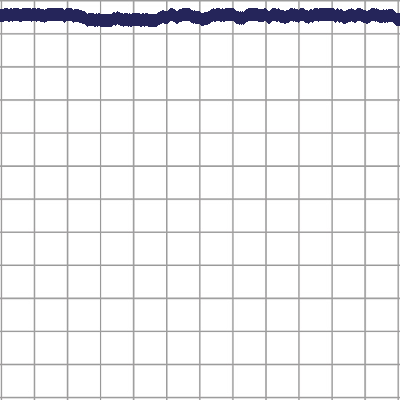

pitch80_thick1_color0_0_validation.png


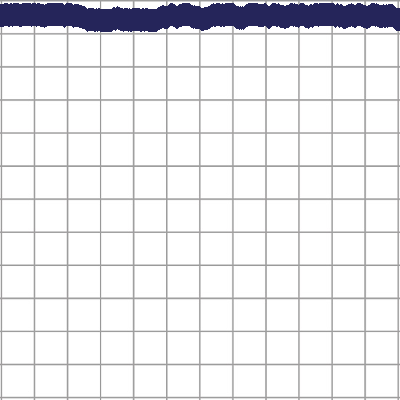

pitch80_thick2_color0_0_validation.png


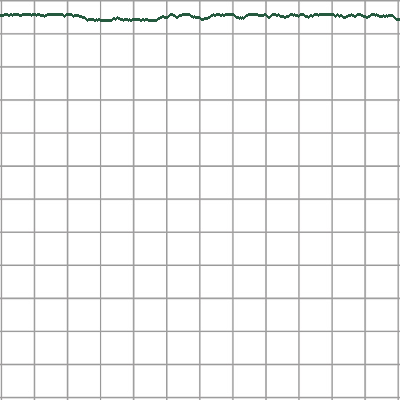

pitch80_thick0_color1_0_validation.png


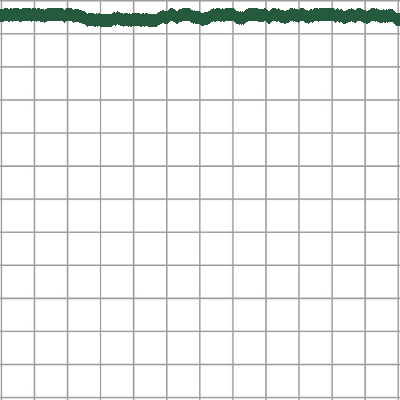

pitch80_thick1_color1_0_validation.png


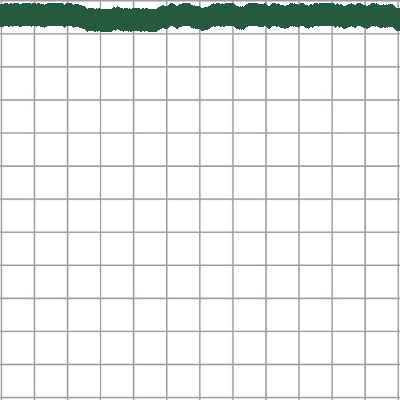

pitch80_thick2_color1_0_validation.png


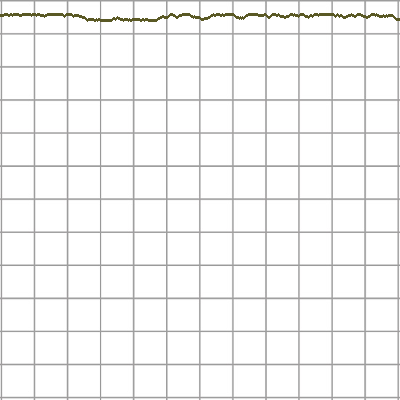

pitch80_thick0_color2_0_validation.png


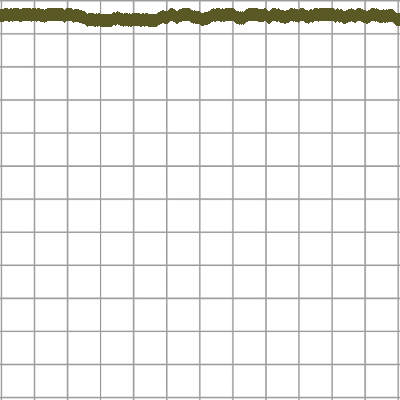

pitch80_thick1_color2_0_validation.png


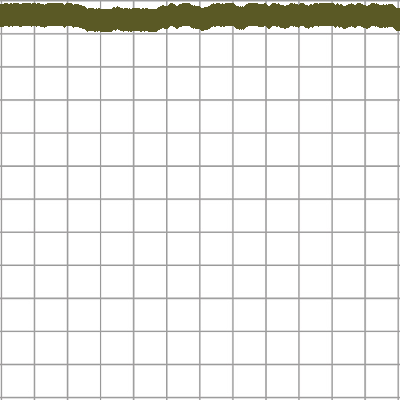

pitch80_thick2_color2_0_validation.png


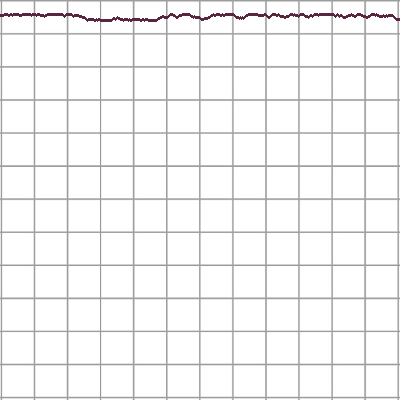

pitch80_thick0_color3_0_validation.png


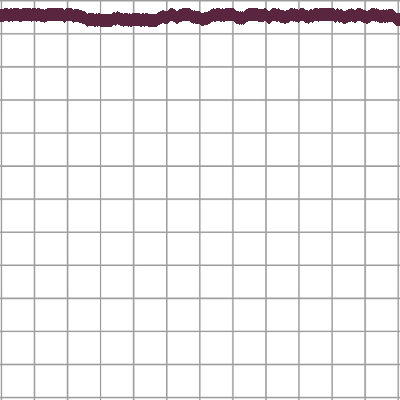

pitch80_thick1_color3_0_validation.png


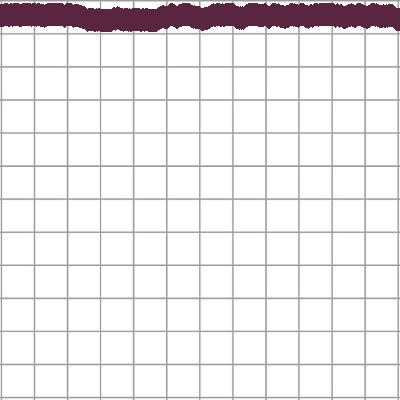

pitch80_thick2_color3_0_validation.png


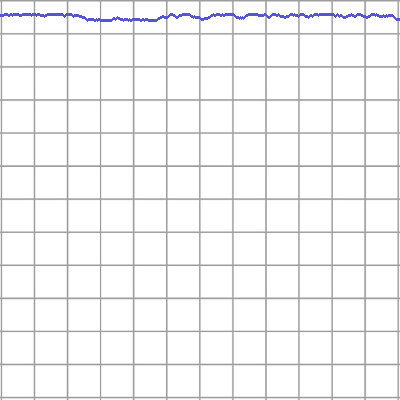

pitch80_thick0_color4_0_validation.png


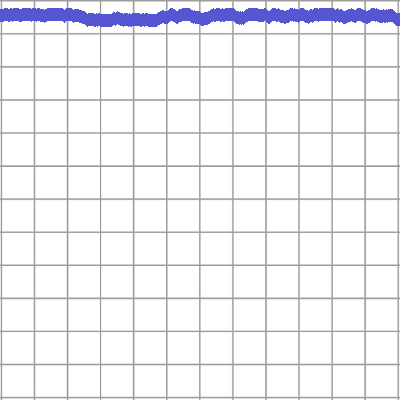

pitch80_thick1_color4_0_validation.png


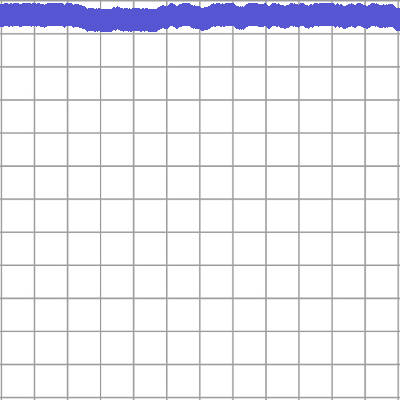

pitch80_thick2_color4_0_validation.png


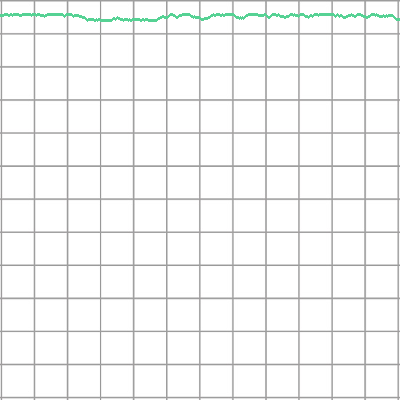

pitch80_thick0_color5_0_validation.png


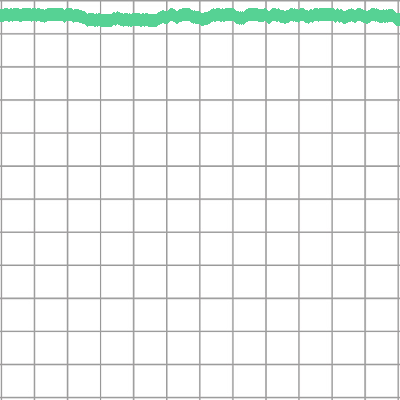

pitch80_thick1_color5_0_validation.png


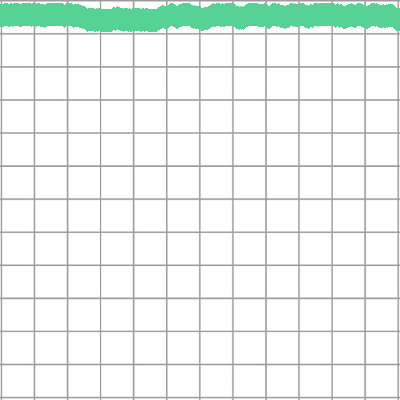

pitch80_thick2_color5_0_validation.png


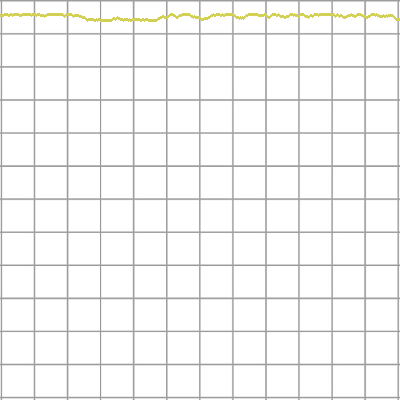

pitch80_thick0_color6_0_validation.png


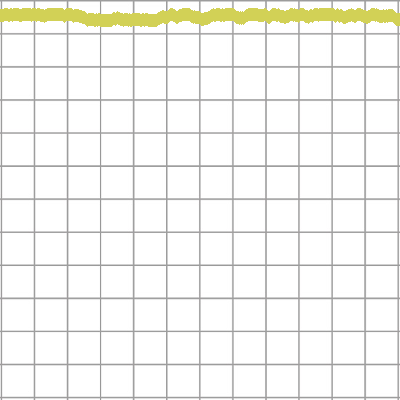

pitch80_thick1_color6_0_validation.png


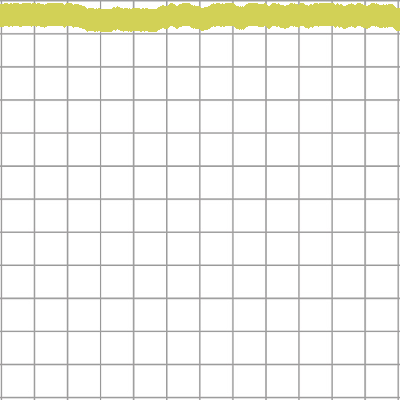

pitch80_thick2_color6_0_validation.png


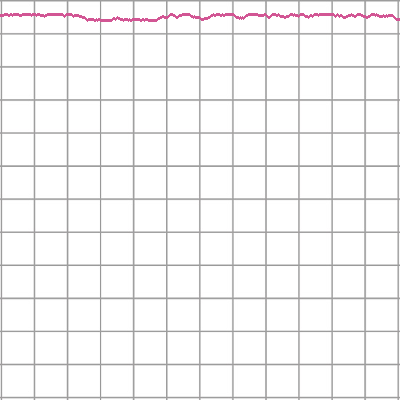

pitch80_thick0_color7_0_validation.png


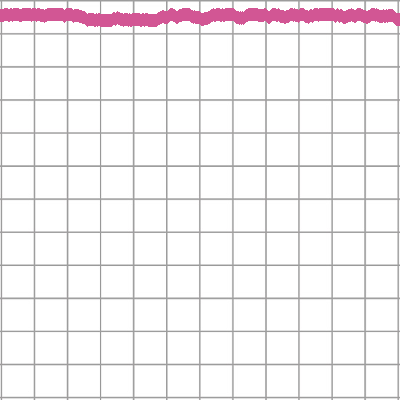

pitch80_thick1_color7_0_validation.png


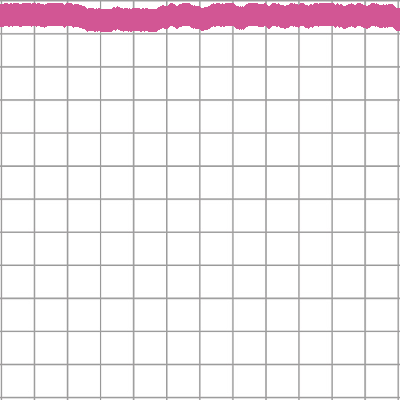

pitch80_thick2_color7_0_validation.png


In [8]:
print('[INFO] generating training dataset...')
generate_pict(NB_VERSION_TRAIN, 'train',0,[1,1,1])
print('[INFO] generating validation dataset...')
generate_pict(NB_VERSION_VALIDATION, 'validation',0,[1,1,1])

In [9]:
## CREATION OF LABELS if not generated while loading the pictures according to their names

# Les labels sont un tableau où chaque élément correspond au label de l'image
# d'indice correspondant
label_train = np.empty(NB_TRAIN)
label_validation = np.empty(NB_VALIDATION)

def labelisation(label_tab, nb_pict) :
  nb_versions = nb_pict / NB_PITCH
  for i in range(nb_pict):
    label_tab[i] = i//nb_versions
  
labelisation(label_train, NB_TRAIN)
labelisation(label_validation, NB_VALIDATION)

print(label_train)

print('label_train.shape=', label_train.shape)
print('label_validation.shape=', label_validation.shape)



[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.
  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.
  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  4.  4.  4.  4.  4.  4.
  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.
  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.
  4.  4.  4.  4.  4.  4.  5.  5.  5.  5.  5.  5.  5

## Loading the datas


In [10]:
## LOADING THE PICTURES

#TODO : trouver un moyen d'optimiser

img_train = np.empty((0,400,400,NB_CHANNEL))
for imgP in sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_train")[:]) :
  if imgP.split(".")[-1] != "git" and imgP.split(".")[-1] != "gitignore":
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_train/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    # To input our values in our network Conv2D layer, we need to reshape the 
    # datasets, i.e., pass from (60, 400, 400) to (60, 400, 400, 1) where 1 is 
    # the number of channels of our images
    img_train = np.concatenate((img_train,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)
    
img_validation = np.empty((0,400,400,NB_CHANNEL))
for imgP in sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_validation")[:]) :
  if imgP.split(".")[-1] != "git" and imgP.split(".")[-1] != "gitignore":
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_validation/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    img_validation = np.concatenate((img_validation,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)

print('img_train.shape=', img_train.shape)
print('img_validation.shape=', img_validation.shape)

img_train.shape= (576, 400, 400, 3)
img_validation.shape= (288, 400, 400, 3)


In [0]:
## CONVERTING THE DATA

def converting_data(img_tab) :
  """ convert the data in float between 0 et 1"""
  # Convert to float
  img_tab = img_tab.astype('float32')
  # Normalize inputs from [0; 255] to [0; 1]
  imgnorm_tab = img_tab / 255

  return imgnorm_tab

In [12]:
## MIXING THE DATA FOR A GOOD LEARNING
def shuffle_data(img_tab, label_tab, nb_pict) :
  """ create shuffled tabs of data and corresponding labels """
  imgnorm_tab = converting_data(img_tab)
  print(imgnorm_tab.shape)
    
  xy_tab = []
  for i in range(nb_pict):
    xy = [imgnorm_tab[i],label_tab[i]]
    xy_tab.append(xy)
  
  random.shuffle(xy_tab)
  
  x_tab = np.empty((nb_pict,400,400,NB_CHANNEL))
  y_tab = np.empty(nb_pict)
  
  for i in range(nb_pict):
    x_tab[i] = xy_tab[i][0]
    y_tab[i] = xy_tab[i][1]
    
  return [x_tab,y_tab]

x_train = np.copy(img_train)
x_validation = np.copy(img_validation)
y_train = np.copy((label_train,NB_CARACTERISTICS))
y_validation = np.copy((label_validation,NB_CARACTERISTICS))
    
[x_train, y_train] = shuffle_data(img_train, label_train, NB_TRAIN)
[x_validation, y_validation] = shuffle_data(img_validation, label_validation, NB_VALIDATION)

print('x_train.shape=', x_train.shape)
print('x_validation.shape=', x_validation.shape)


print('y_train.shape=', y_train.shape)
print('y_validation.shape=', y_validation.shape)
print(y_validation)

# Convert class vectors to binary class matrices ("one hot encoding")
y_train = keras.utils.to_categorical(y_train, NB_CLASS)
y_validation = keras.utils.to_categorical(y_validation, NB_CLASS)


(576, 400, 400, 3)
(288, 400, 400, 3)
x_train.shape= (576, 400, 400, 3)
x_validation.shape= (288, 400, 400, 3)
y_train.shape= (576,)
y_validation.shape= (288,)
[ 4.  7.  4.  9.  6.  2.  0. 10.  0.  4.  5. 10.  1.  7.  2.  2.  4.  9.
  4.  8. 10.  9.  8.  8.  0. 11. 11.  3.  0. 11.  4.  0.  0.  7.  2.  9.
  5.  0.  1.  3.  0.  1.  9.  8.  2.  6. 10.  5.  9.  7.  2.  3.  5.  0.
  0.  0.  2.  7.  9.  1.  6.  5.  8. 11.  1.  4.  0.  3. 11.  1.  0.  7.
  1.  7.  1.  3.  8.  9.  9.  1.  8.  3.  4.  9.  6.  5.  2.  2.  1. 10.
  5.  6.  8.  0.  9.  9.  8.  5.  1.  7.  3. 10.  1.  3.  9. 11. 10.  6.
  6.  6.  2.  0.  6.  7. 11. 10.  9. 11. 11.  4.  7. 11.  7.  6.  3. 10.
  1.  9.  6.  3.  4.  7.  1. 11.  7.  3.  8.  8.  5.  6. 11.  9.  2. 11.
  8.  5. 11.  9.  2.  5.  3.  0.  6.  4.  9.  7.  8.  3.  6.  5.  4.  2.
  4.  3.  7.  7.  5.  4.  6.  2. 10. 11. 11.  6. 11.  5.  5.  8.  0.  7.
  3.  4.  6. 10.  1.  0.  1.  0.  1.  2. 10. 11.  8.  8.  8.  9.  1.  2.
 10.  5.  2.  5.  4.  3.  2.  5.  3. 

## The Convolutional Neural Network

Now we need to create and compile the CNN that will classify our datas.

In [0]:
## CREATION OF THE NEURAL NETWORK

model_pitch = Sequential()

model_pitch.add(Conv2D(filters=32, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(MaxPooling2D(pool_size=(3,3), strides=None, padding='valid', data_format=None))
              
# (CONV => RELU) * 2 => POOL
model_pitch.add(Conv2D(filters=64, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(Conv2D(filters=64, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(MaxPooling2D(pool_size=(2,2), strides=None, padding='valid', data_format=None))

# (CONV => RELU) * 2 => POOL
model_pitch.add(Conv2D(filters=128, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(Conv2D(filters=128, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(MaxPooling2D(pool_size=(2,2), strides=None, padding='valid', data_format=None))

model_pitch.add(Conv2D(filters=256, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(Conv2D(filters=256, kernel_size=(3,3), strides=1, padding='valid', activation='relu'))
model_pitch.add(BatchNormalization(axis=-1))
model_pitch.add(MaxPooling2D(pool_size=(2,2), strides=None, padding='valid', data_format=None))

# first (and only) set of FC => RELU layers
model_pitch.add(Flatten())
model_pitch.add(Dense(1024))
model_pitch.add(Activation("relu"))
model_pitch.add(BatchNormalization())
model_pitch.add(Dropout(rate=0.5))
 
# use a *sigmoid* activation for multi-label classification
model_pitch.add(Dense(NB_CLASS))
model_pitch.add(Activation('softmax'))


model_pitch.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


hist = model_pitch.fit(x_train, y_train, validation_data=(x_validation, y_validation), epochs= 100, batch_size=32)
loss_and_metrics = model_pitch.evaluate(x_validation, y_validation, batch_size=32)
print('loss =', loss_and_metrics[0],'accuracy =', loss_and_metrics[1]);

model_pitch.summary();

Instructions for updating:
Colocations handled automatically by placer.


## Results

pitch(12)+thick(6)+color(8)
OK with 360+120 samples on epoch=100 batch=32 :

loss = 7.312692999524491e-06 accuracy = 1.0


## Graphics


In [0]:
import matplotlib
import matplotlib.pyplot as plt

In [0]:
# summarize history for accuracy
plt.plot(hist.history['acc'])
plt.plot(hist.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()


## Test

In [0]:
## With the img_test folder :

NB_TEST = 0
img_test = np.empty((0,400,400,NB_CHANNEL))
for imgP in sorted(os.listdir( "./audiosynthesis_dl/data/pitch_img/img_test")[:]) :
  if imgP.split(".")[-1] != "git":
    NB_TEST += 1
    img = image.load_img( "./audiosynthesis_dl/data/pitch_img/img_test/"+imgP, 
                             target_size=(400, 400),
                             color_mode='rgb')
    img_test = np.concatenate((img_test,np.reshape(img,(1,400,400,NB_CHANNEL))),axis=0)

label_test = np.empty(NB_TEST)    
labelisation(label_test, NB_TEST)

[x_test, label_test] = shuffle_data(img_test, label_test, NB_TEST)    
    
y_test = model_pitch.predict_classes(x_test)
# show the inputs and predicted outputs
for i in range(len(x_test)):
	print("y_test[%s] = %s" % (i, y_test[i]))
  
def evaluate(label_tab, y_tab, nb_pict) :
  cpt = 0
  for i in range(nb_pict):
    if(label_tab[i] == y_tab[i]) :
      cpt += 1
  value = cpt/nb_pict
  print("Accuracy of prediction of the test dataset :", value)
  
evaluate(label_test, y_test, NB_TEST)
    

In [0]:
i = 1;
print('x_test.shape', x_test.shape, 'dtype', x_test.dtype)
print('y[{}]={}'.format(i, y_test[i]))
plt.imshow(x_test[i,:].reshape(400,400,3), cmap = matplotlib.cm.binary)
plt.axis("off")
plt.show()
plt.gcf().clear()

## Sound synthesis according to the labelisation

full independant code here : https://colab.research.google.com/drive/1KzM-NMSlj87XU_--cifmipAuYd57zZc4


In [0]:
import math as m
import IPython

In [0]:
NB_CHANNEL = 1
volume = 0.5     # range [0.0, 1.0]
fs = 44100       # sampling rate, Hz, must be integer
duration = 4.0   # in seconds, may be float
f0 = 440.0        # sine frequency, Hz, may be float
label = 0 # default value, take the one given by the neural network

In [0]:
def sinusoid(label, duration) :
  """ generate an audio of a sinusoid """
  samples = []
  fm  =  (2**(label/12))*f0
  # generate samples
  for i in range(int(fs*duration)) :
    t = i/fs # seconds
    a = 2*m.pi*fm*t # radians
    v = volume*m.sin(a)
    samples.append(v)
  return samples


In [0]:
i = 1
label_i = y_test[i]

sin = sinusoid(label_i, duration)
IPython.display.Audio(sin, rate=fs)

## Tests with VGG16

code here :
https://colab.research.google.com/drive/1YG-4crZ56U0_Idz4r5Mu04R5zzrM5-1L